<a href="https://colab.research.google.com/github/jesusllg/Towards-a-Fair-Evaluation-Protocol-in-NAS-for-SRIR/blob/main/Downsampling-patches-for-training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/gdrive')
%cd "../Data_for_training/"

In [ ]:
!pip install Pillow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os
import glob
import copy

import time

import numpy as np

from math import floor

from matplotlib import pyplot as plt
from tqdm import tqdm


from IPython.display import display

from collections import namedtuple

from PIL import Image

# Downsampling

In [ ]:
import os.path
from os import path

if path.exists(f'/content/Data_set_Train_x2') == False:
  os.mkdir(f'/content/Data_set_Train_x2')
  for i in range(10, 801, 10):
    os.mkdir(f'/content/Data_set_Train_x2/{i}')

os.chdir(f'/content/Data_set_Train_x2')
!pwd
!ls

/content/Data_set_Train_x2
10   140  190  230  280  320  370  410	460  500  550  60   640  690  730  780
100  150  20   240  290  330  380  420	470  510  560  600  650  70   740  790
110  160  200  250  30	 340  390  430	480  520  570  610  660  700  750  80
120  170  210  260  300  350  40   440	490  530  580  620  670  710  760  800
130  180  220  270  310  360  400  450	50   540  590  630  680  720  770  90


In [ ]:
import os.path
from os import path

if path.exists(f'/content/Data_set_val_x2') == False:
  os.mkdir(f'/content/Data_set_val_x2')
  for i in range(10, 101, 10):
    print(i)
    os.mkdir(f'/content/Data_set_val_x2/{i}')

os.chdir(f'/content/Data_set_val_x2')
!pwd
!ls

10
20
30
40
50
60
70
80
90
100
/content/Data_set_val_x2
10  100  20  30  40  50  60  70  80  90


In [ ]:
folders = []
for f in range(10, 801, 10):
  folders.append(f)

print(folders)

[10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, 120, 130, 140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240, 250, 260, 270, 280, 290, 300, 310, 320, 330, 340, 350, 360, 370, 380, 390, 400, 410, 420, 430, 440, 450, 460, 470, 480, 490, 500, 510, 520, 530, 540, 550, 560, 570, 580, 590, 600, 610, 620, 630, 640, 650, 660, 670, 680, 690, 700, 710, 720, 730, 740, 750, 760, 770, 780, 790, 800]


In [ ]:
a = 0
for k in range(800):
  if k<folders[a]:
    print(k, folders[a])
  else:
    print(k, folders[a+1])
    a+=1

0 10
1 10
2 10
3 10
4 10
5 10
6 10
7 10
8 10
9 10
10 20
11 20
12 20
13 20
14 20
15 20
16 20
17 20
18 20
19 20
20 30
21 30
22 30
23 30
24 30
25 30
26 30
27 30
28 30
29 30
30 40
31 40
32 40
33 40
34 40
35 40
36 40
37 40
38 40
39 40
40 50
41 50
42 50
43 50
44 50
45 50
46 50
47 50
48 50
49 50
50 60
51 60
52 60
53 60
54 60
55 60
56 60
57 60
58 60
59 60
60 70
61 70
62 70
63 70
64 70
65 70
66 70
67 70
68 70
69 70
70 80
71 80
72 80
73 80
74 80
75 80
76 80
77 80
78 80
79 80
80 90
81 90
82 90
83 90
84 90
85 90
86 90
87 90
88 90
89 90
90 100
91 100
92 100
93 100
94 100
95 100
96 100
97 100
98 100
99 100
100 110
101 110
102 110
103 110
104 110
105 110
106 110
107 110
108 110
109 110
110 120
111 120
112 120
113 120
114 120
115 120
116 120
117 120
118 120
119 120
120 130
121 130
122 130
123 130
124 130
125 130
126 130
127 130
128 130
129 130
130 140
131 140
132 140
133 140
134 140
135 140
136 140
137 140
138 140
139 140
140 150
141 150
142 150
143 150
144 150
145 150
146 150
147 150
148 150
149 150


In [ ]:
img_paths = []
val_img_paths = []

for i in range(10,801,10):
  for dirname, _, filenames in os.walk(f'../Train_Y/{i}'):
      for filename in filenames:
          img_paths.append(os.path.join(dirname, filename))
  print(i, filename)

for j in range(10,11,10):
  for dirname, _, filenames in os.walk(f'../Validation_Y/Data_set_val_64/{j}'):
      for filename in filenames:
          val_img_paths.append(os.path.join(dirname, filename))
        
print(f'Dataset dimension for {i}: ', len(img_paths))
print(f'Training for {i}: ', len(img_paths))
print('Validation: ', len(val_img_paths))

10 patch_1_2_24.jpg
20 patch_11_3_26.jpg
30 patch_20_18_27.jpg
40 patch_30_13_15.jpg
50 patch_40_0_26.jpg
60 patch_50_4_24.jpg
70 patch_60_5_13.jpg
80 patch_70_18_30.jpg
90 patch_80_16_4.jpg
100 patch_90_14_4.jpg
110 patch_100_8_2.jpg
120 patch_110_12_16.jpg
130 patch_121_8_16.jpg
140 patch_130_10_29.jpg
150 patch_140_12_11.jpg
160 patch_150_11_5.jpg
170 patch_160_3_22.jpg
180 patch_170_18_3.jpg
190 patch_180_19_15.jpg
200 patch_190_21_14.jpg
210 patch_201_1_24.jpg
220 patch_210_4_28.jpg
230 patch_220_3_8.jpg
240 patch_230_5_18.jpg
250 patch_241_5_15.jpg
260 patch_250_14_27.jpg
270 patch_260_6_21.jpg
280 patch_270_10_24.jpg
290 patch_280_15_25.jpg
300 patch_290_11_4.jpg
310 patch_300_7_3.jpg
320 patch_310_2_16.jpg
330 patch_320_7_26.jpg
340 patch_330_11_30.jpg
350 patch_341_6_18.jpg
360 patch_351_1_28.jpg
370 patch_360_10_23.jpg
380 patch_370_18_12.jpg
390 patch_380_10_28.jpg
400 patch_391_0_22.jpg
410 patch_400_15_29.jpg
420 patch_410_17_14.jpg
430 patch_420_19_4.jpg
440 patch_430_8_6

0 10
1 10
2 10
3 10
4 10
5 10
6 10
7 10
8 10
9 10
10 20
11 20
12 20
13 20
14 20
15 20
16 20
17 20
18 20
19 20
20 30
21 30
22 30
23 30
24 30
25 30
26 30
27 30
28 30
29 30
30 40
31 40
32 40
33 40
34 40
35 40
36 40
37 40
38 40
39 40
40 50
41 50
42 50
43 50
44 50
45 50
46 50
47 50
48 50
49 50
50 60
51 60
52 60
53 60
54 60
55 60
56 60
57 60
58 60
59 60
60 70
61 70
62 70
63 70
64 70
65 70
66 70
67 70
68 70
69 70
70 80
71 80
72 80
73 80
74 80
75 80
76 80
77 80
78 80
79 80
80 90
81 90
82 90
83 90
84 90
85 90
86 90
87 90
88 90
89 90
90 100
91 100
92 100
93 100
94 100
95 100
96 100
97 100
98 100
99 100
/gdrive/MyDrive/Doctorate_Thesis_Coding/COMPSR-NET/Data_for_training/Patches_ULBH/Train_Y/800 patch_790_7_28.jpg
JPEG (64, 64) RGB


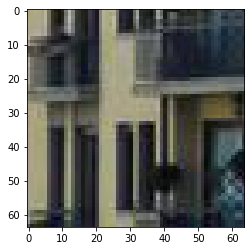

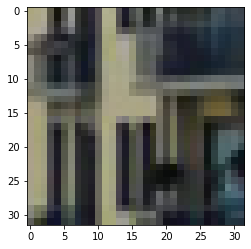

None (32, 32) RGB
/gdrive/MyDrive/Doctorate_Thesis_Coding/COMPSR-NET/Data_for_training/Patches_ULBH/Train_Y/800 patch_790_5_28.jpg
JPEG (64, 64) RGB


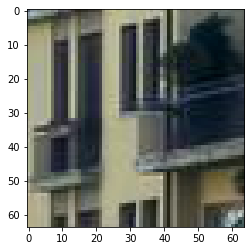

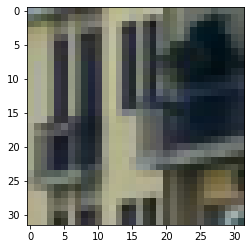

None (32, 32) RGB
/gdrive/MyDrive/Doctorate_Thesis_Coding/COMPSR-NET/Data_for_training/Patches_ULBH/Train_Y/800 patch_790_12_6.jpg
JPEG (64, 64) RGB


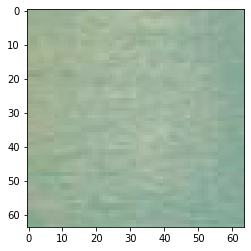

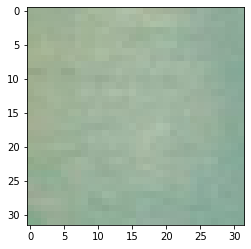

None (32, 32) RGB
/gdrive/MyDrive/Doctorate_Thesis_Coding/COMPSR-NET/Data_for_training/Patches_ULBH/Train_Y/800 patch_790_5_19.jpg
JPEG (64, 64) RGB


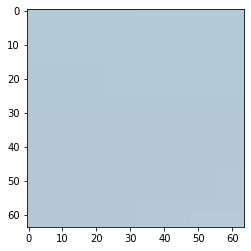

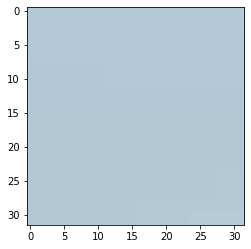

None (32, 32) RGB
/gdrive/MyDrive/Doctorate_Thesis_Coding/COMPSR-NET/Data_for_training/Patches_ULBH/Train_Y/800 patch_790_8_21.jpg
JPEG (64, 64) RGB


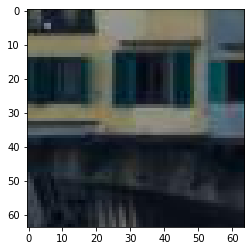

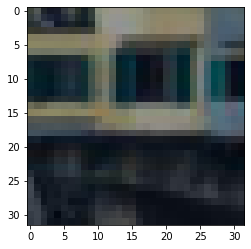

None (32, 32) RGB
/gdrive/MyDrive/Doctorate_Thesis_Coding/COMPSR-NET/Data_for_training/Patches_ULBH/Train_Y/800 patch_790_6_8.jpg
JPEG (64, 64) RGB


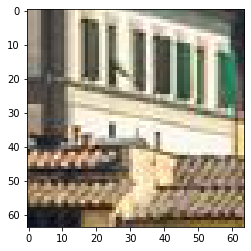

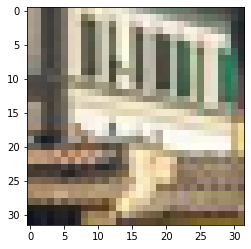

None (32, 32) RGB
/gdrive/MyDrive/Doctorate_Thesis_Coding/COMPSR-NET/Data_for_training/Patches_ULBH/Train_Y/800 patch_790_11_0.jpg
JPEG (64, 64) RGB


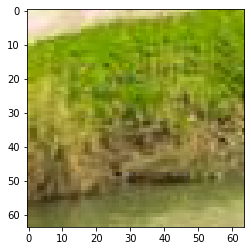

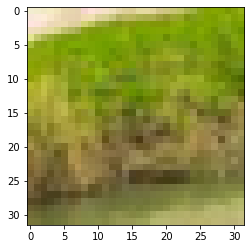

None (32, 32) RGB
/gdrive/MyDrive/Doctorate_Thesis_Coding/COMPSR-NET/Data_for_training/Patches_ULBH/Train_Y/800 patch_790_10_19.jpg
JPEG (64, 64) RGB


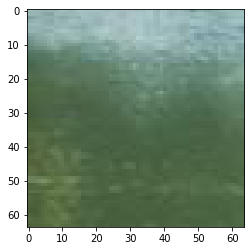

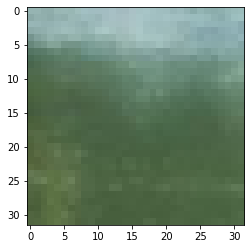

None (32, 32) RGB
/gdrive/MyDrive/Doctorate_Thesis_Coding/COMPSR-NET/Data_for_training/Patches_ULBH/Train_Y/800 patch_790_10_7.jpg
JPEG (64, 64) RGB


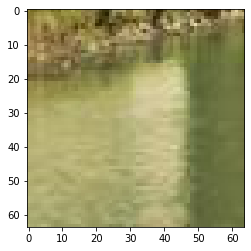

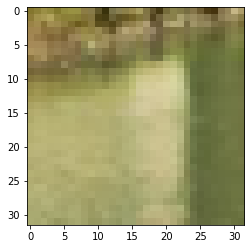

None (32, 32) RGB
/gdrive/MyDrive/Doctorate_Thesis_Coding/COMPSR-NET/Data_for_training/Patches_ULBH/Train_Y/800 patch_790_0_14.jpg
JPEG (64, 64) RGB


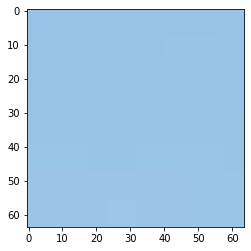

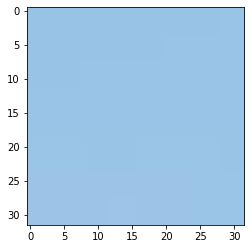

None (32, 32) RGB


In [ ]:
a = 0
for k in range(100):
  if k<folders[a]:
    print(k, folders[a])
  else:
    print(k, folders[a+1])
    a+=1
for image in img_paths[522929:522939]:
  name = os.path.split(image)
  print(name[0], name[1])
  im = Image.open(image)
  print(im.format, im.size, im.mode)
  plt.imshow(im)
  plt.show()
  im_d = im.resize((im.size[0]//2, im.size[1]//2), Image.BICUBIC)
  plt.imshow(im_d)
  plt.show()
  print(im_d.format, im_d.size, im_d.mode)
  im_d.save(f"/content/Data_set_Train_x2/80/{name[1]}")

In [ ]:
!rm -rf /content/Data_set_Train_x2

In [ ]:
im = Image.open(val_img_paths[0])
print(im.format, im.size, im.mode)

PNG (1620, 2040) RGB


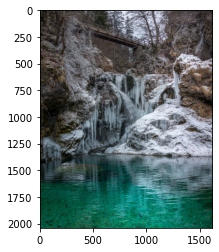

In [ ]:
plt.imshow(im)
plt.show()

In [ ]:
im1 = im.resize((810,1020), Image.BICUBIC)

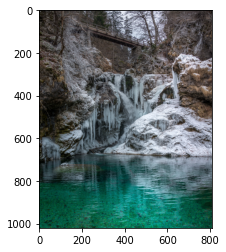

In [ ]:
plt.imshow(im1)
plt.show()

# Downsampling

6200
/content/Data_set_Train_x2/510/patch_507_12_15.jpg
/content/Data_set_Train_x2/510/patch_508_0_1.jpg
/content/Data_set_Train_x2/510/patch_508_10_9.jpg
/content/Data_set_Train_x2/510/patch_507_8_18.jpg
/content/Data_set_Train_x2/510/patch_508_8_30.jpg
/content/Data_set_Train_x2/510/patch_508_6_1.jpg
/content/Data_set_Train_x2/510/patch_507_9_14.jpg
/content/Data_set_Train_x2/510/patch_507_8_17.jpg
/content/Data_set_Train_x2/510/patch_507_9_27.jpg
/content/Data_set_Train_x2/510/patch_508_5_22.jpg
/content/Data_set_Train_x2/510/patch_507_8_13.jpg
/content/Data_set_Train_x2/510/patch_508_4_29.jpg
/content/Data_set_Train_x2/510/patch_508_5_26.jpg
/content/Data_set_Train_x2/510/patch_508_8_28.jpg
/content/Data_set_Train_x2/510/patch_508_0_3.jpg
/content/Data_set_Train_x2/510/patch_507_11_14.jpg
/content/Data_set_Train_x2/510/patch_508_4_3.jpg
/content/Data_set_Train_x2/510/patch_508_4_12.jpg
/content/Data_set_Train_x2/510/patch_507_9_21.jpg
/content/Data_set_Train_x2/510/patch_509_1_18.j

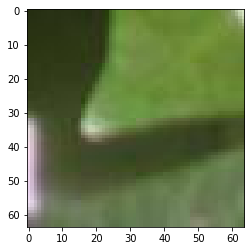

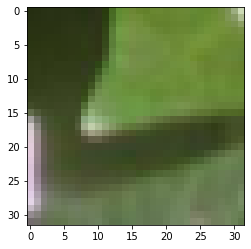

/content/Data_set_Train_x2/510/patch_508_20_21.jpg
/content/Data_set_Train_x2/510/patch_508_17_11.jpg
/content/Data_set_Train_x2/510/patch_508_15_22.jpg
/content/Data_set_Train_x2/510/patch_508_17_2.jpg
/content/Data_set_Train_x2/510/patch_508_12_16.jpg
/content/Data_set_Train_x2/510/patch_508_20_9.jpg
/content/Data_set_Train_x2/510/patch_508_16_22.jpg
/content/Data_set_Train_x2/510/patch_509_3_7.jpg
/content/Data_set_Train_x2/510/patch_508_18_20.jpg
/content/Data_set_Train_x2/510/patch_508_16_24.jpg
/content/Data_set_Train_x2/510/patch_508_20_7.jpg
/content/Data_set_Train_x2/510/patch_508_20_23.jpg
/content/Data_set_Train_x2/510/patch_508_16_17.jpg
/content/Data_set_Train_x2/510/patch_508_13_16.jpg
/content/Data_set_Train_x2/510/patch_508_12_17.jpg
/content/Data_set_Train_x2/510/patch_509_2_28.jpg
/content/Data_set_Train_x2/510/patch_509_0_5.jpg
/content/Data_set_Train_x2/510/patch_508_11_21.jpg
/content/Data_set_Train_x2/510/patch_508_12_26.jpg
/content/Data_set_Train_x2/510/patch_50

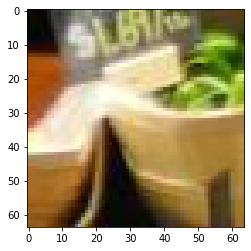

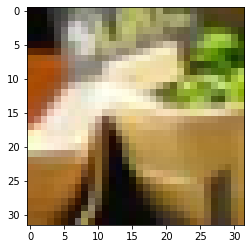

/content/Data_set_Train_x2/510/patch_509_13_1.jpg
/content/Data_set_Train_x2/510/patch_506_12_9.jpg
/content/Data_set_Train_x2/510/patch_505_16_14.jpg
/content/Data_set_Train_x2/510/patch_505_15_12.jpg
/content/Data_set_Train_x2/510/patch_506_9_4.jpg
/content/Data_set_Train_x2/510/patch_506_4_21.jpg
/content/Data_set_Train_x2/510/patch_506_10_10.jpg
/content/Data_set_Train_x2/510/patch_506_1_30.jpg
/content/Data_set_Train_x2/510/patch_505_16_16.jpg
/content/Data_set_Train_x2/510/patch_506_11_29.jpg
/content/Data_set_Train_x2/510/patch_506_11_19.jpg
/content/Data_set_Train_x2/510/patch_506_6_4.jpg
/content/Data_set_Train_x2/510/patch_506_6_10.jpg
/content/Data_set_Train_x2/510/patch_506_5_24.jpg
/content/Data_set_Train_x2/510/patch_506_7_29.jpg
/content/Data_set_Train_x2/510/patch_506_12_0.jpg
/content/Data_set_Train_x2/510/patch_506_0_23.jpg
/content/Data_set_Train_x2/510/patch_506_2_4.jpg
/content/Data_set_Train_x2/510/patch_506_7_1.jpg
/content/Data_set_Train_x2/510/patch_506_7_18.jp

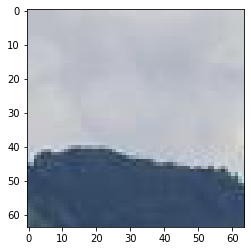

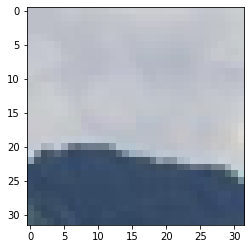

/content/Data_set_Train_x2/510/patch_507_3_5.jpg
/content/Data_set_Train_x2/510/patch_507_7_0.jpg
/content/Data_set_Train_x2/510/patch_506_13_26.jpg
/content/Data_set_Train_x2/510/patch_507_1_8.jpg
/content/Data_set_Train_x2/510/patch_507_4_17.jpg
/content/Data_set_Train_x2/510/patch_507_4_3.jpg
/content/Data_set_Train_x2/510/patch_506_17_1.jpg
/content/Data_set_Train_x2/510/patch_506_18_11.jpg
/content/Data_set_Train_x2/510/patch_507_2_0.jpg
/content/Data_set_Train_x2/510/patch_507_4_16.jpg
/content/Data_set_Train_x2/510/patch_507_2_7.jpg
/content/Data_set_Train_x2/510/patch_506_19_9.jpg
/content/Data_set_Train_x2/510/patch_506_19_15.jpg
/content/Data_set_Train_x2/510/patch_507_2_12.jpg
/content/Data_set_Train_x2/510/patch_507_3_29.jpg
/content/Data_set_Train_x2/510/patch_507_1_20.jpg
/content/Data_set_Train_x2/510/patch_507_0_15.jpg
/content/Data_set_Train_x2/510/patch_507_2_14.jpg
/content/Data_set_Train_x2/510/patch_507_10_24.jpg
/content/Data_set_Train_x2/510/patch_507_9_2.jpg
/co

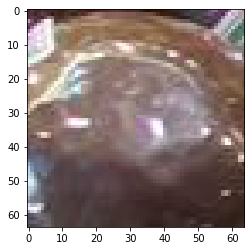

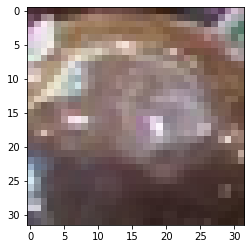

/content/Data_set_Train_x2/510/patch_508_9_7.jpg
/content/Data_set_Train_x2/510/patch_504_10_4.jpg
/content/Data_set_Train_x2/510/patch_504_8_23.jpg
/content/Data_set_Train_x2/510/patch_504_19_26.jpg
/content/Data_set_Train_x2/510/patch_504_12_27.jpg
/content/Data_set_Train_x2/510/patch_504_11_0.jpg
/content/Data_set_Train_x2/510/patch_504_14_23.jpg
/content/Data_set_Train_x2/510/patch_504_19_8.jpg
/content/Data_set_Train_x2/510/patch_505_12_26.jpg
/content/Data_set_Train_x2/510/patch_504_23_15.jpg
/content/Data_set_Train_x2/510/patch_505_5_7.jpg
/content/Data_set_Train_x2/510/patch_505_12_11.jpg
/content/Data_set_Train_x2/510/patch_505_1_11.jpg
/content/Data_set_Train_x2/510/patch_505_1_24.jpg
/content/Data_set_Train_x2/510/patch_505_3_10.jpg
/content/Data_set_Train_x2/510/patch_505_3_27.jpg
/content/Data_set_Train_x2/510/patch_505_14_15.jpg
/content/Data_set_Train_x2/510/patch_505_9_1.jpg
/content/Data_set_Train_x2/510/patch_505_12_22.jpg
/content/Data_set_Train_x2/510/patch_505_7_27

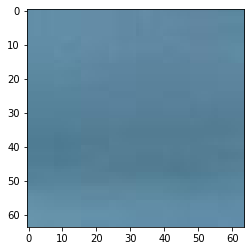

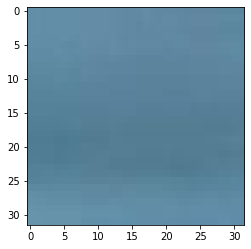

/content/Data_set_Train_x2/510/patch_505_3_23.jpg
/content/Data_set_Train_x2/510/patch_505_10_21.jpg
/content/Data_set_Train_x2/510/patch_505_0_30.jpg
/content/Data_set_Train_x2/510/patch_505_14_12.jpg
/content/Data_set_Train_x2/510/patch_505_4_5.jpg
/content/Data_set_Train_x2/510/patch_505_14_18.jpg
/content/Data_set_Train_x2/510/patch_504_23_21.jpg
/content/Data_set_Train_x2/510/patch_505_9_27.jpg
/content/Data_set_Train_x2/510/patch_505_11_9.jpg
/content/Data_set_Train_x2/510/patch_505_2_13.jpg
/content/Data_set_Train_x2/510/patch_505_14_4.jpg
/content/Data_set_Train_x2/510/patch_505_10_2.jpg
/content/Data_set_Train_x2/510/patch_505_6_12.jpg
/content/Data_set_Train_x2/510/patch_505_5_19.jpg
/content/Data_set_Train_x2/510/patch_505_0_26.jpg
/content/Data_set_Train_x2/510/patch_505_9_5.jpg
/content/Data_set_Train_x2/510/patch_505_11_5.jpg
/content/Data_set_Train_x2/510/patch_506_9_16.jpg
/content/Data_set_Train_x2/510/patch_506_11_12.jpg
/content/Data_set_Train_x2/510/patch_506_9_2.jp

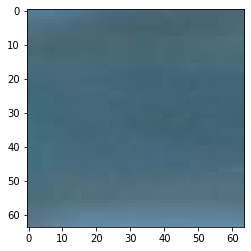

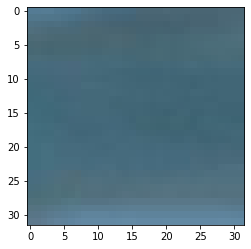

/content/Data_set_Train_x2/510/patch_505_17_26.jpg
/content/Data_set_Train_x2/510/patch_502_18_5.jpg
/content/Data_set_Train_x2/510/patch_503_4_16.jpg
/content/Data_set_Train_x2/510/patch_503_2_30.jpg
/content/Data_set_Train_x2/510/patch_503_1_14.jpg
/content/Data_set_Train_x2/510/patch_503_2_28.jpg
/content/Data_set_Train_x2/510/patch_502_19_17.jpg
/content/Data_set_Train_x2/510/patch_502_18_7.jpg
/content/Data_set_Train_x2/510/patch_502_20_27.jpg
/content/Data_set_Train_x2/510/patch_502_15_16.jpg
/content/Data_set_Train_x2/510/patch_502_19_18.jpg
/content/Data_set_Train_x2/510/patch_503_1_17.jpg
/content/Data_set_Train_x2/510/patch_503_2_21.jpg
/content/Data_set_Train_x2/510/patch_503_4_22.jpg
/content/Data_set_Train_x2/510/patch_502_15_9.jpg
/content/Data_set_Train_x2/510/patch_503_2_9.jpg
/content/Data_set_Train_x2/510/patch_502_20_6.jpg
/content/Data_set_Train_x2/510/patch_502_13_22.jpg
/content/Data_set_Train_x2/510/patch_502_20_11.jpg
/content/Data_set_Train_x2/510/patch_503_7_2

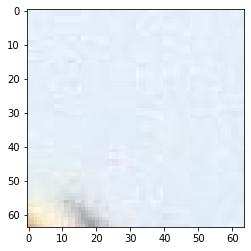

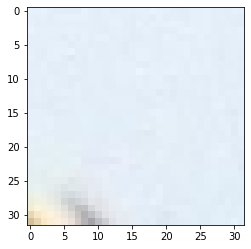

/content/Data_set_Train_x2/510/patch_504_0_18.jpg
/content/Data_set_Train_x2/510/patch_504_5_13.jpg
/content/Data_set_Train_x2/510/patch_503_16_25.jpg
/content/Data_set_Train_x2/510/patch_503_13_3.jpg
/content/Data_set_Train_x2/510/patch_504_2_9.jpg
/content/Data_set_Train_x2/510/patch_503_16_1.jpg
/content/Data_set_Train_x2/510/patch_503_14_20.jpg
/content/Data_set_Train_x2/510/patch_503_11_26.jpg
/content/Data_set_Train_x2/510/patch_503_12_13.jpg
/content/Data_set_Train_x2/510/patch_504_0_4.jpg
/content/Data_set_Train_x2/510/patch_503_11_28.jpg
/content/Data_set_Train_x2/510/patch_504_5_16.jpg
/content/Data_set_Train_x2/510/patch_503_14_22.jpg
/content/Data_set_Train_x2/510/patch_503_17_22.jpg
/content/Data_set_Train_x2/510/patch_503_16_19.jpg
/content/Data_set_Train_x2/510/patch_503_15_20.jpg
/content/Data_set_Train_x2/510/patch_504_1_7.jpg
/content/Data_set_Train_x2/510/patch_504_7_20.jpg
/content/Data_set_Train_x2/510/patch_504_20_9.jpg
/content/Data_set_Train_x2/510/patch_504_20_

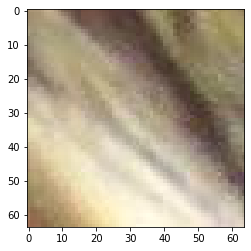

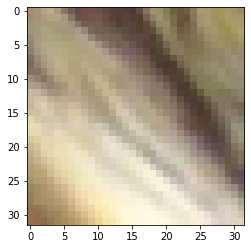

/content/Data_set_Train_x2/510/patch_504_21_15.jpg
/content/Data_set_Train_x2/510/patch_501_7_10.jpg
/content/Data_set_Train_x2/510/patch_501_7_9.jpg
/content/Data_set_Train_x2/510/patch_501_16_9.jpg
/content/Data_set_Train_x2/510/patch_501_11_10.jpg
/content/Data_set_Train_x2/510/patch_501_13_27.jpg
/content/Data_set_Train_x2/510/patch_501_8_29.jpg
/content/Data_set_Train_x2/510/patch_501_4_12.jpg
/content/Data_set_Train_x2/510/patch_501_4_25.jpg
/content/Data_set_Train_x2/510/patch_501_16_7.jpg
/content/Data_set_Train_x2/510/patch_501_13_10.jpg
/content/Data_set_Train_x2/510/patch_501_11_12.jpg
/content/Data_set_Train_x2/510/patch_501_2_0.jpg
/content/Data_set_Train_x2/510/patch_501_15_22.jpg
/content/Data_set_Train_x2/510/patch_501_14_4.jpg
/content/Data_set_Train_x2/510/patch_501_15_28.jpg
/content/Data_set_Train_x2/510/patch_502_4_13.jpg
/content/Data_set_Train_x2/510/patch_502_5_25.jpg
/content/Data_set_Train_x2/510/patch_502_5_12.jpg
/content/Data_set_Train_x2/510/patch_502_4_27

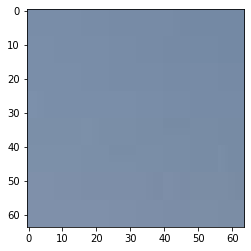

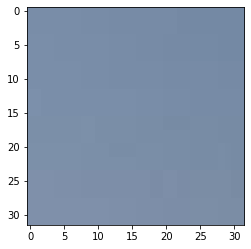

/content/Data_set_Train_x2/510/patch_502_7_30.jpg
/content/Data_set_Train_x2/510/patch_502_4_25.jpg
/content/Data_set_Train_x2/510/patch_502_4_29.jpg
/content/Data_set_Train_x2/510/patch_502_2_1.jpg
/content/Data_set_Train_x2/510/patch_502_12_30.jpg
/content/Data_set_Train_x2/510/patch_502_7_5.jpg
/content/Data_set_Train_x2/510/patch_502_11_26.jpg
/content/Data_set_Train_x2/510/patch_502_2_12.jpg
/content/Data_set_Train_x2/510/patch_501_18_25.jpg
/content/Data_set_Train_x2/510/patch_502_0_9.jpg
/content/Data_set_Train_x2/510/patch_501_18_12.jpg
/content/Data_set_Train_x2/510/patch_502_2_7.jpg
/content/Data_set_Train_x2/510/patch_502_2_17.jpg
/content/Data_set_Train_x2/510/patch_502_5_5.jpg
/content/Data_set_Train_x2/510/patch_501_19_2.jpg
/content/Data_set_Train_x2/510/patch_502_6_23.jpg
/content/Data_set_Train_x2/510/patch_502_10_5.jpg
/content/Data_set_Train_x2/510/patch_502_7_26.jpg
/content/Data_set_Train_x2/510/patch_502_3_14.jpg
/content/Data_set_Train_x2/510/patch_502_13_1.jpg
/

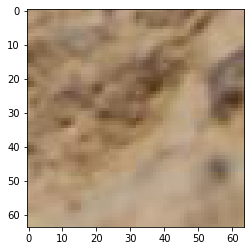

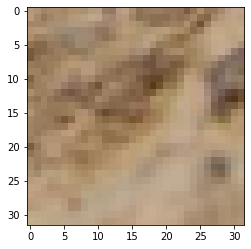

/content/Data_set_Train_x2/510/patch_502_19_27.jpg
/content/Data_set_Train_x2/510/patch_500_2_27.jpg
/content/Data_set_Train_x2/510/patch_500_0_16.jpg
/content/Data_set_Train_x2/510/patch_500_7_9.jpg
/content/Data_set_Train_x2/510/patch_500_2_23.jpg
/content/Data_set_Train_x2/510/patch_500_5_6.jpg
/content/Data_set_Train_x2/510/patch_500_7_6.jpg
/content/Data_set_Train_x2/510/patch_500_2_4.jpg
/content/Data_set_Train_x2/510/patch_500_3_13.jpg
/content/Data_set_Train_x2/510/patch_500_4_24.jpg
/content/Data_set_Train_x2/510/patch_500_4_6.jpg
/content/Data_set_Train_x2/510/patch_500_6_3.jpg
/content/Data_set_Train_x2/510/patch_500_3_16.jpg
/content/Data_set_Train_x2/510/patch_500_5_26.jpg
/content/Data_set_Train_x2/510/patch_500_2_20.jpg
/content/Data_set_Train_x2/510/patch_500_4_3.jpg
/content/Data_set_Train_x2/510/patch_500_1_21.jpg
/content/Data_set_Train_x2/510/patch_500_0_0.jpg
/content/Data_set_Train_x2/510/patch_500_2_10.jpg
/content/Data_set_Train_x2/510/patch_500_2_15.jpg
/conten

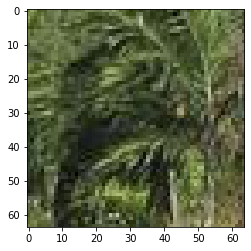

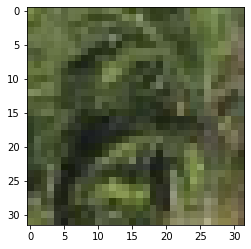

/content/Data_set_Train_x2/510/patch_500_11_14.jpg
/content/Data_set_Train_x2/510/patch_500_20_22.jpg
/content/Data_set_Train_x2/510/patch_500_7_28.jpg
/content/Data_set_Train_x2/510/patch_500_14_16.jpg
/content/Data_set_Train_x2/510/patch_500_20_30.jpg
/content/Data_set_Train_x2/510/patch_500_14_14.jpg
/content/Data_set_Train_x2/510/patch_500_17_30.jpg
/content/Data_set_Train_x2/510/patch_501_11_0.jpg
/content/Data_set_Train_x2/510/patch_501_6_27.jpg
/content/Data_set_Train_x2/510/patch_501_15_6.jpg
/content/Data_set_Train_x2/510/patch_501_14_13.jpg
/content/Data_set_Train_x2/510/patch_501_9_17.jpg
/content/Data_set_Train_x2/510/patch_501_17_20.jpg
/content/Data_set_Train_x2/510/patch_501_10_21.jpg
/content/Data_set_Train_x2/510/patch_501_4_10.jpg
/content/Data_set_Train_x2/510/patch_501_17_27.jpg
/content/Data_set_Train_x2/510/patch_501_11_1.jpg
/content/Data_set_Train_x2/510/patch_501_16_13.jpg
/content/Data_set_Train_x2/510/patch_501_15_11.jpg
/content/Data_set_Train_x2/510/patch_5

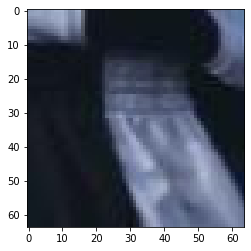

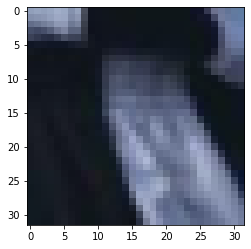

/content/Data_set_Train_x2/510/patch_501_11_3.jpg
/content/Data_set_Train_x2/510/patch_500_3_26.jpg
/content/Data_set_Train_x2/510/patch_500_6_5.jpg
/content/Data_set_Train_x2/510/patch_500_2_12.jpg
/content/Data_set_Train_x2/510/patch_500_5_8.jpg
/content/Data_set_Train_x2/510/patch_500_2_19.jpg
/content/Data_set_Train_x2/510/patch_500_0_26.jpg
/content/Data_set_Train_x2/510/patch_500_6_14.jpg
/content/Data_set_Train_x2/510/patch_500_0_8.jpg
/content/Data_set_Train_x2/510/patch_500_3_25.jpg
/content/Data_set_Train_x2/510/patch_500_4_15.jpg
/content/Data_set_Train_x2/510/patch_500_0_3.jpg
/content/Data_set_Train_x2/510/patch_500_3_1.jpg
/content/Data_set_Train_x2/510/patch_500_2_13.jpg
/content/Data_set_Train_x2/510/patch_500_3_29.jpg
/content/Data_set_Train_x2/510/patch_500_3_21.jpg
/content/Data_set_Train_x2/510/patch_500_4_25.jpg
/content/Data_set_Train_x2/510/patch_500_6_7.jpg
/content/Data_set_Train_x2/510/patch_500_3_24.jpg
/content/Data_set_Train_x2/510/patch_500_5_13.jpg
/conte

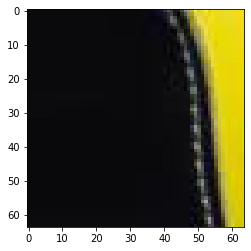

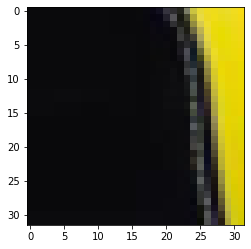

/content/Data_set_Train_x2/520/patch_519_8_17.jpg
/content/Data_set_Train_x2/520/patch_519_5_10.jpg
/content/Data_set_Train_x2/520/patch_519_2_19.jpg
/content/Data_set_Train_x2/520/patch_519_14_5.jpg
/content/Data_set_Train_x2/520/patch_519_8_27.jpg
/content/Data_set_Train_x2/520/patch_519_2_16.jpg
/content/Data_set_Train_x2/520/patch_519_11_22.jpg
/content/Data_set_Train_x2/520/patch_519_5_5.jpg
/content/Data_set_Train_x2/520/patch_519_10_10.jpg
/content/Data_set_Train_x2/520/patch_519_16_14.jpg
/content/Data_set_Train_x2/520/patch_519_13_29.jpg
/content/Data_set_Train_x2/520/patch_519_13_17.jpg
/content/Data_set_Train_x2/520/patch_519_11_15.jpg
/content/Data_set_Train_x2/520/patch_519_12_22.jpg
/content/Data_set_Train_x2/520/patch_519_14_23.jpg
/content/Data_set_Train_x2/520/patch_519_8_13.jpg
/content/Data_set_Train_x2/520/patch_519_9_9.jpg
/content/Data_set_Train_x2/520/patch_519_14_19.jpg
/content/Data_set_Train_x2/520/patch_519_13_11.jpg
/content/Data_set_Train_x2/520/patch_519_1

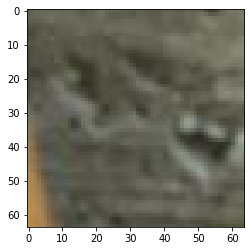

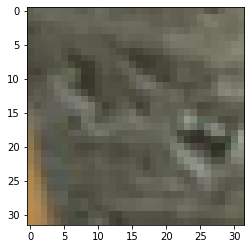

/content/Data_set_Train_x2/520/patch_519_20_12.jpg
/content/Data_set_Train_x2/520/patch_517_13_16.jpg
/content/Data_set_Train_x2/520/patch_517_5_20.jpg
/content/Data_set_Train_x2/520/patch_517_25_2.jpg
/content/Data_set_Train_x2/520/patch_517_24_4.jpg
/content/Data_set_Train_x2/520/patch_517_7_0.jpg
/content/Data_set_Train_x2/520/patch_517_24_14.jpg
/content/Data_set_Train_x2/520/patch_517_22_1.jpg
/content/Data_set_Train_x2/520/patch_517_7_5.jpg
/content/Data_set_Train_x2/520/patch_517_20_15.jpg
/content/Data_set_Train_x2/520/patch_517_23_22.jpg
/content/Data_set_Train_x2/520/patch_517_21_19.jpg
/content/Data_set_Train_x2/520/patch_517_7_1.jpg
/content/Data_set_Train_x2/520/patch_517_14_5.jpg
/content/Data_set_Train_x2/520/patch_517_25_21.jpg
/content/Data_set_Train_x2/520/patch_517_10_6.jpg
/content/Data_set_Train_x2/520/patch_517_12_8.jpg
/content/Data_set_Train_x2/520/patch_517_19_18.jpg
/content/Data_set_Train_x2/520/patch_517_23_1.jpg
/content/Data_set_Train_x2/520/patch_517_15_1

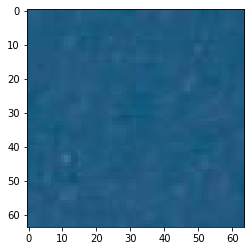

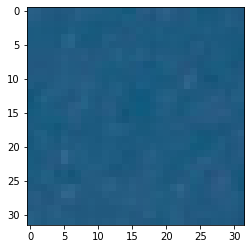

/content/Data_set_Train_x2/520/patch_518_1_25.jpg
/content/Data_set_Train_x2/520/patch_517_26_1.jpg
/content/Data_set_Train_x2/520/patch_517_30_8.jpg
/content/Data_set_Train_x2/520/patch_518_2_3.jpg
/content/Data_set_Train_x2/520/patch_518_3_19.jpg
/content/Data_set_Train_x2/520/patch_518_0_24.jpg
/content/Data_set_Train_x2/520/patch_517_29_19.jpg
/content/Data_set_Train_x2/520/patch_518_4_12.jpg
/content/Data_set_Train_x2/520/patch_518_4_2.jpg
/content/Data_set_Train_x2/520/patch_517_29_13.jpg
/content/Data_set_Train_x2/520/patch_517_26_17.jpg
/content/Data_set_Train_x2/520/patch_518_4_30.jpg
/content/Data_set_Train_x2/520/patch_518_2_26.jpg
/content/Data_set_Train_x2/520/patch_518_0_10.jpg
/content/Data_set_Train_x2/520/patch_518_2_14.jpg
/content/Data_set_Train_x2/520/patch_518_3_7.jpg
/content/Data_set_Train_x2/520/patch_517_28_16.jpg
/content/Data_set_Train_x2/520/patch_517_29_10.jpg
/content/Data_set_Train_x2/520/patch_518_4_27.jpg
/content/Data_set_Train_x2/520/patch_517_29_8.jp

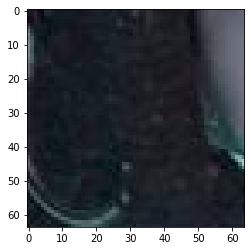

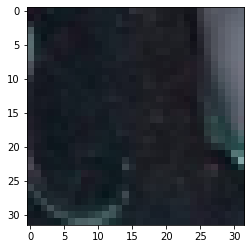

/content/Data_set_Train_x2/520/patch_518_10_15.jpg
/content/Data_set_Train_x2/520/patch_516_11_30.jpg
/content/Data_set_Train_x2/520/patch_515_19_15.jpg
/content/Data_set_Train_x2/520/patch_516_10_5.jpg
/content/Data_set_Train_x2/520/patch_516_2_24.jpg
/content/Data_set_Train_x2/520/patch_516_1_29.jpg
/content/Data_set_Train_x2/520/patch_515_20_18.jpg
/content/Data_set_Train_x2/520/patch_516_2_9.jpg
/content/Data_set_Train_x2/520/patch_516_1_23.jpg
/content/Data_set_Train_x2/520/patch_516_8_23.jpg
/content/Data_set_Train_x2/520/patch_515_17_9.jpg
/content/Data_set_Train_x2/520/patch_516_4_4.jpg
/content/Data_set_Train_x2/520/patch_516_0_18.jpg
/content/Data_set_Train_x2/520/patch_516_3_0.jpg
/content/Data_set_Train_x2/520/patch_515_18_2.jpg
/content/Data_set_Train_x2/520/patch_516_0_22.jpg
/content/Data_set_Train_x2/520/patch_515_20_8.jpg
/content/Data_set_Train_x2/520/patch_515_19_5.jpg
/content/Data_set_Train_x2/520/patch_515_20_5.jpg
/content/Data_set_Train_x2/520/patch_516_2_10.jpg

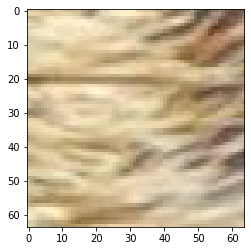

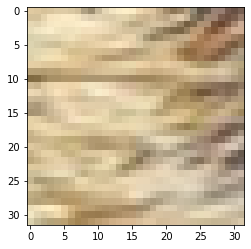

/content/Data_set_Train_x2/520/patch_516_22_30.jpg
/content/Data_set_Train_x2/520/patch_516_19_17.jpg
/content/Data_set_Train_x2/520/patch_517_5_18.jpg
/content/Data_set_Train_x2/520/patch_516_17_7.jpg
/content/Data_set_Train_x2/520/patch_516_23_10.jpg
/content/Data_set_Train_x2/520/patch_516_14_9.jpg
/content/Data_set_Train_x2/520/patch_517_2_4.jpg
/content/Data_set_Train_x2/520/patch_516_23_6.jpg
/content/Data_set_Train_x2/520/patch_516_20_1.jpg
/content/Data_set_Train_x2/520/patch_516_21_16.jpg
/content/Data_set_Train_x2/520/patch_516_23_14.jpg
/content/Data_set_Train_x2/520/patch_517_4_18.jpg
/content/Data_set_Train_x2/520/patch_516_23_20.jpg
/content/Data_set_Train_x2/520/patch_516_15_27.jpg
/content/Data_set_Train_x2/520/patch_517_5_13.jpg
/content/Data_set_Train_x2/520/patch_516_15_1.jpg
/content/Data_set_Train_x2/520/patch_516_12_27.jpg
/content/Data_set_Train_x2/520/patch_516_20_8.jpg
/content/Data_set_Train_x2/520/patch_517_0_5.jpg
/content/Data_set_Train_x2/520/patch_516_13_

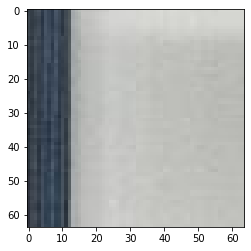

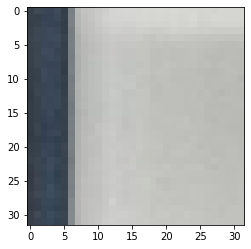

/content/Data_set_Train_x2/520/patch_517_11_24.jpg
/content/Data_set_Train_x2/520/patch_514_4_6.jpg
/content/Data_set_Train_x2/520/patch_514_16_4.jpg
/content/Data_set_Train_x2/520/patch_514_23_11.jpg
/content/Data_set_Train_x2/520/patch_514_20_0.jpg
/content/Data_set_Train_x2/520/patch_514_4_18.jpg
/content/Data_set_Train_x2/520/patch_514_29_16.jpg
/content/Data_set_Train_x2/520/patch_514_9_3.jpg
/content/Data_set_Train_x2/520/patch_514_8_17.jpg
/content/Data_set_Train_x2/520/patch_514_28_2.jpg
/content/Data_set_Train_x2/520/patch_514_19_9.jpg
/content/Data_set_Train_x2/520/patch_514_18_5.jpg
/content/Data_set_Train_x2/520/patch_514_11_10.jpg
/content/Data_set_Train_x2/520/patch_514_21_15.jpg
/content/Data_set_Train_x2/520/patch_514_6_16.jpg
/content/Data_set_Train_x2/520/patch_514_24_1.jpg
/content/Data_set_Train_x2/520/patch_514_17_12.jpg
/content/Data_set_Train_x2/520/patch_514_9_18.jpg
/content/Data_set_Train_x2/520/patch_514_17_4.jpg
/content/Data_set_Train_x2/520/patch_514_5_3.j

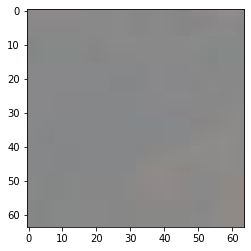

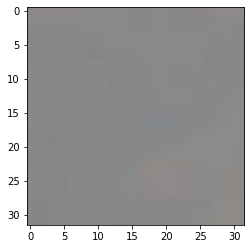

/content/Data_set_Train_x2/520/patch_515_9_4.jpg
/content/Data_set_Train_x2/520/patch_515_16_8.jpg
/content/Data_set_Train_x2/520/patch_515_4_7.jpg
/content/Data_set_Train_x2/520/patch_515_6_23.jpg
/content/Data_set_Train_x2/520/patch_515_8_8.jpg
/content/Data_set_Train_x2/520/patch_515_15_10.jpg
/content/Data_set_Train_x2/520/patch_515_16_1.jpg
/content/Data_set_Train_x2/520/patch_515_12_2.jpg
/content/Data_set_Train_x2/520/patch_515_8_21.jpg
/content/Data_set_Train_x2/520/patch_515_1_4.jpg
/content/Data_set_Train_x2/520/patch_515_15_18.jpg
/content/Data_set_Train_x2/520/patch_515_12_3.jpg
/content/Data_set_Train_x2/520/patch_515_10_4.jpg
/content/Data_set_Train_x2/520/patch_515_11_3.jpg
/content/Data_set_Train_x2/520/patch_515_9_29.jpg
/content/Data_set_Train_x2/520/patch_515_2_29.jpg
/content/Data_set_Train_x2/520/patch_515_5_19.jpg
/content/Data_set_Train_x2/520/patch_515_8_1.jpg
/content/Data_set_Train_x2/520/patch_515_3_18.jpg
/content/Data_set_Train_x2/520/patch_515_1_11.jpg
/co

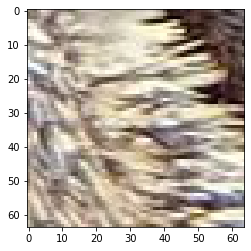

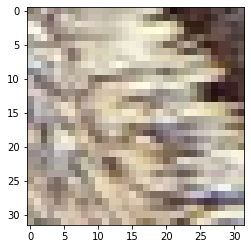

/content/Data_set_Train_x2/520/patch_516_4_18.jpg
/content/Data_set_Train_x2/520/patch_512_18_13.jpg
/content/Data_set_Train_x2/520/patch_512_10_13.jpg
/content/Data_set_Train_x2/520/patch_513_0_26.jpg
/content/Data_set_Train_x2/520/patch_513_3_14.jpg
/content/Data_set_Train_x2/520/patch_512_17_28.jpg
/content/Data_set_Train_x2/520/patch_513_2_0.jpg
/content/Data_set_Train_x2/520/patch_512_10_14.jpg
/content/Data_set_Train_x2/520/patch_513_0_12.jpg
/content/Data_set_Train_x2/520/patch_512_15_20.jpg
/content/Data_set_Train_x2/520/patch_512_16_0.jpg
/content/Data_set_Train_x2/520/patch_513_2_5.jpg
/content/Data_set_Train_x2/520/patch_512_12_23.jpg
/content/Data_set_Train_x2/520/patch_512_20_2.jpg
/content/Data_set_Train_x2/520/patch_512_13_28.jpg
/content/Data_set_Train_x2/520/patch_512_15_16.jpg
/content/Data_set_Train_x2/520/patch_512_20_22.jpg
/content/Data_set_Train_x2/520/patch_512_15_8.jpg
/content/Data_set_Train_x2/520/patch_512_20_25.jpg
/content/Data_set_Train_x2/520/patch_513_1

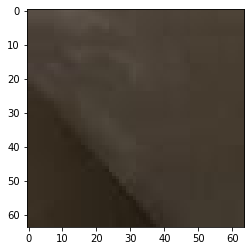

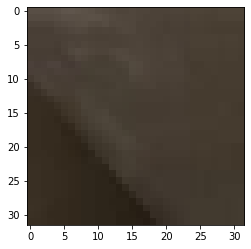

/content/Data_set_Train_x2/520/patch_513_7_11.jpg
/content/Data_set_Train_x2/520/patch_513_4_18.jpg
/content/Data_set_Train_x2/520/patch_513_9_5.jpg
/content/Data_set_Train_x2/520/patch_513_12_4.jpg
/content/Data_set_Train_x2/520/patch_513_12_2.jpg
/content/Data_set_Train_x2/520/patch_513_11_14.jpg
/content/Data_set_Train_x2/520/patch_513_4_10.jpg
/content/Data_set_Train_x2/520/patch_513_10_2.jpg
/content/Data_set_Train_x2/520/patch_513_10_12.jpg
/content/Data_set_Train_x2/520/patch_513_19_30.jpg
/content/Data_set_Train_x2/520/patch_513_12_14.jpg
/content/Data_set_Train_x2/520/patch_513_5_27.jpg
/content/Data_set_Train_x2/520/patch_513_20_0.jpg
/content/Data_set_Train_x2/520/patch_513_5_22.jpg
/content/Data_set_Train_x2/520/patch_513_8_19.jpg
/content/Data_set_Train_x2/520/patch_513_6_27.jpg
/content/Data_set_Train_x2/520/patch_513_18_11.jpg
/content/Data_set_Train_x2/520/patch_513_15_30.jpg
/content/Data_set_Train_x2/520/patch_513_12_1.jpg
/content/Data_set_Train_x2/520/patch_513_20_3

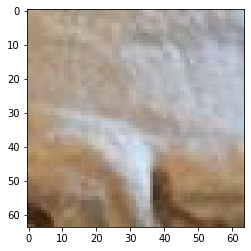

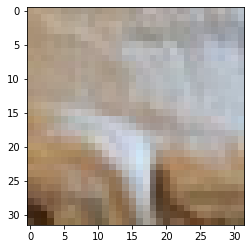

/content/Data_set_Train_x2/520/patch_514_4_10.jpg
/content/Data_set_Train_x2/520/patch_511_1_17.jpg
/content/Data_set_Train_x2/520/patch_511_11_5.jpg
/content/Data_set_Train_x2/520/patch_511_5_2.jpg
/content/Data_set_Train_x2/520/patch_510_19_7.jpg
/content/Data_set_Train_x2/520/patch_510_18_29.jpg
/content/Data_set_Train_x2/520/patch_511_9_2.jpg
/content/Data_set_Train_x2/520/patch_511_2_22.jpg
/content/Data_set_Train_x2/520/patch_511_1_8.jpg
/content/Data_set_Train_x2/520/patch_511_9_16.jpg
/content/Data_set_Train_x2/520/patch_511_0_28.jpg
/content/Data_set_Train_x2/520/patch_511_12_10.jpg
/content/Data_set_Train_x2/520/patch_511_4_30.jpg
/content/Data_set_Train_x2/520/patch_511_0_8.jpg
/content/Data_set_Train_x2/520/patch_511_1_22.jpg
/content/Data_set_Train_x2/520/patch_511_11_7.jpg
/content/Data_set_Train_x2/520/patch_511_2_4.jpg
/content/Data_set_Train_x2/520/patch_511_10_18.jpg
/content/Data_set_Train_x2/520/patch_511_9_9.jpg
/content/Data_set_Train_x2/520/patch_511_7_23.jpg
/co

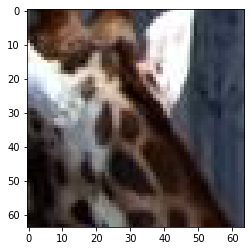

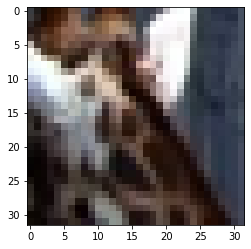

/content/Data_set_Train_x2/520/patch_512_6_27.jpg
/content/Data_set_Train_x2/520/patch_511_20_14.jpg
/content/Data_set_Train_x2/520/patch_512_4_1.jpg
/content/Data_set_Train_x2/520/patch_511_20_18.jpg
/content/Data_set_Train_x2/520/patch_511_18_3.jpg
/content/Data_set_Train_x2/520/patch_512_7_18.jpg
/content/Data_set_Train_x2/520/patch_512_0_23.jpg
/content/Data_set_Train_x2/520/patch_512_1_8.jpg
/content/Data_set_Train_x2/520/patch_512_2_12.jpg
/content/Data_set_Train_x2/520/patch_512_3_3.jpg
/content/Data_set_Train_x2/520/patch_511_18_0.jpg
/content/Data_set_Train_x2/520/patch_512_2_22.jpg
/content/Data_set_Train_x2/520/patch_512_4_4.jpg
/content/Data_set_Train_x2/520/patch_512_1_30.jpg
/content/Data_set_Train_x2/520/patch_511_16_24.jpg
/content/Data_set_Train_x2/520/patch_511_17_3.jpg
/content/Data_set_Train_x2/520/patch_512_2_4.jpg
/content/Data_set_Train_x2/520/patch_512_6_23.jpg
/content/Data_set_Train_x2/520/patch_512_5_17.jpg
/content/Data_set_Train_x2/520/patch_512_7_7.jpg
/co

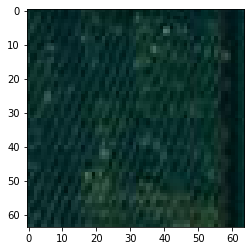

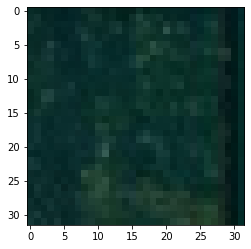

/content/Data_set_Train_x2/520/patch_512_10_21.jpg
/content/Data_set_Train_x2/520/patch_510_0_10.jpg
/content/Data_set_Train_x2/520/patch_510_0_22.jpg
/content/Data_set_Train_x2/520/patch_510_1_3.jpg
/content/Data_set_Train_x2/520/patch_510_1_1.jpg
/content/Data_set_Train_x2/520/patch_510_0_20.jpg
/content/Data_set_Train_x2/520/patch_510_0_12.jpg
/content/Data_set_Train_x2/520/patch_510_0_13.jpg
/content/Data_set_Train_x2/520/patch_510_0_26.jpg
/content/Data_set_Train_x2/520/patch_510_0_18.jpg
/content/Data_set_Train_x2/520/patch_510_0_7.jpg
/content/Data_set_Train_x2/520/patch_510_0_14.jpg
/content/Data_set_Train_x2/520/patch_510_0_16.jpg
/content/Data_set_Train_x2/520/patch_510_0_30.jpg
/content/Data_set_Train_x2/520/patch_510_0_3.jpg
/content/Data_set_Train_x2/520/patch_510_0_29.jpg
/content/Data_set_Train_x2/520/patch_510_0_4.jpg
/content/Data_set_Train_x2/520/patch_510_0_23.jpg
/content/Data_set_Train_x2/520/patch_510_1_2.jpg
/content/Data_set_Train_x2/520/patch_510_0_11.jpg
/cont

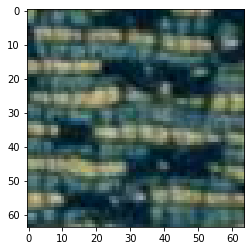

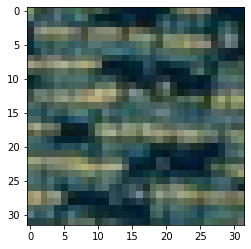

/content/Data_set_Train_x2/520/patch_510_10_28.jpg
/content/Data_set_Train_x2/520/patch_510_16_4.jpg
/content/Data_set_Train_x2/520/patch_510_11_15.jpg
/content/Data_set_Train_x2/520/patch_510_14_5.jpg
/content/Data_set_Train_x2/520/patch_510_11_26.jpg
/content/Data_set_Train_x2/520/patch_510_15_20.jpg
/content/Data_set_Train_x2/520/patch_510_11_9.jpg
/content/Data_set_Train_x2/520/patch_510_8_23.jpg
/content/Data_set_Train_x2/520/patch_510_13_10.jpg
/content/Data_set_Train_x2/520/patch_510_5_5.jpg
/content/Data_set_Train_x2/520/patch_510_6_29.jpg
/content/Data_set_Train_x2/520/patch_510_15_6.jpg
/content/Data_set_Train_x2/520/patch_510_2_14.jpg
/content/Data_set_Train_x2/520/patch_510_7_25.jpg
/content/Data_set_Train_x2/520/patch_510_5_17.jpg
/content/Data_set_Train_x2/520/patch_510_12_8.jpg
/content/Data_set_Train_x2/520/patch_510_4_9.jpg
/content/Data_set_Train_x2/520/patch_510_10_17.jpg
/content/Data_set_Train_x2/520/patch_510_1_21.jpg
/content/Data_set_Train_x2/520/patch_510_17_1.

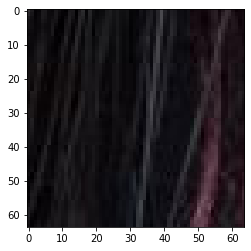

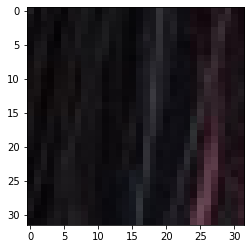

/content/Data_set_Train_x2/530/patch_529_15_26.jpg
/content/Data_set_Train_x2/530/patch_529_14_14.jpg
/content/Data_set_Train_x2/530/patch_529_4_8.jpg
/content/Data_set_Train_x2/530/patch_529_13_22.jpg
/content/Data_set_Train_x2/530/patch_529_10_3.jpg
/content/Data_set_Train_x2/530/patch_529_15_7.jpg
/content/Data_set_Train_x2/530/patch_529_16_24.jpg
/content/Data_set_Train_x2/530/patch_529_12_1.jpg
/content/Data_set_Train_x2/530/patch_529_16_11.jpg
/content/Data_set_Train_x2/530/patch_529_11_4.jpg
/content/Data_set_Train_x2/530/patch_529_15_13.jpg
/content/Data_set_Train_x2/530/patch_529_6_18.jpg
/content/Data_set_Train_x2/530/patch_529_11_6.jpg
/content/Data_set_Train_x2/530/patch_529_16_27.jpg
/content/Data_set_Train_x2/530/patch_529_9_6.jpg
/content/Data_set_Train_x2/530/patch_529_14_10.jpg
/content/Data_set_Train_x2/530/patch_529_13_9.jpg
/content/Data_set_Train_x2/530/patch_529_13_24.jpg
/content/Data_set_Train_x2/530/patch_529_3_21.jpg
/content/Data_set_Train_x2/530/patch_529_7_

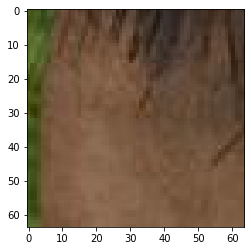

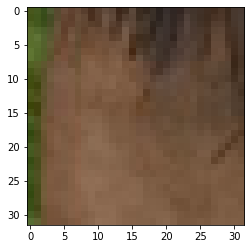

/content/Data_set_Train_x2/530/patch_529_18_23.jpg
/content/Data_set_Train_x2/530/patch_526_19_13.jpg
/content/Data_set_Train_x2/530/patch_527_5_13.jpg
/content/Data_set_Train_x2/530/patch_527_21_2.jpg
/content/Data_set_Train_x2/530/patch_527_21_6.jpg
/content/Data_set_Train_x2/530/patch_527_17_0.jpg
/content/Data_set_Train_x2/530/patch_526_19_8.jpg
/content/Data_set_Train_x2/530/patch_527_23_5.jpg
/content/Data_set_Train_x2/530/patch_527_17_11.jpg
/content/Data_set_Train_x2/530/patch_527_1_9.jpg
/content/Data_set_Train_x2/530/patch_527_16_1.jpg
/content/Data_set_Train_x2/530/patch_527_12_10.jpg
/content/Data_set_Train_x2/530/patch_527_0_3.jpg
/content/Data_set_Train_x2/530/patch_527_0_9.jpg
/content/Data_set_Train_x2/530/patch_527_15_14.jpg
/content/Data_set_Train_x2/530/patch_527_18_16.jpg
/content/Data_set_Train_x2/530/patch_527_5_3.jpg
/content/Data_set_Train_x2/530/patch_527_13_7.jpg
/content/Data_set_Train_x2/530/patch_527_14_15.jpg
/content/Data_set_Train_x2/530/patch_526_17_26.

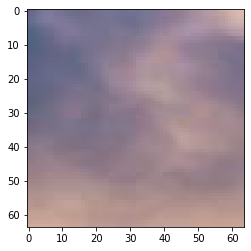

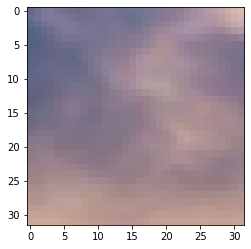

/content/Data_set_Train_x2/530/patch_528_2_18.jpg
/content/Data_set_Train_x2/530/patch_528_8_6.jpg
/content/Data_set_Train_x2/530/patch_528_5_10.jpg
/content/Data_set_Train_x2/530/patch_528_8_26.jpg
/content/Data_set_Train_x2/530/patch_528_2_13.jpg
/content/Data_set_Train_x2/530/patch_528_1_23.jpg
/content/Data_set_Train_x2/530/patch_528_5_28.jpg
/content/Data_set_Train_x2/530/patch_528_6_29.jpg
/content/Data_set_Train_x2/530/patch_528_9_2.jpg
/content/Data_set_Train_x2/530/patch_528_6_22.jpg
/content/Data_set_Train_x2/530/patch_528_9_12.jpg
/content/Data_set_Train_x2/530/patch_528_11_14.jpg
/content/Data_set_Train_x2/530/patch_528_3_1.jpg
/content/Data_set_Train_x2/530/patch_528_0_0.jpg
/content/Data_set_Train_x2/530/patch_528_7_2.jpg
/content/Data_set_Train_x2/530/patch_528_7_16.jpg
/content/Data_set_Train_x2/530/patch_527_27_17.jpg
/content/Data_set_Train_x2/530/patch_527_25_5.jpg
/content/Data_set_Train_x2/530/patch_527_27_8.jpg
/content/Data_set_Train_x2/530/patch_528_5_12.jpg
/co

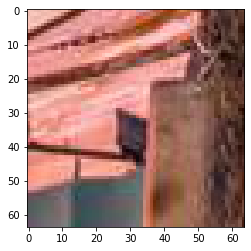

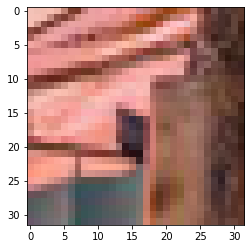

/content/Data_set_Train_x2/530/patch_528_24_29.jpg
/content/Data_set_Train_x2/530/patch_525_10_26.jpg
/content/Data_set_Train_x2/530/patch_525_8_22.jpg
/content/Data_set_Train_x2/530/patch_525_7_20.jpg
/content/Data_set_Train_x2/530/patch_525_9_5.jpg
/content/Data_set_Train_x2/530/patch_525_20_28.jpg
/content/Data_set_Train_x2/530/patch_525_7_12.jpg
/content/Data_set_Train_x2/530/patch_525_18_12.jpg
/content/Data_set_Train_x2/530/patch_525_13_20.jpg
/content/Data_set_Train_x2/530/patch_525_17_0.jpg
/content/Data_set_Train_x2/530/patch_525_19_15.jpg
/content/Data_set_Train_x2/530/patch_525_13_14.jpg
/content/Data_set_Train_x2/530/patch_525_18_21.jpg
/content/Data_set_Train_x2/530/patch_526_0_28.jpg
/content/Data_set_Train_x2/530/patch_525_20_4.jpg
/content/Data_set_Train_x2/530/patch_525_13_10.jpg
/content/Data_set_Train_x2/530/patch_525_9_2.jpg
/content/Data_set_Train_x2/530/patch_525_6_10.jpg
/content/Data_set_Train_x2/530/patch_525_20_29.jpg
/content/Data_set_Train_x2/530/patch_525_7

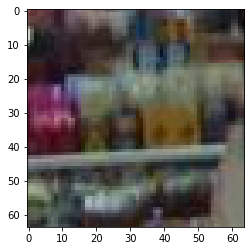

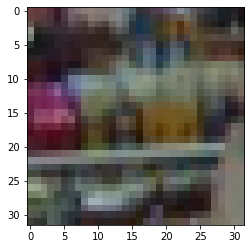

/content/Data_set_Train_x2/530/patch_526_11_0.jpg
/content/Data_set_Train_x2/530/patch_526_7_19.jpg
/content/Data_set_Train_x2/530/patch_526_7_11.jpg
/content/Data_set_Train_x2/530/patch_526_6_22.jpg
/content/Data_set_Train_x2/530/patch_526_10_8.jpg
/content/Data_set_Train_x2/530/patch_526_12_9.jpg
/content/Data_set_Train_x2/530/patch_526_13_25.jpg
/content/Data_set_Train_x2/530/patch_526_13_12.jpg
/content/Data_set_Train_x2/530/patch_526_2_4.jpg
/content/Data_set_Train_x2/530/patch_526_13_3.jpg
/content/Data_set_Train_x2/530/patch_526_5_10.jpg
/content/Data_set_Train_x2/530/patch_526_3_5.jpg
/content/Data_set_Train_x2/530/patch_526_12_19.jpg
/content/Data_set_Train_x2/530/patch_526_15_14.jpg
/content/Data_set_Train_x2/530/patch_526_11_3.jpg
/content/Data_set_Train_x2/530/patch_526_4_5.jpg
/content/Data_set_Train_x2/530/patch_526_7_2.jpg
/content/Data_set_Train_x2/530/patch_526_14_0.jpg
/content/Data_set_Train_x2/530/patch_526_15_27.jpg
/content/Data_set_Train_x2/530/patch_526_2_3.jpg


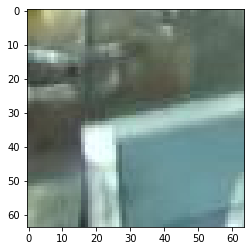

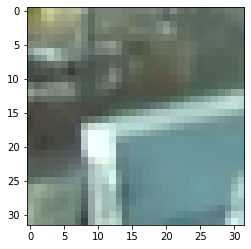

/content/Data_set_Train_x2/530/patch_526_19_3.jpg
/content/Data_set_Train_x2/530/patch_524_8_11.jpg
/content/Data_set_Train_x2/530/patch_524_4_3.jpg
/content/Data_set_Train_x2/530/patch_523_19_0.jpg
/content/Data_set_Train_x2/530/patch_524_7_5.jpg
/content/Data_set_Train_x2/530/patch_524_5_4.jpg
/content/Data_set_Train_x2/530/patch_523_19_20.jpg
/content/Data_set_Train_x2/530/patch_523_15_29.jpg
/content/Data_set_Train_x2/530/patch_524_7_28.jpg
/content/Data_set_Train_x2/530/patch_524_7_23.jpg
/content/Data_set_Train_x2/530/patch_524_9_15.jpg
/content/Data_set_Train_x2/530/patch_523_20_2.jpg
/content/Data_set_Train_x2/530/patch_523_18_20.jpg
/content/Data_set_Train_x2/530/patch_524_6_12.jpg
/content/Data_set_Train_x2/530/patch_523_15_24.jpg
/content/Data_set_Train_x2/530/patch_524_9_4.jpg
/content/Data_set_Train_x2/530/patch_523_19_28.jpg
/content/Data_set_Train_x2/530/patch_524_3_4.jpg
/content/Data_set_Train_x2/530/patch_524_2_16.jpg
/content/Data_set_Train_x2/530/patch_523_15_28.jpg

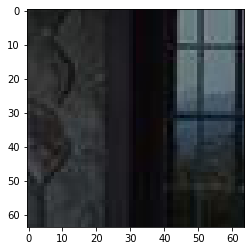

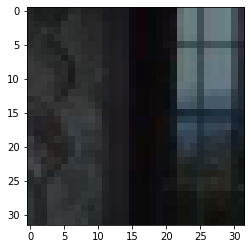

/content/Data_set_Train_x2/530/patch_524_12_14.jpg
/content/Data_set_Train_x2/530/patch_525_3_14.jpg
/content/Data_set_Train_x2/530/patch_524_13_19.jpg
/content/Data_set_Train_x2/530/patch_524_16_7.jpg
/content/Data_set_Train_x2/530/patch_524_12_23.jpg
/content/Data_set_Train_x2/530/patch_525_4_25.jpg
/content/Data_set_Train_x2/530/patch_525_5_22.jpg
/content/Data_set_Train_x2/530/patch_525_5_23.jpg
/content/Data_set_Train_x2/530/patch_524_14_4.jpg
/content/Data_set_Train_x2/530/patch_524_17_22.jpg
/content/Data_set_Train_x2/530/patch_524_11_11.jpg
/content/Data_set_Train_x2/530/patch_524_13_14.jpg
/content/Data_set_Train_x2/530/patch_525_3_30.jpg
/content/Data_set_Train_x2/530/patch_524_11_1.jpg
/content/Data_set_Train_x2/530/patch_524_14_6.jpg
/content/Data_set_Train_x2/530/patch_524_20_30.jpg
/content/Data_set_Train_x2/530/patch_525_1_12.jpg
/content/Data_set_Train_x2/530/patch_525_2_0.jpg
/content/Data_set_Train_x2/530/patch_525_4_20.jpg
/content/Data_set_Train_x2/530/patch_525_2_2

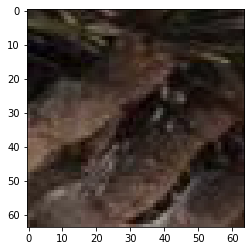

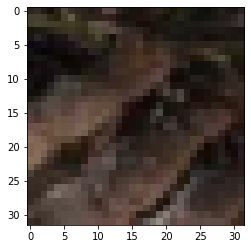

/content/Data_set_Train_x2/530/patch_525_8_29.jpg
/content/Data_set_Train_x2/530/patch_522_4_16.jpg
/content/Data_set_Train_x2/530/patch_522_13_26.jpg
/content/Data_set_Train_x2/530/patch_522_7_12.jpg
/content/Data_set_Train_x2/530/patch_522_18_20.jpg
/content/Data_set_Train_x2/530/patch_522_16_3.jpg
/content/Data_set_Train_x2/530/patch_522_5_27.jpg
/content/Data_set_Train_x2/530/patch_522_14_29.jpg
/content/Data_set_Train_x2/530/patch_522_14_15.jpg
/content/Data_set_Train_x2/530/patch_522_20_12.jpg
/content/Data_set_Train_x2/530/patch_522_14_23.jpg
/content/Data_set_Train_x2/530/patch_522_18_3.jpg
/content/Data_set_Train_x2/530/patch_522_8_9.jpg
/content/Data_set_Train_x2/530/patch_522_19_4.jpg
/content/Data_set_Train_x2/530/patch_522_15_8.jpg
/content/Data_set_Train_x2/530/patch_522_14_25.jpg
/content/Data_set_Train_x2/530/patch_522_8_17.jpg
/content/Data_set_Train_x2/530/patch_522_19_10.jpg
/content/Data_set_Train_x2/530/patch_522_14_8.jpg
/content/Data_set_Train_x2/530/patch_522_10

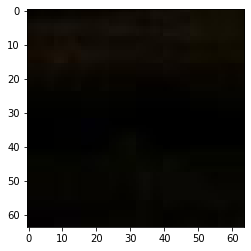

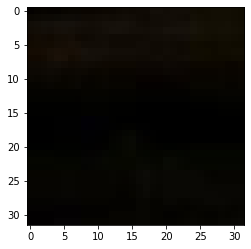

/content/Data_set_Train_x2/530/patch_523_13_28.jpg
/content/Data_set_Train_x2/530/patch_523_7_15.jpg
/content/Data_set_Train_x2/530/patch_523_4_28.jpg
/content/Data_set_Train_x2/530/patch_523_1_18.jpg
/content/Data_set_Train_x2/530/patch_523_10_14.jpg
/content/Data_set_Train_x2/530/patch_523_6_23.jpg
/content/Data_set_Train_x2/530/patch_523_11_14.jpg
/content/Data_set_Train_x2/530/patch_523_2_18.jpg
/content/Data_set_Train_x2/530/patch_523_11_24.jpg
/content/Data_set_Train_x2/530/patch_523_15_6.jpg
/content/Data_set_Train_x2/530/patch_523_4_17.jpg
/content/Data_set_Train_x2/530/patch_523_14_18.jpg
/content/Data_set_Train_x2/530/patch_523_5_3.jpg
/content/Data_set_Train_x2/530/patch_523_5_20.jpg
/content/Data_set_Train_x2/530/patch_523_3_19.jpg
/content/Data_set_Train_x2/530/patch_523_7_9.jpg
/content/Data_set_Train_x2/530/patch_523_3_2.jpg
/content/Data_set_Train_x2/530/patch_523_13_6.jpg
/content/Data_set_Train_x2/530/patch_523_12_11.jpg
/content/Data_set_Train_x2/530/patch_523_6_18.j

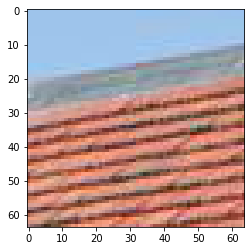

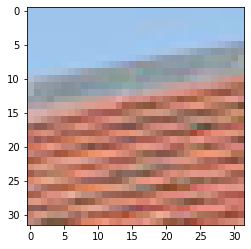

/content/Data_set_Train_x2/530/patch_524_6_13.jpg
/content/Data_set_Train_x2/530/patch_521_6_5.jpg
/content/Data_set_Train_x2/530/patch_520_20_24.jpg
/content/Data_set_Train_x2/530/patch_520_16_21.jpg
/content/Data_set_Train_x2/530/patch_520_14_13.jpg
/content/Data_set_Train_x2/530/patch_521_7_25.jpg
/content/Data_set_Train_x2/530/patch_521_4_6.jpg
/content/Data_set_Train_x2/530/patch_520_16_12.jpg
/content/Data_set_Train_x2/530/patch_521_0_27.jpg
/content/Data_set_Train_x2/530/patch_520_17_27.jpg
/content/Data_set_Train_x2/530/patch_521_3_16.jpg
/content/Data_set_Train_x2/530/patch_521_2_12.jpg
/content/Data_set_Train_x2/530/patch_521_5_15.jpg
/content/Data_set_Train_x2/530/patch_521_1_10.jpg
/content/Data_set_Train_x2/530/patch_521_6_12.jpg
/content/Data_set_Train_x2/530/patch_520_17_25.jpg
/content/Data_set_Train_x2/530/patch_521_5_18.jpg
/content/Data_set_Train_x2/530/patch_520_16_26.jpg
/content/Data_set_Train_x2/530/patch_521_3_27.jpg
/content/Data_set_Train_x2/530/patch_520_12_1

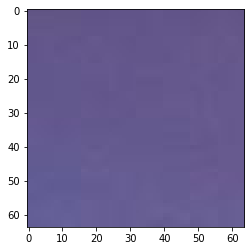

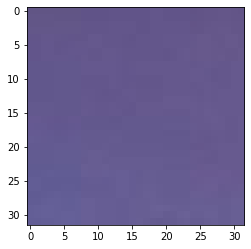

/content/Data_set_Train_x2/530/patch_522_0_8.jpg
/content/Data_set_Train_x2/530/patch_521_20_7.jpg
/content/Data_set_Train_x2/530/patch_521_16_8.jpg
/content/Data_set_Train_x2/530/patch_521_15_8.jpg
/content/Data_set_Train_x2/530/patch_521_8_25.jpg
/content/Data_set_Train_x2/530/patch_521_20_3.jpg
/content/Data_set_Train_x2/530/patch_522_2_1.jpg
/content/Data_set_Train_x2/530/patch_521_11_18.jpg
/content/Data_set_Train_x2/530/patch_521_18_1.jpg
/content/Data_set_Train_x2/530/patch_521_13_12.jpg
/content/Data_set_Train_x2/530/patch_521_9_29.jpg
/content/Data_set_Train_x2/530/patch_521_13_30.jpg
/content/Data_set_Train_x2/530/patch_521_16_4.jpg
/content/Data_set_Train_x2/530/patch_522_0_25.jpg
/content/Data_set_Train_x2/530/patch_522_0_5.jpg
/content/Data_set_Train_x2/530/patch_521_11_19.jpg
/content/Data_set_Train_x2/530/patch_522_0_12.jpg
/content/Data_set_Train_x2/530/patch_521_20_20.jpg
/content/Data_set_Train_x2/530/patch_521_17_26.jpg
/content/Data_set_Train_x2/530/patch_521_17_5.j

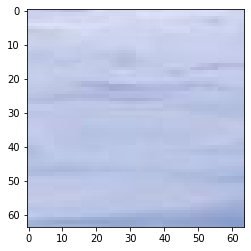

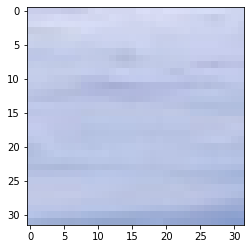

/content/Data_set_Train_x2/530/patch_522_11_25.jpg
/content/Data_set_Train_x2/530/patch_520_10_28.jpg
/content/Data_set_Train_x2/530/patch_520_0_4.jpg
/content/Data_set_Train_x2/530/patch_520_12_15.jpg
/content/Data_set_Train_x2/530/patch_520_9_1.jpg
/content/Data_set_Train_x2/530/patch_520_8_23.jpg
/content/Data_set_Train_x2/530/patch_520_7_5.jpg
/content/Data_set_Train_x2/530/patch_520_5_5.jpg
/content/Data_set_Train_x2/530/patch_520_7_9.jpg
/content/Data_set_Train_x2/530/patch_520_11_9.jpg
/content/Data_set_Train_x2/530/patch_520_7_30.jpg
/content/Data_set_Train_x2/530/patch_520_4_2.jpg
/content/Data_set_Train_x2/530/patch_520_6_19.jpg
/content/Data_set_Train_x2/530/patch_520_5_27.jpg
/content/Data_set_Train_x2/530/patch_520_0_22.jpg
/content/Data_set_Train_x2/530/patch_520_9_28.jpg
/content/Data_set_Train_x2/530/patch_520_5_7.jpg
/content/Data_set_Train_x2/530/patch_520_11_20.jpg
/content/Data_set_Train_x2/530/patch_520_8_25.jpg
/content/Data_set_Train_x2/530/patch_520_1_25.jpg
/co

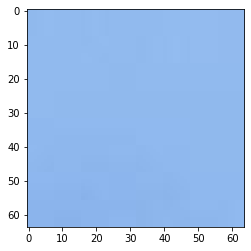

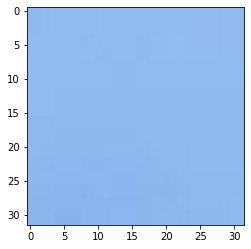

/content/Data_set_Train_x2/530/patch_521_5_11.jpg
/content/Data_set_Train_x2/530/patch_520_17_12.jpg
/content/Data_set_Train_x2/530/patch_521_4_16.jpg
/content/Data_set_Train_x2/530/patch_521_1_25.jpg
/content/Data_set_Train_x2/530/patch_521_0_5.jpg
/content/Data_set_Train_x2/530/patch_521_6_24.jpg
/content/Data_set_Train_x2/530/patch_521_0_21.jpg
/content/Data_set_Train_x2/530/patch_521_4_24.jpg
/content/Data_set_Train_x2/530/patch_520_16_4.jpg
/content/Data_set_Train_x2/530/patch_521_3_23.jpg
/content/Data_set_Train_x2/530/patch_521_2_27.jpg
/content/Data_set_Train_x2/530/patch_520_15_19.jpg
/content/Data_set_Train_x2/530/patch_521_1_22.jpg
/content/Data_set_Train_x2/530/patch_521_5_22.jpg
/content/Data_set_Train_x2/530/patch_520_20_11.jpg
/content/Data_set_Train_x2/530/patch_521_3_10.jpg
/content/Data_set_Train_x2/530/patch_521_7_0.jpg
/content/Data_set_Train_x2/530/patch_521_5_27.jpg
/content/Data_set_Train_x2/530/patch_521_2_1.jpg
/content/Data_set_Train_x2/530/patch_520_17_30.jpg

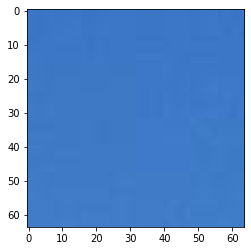

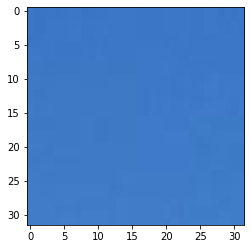

/content/Data_set_Train_x2/540/patch_539_5_5.jpg
/content/Data_set_Train_x2/540/patch_539_7_0.jpg
/content/Data_set_Train_x2/540/patch_539_11_28.jpg
/content/Data_set_Train_x2/540/patch_539_11_14.jpg
/content/Data_set_Train_x2/540/patch_539_12_9.jpg
/content/Data_set_Train_x2/540/patch_539_2_19.jpg
/content/Data_set_Train_x2/540/patch_539_12_15.jpg
/content/Data_set_Train_x2/540/patch_539_14_14.jpg
/content/Data_set_Train_x2/540/patch_539_7_2.jpg
/content/Data_set_Train_x2/540/patch_538_19_12.jpg
/content/Data_set_Train_x2/540/patch_539_1_29.jpg
/content/Data_set_Train_x2/540/patch_539_2_15.jpg
/content/Data_set_Train_x2/540/patch_539_6_25.jpg
/content/Data_set_Train_x2/540/patch_539_3_19.jpg
/content/Data_set_Train_x2/540/patch_538_20_15.jpg
/content/Data_set_Train_x2/540/patch_538_19_18.jpg
/content/Data_set_Train_x2/540/patch_539_1_14.jpg
/content/Data_set_Train_x2/540/patch_539_2_28.jpg
/content/Data_set_Train_x2/540/patch_539_14_0.jpg
/content/Data_set_Train_x2/540/patch_539_11_30

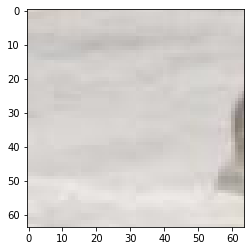

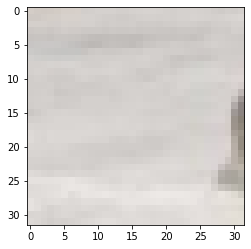

/content/Data_set_Train_x2/540/patch_539_18_14.jpg
/content/Data_set_Train_x2/540/patch_537_1_20.jpg
/content/Data_set_Train_x2/540/patch_537_0_18.jpg
/content/Data_set_Train_x2/540/patch_537_6_23.jpg
/content/Data_set_Train_x2/540/patch_536_25_17.jpg
/content/Data_set_Train_x2/540/patch_537_1_25.jpg
/content/Data_set_Train_x2/540/patch_537_0_12.jpg
/content/Data_set_Train_x2/540/patch_536_26_5.jpg
/content/Data_set_Train_x2/540/patch_536_24_26.jpg
/content/Data_set_Train_x2/540/patch_537_5_30.jpg
/content/Data_set_Train_x2/540/patch_537_0_10.jpg
/content/Data_set_Train_x2/540/patch_536_17_29.jpg
/content/Data_set_Train_x2/540/patch_536_23_20.jpg
/content/Data_set_Train_x2/540/patch_536_23_29.jpg
/content/Data_set_Train_x2/540/patch_536_25_28.jpg
/content/Data_set_Train_x2/540/patch_537_1_22.jpg
/content/Data_set_Train_x2/540/patch_536_23_30.jpg
/content/Data_set_Train_x2/540/patch_536_26_30.jpg
/content/Data_set_Train_x2/540/patch_536_26_23.jpg
/content/Data_set_Train_x2/540/patch_536

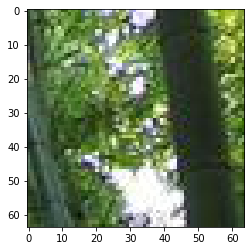

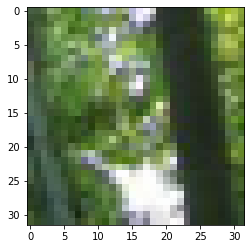

/content/Data_set_Train_x2/540/patch_537_19_18.jpg
/content/Data_set_Train_x2/540/patch_537_14_23.jpg
/content/Data_set_Train_x2/540/patch_537_19_15.jpg
/content/Data_set_Train_x2/540/patch_537_20_12.jpg
/content/Data_set_Train_x2/540/patch_537_9_19.jpg
/content/Data_set_Train_x2/540/patch_537_13_8.jpg
/content/Data_set_Train_x2/540/patch_538_2_14.jpg
/content/Data_set_Train_x2/540/patch_538_0_18.jpg
/content/Data_set_Train_x2/540/patch_537_20_1.jpg
/content/Data_set_Train_x2/540/patch_537_18_14.jpg
/content/Data_set_Train_x2/540/patch_538_0_20.jpg
/content/Data_set_Train_x2/540/patch_537_16_8.jpg
/content/Data_set_Train_x2/540/patch_537_20_20.jpg
/content/Data_set_Train_x2/540/patch_537_12_17.jpg
/content/Data_set_Train_x2/540/patch_537_12_3.jpg
/content/Data_set_Train_x2/540/patch_537_17_9.jpg
/content/Data_set_Train_x2/540/patch_538_0_9.jpg
/content/Data_set_Train_x2/540/patch_537_13_1.jpg
/content/Data_set_Train_x2/540/patch_538_1_6.jpg
/content/Data_set_Train_x2/540/patch_537_13_1

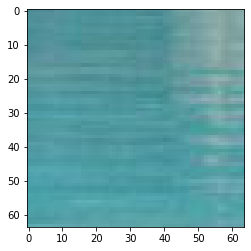

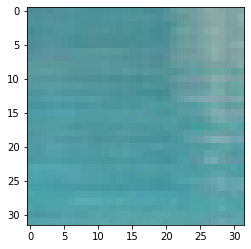

/content/Data_set_Train_x2/540/patch_538_11_4.jpg
/content/Data_set_Train_x2/540/patch_535_8_8.jpg
/content/Data_set_Train_x2/540/patch_535_20_8.jpg
/content/Data_set_Train_x2/540/patch_535_14_12.jpg
/content/Data_set_Train_x2/540/patch_535_19_3.jpg
/content/Data_set_Train_x2/540/patch_535_7_29.jpg
/content/Data_set_Train_x2/540/patch_535_9_8.jpg
/content/Data_set_Train_x2/540/patch_535_9_13.jpg
/content/Data_set_Train_x2/540/patch_536_1_7.jpg
/content/Data_set_Train_x2/540/patch_535_15_27.jpg
/content/Data_set_Train_x2/540/patch_535_19_8.jpg
/content/Data_set_Train_x2/540/patch_535_12_8.jpg
/content/Data_set_Train_x2/540/patch_535_9_10.jpg
/content/Data_set_Train_x2/540/patch_535_9_27.jpg
/content/Data_set_Train_x2/540/patch_535_12_16.jpg
/content/Data_set_Train_x2/540/patch_535_13_26.jpg
/content/Data_set_Train_x2/540/patch_535_13_16.jpg
/content/Data_set_Train_x2/540/patch_535_20_23.jpg
/content/Data_set_Train_x2/540/patch_535_17_26.jpg
/content/Data_set_Train_x2/540/patch_535_19_5.

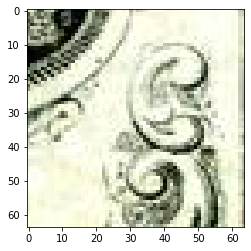

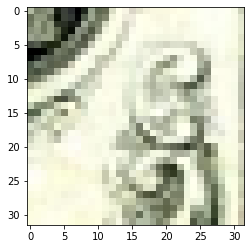

/content/Data_set_Train_x2/540/patch_536_9_29.jpg
/content/Data_set_Train_x2/540/patch_536_17_20.jpg
/content/Data_set_Train_x2/540/patch_536_14_11.jpg
/content/Data_set_Train_x2/540/patch_536_16_26.jpg
/content/Data_set_Train_x2/540/patch_536_14_16.jpg
/content/Data_set_Train_x2/540/patch_536_10_1.jpg
/content/Data_set_Train_x2/540/patch_536_2_1.jpg
/content/Data_set_Train_x2/540/patch_536_6_2.jpg
/content/Data_set_Train_x2/540/patch_536_10_27.jpg
/content/Data_set_Train_x2/540/patch_536_8_8.jpg
/content/Data_set_Train_x2/540/patch_536_13_21.jpg
/content/Data_set_Train_x2/540/patch_536_17_22.jpg
/content/Data_set_Train_x2/540/patch_536_13_20.jpg
/content/Data_set_Train_x2/540/patch_536_11_10.jpg
/content/Data_set_Train_x2/540/patch_536_6_22.jpg
/content/Data_set_Train_x2/540/patch_536_9_9.jpg
/content/Data_set_Train_x2/540/patch_536_14_20.jpg
/content/Data_set_Train_x2/540/patch_536_4_18.jpg
/content/Data_set_Train_x2/540/patch_536_2_15.jpg
/content/Data_set_Train_x2/540/patch_536_8_5

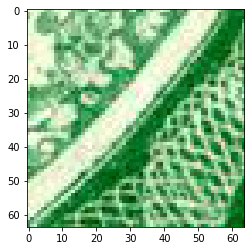

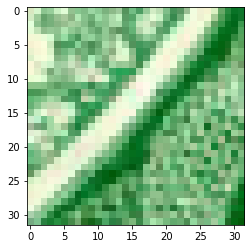

/content/Data_set_Train_x2/540/patch_536_18_4.jpg
/content/Data_set_Train_x2/540/patch_534_10_3.jpg
/content/Data_set_Train_x2/540/patch_534_7_26.jpg
/content/Data_set_Train_x2/540/patch_534_1_29.jpg
/content/Data_set_Train_x2/540/patch_534_4_13.jpg
/content/Data_set_Train_x2/540/patch_534_3_22.jpg
/content/Data_set_Train_x2/540/patch_534_2_23.jpg
/content/Data_set_Train_x2/540/patch_534_3_1.jpg
/content/Data_set_Train_x2/540/patch_534_0_1.jpg
/content/Data_set_Train_x2/540/patch_534_6_7.jpg
/content/Data_set_Train_x2/540/patch_534_11_10.jpg
/content/Data_set_Train_x2/540/patch_534_5_21.jpg
/content/Data_set_Train_x2/540/patch_533_19_26.jpg
/content/Data_set_Train_x2/540/patch_533_19_28.jpg
/content/Data_set_Train_x2/540/patch_533_18_21.jpg
/content/Data_set_Train_x2/540/patch_534_9_7.jpg
/content/Data_set_Train_x2/540/patch_534_6_23.jpg
/content/Data_set_Train_x2/540/patch_534_12_4.jpg
/content/Data_set_Train_x2/540/patch_534_7_21.jpg
/content/Data_set_Train_x2/540/patch_534_12_19.jpg

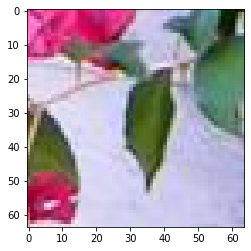

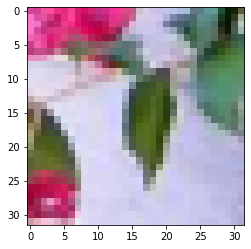

/content/Data_set_Train_x2/540/patch_534_14_6.jpg
/content/Data_set_Train_x2/540/patch_535_1_12.jpg
/content/Data_set_Train_x2/540/patch_534_17_20.jpg
/content/Data_set_Train_x2/540/patch_534_15_2.jpg
/content/Data_set_Train_x2/540/patch_535_1_20.jpg
/content/Data_set_Train_x2/540/patch_534_20_10.jpg
/content/Data_set_Train_x2/540/patch_534_21_25.jpg
/content/Data_set_Train_x2/540/patch_534_16_10.jpg
/content/Data_set_Train_x2/540/patch_535_1_26.jpg
/content/Data_set_Train_x2/540/patch_534_15_11.jpg
/content/Data_set_Train_x2/540/patch_534_23_22.jpg
/content/Data_set_Train_x2/540/patch_535_4_22.jpg
/content/Data_set_Train_x2/540/patch_534_17_12.jpg
/content/Data_set_Train_x2/540/patch_535_5_2.jpg
/content/Data_set_Train_x2/540/patch_535_6_2.jpg
/content/Data_set_Train_x2/540/patch_534_16_6.jpg
/content/Data_set_Train_x2/540/patch_534_20_14.jpg
/content/Data_set_Train_x2/540/patch_535_5_23.jpg
/content/Data_set_Train_x2/540/patch_535_3_13.jpg
/content/Data_set_Train_x2/540/patch_534_13_

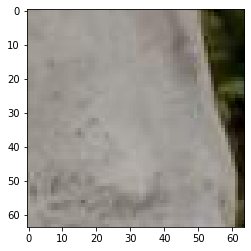

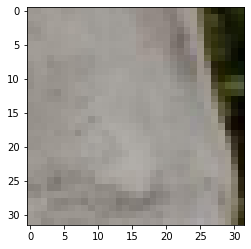

/content/Data_set_Train_x2/540/patch_535_10_19.jpg
/content/Data_set_Train_x2/540/patch_532_6_1.jpg
/content/Data_set_Train_x2/540/patch_532_6_8.jpg
/content/Data_set_Train_x2/540/patch_532_11_12.jpg
/content/Data_set_Train_x2/540/patch_532_10_5.jpg
/content/Data_set_Train_x2/540/patch_532_13_26.jpg
/content/Data_set_Train_x2/540/patch_532_13_2.jpg
/content/Data_set_Train_x2/540/patch_532_10_14.jpg
/content/Data_set_Train_x2/540/patch_532_11_0.jpg
/content/Data_set_Train_x2/540/patch_532_8_18.jpg
/content/Data_set_Train_x2/540/patch_532_3_12.jpg
/content/Data_set_Train_x2/540/patch_532_13_21.jpg
/content/Data_set_Train_x2/540/patch_532_11_1.jpg
/content/Data_set_Train_x2/540/patch_532_3_2.jpg
/content/Data_set_Train_x2/540/patch_532_11_21.jpg
/content/Data_set_Train_x2/540/patch_532_8_22.jpg
/content/Data_set_Train_x2/540/patch_532_7_17.jpg
/content/Data_set_Train_x2/540/patch_532_10_7.jpg
/content/Data_set_Train_x2/540/patch_532_10_0.jpg
/content/Data_set_Train_x2/540/patch_532_13_11.

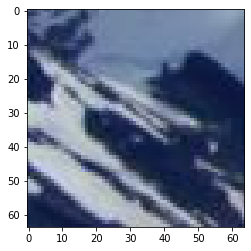

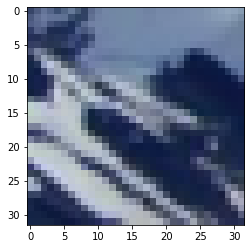

/content/Data_set_Train_x2/540/patch_533_6_29.jpg
/content/Data_set_Train_x2/540/patch_533_1_15.jpg
/content/Data_set_Train_x2/540/patch_533_1_4.jpg
/content/Data_set_Train_x2/540/patch_533_15_21.jpg
/content/Data_set_Train_x2/540/patch_533_4_2.jpg
/content/Data_set_Train_x2/540/patch_533_1_22.jpg
/content/Data_set_Train_x2/540/patch_533_11_15.jpg
/content/Data_set_Train_x2/540/patch_533_16_21.jpg
/content/Data_set_Train_x2/540/patch_533_11_24.jpg
/content/Data_set_Train_x2/540/patch_533_1_17.jpg
/content/Data_set_Train_x2/540/patch_533_6_16.jpg
/content/Data_set_Train_x2/540/patch_533_6_5.jpg
/content/Data_set_Train_x2/540/patch_533_15_2.jpg
/content/Data_set_Train_x2/540/patch_533_11_8.jpg
/content/Data_set_Train_x2/540/patch_533_11_23.jpg
/content/Data_set_Train_x2/540/patch_533_8_0.jpg
/content/Data_set_Train_x2/540/patch_533_5_30.jpg
/content/Data_set_Train_x2/540/patch_533_6_14.jpg
/content/Data_set_Train_x2/540/patch_533_16_30.jpg
/content/Data_set_Train_x2/540/patch_533_16_13.j

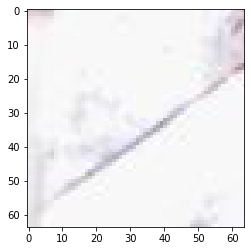

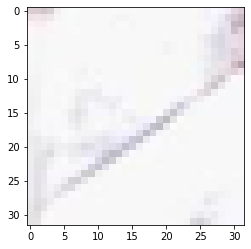

/content/Data_set_Train_x2/540/patch_534_13_0.jpg
/content/Data_set_Train_x2/540/patch_531_6_4.jpg
/content/Data_set_Train_x2/540/patch_531_3_25.jpg
/content/Data_set_Train_x2/540/patch_531_8_28.jpg
/content/Data_set_Train_x2/540/patch_530_13_2.jpg
/content/Data_set_Train_x2/540/patch_531_8_21.jpg
/content/Data_set_Train_x2/540/patch_530_20_8.jpg
/content/Data_set_Train_x2/540/patch_530_17_12.jpg
/content/Data_set_Train_x2/540/patch_530_20_12.jpg
/content/Data_set_Train_x2/540/patch_531_4_6.jpg
/content/Data_set_Train_x2/540/patch_531_5_13.jpg
/content/Data_set_Train_x2/540/patch_530_18_27.jpg
/content/Data_set_Train_x2/540/patch_530_20_15.jpg
/content/Data_set_Train_x2/540/patch_531_8_22.jpg
/content/Data_set_Train_x2/540/patch_530_20_22.jpg
/content/Data_set_Train_x2/540/patch_530_17_5.jpg
/content/Data_set_Train_x2/540/patch_531_8_8.jpg
/content/Data_set_Train_x2/540/patch_530_18_14.jpg
/content/Data_set_Train_x2/540/patch_531_8_11.jpg
/content/Data_set_Train_x2/540/patch_530_13_9.j

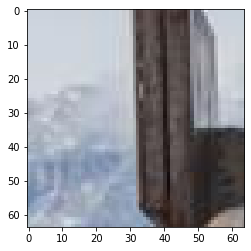

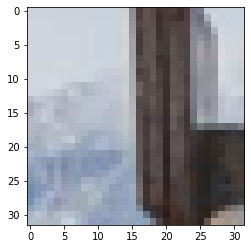

/content/Data_set_Train_x2/540/patch_531_13_6.jpg
/content/Data_set_Train_x2/540/patch_531_10_17.jpg
/content/Data_set_Train_x2/540/patch_531_13_8.jpg
/content/Data_set_Train_x2/540/patch_531_18_5.jpg
/content/Data_set_Train_x2/540/patch_531_16_19.jpg
/content/Data_set_Train_x2/540/patch_531_14_19.jpg
/content/Data_set_Train_x2/540/patch_531_15_29.jpg
/content/Data_set_Train_x2/540/patch_531_16_22.jpg
/content/Data_set_Train_x2/540/patch_531_9_9.jpg
/content/Data_set_Train_x2/540/patch_531_19_14.jpg
/content/Data_set_Train_x2/540/patch_531_20_25.jpg
/content/Data_set_Train_x2/540/patch_531_17_3.jpg
/content/Data_set_Train_x2/540/patch_531_14_24.jpg
/content/Data_set_Train_x2/540/patch_531_18_30.jpg
/content/Data_set_Train_x2/540/patch_531_16_13.jpg
/content/Data_set_Train_x2/540/patch_531_18_7.jpg
/content/Data_set_Train_x2/540/patch_532_0_26.jpg
/content/Data_set_Train_x2/540/patch_532_1_12.jpg
/content/Data_set_Train_x2/540/patch_531_10_16.jpg
/content/Data_set_Train_x2/540/patch_531

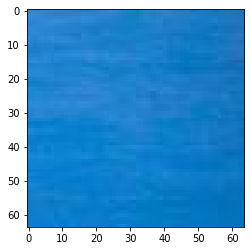

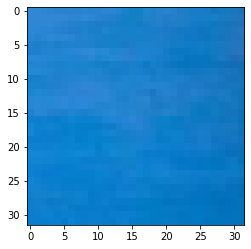

/content/Data_set_Train_x2/540/patch_532_17_13.jpg
/content/Data_set_Train_x2/540/patch_530_2_3.jpg
/content/Data_set_Train_x2/540/patch_530_7_15.jpg
/content/Data_set_Train_x2/540/patch_530_0_30.jpg
/content/Data_set_Train_x2/540/patch_530_12_19.jpg
/content/Data_set_Train_x2/540/patch_530_8_25.jpg
/content/Data_set_Train_x2/540/patch_530_11_13.jpg
/content/Data_set_Train_x2/540/patch_530_2_19.jpg
/content/Data_set_Train_x2/540/patch_530_7_25.jpg
/content/Data_set_Train_x2/540/patch_530_10_3.jpg
/content/Data_set_Train_x2/540/patch_530_3_1.jpg
/content/Data_set_Train_x2/540/patch_530_9_10.jpg
/content/Data_set_Train_x2/540/patch_530_5_26.jpg
/content/Data_set_Train_x2/540/patch_530_6_7.jpg
/content/Data_set_Train_x2/540/patch_530_3_27.jpg
/content/Data_set_Train_x2/540/patch_530_11_8.jpg
/content/Data_set_Train_x2/540/patch_530_7_10.jpg
/content/Data_set_Train_x2/540/patch_530_1_9.jpg
/content/Data_set_Train_x2/540/patch_530_9_7.jpg
/content/Data_set_Train_x2/540/patch_530_7_5.jpg
/co

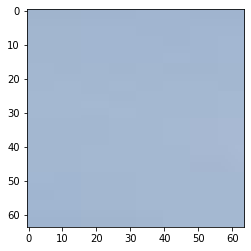

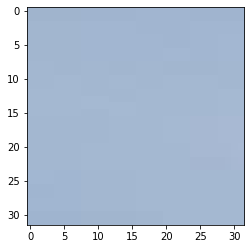

/content/Data_set_Train_x2/540/patch_531_6_22.jpg
/content/Data_set_Train_x2/540/patch_531_2_15.jpg
/content/Data_set_Train_x2/540/patch_531_2_6.jpg
/content/Data_set_Train_x2/540/patch_531_7_13.jpg
/content/Data_set_Train_x2/540/patch_530_14_9.jpg
/content/Data_set_Train_x2/540/patch_531_7_5.jpg
/content/Data_set_Train_x2/540/patch_531_1_17.jpg
/content/Data_set_Train_x2/540/patch_531_8_17.jpg
/content/Data_set_Train_x2/540/patch_531_4_29.jpg
/content/Data_set_Train_x2/540/patch_531_8_14.jpg
/content/Data_set_Train_x2/540/patch_530_13_27.jpg
/content/Data_set_Train_x2/540/patch_530_15_12.jpg
/content/Data_set_Train_x2/540/patch_531_8_13.jpg
/content/Data_set_Train_x2/540/patch_531_5_0.jpg
/content/Data_set_Train_x2/540/patch_531_2_3.jpg
/content/Data_set_Train_x2/540/patch_530_16_3.jpg
/content/Data_set_Train_x2/540/patch_530_19_10.jpg
/content/Data_set_Train_x2/540/patch_530_16_28.jpg
/content/Data_set_Train_x2/540/patch_531_1_29.jpg
/content/Data_set_Train_x2/540/patch_530_20_14.jpg

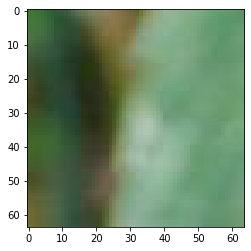

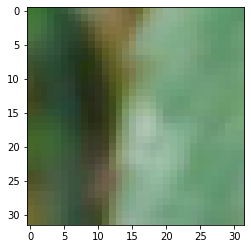

/content/Data_set_Train_x2/550/patch_549_7_4.jpg
/content/Data_set_Train_x2/550/patch_548_15_22.jpg
/content/Data_set_Train_x2/550/patch_549_0_20.jpg
/content/Data_set_Train_x2/550/patch_548_15_12.jpg
/content/Data_set_Train_x2/550/patch_548_18_3.jpg
/content/Data_set_Train_x2/550/patch_548_15_17.jpg
/content/Data_set_Train_x2/550/patch_548_15_9.jpg
/content/Data_set_Train_x2/550/patch_548_19_28.jpg
/content/Data_set_Train_x2/550/patch_548_18_25.jpg
/content/Data_set_Train_x2/550/patch_548_12_23.jpg
/content/Data_set_Train_x2/550/patch_548_18_13.jpg
/content/Data_set_Train_x2/550/patch_548_11_16.jpg
/content/Data_set_Train_x2/550/patch_548_16_25.jpg
/content/Data_set_Train_x2/550/patch_548_20_13.jpg
/content/Data_set_Train_x2/550/patch_548_19_15.jpg
/content/Data_set_Train_x2/550/patch_549_2_17.jpg
/content/Data_set_Train_x2/550/patch_548_14_21.jpg
/content/Data_set_Train_x2/550/patch_548_17_22.jpg
/content/Data_set_Train_x2/550/patch_549_0_7.jpg
/content/Data_set_Train_x2/550/patch_54

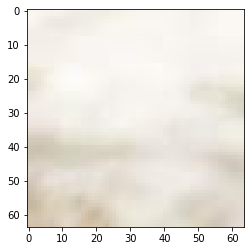

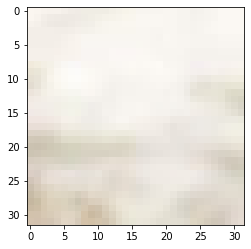

/content/Data_set_Train_x2/550/patch_549_18_0.jpg
/content/Data_set_Train_x2/550/patch_546_15_17.jpg
/content/Data_set_Train_x2/550/patch_546_11_21.jpg
/content/Data_set_Train_x2/550/patch_546_14_18.jpg
/content/Data_set_Train_x2/550/patch_546_13_22.jpg
/content/Data_set_Train_x2/550/patch_546_13_8.jpg
/content/Data_set_Train_x2/550/patch_546_7_0.jpg
/content/Data_set_Train_x2/550/patch_546_15_20.jpg
/content/Data_set_Train_x2/550/patch_546_8_2.jpg
/content/Data_set_Train_x2/550/patch_546_10_5.jpg
/content/Data_set_Train_x2/550/patch_546_5_7.jpg
/content/Data_set_Train_x2/550/patch_546_3_23.jpg
/content/Data_set_Train_x2/550/patch_546_9_23.jpg
/content/Data_set_Train_x2/550/patch_546_15_24.jpg
/content/Data_set_Train_x2/550/patch_546_19_22.jpg
/content/Data_set_Train_x2/550/patch_546_14_15.jpg
/content/Data_set_Train_x2/550/patch_546_7_21.jpg
/content/Data_set_Train_x2/550/patch_546_15_14.jpg
/content/Data_set_Train_x2/550/patch_546_15_12.jpg
/content/Data_set_Train_x2/550/patch_546_10

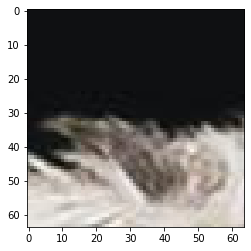

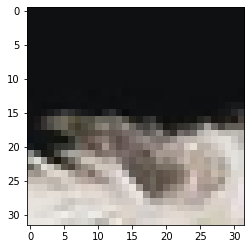

/content/Data_set_Train_x2/550/patch_547_1_12.jpg
/content/Data_set_Train_x2/550/patch_547_12_30.jpg
/content/Data_set_Train_x2/550/patch_547_2_28.jpg
/content/Data_set_Train_x2/550/patch_547_4_9.jpg
/content/Data_set_Train_x2/550/patch_547_0_27.jpg
/content/Data_set_Train_x2/550/patch_547_11_9.jpg
/content/Data_set_Train_x2/550/patch_547_4_29.jpg
/content/Data_set_Train_x2/550/patch_547_13_14.jpg
/content/Data_set_Train_x2/550/patch_547_15_4.jpg
/content/Data_set_Train_x2/550/patch_547_13_10.jpg
/content/Data_set_Train_x2/550/patch_547_11_21.jpg
/content/Data_set_Train_x2/550/patch_547_2_4.jpg
/content/Data_set_Train_x2/550/patch_547_10_18.jpg
/content/Data_set_Train_x2/550/patch_547_4_19.jpg
/content/Data_set_Train_x2/550/patch_547_12_6.jpg
/content/Data_set_Train_x2/550/patch_547_11_5.jpg
/content/Data_set_Train_x2/550/patch_547_10_3.jpg
/content/Data_set_Train_x2/550/patch_547_8_15.jpg
/content/Data_set_Train_x2/550/patch_547_10_13.jpg
/content/Data_set_Train_x2/550/patch_547_1_27.

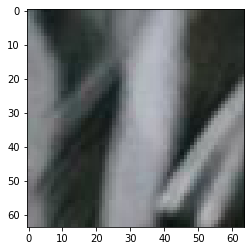

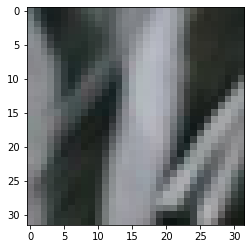

/content/Data_set_Train_x2/550/patch_547_20_5.jpg
/content/Data_set_Train_x2/550/patch_545_13_12.jpg
/content/Data_set_Train_x2/550/patch_545_14_3.jpg
/content/Data_set_Train_x2/550/patch_545_14_25.jpg
/content/Data_set_Train_x2/550/patch_545_20_18.jpg
/content/Data_set_Train_x2/550/patch_545_14_22.jpg
/content/Data_set_Train_x2/550/patch_545_11_6.jpg
/content/Data_set_Train_x2/550/patch_546_1_10.jpg
/content/Data_set_Train_x2/550/patch_545_14_29.jpg
/content/Data_set_Train_x2/550/patch_545_8_9.jpg
/content/Data_set_Train_x2/550/patch_545_9_12.jpg
/content/Data_set_Train_x2/550/patch_545_17_10.jpg
/content/Data_set_Train_x2/550/patch_545_7_26.jpg
/content/Data_set_Train_x2/550/patch_546_0_24.jpg
/content/Data_set_Train_x2/550/patch_545_19_22.jpg
/content/Data_set_Train_x2/550/patch_545_11_27.jpg
/content/Data_set_Train_x2/550/patch_545_18_25.jpg
/content/Data_set_Train_x2/550/patch_545_12_1.jpg
/content/Data_set_Train_x2/550/patch_545_7_28.jpg
/content/Data_set_Train_x2/550/patch_545_1

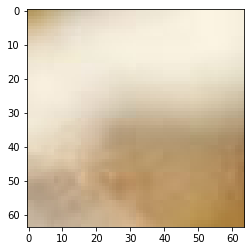

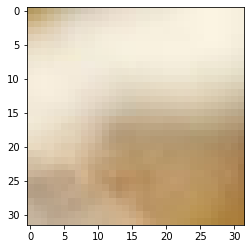

/content/Data_set_Train_x2/550/patch_545_19_14.jpg
/content/Data_set_Train_x2/550/patch_545_16_24.jpg
/content/Data_set_Train_x2/550/patch_545_10_14.jpg
/content/Data_set_Train_x2/550/patch_545_13_24.jpg
/content/Data_set_Train_x2/550/patch_546_0_10.jpg
/content/Data_set_Train_x2/550/patch_545_14_2.jpg
/content/Data_set_Train_x2/550/patch_545_20_27.jpg
/content/Data_set_Train_x2/550/patch_545_13_17.jpg
/content/Data_set_Train_x2/550/patch_545_19_29.jpg
/content/Data_set_Train_x2/550/patch_545_19_30.jpg
/content/Data_set_Train_x2/550/patch_546_1_30.jpg
/content/Data_set_Train_x2/550/patch_546_17_20.jpg
/content/Data_set_Train_x2/550/patch_546_12_10.jpg
/content/Data_set_Train_x2/550/patch_546_9_26.jpg
/content/Data_set_Train_x2/550/patch_546_12_26.jpg
/content/Data_set_Train_x2/550/patch_546_11_9.jpg
/content/Data_set_Train_x2/550/patch_546_16_26.jpg
/content/Data_set_Train_x2/550/patch_546_16_16.jpg
/content/Data_set_Train_x2/550/patch_546_14_25.jpg
/content/Data_set_Train_x2/550/patch

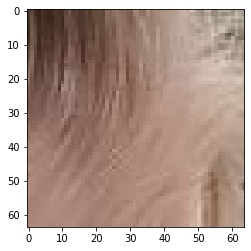

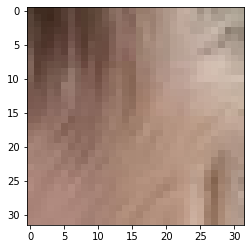

/content/Data_set_Train_x2/550/patch_546_5_13.jpg
/content/Data_set_Train_x2/550/patch_544_6_15.jpg
/content/Data_set_Train_x2/550/patch_544_8_15.jpg
/content/Data_set_Train_x2/550/patch_543_19_29.jpg
/content/Data_set_Train_x2/550/patch_544_6_26.jpg
/content/Data_set_Train_x2/550/patch_544_5_7.jpg
/content/Data_set_Train_x2/550/patch_544_0_23.jpg
/content/Data_set_Train_x2/550/patch_543_17_28.jpg
/content/Data_set_Train_x2/550/patch_543_18_25.jpg
/content/Data_set_Train_x2/550/patch_544_6_21.jpg
/content/Data_set_Train_x2/550/patch_543_20_3.jpg
/content/Data_set_Train_x2/550/patch_544_4_4.jpg
/content/Data_set_Train_x2/550/patch_544_11_19.jpg
/content/Data_set_Train_x2/550/patch_543_19_22.jpg
/content/Data_set_Train_x2/550/patch_543_20_1.jpg
/content/Data_set_Train_x2/550/patch_544_8_21.jpg
/content/Data_set_Train_x2/550/patch_544_8_11.jpg
/content/Data_set_Train_x2/550/patch_544_9_18.jpg
/content/Data_set_Train_x2/550/patch_544_2_8.jpg
/content/Data_set_Train_x2/550/patch_544_3_10.jp

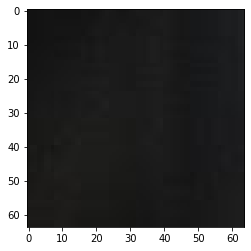

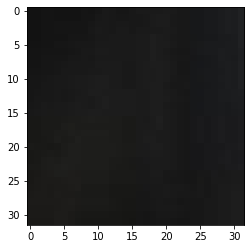

/content/Data_set_Train_x2/550/patch_544_17_30.jpg
/content/Data_set_Train_x2/550/patch_545_3_4.jpg
/content/Data_set_Train_x2/550/patch_544_20_17.jpg
/content/Data_set_Train_x2/550/patch_544_12_6.jpg
/content/Data_set_Train_x2/550/patch_545_7_22.jpg
/content/Data_set_Train_x2/550/patch_545_7_9.jpg
/content/Data_set_Train_x2/550/patch_545_1_10.jpg
/content/Data_set_Train_x2/550/patch_544_17_7.jpg
/content/Data_set_Train_x2/550/patch_545_1_20.jpg
/content/Data_set_Train_x2/550/patch_545_4_16.jpg
/content/Data_set_Train_x2/550/patch_545_6_6.jpg
/content/Data_set_Train_x2/550/patch_545_3_11.jpg
/content/Data_set_Train_x2/550/patch_545_0_30.jpg
/content/Data_set_Train_x2/550/patch_545_7_19.jpg
/content/Data_set_Train_x2/550/patch_544_12_18.jpg
/content/Data_set_Train_x2/550/patch_544_18_23.jpg
/content/Data_set_Train_x2/550/patch_544_20_8.jpg
/content/Data_set_Train_x2/550/patch_544_15_17.jpg
/content/Data_set_Train_x2/550/patch_544_12_27.jpg
/content/Data_set_Train_x2/550/patch_544_19_24.

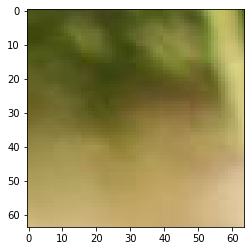

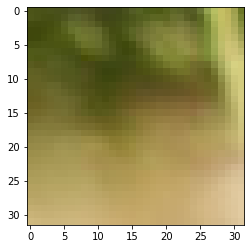

/content/Data_set_Train_x2/550/patch_545_20_2.jpg
/content/Data_set_Train_x2/550/patch_542_10_19.jpg
/content/Data_set_Train_x2/550/patch_542_1_19.jpg
/content/Data_set_Train_x2/550/patch_542_12_24.jpg
/content/Data_set_Train_x2/550/patch_542_12_18.jpg
/content/Data_set_Train_x2/550/patch_542_6_6.jpg
/content/Data_set_Train_x2/550/patch_542_2_14.jpg
/content/Data_set_Train_x2/550/patch_542_11_16.jpg
/content/Data_set_Train_x2/550/patch_542_10_12.jpg
/content/Data_set_Train_x2/550/patch_542_16_20.jpg
/content/Data_set_Train_x2/550/patch_542_11_4.jpg
/content/Data_set_Train_x2/550/patch_542_5_1.jpg
/content/Data_set_Train_x2/550/patch_542_7_23.jpg
/content/Data_set_Train_x2/550/patch_542_12_29.jpg
/content/Data_set_Train_x2/550/patch_543_0_5.jpg
/content/Data_set_Train_x2/550/patch_542_16_8.jpg
/content/Data_set_Train_x2/550/patch_542_2_5.jpg
/content/Data_set_Train_x2/550/patch_542_4_14.jpg
/content/Data_set_Train_x2/550/patch_542_4_9.jpg
/content/Data_set_Train_x2/550/patch_542_1_25.jp

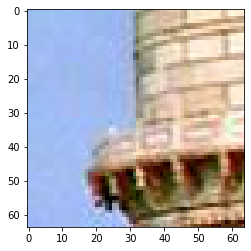

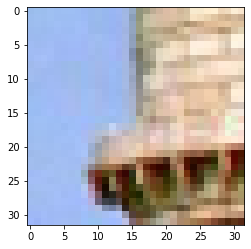

/content/Data_set_Train_x2/550/patch_543_13_29.jpg
/content/Data_set_Train_x2/550/patch_543_16_13.jpg
/content/Data_set_Train_x2/550/patch_543_6_24.jpg
/content/Data_set_Train_x2/550/patch_543_7_13.jpg
/content/Data_set_Train_x2/550/patch_543_12_17.jpg
/content/Data_set_Train_x2/550/patch_543_5_2.jpg
/content/Data_set_Train_x2/550/patch_543_16_17.jpg
/content/Data_set_Train_x2/550/patch_543_13_11.jpg
/content/Data_set_Train_x2/550/patch_543_11_14.jpg
/content/Data_set_Train_x2/550/patch_543_1_19.jpg
/content/Data_set_Train_x2/550/patch_543_9_19.jpg
/content/Data_set_Train_x2/550/patch_543_1_15.jpg
/content/Data_set_Train_x2/550/patch_543_9_17.jpg
/content/Data_set_Train_x2/550/patch_543_9_25.jpg
/content/Data_set_Train_x2/550/patch_543_14_6.jpg
/content/Data_set_Train_x2/550/patch_543_9_26.jpg
/content/Data_set_Train_x2/550/patch_543_5_3.jpg
/content/Data_set_Train_x2/550/patch_543_6_3.jpg
/content/Data_set_Train_x2/550/patch_543_11_12.jpg
/content/Data_set_Train_x2/550/patch_543_10_26

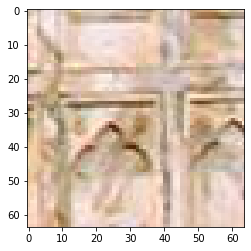

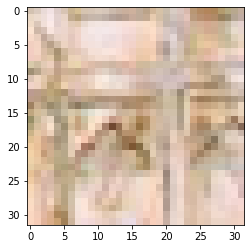

/content/Data_set_Train_x2/550/patch_543_17_26.jpg
/content/Data_set_Train_x2/550/patch_541_3_13.jpg
/content/Data_set_Train_x2/550/patch_540_17_24.jpg
/content/Data_set_Train_x2/550/patch_540_15_24.jpg
/content/Data_set_Train_x2/550/patch_541_2_1.jpg
/content/Data_set_Train_x2/550/patch_541_5_4.jpg
/content/Data_set_Train_x2/550/patch_541_2_15.jpg
/content/Data_set_Train_x2/550/patch_540_19_6.jpg
/content/Data_set_Train_x2/550/patch_540_15_18.jpg
/content/Data_set_Train_x2/550/patch_541_4_2.jpg
/content/Data_set_Train_x2/550/patch_540_19_26.jpg
/content/Data_set_Train_x2/550/patch_540_19_1.jpg
/content/Data_set_Train_x2/550/patch_540_20_13.jpg
/content/Data_set_Train_x2/550/patch_540_17_3.jpg
/content/Data_set_Train_x2/550/patch_540_17_6.jpg
/content/Data_set_Train_x2/550/patch_540_17_23.jpg
/content/Data_set_Train_x2/550/patch_541_4_9.jpg
/content/Data_set_Train_x2/550/patch_540_19_20.jpg
/content/Data_set_Train_x2/550/patch_540_12_4.jpg
/content/Data_set_Train_x2/550/patch_541_5_19.

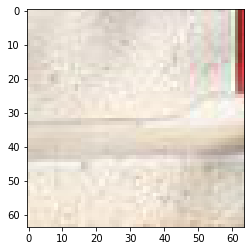

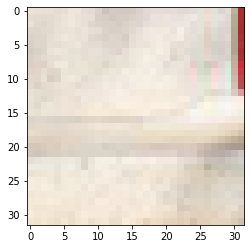

/content/Data_set_Train_x2/550/patch_541_15_14.jpg
/content/Data_set_Train_x2/550/patch_541_9_11.jpg
/content/Data_set_Train_x2/550/patch_541_9_25.jpg
/content/Data_set_Train_x2/550/patch_541_8_29.jpg
/content/Data_set_Train_x2/550/patch_541_8_0.jpg
/content/Data_set_Train_x2/550/patch_541_6_15.jpg
/content/Data_set_Train_x2/550/patch_541_16_8.jpg
/content/Data_set_Train_x2/550/patch_541_17_15.jpg
/content/Data_set_Train_x2/550/patch_541_20_11.jpg
/content/Data_set_Train_x2/550/patch_541_10_0.jpg
/content/Data_set_Train_x2/550/patch_541_16_24.jpg
/content/Data_set_Train_x2/550/patch_541_11_14.jpg
/content/Data_set_Train_x2/550/patch_541_6_10.jpg
/content/Data_set_Train_x2/550/patch_541_18_14.jpg
/content/Data_set_Train_x2/550/patch_541_20_14.jpg
/content/Data_set_Train_x2/550/patch_542_0_1.jpg
/content/Data_set_Train_x2/550/patch_541_6_21.jpg
/content/Data_set_Train_x2/550/patch_541_20_21.jpg
/content/Data_set_Train_x2/550/patch_541_19_20.jpg
/content/Data_set_Train_x2/550/patch_541_14

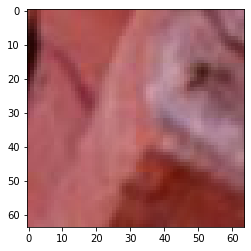

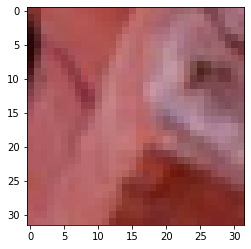

/content/Data_set_Train_x2/550/patch_542_6_30.jpg
/content/Data_set_Train_x2/550/patch_540_1_10.jpg
/content/Data_set_Train_x2/550/patch_540_2_8.jpg
/content/Data_set_Train_x2/550/patch_540_4_5.jpg
/content/Data_set_Train_x2/550/patch_540_9_17.jpg
/content/Data_set_Train_x2/550/patch_540_1_14.jpg
/content/Data_set_Train_x2/550/patch_540_8_3.jpg
/content/Data_set_Train_x2/550/patch_540_6_19.jpg
/content/Data_set_Train_x2/550/patch_540_5_12.jpg
/content/Data_set_Train_x2/550/patch_540_2_28.jpg
/content/Data_set_Train_x2/550/patch_540_3_8.jpg
/content/Data_set_Train_x2/550/patch_540_4_9.jpg
/content/Data_set_Train_x2/550/patch_540_1_5.jpg
/content/Data_set_Train_x2/550/patch_540_0_13.jpg
/content/Data_set_Train_x2/550/patch_540_1_25.jpg
/content/Data_set_Train_x2/550/patch_540_9_9.jpg
/content/Data_set_Train_x2/550/patch_540_9_8.jpg
/content/Data_set_Train_x2/550/patch_540_1_9.jpg
/content/Data_set_Train_x2/550/patch_540_0_4.jpg
/content/Data_set_Train_x2/550/patch_540_3_9.jpg
/content/Da

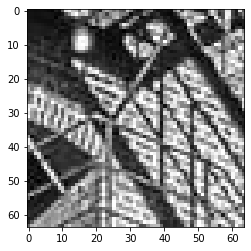

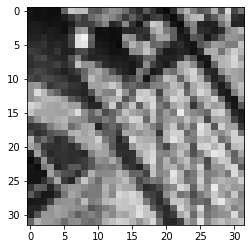

/content/Data_set_Train_x2/560/patch_559_12_13.jpg
/content/Data_set_Train_x2/560/patch_559_5_23.jpg
/content/Data_set_Train_x2/560/patch_559_13_30.jpg
/content/Data_set_Train_x2/560/patch_559_11_15.jpg
/content/Data_set_Train_x2/560/patch_559_14_13.jpg
/content/Data_set_Train_x2/560/patch_559_11_25.jpg
/content/Data_set_Train_x2/560/patch_559_17_11.jpg
/content/Data_set_Train_x2/560/patch_559_4_7.jpg
/content/Data_set_Train_x2/560/patch_559_9_20.jpg
/content/Data_set_Train_x2/560/patch_559_4_19.jpg
/content/Data_set_Train_x2/560/patch_559_7_23.jpg
/content/Data_set_Train_x2/560/patch_559_16_1.jpg
/content/Data_set_Train_x2/560/patch_559_13_11.jpg
/content/Data_set_Train_x2/560/patch_559_10_21.jpg
/content/Data_set_Train_x2/560/patch_559_16_6.jpg
/content/Data_set_Train_x2/560/patch_559_18_15.jpg
/content/Data_set_Train_x2/560/patch_559_6_2.jpg
/content/Data_set_Train_x2/560/patch_559_9_12.jpg
/content/Data_set_Train_x2/560/patch_559_17_30.jpg
/content/Data_set_Train_x2/560/patch_559_1

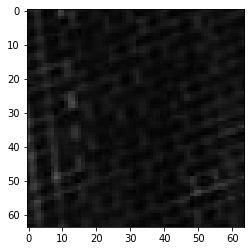

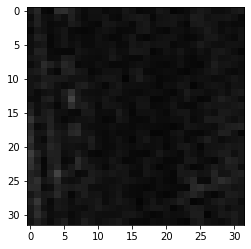

/content/Data_set_Train_x2/560/patch_559_20_30.jpg
/content/Data_set_Train_x2/560/patch_557_0_1.jpg
/content/Data_set_Train_x2/560/patch_557_4_15.jpg
/content/Data_set_Train_x2/560/patch_556_21_22.jpg
/content/Data_set_Train_x2/560/patch_557_5_19.jpg
/content/Data_set_Train_x2/560/patch_557_2_24.jpg
/content/Data_set_Train_x2/560/patch_557_5_27.jpg
/content/Data_set_Train_x2/560/patch_557_2_4.jpg
/content/Data_set_Train_x2/560/patch_557_10_1.jpg
/content/Data_set_Train_x2/560/patch_557_7_25.jpg
/content/Data_set_Train_x2/560/patch_556_21_10.jpg
/content/Data_set_Train_x2/560/patch_557_4_1.jpg
/content/Data_set_Train_x2/560/patch_557_5_22.jpg
/content/Data_set_Train_x2/560/patch_557_0_28.jpg
/content/Data_set_Train_x2/560/patch_557_4_24.jpg
/content/Data_set_Train_x2/560/patch_557_2_6.jpg
/content/Data_set_Train_x2/560/patch_557_12_19.jpg
/content/Data_set_Train_x2/560/patch_556_23_2.jpg
/content/Data_set_Train_x2/560/patch_557_10_11.jpg
/content/Data_set_Train_x2/560/patch_557_1_7.jpg


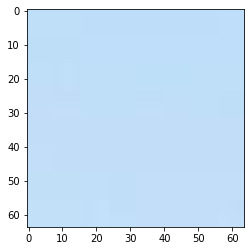

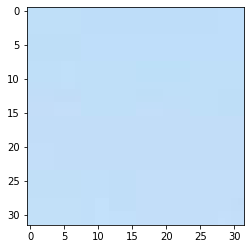

/content/Data_set_Train_x2/560/patch_558_7_27.jpg
/content/Data_set_Train_x2/560/patch_558_3_15.jpg
/content/Data_set_Train_x2/560/patch_558_7_6.jpg
/content/Data_set_Train_x2/560/patch_558_6_17.jpg
/content/Data_set_Train_x2/560/patch_558_2_6.jpg
/content/Data_set_Train_x2/560/patch_557_13_28.jpg
/content/Data_set_Train_x2/560/patch_558_0_14.jpg
/content/Data_set_Train_x2/560/patch_557_15_17.jpg
/content/Data_set_Train_x2/560/patch_558_3_25.jpg
/content/Data_set_Train_x2/560/patch_557_20_29.jpg
/content/Data_set_Train_x2/560/patch_557_19_24.jpg
/content/Data_set_Train_x2/560/patch_557_15_8.jpg
/content/Data_set_Train_x2/560/patch_557_20_3.jpg
/content/Data_set_Train_x2/560/patch_558_6_20.jpg
/content/Data_set_Train_x2/560/patch_558_7_13.jpg
/content/Data_set_Train_x2/560/patch_558_2_18.jpg
/content/Data_set_Train_x2/560/patch_557_19_19.jpg
/content/Data_set_Train_x2/560/patch_557_14_28.jpg
/content/Data_set_Train_x2/560/patch_557_14_5.jpg
/content/Data_set_Train_x2/560/patch_558_7_4.j

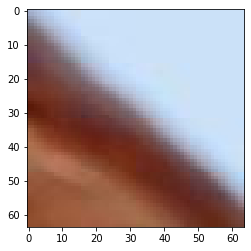

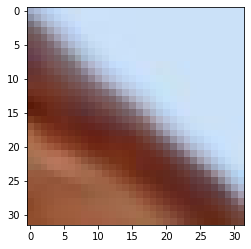

/content/Data_set_Train_x2/560/patch_558_10_24.jpg
/content/Data_set_Train_x2/560/patch_555_13_23.jpg
/content/Data_set_Train_x2/560/patch_555_10_9.jpg
/content/Data_set_Train_x2/560/patch_555_11_3.jpg
/content/Data_set_Train_x2/560/patch_555_17_21.jpg
/content/Data_set_Train_x2/560/patch_555_16_3.jpg
/content/Data_set_Train_x2/560/patch_556_2_30.jpg
/content/Data_set_Train_x2/560/patch_555_17_11.jpg
/content/Data_set_Train_x2/560/patch_555_15_29.jpg
/content/Data_set_Train_x2/560/patch_556_0_15.jpg
/content/Data_set_Train_x2/560/patch_556_2_7.jpg
/content/Data_set_Train_x2/560/patch_556_0_4.jpg
/content/Data_set_Train_x2/560/patch_555_15_9.jpg
/content/Data_set_Train_x2/560/patch_555_11_0.jpg
/content/Data_set_Train_x2/560/patch_555_20_16.jpg
/content/Data_set_Train_x2/560/patch_555_13_11.jpg
/content/Data_set_Train_x2/560/patch_556_0_27.jpg
/content/Data_set_Train_x2/560/patch_555_19_15.jpg
/content/Data_set_Train_x2/560/patch_555_15_10.jpg
/content/Data_set_Train_x2/560/patch_555_20

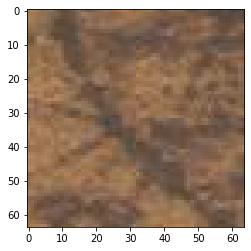

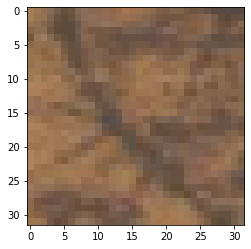

/content/Data_set_Train_x2/560/patch_556_15_7.jpg
/content/Data_set_Train_x2/560/patch_556_15_9.jpg
/content/Data_set_Train_x2/560/patch_556_19_3.jpg
/content/Data_set_Train_x2/560/patch_556_9_22.jpg
/content/Data_set_Train_x2/560/patch_556_7_29.jpg
/content/Data_set_Train_x2/560/patch_556_12_2.jpg
/content/Data_set_Train_x2/560/patch_556_10_26.jpg
/content/Data_set_Train_x2/560/patch_556_19_2.jpg
/content/Data_set_Train_x2/560/patch_556_20_17.jpg
/content/Data_set_Train_x2/560/patch_556_9_27.jpg
/content/Data_set_Train_x2/560/patch_556_7_25.jpg
/content/Data_set_Train_x2/560/patch_556_6_3.jpg
/content/Data_set_Train_x2/560/patch_556_20_1.jpg
/content/Data_set_Train_x2/560/patch_556_14_0.jpg
/content/Data_set_Train_x2/560/patch_556_20_16.jpg
/content/Data_set_Train_x2/560/patch_556_17_28.jpg
/content/Data_set_Train_x2/560/patch_556_19_26.jpg
/content/Data_set_Train_x2/560/patch_556_15_20.jpg
/content/Data_set_Train_x2/560/patch_556_9_19.jpg
/content/Data_set_Train_x2/560/patch_556_11_2

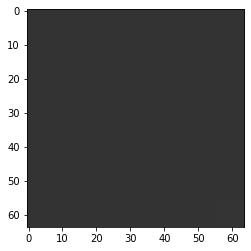

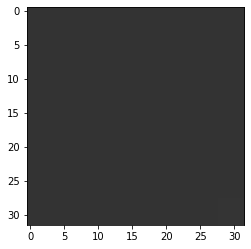

/content/Data_set_Train_x2/560/patch_556_22_0.jpg
/content/Data_set_Train_x2/560/patch_554_12_3.jpg
/content/Data_set_Train_x2/560/patch_554_14_17.jpg
/content/Data_set_Train_x2/560/patch_554_17_0.jpg
/content/Data_set_Train_x2/560/patch_554_6_20.jpg
/content/Data_set_Train_x2/560/patch_553_15_0.jpg
/content/Data_set_Train_x2/560/patch_554_16_7.jpg
/content/Data_set_Train_x2/560/patch_554_5_6.jpg
/content/Data_set_Train_x2/560/patch_554_0_6.jpg
/content/Data_set_Train_x2/560/patch_554_16_18.jpg
/content/Data_set_Train_x2/560/patch_554_9_4.jpg
/content/Data_set_Train_x2/560/patch_554_15_2.jpg
/content/Data_set_Train_x2/560/patch_554_1_8.jpg
/content/Data_set_Train_x2/560/patch_554_6_12.jpg
/content/Data_set_Train_x2/560/patch_554_14_20.jpg
/content/Data_set_Train_x2/560/patch_553_14_25.jpg
/content/Data_set_Train_x2/560/patch_554_4_20.jpg
/content/Data_set_Train_x2/560/patch_554_2_10.jpg
/content/Data_set_Train_x2/560/patch_553_14_3.jpg
/content/Data_set_Train_x2/560/patch_554_10_4.jpg


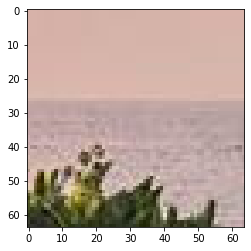

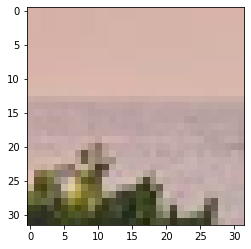

/content/Data_set_Train_x2/560/patch_555_9_2.jpg
/content/Data_set_Train_x2/560/patch_555_3_11.jpg
/content/Data_set_Train_x2/560/patch_554_27_21.jpg
/content/Data_set_Train_x2/560/patch_555_4_7.jpg
/content/Data_set_Train_x2/560/patch_555_0_4.jpg
/content/Data_set_Train_x2/560/patch_554_26_4.jpg
/content/Data_set_Train_x2/560/patch_555_6_4.jpg
/content/Data_set_Train_x2/560/patch_555_6_23.jpg
/content/Data_set_Train_x2/560/patch_554_26_12.jpg
/content/Data_set_Train_x2/560/patch_554_21_11.jpg
/content/Data_set_Train_x2/560/patch_555_4_9.jpg
/content/Data_set_Train_x2/560/patch_555_1_30.jpg
/content/Data_set_Train_x2/560/patch_554_21_13.jpg
/content/Data_set_Train_x2/560/patch_555_8_28.jpg
/content/Data_set_Train_x2/560/patch_555_9_3.jpg
/content/Data_set_Train_x2/560/patch_554_27_19.jpg
/content/Data_set_Train_x2/560/patch_554_26_0.jpg
/content/Data_set_Train_x2/560/patch_555_6_18.jpg
/content/Data_set_Train_x2/560/patch_555_2_7.jpg
/content/Data_set_Train_x2/560/patch_555_7_17.jpg
/c

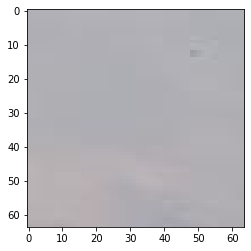

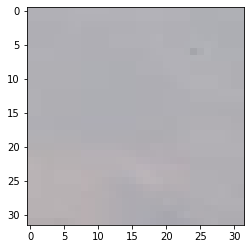

/content/Data_set_Train_x2/560/patch_555_16_25.jpg
/content/Data_set_Train_x2/560/patch_552_20_20.jpg
/content/Data_set_Train_x2/560/patch_552_10_20.jpg
/content/Data_set_Train_x2/560/patch_552_9_22.jpg
/content/Data_set_Train_x2/560/patch_552_14_6.jpg
/content/Data_set_Train_x2/560/patch_552_13_0.jpg
/content/Data_set_Train_x2/560/patch_552_13_10.jpg
/content/Data_set_Train_x2/560/patch_552_8_8.jpg
/content/Data_set_Train_x2/560/patch_552_21_13.jpg
/content/Data_set_Train_x2/560/patch_552_10_21.jpg
/content/Data_set_Train_x2/560/patch_552_20_19.jpg
/content/Data_set_Train_x2/560/patch_552_16_21.jpg
/content/Data_set_Train_x2/560/patch_552_16_3.jpg
/content/Data_set_Train_x2/560/patch_552_15_25.jpg
/content/Data_set_Train_x2/560/patch_552_11_2.jpg
/content/Data_set_Train_x2/560/patch_552_8_0.jpg
/content/Data_set_Train_x2/560/patch_552_6_20.jpg
/content/Data_set_Train_x2/560/patch_552_9_18.jpg
/content/Data_set_Train_x2/560/patch_552_5_26.jpg
/content/Data_set_Train_x2/560/patch_552_10

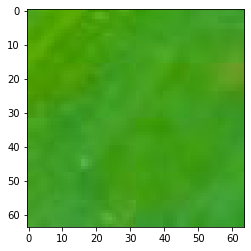

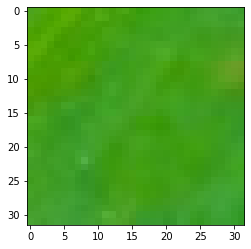

/content/Data_set_Train_x2/560/patch_553_14_1.jpg
/content/Data_set_Train_x2/560/patch_553_7_20.jpg
/content/Data_set_Train_x2/560/patch_552_23_25.jpg
/content/Data_set_Train_x2/560/patch_553_11_2.jpg
/content/Data_set_Train_x2/560/patch_553_0_14.jpg
/content/Data_set_Train_x2/560/patch_553_3_28.jpg
/content/Data_set_Train_x2/560/patch_553_3_18.jpg
/content/Data_set_Train_x2/560/patch_553_13_4.jpg
/content/Data_set_Train_x2/560/patch_552_22_24.jpg
/content/Data_set_Train_x2/560/patch_553_0_15.jpg
/content/Data_set_Train_x2/560/patch_553_5_9.jpg
/content/Data_set_Train_x2/560/patch_553_11_30.jpg
/content/Data_set_Train_x2/560/patch_553_2_2.jpg
/content/Data_set_Train_x2/560/patch_553_13_18.jpg
/content/Data_set_Train_x2/560/patch_553_11_24.jpg
/content/Data_set_Train_x2/560/patch_553_13_25.jpg
/content/Data_set_Train_x2/560/patch_553_5_5.jpg
/content/Data_set_Train_x2/560/patch_553_8_23.jpg
/content/Data_set_Train_x2/560/patch_553_12_26.jpg
/content/Data_set_Train_x2/560/patch_552_21_26

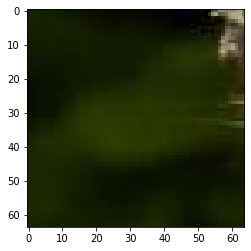

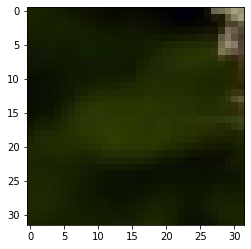

/content/Data_set_Train_x2/560/patch_554_5_5.jpg
/content/Data_set_Train_x2/560/patch_551_5_24.jpg
/content/Data_set_Train_x2/560/patch_551_6_14.jpg
/content/Data_set_Train_x2/560/patch_550_20_10.jpg
/content/Data_set_Train_x2/560/patch_551_12_21.jpg
/content/Data_set_Train_x2/560/patch_551_9_13.jpg
/content/Data_set_Train_x2/560/patch_551_4_16.jpg
/content/Data_set_Train_x2/560/patch_551_10_11.jpg
/content/Data_set_Train_x2/560/patch_551_1_6.jpg
/content/Data_set_Train_x2/560/patch_551_5_15.jpg
/content/Data_set_Train_x2/560/patch_551_10_3.jpg
/content/Data_set_Train_x2/560/patch_550_20_6.jpg
/content/Data_set_Train_x2/560/patch_550_18_27.jpg
/content/Data_set_Train_x2/560/patch_550_19_26.jpg
/content/Data_set_Train_x2/560/patch_551_12_27.jpg
/content/Data_set_Train_x2/560/patch_551_8_25.jpg
/content/Data_set_Train_x2/560/patch_551_4_23.jpg
/content/Data_set_Train_x2/560/patch_551_2_20.jpg
/content/Data_set_Train_x2/560/patch_551_3_17.jpg
/content/Data_set_Train_x2/560/patch_551_10_7.

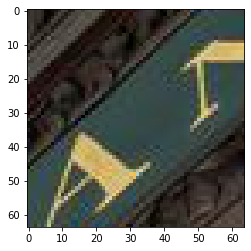

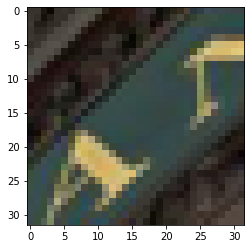

/content/Data_set_Train_x2/560/patch_552_4_29.jpg
/content/Data_set_Train_x2/560/patch_552_3_12.jpg
/content/Data_set_Train_x2/560/patch_551_19_21.jpg
/content/Data_set_Train_x2/560/patch_551_20_12.jpg
/content/Data_set_Train_x2/560/patch_551_22_19.jpg
/content/Data_set_Train_x2/560/patch_551_19_0.jpg
/content/Data_set_Train_x2/560/patch_551_23_23.jpg
/content/Data_set_Train_x2/560/patch_551_15_30.jpg
/content/Data_set_Train_x2/560/patch_551_23_21.jpg
/content/Data_set_Train_x2/560/patch_551_20_13.jpg
/content/Data_set_Train_x2/560/patch_552_0_20.jpg
/content/Data_set_Train_x2/560/patch_551_13_18.jpg
/content/Data_set_Train_x2/560/patch_551_18_1.jpg
/content/Data_set_Train_x2/560/patch_552_3_25.jpg
/content/Data_set_Train_x2/560/patch_551_20_16.jpg
/content/Data_set_Train_x2/560/patch_551_19_30.jpg
/content/Data_set_Train_x2/560/patch_551_16_5.jpg
/content/Data_set_Train_x2/560/patch_552_1_10.jpg
/content/Data_set_Train_x2/560/patch_552_2_17.jpg
/content/Data_set_Train_x2/560/patch_551

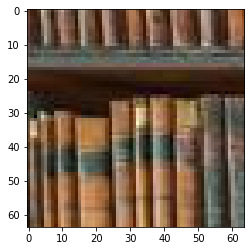

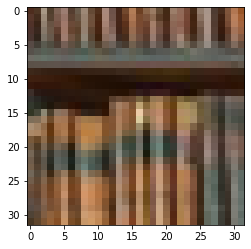

/content/Data_set_Train_x2/560/patch_552_10_1.jpg
/content/Data_set_Train_x2/560/patch_550_0_29.jpg
/content/Data_set_Train_x2/560/patch_550_0_11.jpg
/content/Data_set_Train_x2/560/patch_550_0_4.jpg
/content/Data_set_Train_x2/560/patch_550_0_20.jpg
/content/Data_set_Train_x2/560/patch_550_0_10.jpg
/content/Data_set_Train_x2/560/patch_550_0_17.jpg
/content/Data_set_Train_x2/560/patch_550_0_3.jpg
/content/Data_set_Train_x2/560/patch_550_0_18.jpg
/content/Data_set_Train_x2/560/patch_550_0_7.jpg
/content/Data_set_Train_x2/560/patch_550_1_0.jpg
/content/Data_set_Train_x2/560/patch_550_0_27.jpg
/content/Data_set_Train_x2/560/patch_550_1_2.jpg
/content/Data_set_Train_x2/560/patch_550_0_16.jpg
/content/Data_set_Train_x2/560/patch_550_0_12.jpg
/content/Data_set_Train_x2/560/patch_550_0_22.jpg
/content/Data_set_Train_x2/560/patch_550_0_26.jpg
/content/Data_set_Train_x2/560/patch_550_0_14.jpg
/content/Data_set_Train_x2/560/patch_550_0_2.jpg
/content/Data_set_Train_x2/560/patch_550_0_15.jpg
/conte

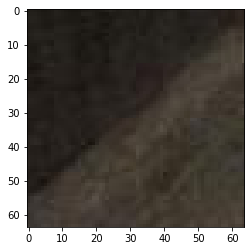

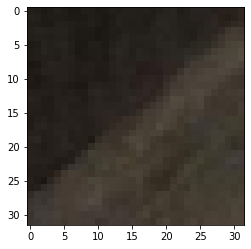

/content/Data_set_Train_x2/560/patch_550_15_1.jpg
/content/Data_set_Train_x2/560/patch_550_6_29.jpg
/content/Data_set_Train_x2/560/patch_550_7_16.jpg
/content/Data_set_Train_x2/560/patch_550_12_18.jpg
/content/Data_set_Train_x2/560/patch_550_6_1.jpg
/content/Data_set_Train_x2/560/patch_550_2_7.jpg
/content/Data_set_Train_x2/560/patch_550_10_27.jpg
/content/Data_set_Train_x2/560/patch_550_13_26.jpg
/content/Data_set_Train_x2/560/patch_550_11_14.jpg
/content/Data_set_Train_x2/560/patch_550_7_15.jpg
/content/Data_set_Train_x2/560/patch_550_17_18.jpg
/content/Data_set_Train_x2/560/patch_550_4_12.jpg
/content/Data_set_Train_x2/560/patch_550_9_5.jpg
/content/Data_set_Train_x2/560/patch_550_1_29.jpg
/content/Data_set_Train_x2/560/patch_550_17_17.jpg
/content/Data_set_Train_x2/560/patch_550_7_14.jpg
/content/Data_set_Train_x2/560/patch_550_6_13.jpg
/content/Data_set_Train_x2/560/patch_550_15_27.jpg
/content/Data_set_Train_x2/560/patch_550_6_15.jpg
/content/Data_set_Train_x2/560/patch_550_12_15

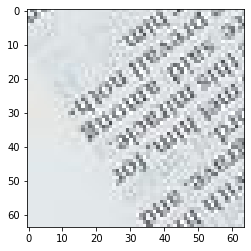

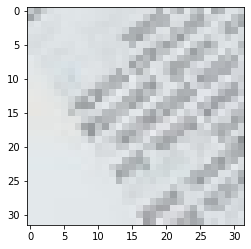

/content/Data_set_Train_x2/570/patch_569_13_20.jpg
/content/Data_set_Train_x2/570/patch_569_16_2.jpg
/content/Data_set_Train_x2/570/patch_569_17_4.jpg
/content/Data_set_Train_x2/570/patch_569_12_2.jpg
/content/Data_set_Train_x2/570/patch_569_12_16.jpg
/content/Data_set_Train_x2/570/patch_569_12_18.jpg
/content/Data_set_Train_x2/570/patch_569_17_17.jpg
/content/Data_set_Train_x2/570/patch_569_11_25.jpg
/content/Data_set_Train_x2/570/patch_569_10_23.jpg
/content/Data_set_Train_x2/570/patch_569_8_4.jpg
/content/Data_set_Train_x2/570/patch_569_9_13.jpg
/content/Data_set_Train_x2/570/patch_569_12_27.jpg
/content/Data_set_Train_x2/570/patch_569_15_9.jpg
/content/Data_set_Train_x2/570/patch_569_16_29.jpg
/content/Data_set_Train_x2/570/patch_569_14_13.jpg
/content/Data_set_Train_x2/570/patch_569_5_15.jpg
/content/Data_set_Train_x2/570/patch_569_2_0.jpg
/content/Data_set_Train_x2/570/patch_569_2_23.jpg
/content/Data_set_Train_x2/570/patch_569_15_27.jpg
/content/Data_set_Train_x2/570/patch_569_1

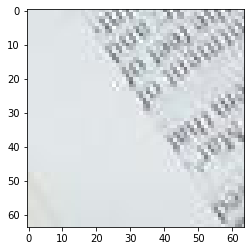

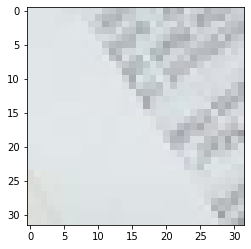

/content/Data_set_Train_x2/570/patch_569_18_23.jpg
/content/Data_set_Train_x2/570/patch_567_6_28.jpg
/content/Data_set_Train_x2/570/patch_567_5_12.jpg
/content/Data_set_Train_x2/570/patch_566_20_17.jpg
/content/Data_set_Train_x2/570/patch_567_5_0.jpg
/content/Data_set_Train_x2/570/patch_567_7_28.jpg
/content/Data_set_Train_x2/570/patch_567_4_13.jpg
/content/Data_set_Train_x2/570/patch_566_21_15.jpg
/content/Data_set_Train_x2/570/patch_567_2_19.jpg
/content/Data_set_Train_x2/570/patch_567_12_15.jpg
/content/Data_set_Train_x2/570/patch_567_12_11.jpg
/content/Data_set_Train_x2/570/patch_567_5_16.jpg
/content/Data_set_Train_x2/570/patch_567_3_9.jpg
/content/Data_set_Train_x2/570/patch_567_5_9.jpg
/content/Data_set_Train_x2/570/patch_567_2_14.jpg
/content/Data_set_Train_x2/570/patch_566_21_2.jpg
/content/Data_set_Train_x2/570/patch_567_1_2.jpg
/content/Data_set_Train_x2/570/patch_567_1_15.jpg
/content/Data_set_Train_x2/570/patch_567_5_13.jpg
/content/Data_set_Train_x2/570/patch_566_18_0.jpg

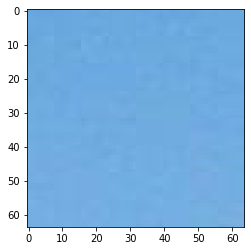

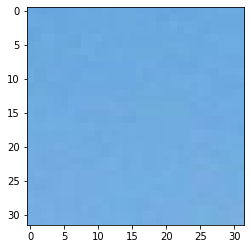

/content/Data_set_Train_x2/570/patch_568_1_19.jpg
/content/Data_set_Train_x2/570/patch_568_5_9.jpg
/content/Data_set_Train_x2/570/patch_567_15_12.jpg
/content/Data_set_Train_x2/570/patch_568_1_17.jpg
/content/Data_set_Train_x2/570/patch_568_4_30.jpg
/content/Data_set_Train_x2/570/patch_567_16_13.jpg
/content/Data_set_Train_x2/570/patch_567_16_29.jpg
/content/Data_set_Train_x2/570/patch_568_1_8.jpg
/content/Data_set_Train_x2/570/patch_567_13_17.jpg
/content/Data_set_Train_x2/570/patch_567_18_7.jpg
/content/Data_set_Train_x2/570/patch_567_13_13.jpg
/content/Data_set_Train_x2/570/patch_568_1_3.jpg
/content/Data_set_Train_x2/570/patch_568_0_8.jpg
/content/Data_set_Train_x2/570/patch_567_14_14.jpg
/content/Data_set_Train_x2/570/patch_567_14_9.jpg
/content/Data_set_Train_x2/570/patch_568_2_11.jpg
/content/Data_set_Train_x2/570/patch_568_7_30.jpg
/content/Data_set_Train_x2/570/patch_567_12_26.jpg
/content/Data_set_Train_x2/570/patch_567_14_18.jpg
/content/Data_set_Train_x2/570/patch_568_2_12.

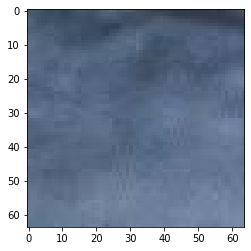

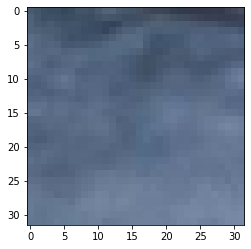

/content/Data_set_Train_x2/570/patch_569_0_27.jpg
/content/Data_set_Train_x2/570/patch_565_6_19.jpg
/content/Data_set_Train_x2/570/patch_565_10_15.jpg
/content/Data_set_Train_x2/570/patch_565_16_22.jpg
/content/Data_set_Train_x2/570/patch_565_19_14.jpg
/content/Data_set_Train_x2/570/patch_565_12_25.jpg
/content/Data_set_Train_x2/570/patch_565_8_17.jpg
/content/Data_set_Train_x2/570/patch_565_20_21.jpg
/content/Data_set_Train_x2/570/patch_565_7_7.jpg
/content/Data_set_Train_x2/570/patch_565_9_7.jpg
/content/Data_set_Train_x2/570/patch_565_8_1.jpg
/content/Data_set_Train_x2/570/patch_565_7_11.jpg
/content/Data_set_Train_x2/570/patch_565_18_22.jpg
/content/Data_set_Train_x2/570/patch_565_18_12.jpg
/content/Data_set_Train_x2/570/patch_565_9_20.jpg
/content/Data_set_Train_x2/570/patch_565_13_12.jpg
/content/Data_set_Train_x2/570/patch_565_15_28.jpg
/content/Data_set_Train_x2/570/patch_565_15_17.jpg
/content/Data_set_Train_x2/570/patch_565_12_27.jpg
/content/Data_set_Train_x2/570/patch_565_7

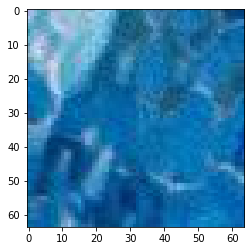

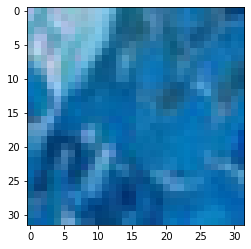

/content/Data_set_Train_x2/570/patch_566_12_29.jpg
/content/Data_set_Train_x2/570/patch_566_12_5.jpg
/content/Data_set_Train_x2/570/patch_566_14_28.jpg
/content/Data_set_Train_x2/570/patch_566_17_28.jpg
/content/Data_set_Train_x2/570/patch_566_5_24.jpg
/content/Data_set_Train_x2/570/patch_566_17_23.jpg
/content/Data_set_Train_x2/570/patch_566_6_9.jpg
/content/Data_set_Train_x2/570/patch_566_5_9.jpg
/content/Data_set_Train_x2/570/patch_566_6_16.jpg
/content/Data_set_Train_x2/570/patch_566_4_9.jpg
/content/Data_set_Train_x2/570/patch_566_6_22.jpg
/content/Data_set_Train_x2/570/patch_566_1_29.jpg
/content/Data_set_Train_x2/570/patch_566_12_11.jpg
/content/Data_set_Train_x2/570/patch_566_8_10.jpg
/content/Data_set_Train_x2/570/patch_566_13_28.jpg
/content/Data_set_Train_x2/570/patch_566_11_17.jpg
/content/Data_set_Train_x2/570/patch_566_17_21.jpg
/content/Data_set_Train_x2/570/patch_566_11_25.jpg
/content/Data_set_Train_x2/570/patch_566_9_22.jpg
/content/Data_set_Train_x2/570/patch_566_8_4

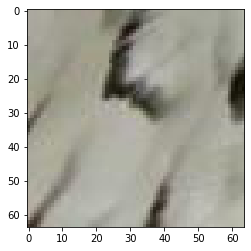

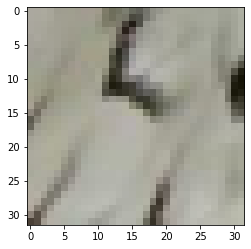

/content/Data_set_Train_x2/570/patch_567_11_6.jpg
/content/Data_set_Train_x2/570/patch_564_0_11.jpg
/content/Data_set_Train_x2/570/patch_564_2_19.jpg
/content/Data_set_Train_x2/570/patch_564_1_12.jpg
/content/Data_set_Train_x2/570/patch_564_4_2.jpg
/content/Data_set_Train_x2/570/patch_563_20_4.jpg
/content/Data_set_Train_x2/570/patch_564_0_23.jpg
/content/Data_set_Train_x2/570/patch_563_16_24.jpg
/content/Data_set_Train_x2/570/patch_564_0_16.jpg
/content/Data_set_Train_x2/570/patch_563_17_4.jpg
/content/Data_set_Train_x2/570/patch_564_1_5.jpg
/content/Data_set_Train_x2/570/patch_563_16_14.jpg
/content/Data_set_Train_x2/570/patch_564_1_1.jpg
/content/Data_set_Train_x2/570/patch_563_17_26.jpg
/content/Data_set_Train_x2/570/patch_564_1_7.jpg
/content/Data_set_Train_x2/570/patch_564_9_4.jpg
/content/Data_set_Train_x2/570/patch_564_10_21.jpg
/content/Data_set_Train_x2/570/patch_564_3_16.jpg
/content/Data_set_Train_x2/570/patch_563_17_27.jpg
/content/Data_set_Train_x2/570/patch_563_20_25.jpg

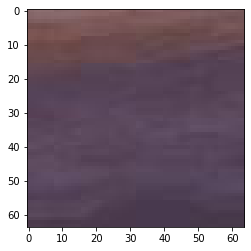

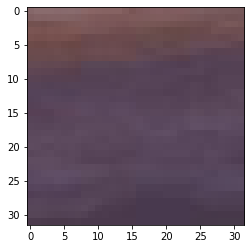

/content/Data_set_Train_x2/570/patch_564_15_3.jpg
/content/Data_set_Train_x2/570/patch_565_2_21.jpg
/content/Data_set_Train_x2/570/patch_564_14_22.jpg
/content/Data_set_Train_x2/570/patch_565_6_8.jpg
/content/Data_set_Train_x2/570/patch_565_1_17.jpg
/content/Data_set_Train_x2/570/patch_564_17_9.jpg
/content/Data_set_Train_x2/570/patch_564_16_16.jpg
/content/Data_set_Train_x2/570/patch_564_11_5.jpg
/content/Data_set_Train_x2/570/patch_565_0_22.jpg
/content/Data_set_Train_x2/570/patch_564_18_1.jpg
/content/Data_set_Train_x2/570/patch_564_13_9.jpg
/content/Data_set_Train_x2/570/patch_565_5_24.jpg
/content/Data_set_Train_x2/570/patch_564_19_23.jpg
/content/Data_set_Train_x2/570/patch_564_19_7.jpg
/content/Data_set_Train_x2/570/patch_564_16_19.jpg
/content/Data_set_Train_x2/570/patch_564_13_0.jpg
/content/Data_set_Train_x2/570/patch_564_12_13.jpg
/content/Data_set_Train_x2/570/patch_564_17_20.jpg
/content/Data_set_Train_x2/570/patch_564_17_12.jpg
/content/Data_set_Train_x2/570/patch_565_6_3

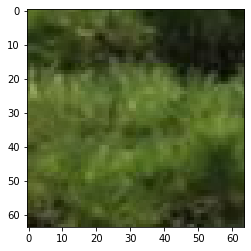

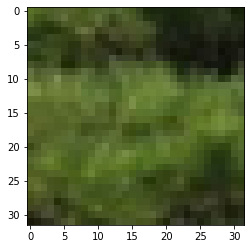

/content/Data_set_Train_x2/570/patch_565_14_14.jpg
/content/Data_set_Train_x2/570/patch_562_16_23.jpg
/content/Data_set_Train_x2/570/patch_562_21_17.jpg
/content/Data_set_Train_x2/570/patch_562_7_22.jpg
/content/Data_set_Train_x2/570/patch_562_22_27.jpg
/content/Data_set_Train_x2/570/patch_562_18_3.jpg
/content/Data_set_Train_x2/570/patch_562_11_7.jpg
/content/Data_set_Train_x2/570/patch_562_9_19.jpg
/content/Data_set_Train_x2/570/patch_562_17_2.jpg
/content/Data_set_Train_x2/570/patch_562_10_21.jpg
/content/Data_set_Train_x2/570/patch_562_13_30.jpg
/content/Data_set_Train_x2/570/patch_562_13_10.jpg
/content/Data_set_Train_x2/570/patch_562_11_25.jpg
/content/Data_set_Train_x2/570/patch_562_23_2.jpg
/content/Data_set_Train_x2/570/patch_562_18_25.jpg
/content/Data_set_Train_x2/570/patch_562_6_30.jpg
/content/Data_set_Train_x2/570/patch_562_14_15.jpg
/content/Data_set_Train_x2/570/patch_562_13_19.jpg
/content/Data_set_Train_x2/570/patch_562_17_12.jpg
/content/Data_set_Train_x2/570/patch_5

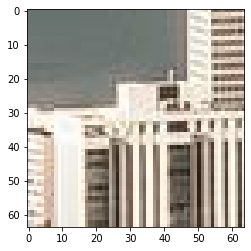

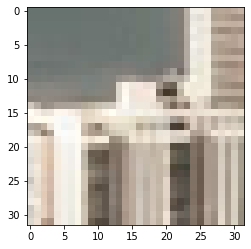

/content/Data_set_Train_x2/570/patch_563_7_12.jpg
/content/Data_set_Train_x2/570/patch_563_12_25.jpg
/content/Data_set_Train_x2/570/patch_563_0_15.jpg
/content/Data_set_Train_x2/570/patch_563_1_3.jpg
/content/Data_set_Train_x2/570/patch_563_10_1.jpg
/content/Data_set_Train_x2/570/patch_563_4_21.jpg
/content/Data_set_Train_x2/570/patch_563_13_5.jpg
/content/Data_set_Train_x2/570/patch_563_7_25.jpg
/content/Data_set_Train_x2/570/patch_563_13_20.jpg
/content/Data_set_Train_x2/570/patch_563_11_5.jpg
/content/Data_set_Train_x2/570/patch_563_0_19.jpg
/content/Data_set_Train_x2/570/patch_563_6_10.jpg
/content/Data_set_Train_x2/570/patch_563_6_19.jpg
/content/Data_set_Train_x2/570/patch_563_3_0.jpg
/content/Data_set_Train_x2/570/patch_563_8_11.jpg
/content/Data_set_Train_x2/570/patch_563_4_28.jpg
/content/Data_set_Train_x2/570/patch_563_11_14.jpg
/content/Data_set_Train_x2/570/patch_563_14_23.jpg
/content/Data_set_Train_x2/570/patch_563_10_17.jpg
/content/Data_set_Train_x2/570/patch_563_6_3.jp

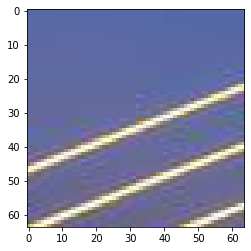

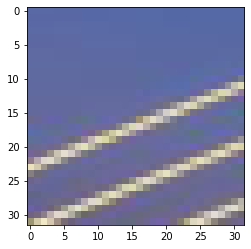

/content/Data_set_Train_x2/570/patch_564_10_9.jpg
/content/Data_set_Train_x2/570/patch_561_2_12.jpg
/content/Data_set_Train_x2/570/patch_561_4_19.jpg
/content/Data_set_Train_x2/570/patch_561_2_7.jpg
/content/Data_set_Train_x2/570/patch_561_3_12.jpg
/content/Data_set_Train_x2/570/patch_561_5_11.jpg
/content/Data_set_Train_x2/570/patch_561_6_24.jpg
/content/Data_set_Train_x2/570/patch_561_11_3.jpg
/content/Data_set_Train_x2/570/patch_561_8_12.jpg
/content/Data_set_Train_x2/570/patch_560_19_6.jpg
/content/Data_set_Train_x2/570/patch_560_15_22.jpg
/content/Data_set_Train_x2/570/patch_561_2_27.jpg
/content/Data_set_Train_x2/570/patch_560_20_0.jpg
/content/Data_set_Train_x2/570/patch_561_4_11.jpg
/content/Data_set_Train_x2/570/patch_561_3_27.jpg
/content/Data_set_Train_x2/570/patch_561_4_22.jpg
/content/Data_set_Train_x2/570/patch_561_1_4.jpg
/content/Data_set_Train_x2/570/patch_561_11_6.jpg
/content/Data_set_Train_x2/570/patch_561_5_16.jpg
/content/Data_set_Train_x2/570/patch_560_16_8.jpg
/

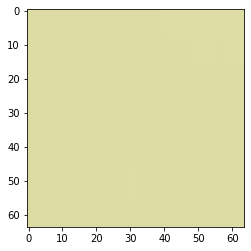

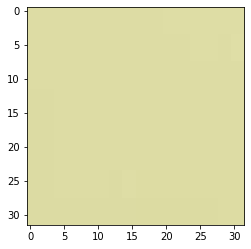

/content/Data_set_Train_x2/570/patch_562_0_28.jpg
/content/Data_set_Train_x2/570/patch_561_19_16.jpg
/content/Data_set_Train_x2/570/patch_562_1_6.jpg
/content/Data_set_Train_x2/570/patch_562_2_1.jpg
/content/Data_set_Train_x2/570/patch_562_4_19.jpg
/content/Data_set_Train_x2/570/patch_561_11_11.jpg
/content/Data_set_Train_x2/570/patch_562_1_14.jpg
/content/Data_set_Train_x2/570/patch_562_2_17.jpg
/content/Data_set_Train_x2/570/patch_561_15_3.jpg
/content/Data_set_Train_x2/570/patch_561_19_30.jpg
/content/Data_set_Train_x2/570/patch_561_17_8.jpg
/content/Data_set_Train_x2/570/patch_561_15_6.jpg
/content/Data_set_Train_x2/570/patch_561_11_29.jpg
/content/Data_set_Train_x2/570/patch_561_12_15.jpg
/content/Data_set_Train_x2/570/patch_561_14_4.jpg
/content/Data_set_Train_x2/570/patch_561_12_2.jpg
/content/Data_set_Train_x2/570/patch_562_0_0.jpg
/content/Data_set_Train_x2/570/patch_562_3_30.jpg
/content/Data_set_Train_x2/570/patch_561_17_24.jpg
/content/Data_set_Train_x2/570/patch_561_12_16.

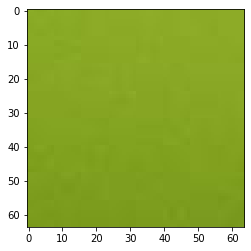

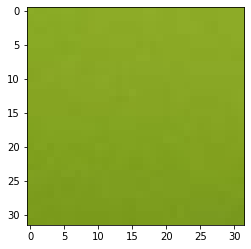

/content/Data_set_Train_x2/570/patch_562_19_8.jpg
/content/Data_set_Train_x2/570/patch_560_11_0.jpg
/content/Data_set_Train_x2/570/patch_560_2_24.jpg
/content/Data_set_Train_x2/570/patch_560_3_9.jpg
/content/Data_set_Train_x2/570/patch_560_7_25.jpg
/content/Data_set_Train_x2/570/patch_560_5_27.jpg
/content/Data_set_Train_x2/570/patch_560_14_7.jpg
/content/Data_set_Train_x2/570/patch_560_8_25.jpg
/content/Data_set_Train_x2/570/patch_560_11_23.jpg
/content/Data_set_Train_x2/570/patch_560_13_11.jpg
/content/Data_set_Train_x2/570/patch_560_13_21.jpg
/content/Data_set_Train_x2/570/patch_560_7_10.jpg
/content/Data_set_Train_x2/570/patch_560_0_12.jpg
/content/Data_set_Train_x2/570/patch_560_13_13.jpg
/content/Data_set_Train_x2/570/patch_560_12_22.jpg
/content/Data_set_Train_x2/570/patch_560_0_6.jpg
/content/Data_set_Train_x2/570/patch_560_3_8.jpg
/content/Data_set_Train_x2/570/patch_560_13_30.jpg
/content/Data_set_Train_x2/570/patch_560_12_3.jpg
/content/Data_set_Train_x2/570/patch_560_10_1.j

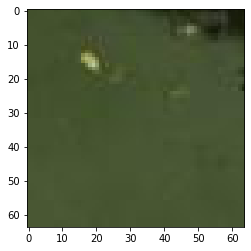

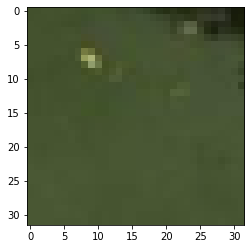

/content/Data_set_Train_x2/570/patch_560_20_24.jpg
/content/Data_set_Train_x2/570/patch_561_10_2.jpg
/content/Data_set_Train_x2/570/patch_561_5_20.jpg
/content/Data_set_Train_x2/570/patch_560_18_3.jpg
/content/Data_set_Train_x2/570/patch_561_10_23.jpg
/content/Data_set_Train_x2/570/patch_561_6_6.jpg
/content/Data_set_Train_x2/570/patch_560_19_13.jpg
/content/Data_set_Train_x2/570/patch_560_17_0.jpg
/content/Data_set_Train_x2/570/patch_561_7_12.jpg
/content/Data_set_Train_x2/570/patch_560_18_13.jpg
/content/Data_set_Train_x2/570/patch_561_8_15.jpg
/content/Data_set_Train_x2/570/patch_561_5_21.jpg
/content/Data_set_Train_x2/570/patch_560_20_2.jpg
/content/Data_set_Train_x2/570/patch_560_17_6.jpg
/content/Data_set_Train_x2/570/patch_561_2_26.jpg
/content/Data_set_Train_x2/570/patch_561_3_22.jpg
/content/Data_set_Train_x2/570/patch_560_20_4.jpg
/content/Data_set_Train_x2/570/patch_560_19_8.jpg
/content/Data_set_Train_x2/570/patch_561_5_12.jpg
/content/Data_set_Train_x2/570/patch_561_5_25.j

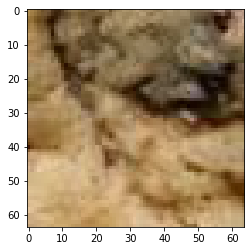

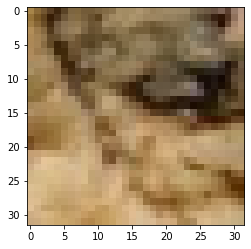

/content/Data_set_Train_x2/580/patch_578_27_18.jpg
/content/Data_set_Train_x2/580/patch_579_5_14.jpg
/content/Data_set_Train_x2/580/patch_579_5_17.jpg
/content/Data_set_Train_x2/580/patch_578_22_19.jpg
/content/Data_set_Train_x2/580/patch_579_1_17.jpg
/content/Data_set_Train_x2/580/patch_578_26_11.jpg
/content/Data_set_Train_x2/580/patch_579_1_22.jpg
/content/Data_set_Train_x2/580/patch_579_6_4.jpg
/content/Data_set_Train_x2/580/patch_578_30_20.jpg
/content/Data_set_Train_x2/580/patch_579_1_29.jpg
/content/Data_set_Train_x2/580/patch_579_3_13.jpg
/content/Data_set_Train_x2/580/patch_579_3_14.jpg
/content/Data_set_Train_x2/580/patch_579_3_30.jpg
/content/Data_set_Train_x2/580/patch_579_2_12.jpg
/content/Data_set_Train_x2/580/patch_578_27_12.jpg
/content/Data_set_Train_x2/580/patch_579_5_10.jpg
/content/Data_set_Train_x2/580/patch_579_2_18.jpg
/content/Data_set_Train_x2/580/patch_579_5_26.jpg
/content/Data_set_Train_x2/580/patch_578_30_6.jpg
/content/Data_set_Train_x2/580/patch_578_27_16

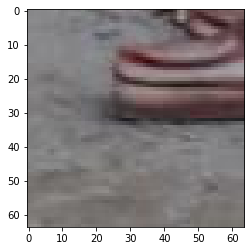

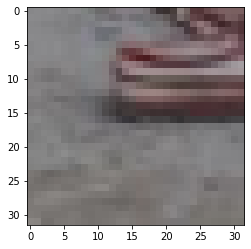

/content/Data_set_Train_x2/580/patch_579_14_1.jpg
/content/Data_set_Train_x2/580/patch_576_13_10.jpg
/content/Data_set_Train_x2/580/patch_577_0_17.jpg
/content/Data_set_Train_x2/580/patch_576_6_23.jpg
/content/Data_set_Train_x2/580/patch_577_1_14.jpg
/content/Data_set_Train_x2/580/patch_576_15_24.jpg
/content/Data_set_Train_x2/580/patch_576_9_14.jpg
/content/Data_set_Train_x2/580/patch_576_5_3.jpg
/content/Data_set_Train_x2/580/patch_576_11_7.jpg
/content/Data_set_Train_x2/580/patch_576_14_22.jpg
/content/Data_set_Train_x2/580/patch_577_1_22.jpg
/content/Data_set_Train_x2/580/patch_577_2_23.jpg
/content/Data_set_Train_x2/580/patch_576_10_8.jpg
/content/Data_set_Train_x2/580/patch_576_6_5.jpg
/content/Data_set_Train_x2/580/patch_576_16_19.jpg
/content/Data_set_Train_x2/580/patch_576_7_25.jpg
/content/Data_set_Train_x2/580/patch_576_10_9.jpg
/content/Data_set_Train_x2/580/patch_577_0_18.jpg
/content/Data_set_Train_x2/580/patch_576_8_21.jpg
/content/Data_set_Train_x2/580/patch_576_6_4.jpg

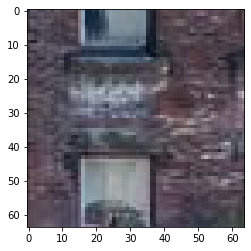

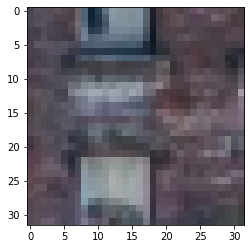

/content/Data_set_Train_x2/580/patch_577_6_20.jpg
/content/Data_set_Train_x2/580/patch_577_3_18.jpg
/content/Data_set_Train_x2/580/patch_577_10_7.jpg
/content/Data_set_Train_x2/580/patch_577_16_15.jpg
/content/Data_set_Train_x2/580/patch_577_17_30.jpg
/content/Data_set_Train_x2/580/patch_577_8_5.jpg
/content/Data_set_Train_x2/580/patch_577_11_14.jpg
/content/Data_set_Train_x2/580/patch_577_3_13.jpg
/content/Data_set_Train_x2/580/patch_577_4_8.jpg
/content/Data_set_Train_x2/580/patch_577_13_7.jpg
/content/Data_set_Train_x2/580/patch_577_16_8.jpg
/content/Data_set_Train_x2/580/patch_577_3_27.jpg
/content/Data_set_Train_x2/580/patch_577_16_16.jpg
/content/Data_set_Train_x2/580/patch_577_4_12.jpg
/content/Data_set_Train_x2/580/patch_577_8_1.jpg
/content/Data_set_Train_x2/580/patch_577_15_16.jpg
/content/Data_set_Train_x2/580/patch_577_16_12.jpg
/content/Data_set_Train_x2/580/patch_577_12_27.jpg
/content/Data_set_Train_x2/580/patch_577_10_24.jpg
/content/Data_set_Train_x2/580/patch_577_13_2

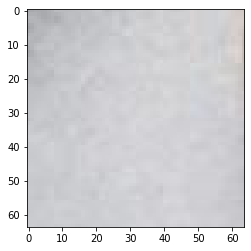

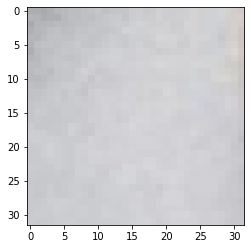

/content/Data_set_Train_x2/580/patch_578_13_11.jpg
/content/Data_set_Train_x2/580/patch_574_29_9.jpg
/content/Data_set_Train_x2/580/patch_574_27_11.jpg
/content/Data_set_Train_x2/580/patch_575_1_5.jpg
/content/Data_set_Train_x2/580/patch_575_0_5.jpg
/content/Data_set_Train_x2/580/patch_575_4_0.jpg
/content/Data_set_Train_x2/580/patch_575_11_15.jpg
/content/Data_set_Train_x2/580/patch_575_5_22.jpg
/content/Data_set_Train_x2/580/patch_575_5_27.jpg
/content/Data_set_Train_x2/580/patch_574_30_6.jpg
/content/Data_set_Train_x2/580/patch_575_4_20.jpg
/content/Data_set_Train_x2/580/patch_574_29_13.jpg
/content/Data_set_Train_x2/580/patch_575_2_9.jpg
/content/Data_set_Train_x2/580/patch_574_26_21.jpg
/content/Data_set_Train_x2/580/patch_575_12_4.jpg
/content/Data_set_Train_x2/580/patch_575_7_11.jpg
/content/Data_set_Train_x2/580/patch_575_5_2.jpg
/content/Data_set_Train_x2/580/patch_574_25_7.jpg
/content/Data_set_Train_x2/580/patch_574_27_17.jpg
/content/Data_set_Train_x2/580/patch_575_1_20.jpg

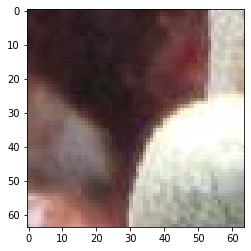

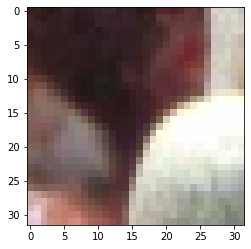

/content/Data_set_Train_x2/580/patch_575_17_17.jpg
/content/Data_set_Train_x2/580/patch_575_22_13.jpg
/content/Data_set_Train_x2/580/patch_575_23_19.jpg
/content/Data_set_Train_x2/580/patch_575_13_15.jpg
/content/Data_set_Train_x2/580/patch_575_16_8.jpg
/content/Data_set_Train_x2/580/patch_575_16_14.jpg
/content/Data_set_Train_x2/580/patch_575_15_30.jpg
/content/Data_set_Train_x2/580/patch_576_1_24.jpg
/content/Data_set_Train_x2/580/patch_575_21_22.jpg
/content/Data_set_Train_x2/580/patch_575_15_29.jpg
/content/Data_set_Train_x2/580/patch_575_22_19.jpg
/content/Data_set_Train_x2/580/patch_575_14_22.jpg
/content/Data_set_Train_x2/580/patch_575_16_20.jpg
/content/Data_set_Train_x2/580/patch_575_14_11.jpg
/content/Data_set_Train_x2/580/patch_576_3_18.jpg
/content/Data_set_Train_x2/580/patch_575_20_3.jpg
/content/Data_set_Train_x2/580/patch_575_19_26.jpg
/content/Data_set_Train_x2/580/patch_575_13_24.jpg
/content/Data_set_Train_x2/580/patch_575_18_18.jpg
/content/Data_set_Train_x2/580/patc

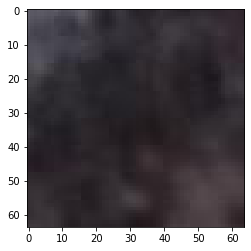

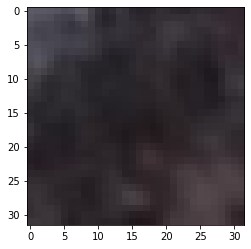

/content/Data_set_Train_x2/580/patch_576_8_6.jpg
/content/Data_set_Train_x2/580/patch_573_19_3.jpg
/content/Data_set_Train_x2/580/patch_574_1_21.jpg
/content/Data_set_Train_x2/580/patch_573_23_17.jpg
/content/Data_set_Train_x2/580/patch_573_22_13.jpg
/content/Data_set_Train_x2/580/patch_573_16_1.jpg
/content/Data_set_Train_x2/580/patch_573_12_2.jpg
/content/Data_set_Train_x2/580/patch_573_18_7.jpg
/content/Data_set_Train_x2/580/patch_573_26_6.jpg
/content/Data_set_Train_x2/580/patch_573_22_7.jpg
/content/Data_set_Train_x2/580/patch_573_12_5.jpg
/content/Data_set_Train_x2/580/patch_573_28_5.jpg
/content/Data_set_Train_x2/580/patch_573_11_8.jpg
/content/Data_set_Train_x2/580/patch_573_25_12.jpg
/content/Data_set_Train_x2/580/patch_573_16_9.jpg
/content/Data_set_Train_x2/580/patch_573_28_3.jpg
/content/Data_set_Train_x2/580/patch_573_25_5.jpg
/content/Data_set_Train_x2/580/patch_573_26_16.jpg
/content/Data_set_Train_x2/580/patch_573_30_0.jpg
/content/Data_set_Train_x2/580/patch_573_20_19.

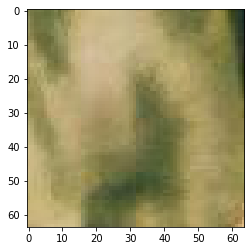

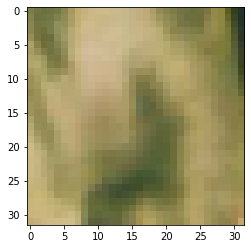

/content/Data_set_Train_x2/580/patch_574_13_8.jpg
/content/Data_set_Train_x2/580/patch_574_16_22.jpg
/content/Data_set_Train_x2/580/patch_574_15_7.jpg
/content/Data_set_Train_x2/580/patch_574_12_22.jpg
/content/Data_set_Train_x2/580/patch_574_14_13.jpg
/content/Data_set_Train_x2/580/patch_574_13_4.jpg
/content/Data_set_Train_x2/580/patch_574_9_5.jpg
/content/Data_set_Train_x2/580/patch_574_18_11.jpg
/content/Data_set_Train_x2/580/patch_574_10_3.jpg
/content/Data_set_Train_x2/580/patch_574_4_7.jpg
/content/Data_set_Train_x2/580/patch_574_21_14.jpg
/content/Data_set_Train_x2/580/patch_574_5_6.jpg
/content/Data_set_Train_x2/580/patch_574_20_1.jpg
/content/Data_set_Train_x2/580/patch_574_23_10.jpg
/content/Data_set_Train_x2/580/patch_574_12_11.jpg
/content/Data_set_Train_x2/580/patch_574_19_22.jpg
/content/Data_set_Train_x2/580/patch_574_8_5.jpg
/content/Data_set_Train_x2/580/patch_574_22_21.jpg
/content/Data_set_Train_x2/580/patch_574_17_20.jpg
/content/Data_set_Train_x2/580/patch_574_8_4

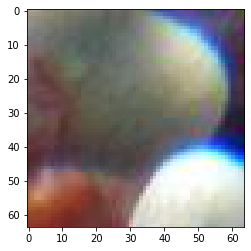

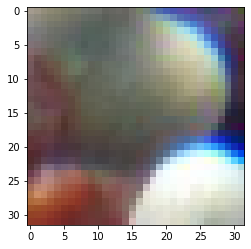

/content/Data_set_Train_x2/580/patch_575_1_23.jpg
/content/Data_set_Train_x2/580/patch_572_19_21.jpg
/content/Data_set_Train_x2/580/patch_572_4_19.jpg
/content/Data_set_Train_x2/580/patch_572_16_11.jpg
/content/Data_set_Train_x2/580/patch_572_8_28.jpg
/content/Data_set_Train_x2/580/patch_572_9_23.jpg
/content/Data_set_Train_x2/580/patch_572_19_9.jpg
/content/Data_set_Train_x2/580/patch_572_11_15.jpg
/content/Data_set_Train_x2/580/patch_572_11_16.jpg
/content/Data_set_Train_x2/580/patch_572_21_1.jpg
/content/Data_set_Train_x2/580/patch_572_8_5.jpg
/content/Data_set_Train_x2/580/patch_572_6_21.jpg
/content/Data_set_Train_x2/580/patch_572_20_30.jpg
/content/Data_set_Train_x2/580/patch_572_21_4.jpg
/content/Data_set_Train_x2/580/patch_572_13_2.jpg
/content/Data_set_Train_x2/580/patch_572_18_27.jpg
/content/Data_set_Train_x2/580/patch_572_19_7.jpg
/content/Data_set_Train_x2/580/patch_572_13_27.jpg
/content/Data_set_Train_x2/580/patch_572_10_19.jpg
/content/Data_set_Train_x2/580/patch_572_9_

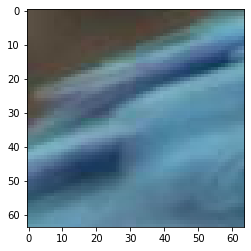

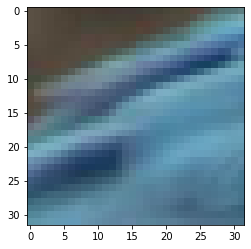

/content/Data_set_Train_x2/580/patch_573_3_8.jpg
/content/Data_set_Train_x2/580/patch_572_22_5.jpg
/content/Data_set_Train_x2/580/patch_572_25_11.jpg
/content/Data_set_Train_x2/580/patch_572_22_28.jpg
/content/Data_set_Train_x2/580/patch_572_27_12.jpg
/content/Data_set_Train_x2/580/patch_573_0_12.jpg
/content/Data_set_Train_x2/580/patch_572_22_20.jpg
/content/Data_set_Train_x2/580/patch_573_9_7.jpg
/content/Data_set_Train_x2/580/patch_572_28_29.jpg
/content/Data_set_Train_x2/580/patch_572_30_0.jpg
/content/Data_set_Train_x2/580/patch_572_24_13.jpg
/content/Data_set_Train_x2/580/patch_572_27_29.jpg
/content/Data_set_Train_x2/580/patch_573_4_13.jpg
/content/Data_set_Train_x2/580/patch_573_2_0.jpg
/content/Data_set_Train_x2/580/patch_572_24_30.jpg
/content/Data_set_Train_x2/580/patch_573_3_14.jpg
/content/Data_set_Train_x2/580/patch_572_29_17.jpg
/content/Data_set_Train_x2/580/patch_573_2_18.jpg
/content/Data_set_Train_x2/580/patch_572_26_22.jpg
/content/Data_set_Train_x2/580/patch_572_26

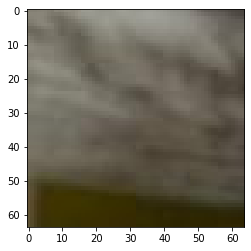

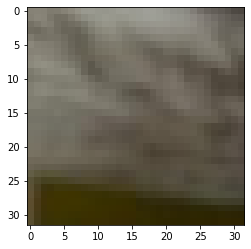

/content/Data_set_Train_x2/580/patch_573_30_7.jpg
/content/Data_set_Train_x2/580/patch_571_3_28.jpg
/content/Data_set_Train_x2/580/patch_570_22_12.jpg
/content/Data_set_Train_x2/580/patch_570_23_19.jpg
/content/Data_set_Train_x2/580/patch_571_1_4.jpg
/content/Data_set_Train_x2/580/patch_570_21_14.jpg
/content/Data_set_Train_x2/580/patch_570_29_19.jpg
/content/Data_set_Train_x2/580/patch_571_2_6.jpg
/content/Data_set_Train_x2/580/patch_571_2_30.jpg
/content/Data_set_Train_x2/580/patch_571_4_24.jpg
/content/Data_set_Train_x2/580/patch_570_18_14.jpg
/content/Data_set_Train_x2/580/patch_571_1_17.jpg
/content/Data_set_Train_x2/580/patch_571_3_11.jpg
/content/Data_set_Train_x2/580/patch_570_30_1.jpg
/content/Data_set_Train_x2/580/patch_571_3_26.jpg
/content/Data_set_Train_x2/580/patch_570_20_8.jpg
/content/Data_set_Train_x2/580/patch_571_3_14.jpg
/content/Data_set_Train_x2/580/patch_571_1_16.jpg
/content/Data_set_Train_x2/580/patch_570_18_18.jpg
/content/Data_set_Train_x2/580/patch_570_24_14

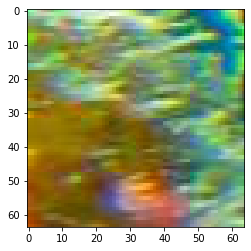

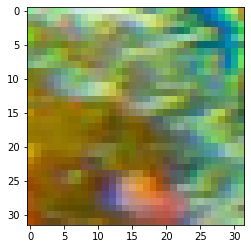

/content/Data_set_Train_x2/580/patch_571_9_0.jpg
/content/Data_set_Train_x2/580/patch_572_2_29.jpg
/content/Data_set_Train_x2/580/patch_572_3_26.jpg
/content/Data_set_Train_x2/580/patch_571_12_30.jpg
/content/Data_set_Train_x2/580/patch_572_2_0.jpg
/content/Data_set_Train_x2/580/patch_572_0_0.jpg
/content/Data_set_Train_x2/580/patch_571_14_30.jpg
/content/Data_set_Train_x2/580/patch_572_2_6.jpg
/content/Data_set_Train_x2/580/patch_571_18_3.jpg
/content/Data_set_Train_x2/580/patch_572_0_3.jpg
/content/Data_set_Train_x2/580/patch_571_12_17.jpg
/content/Data_set_Train_x2/580/patch_572_1_6.jpg
/content/Data_set_Train_x2/580/patch_571_7_11.jpg
/content/Data_set_Train_x2/580/patch_572_3_3.jpg
/content/Data_set_Train_x2/580/patch_572_3_11.jpg
/content/Data_set_Train_x2/580/patch_571_10_28.jpg
/content/Data_set_Train_x2/580/patch_571_12_18.jpg
/content/Data_set_Train_x2/580/patch_571_12_25.jpg
/content/Data_set_Train_x2/580/patch_571_17_11.jpg
/content/Data_set_Train_x2/580/patch_571_15_15.jpg

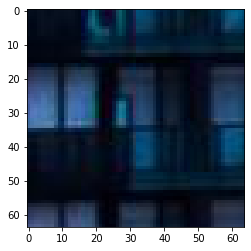

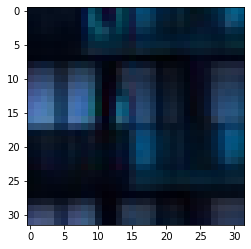

/content/Data_set_Train_x2/580/patch_572_15_5.jpg
/content/Data_set_Train_x2/580/patch_570_7_2.jpg
/content/Data_set_Train_x2/580/patch_570_12_6.jpg
/content/Data_set_Train_x2/580/patch_570_3_15.jpg
/content/Data_set_Train_x2/580/patch_570_5_6.jpg
/content/Data_set_Train_x2/580/patch_570_8_7.jpg
/content/Data_set_Train_x2/580/patch_570_16_10.jpg
/content/Data_set_Train_x2/580/patch_570_5_3.jpg
/content/Data_set_Train_x2/580/patch_570_0_10.jpg
/content/Data_set_Train_x2/580/patch_570_11_18.jpg
/content/Data_set_Train_x2/580/patch_570_1_5.jpg
/content/Data_set_Train_x2/580/patch_570_4_11.jpg
/content/Data_set_Train_x2/580/patch_570_11_2.jpg
/content/Data_set_Train_x2/580/patch_570_0_14.jpg
/content/Data_set_Train_x2/580/patch_570_17_2.jpg
/content/Data_set_Train_x2/580/patch_570_8_18.jpg
/content/Data_set_Train_x2/580/patch_570_3_2.jpg
/content/Data_set_Train_x2/580/patch_570_10_19.jpg
/content/Data_set_Train_x2/580/patch_570_5_15.jpg
/content/Data_set_Train_x2/580/patch_570_3_8.jpg
/con

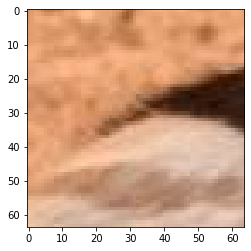

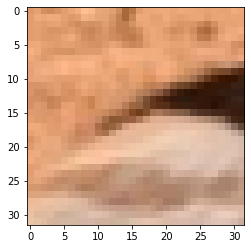

/content/Data_set_Train_x2/580/patch_570_22_9.jpg
/content/Data_set_Train_x2/580/patch_571_4_22.jpg
/content/Data_set_Train_x2/580/patch_570_27_12.jpg
/content/Data_set_Train_x2/580/patch_571_3_18.jpg
/content/Data_set_Train_x2/580/patch_570_24_8.jpg
/content/Data_set_Train_x2/580/patch_570_27_9.jpg
/content/Data_set_Train_x2/580/patch_570_23_12.jpg
/content/Data_set_Train_x2/580/patch_571_4_8.jpg
/content/Data_set_Train_x2/580/patch_571_5_9.jpg
/content/Data_set_Train_x2/580/patch_571_2_9.jpg
/content/Data_set_Train_x2/580/patch_571_2_14.jpg
/content/Data_set_Train_x2/580/patch_571_2_1.jpg
/content/Data_set_Train_x2/580/patch_570_26_15.jpg
/content/Data_set_Train_x2/580/patch_570_23_5.jpg
/content/Data_set_Train_x2/580/patch_570_23_7.jpg
/content/Data_set_Train_x2/580/patch_570_25_14.jpg
/content/Data_set_Train_x2/580/patch_570_27_4.jpg
/content/Data_set_Train_x2/580/patch_571_2_22.jpg
/content/Data_set_Train_x2/580/patch_570_30_3.jpg
/content/Data_set_Train_x2/580/patch_570_21_17.jpg

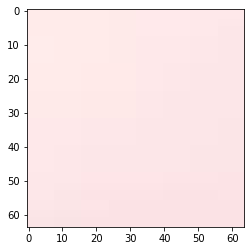

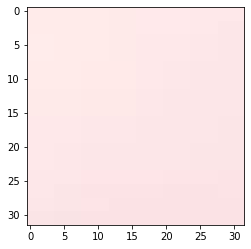

/content/Data_set_Train_x2/590/patch_589_10_19.jpg
/content/Data_set_Train_x2/590/patch_589_13_9.jpg
/content/Data_set_Train_x2/590/patch_589_12_0.jpg
/content/Data_set_Train_x2/590/patch_589_1_27.jpg
/content/Data_set_Train_x2/590/patch_589_12_22.jpg
/content/Data_set_Train_x2/590/patch_589_4_11.jpg
/content/Data_set_Train_x2/590/patch_589_9_25.jpg
/content/Data_set_Train_x2/590/patch_589_2_9.jpg
/content/Data_set_Train_x2/590/patch_589_0_6.jpg
/content/Data_set_Train_x2/590/patch_589_11_17.jpg
/content/Data_set_Train_x2/590/patch_589_5_16.jpg
/content/Data_set_Train_x2/590/patch_589_0_12.jpg
/content/Data_set_Train_x2/590/patch_589_9_17.jpg
/content/Data_set_Train_x2/590/patch_589_0_22.jpg
/content/Data_set_Train_x2/590/patch_589_7_5.jpg
/content/Data_set_Train_x2/590/patch_589_3_12.jpg
/content/Data_set_Train_x2/590/patch_588_20_13.jpg
/content/Data_set_Train_x2/590/patch_589_5_3.jpg
/content/Data_set_Train_x2/590/patch_589_0_25.jpg
/content/Data_set_Train_x2/590/patch_589_13_23.jpg

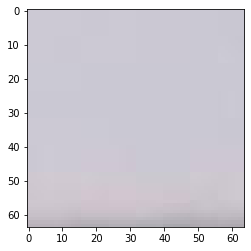

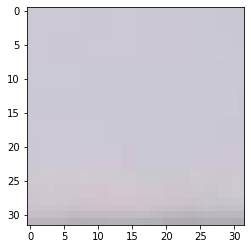

/content/Data_set_Train_x2/590/patch_589_17_26.jpg
/content/Data_set_Train_x2/590/patch_587_1_14.jpg
/content/Data_set_Train_x2/590/patch_586_14_21.jpg
/content/Data_set_Train_x2/590/patch_586_9_4.jpg
/content/Data_set_Train_x2/590/patch_586_8_24.jpg
/content/Data_set_Train_x2/590/patch_586_9_8.jpg
/content/Data_set_Train_x2/590/patch_586_17_15.jpg
/content/Data_set_Train_x2/590/patch_586_18_0.jpg
/content/Data_set_Train_x2/590/patch_586_13_8.jpg
/content/Data_set_Train_x2/590/patch_587_2_23.jpg
/content/Data_set_Train_x2/590/patch_586_18_8.jpg
/content/Data_set_Train_x2/590/patch_586_15_6.jpg
/content/Data_set_Train_x2/590/patch_587_1_23.jpg
/content/Data_set_Train_x2/590/patch_586_11_6.jpg
/content/Data_set_Train_x2/590/patch_586_19_10.jpg
/content/Data_set_Train_x2/590/patch_586_14_10.jpg
/content/Data_set_Train_x2/590/patch_586_10_3.jpg
/content/Data_set_Train_x2/590/patch_586_16_24.jpg
/content/Data_set_Train_x2/590/patch_587_1_0.jpg
/content/Data_set_Train_x2/590/patch_586_11_19.

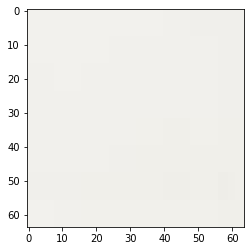

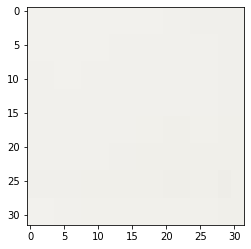

/content/Data_set_Train_x2/590/patch_587_5_8.jpg
/content/Data_set_Train_x2/590/patch_588_0_9.jpg
/content/Data_set_Train_x2/590/patch_588_1_5.jpg
/content/Data_set_Train_x2/590/patch_587_6_13.jpg
/content/Data_set_Train_x2/590/patch_587_9_29.jpg
/content/Data_set_Train_x2/590/patch_587_5_12.jpg
/content/Data_set_Train_x2/590/patch_587_6_25.jpg
/content/Data_set_Train_x2/590/patch_587_15_11.jpg
/content/Data_set_Train_x2/590/patch_587_19_6.jpg
/content/Data_set_Train_x2/590/patch_587_17_4.jpg
/content/Data_set_Train_x2/590/patch_587_6_10.jpg
/content/Data_set_Train_x2/590/patch_588_0_11.jpg
/content/Data_set_Train_x2/590/patch_587_6_22.jpg
/content/Data_set_Train_x2/590/patch_587_7_13.jpg
/content/Data_set_Train_x2/590/patch_587_11_30.jpg
/content/Data_set_Train_x2/590/patch_587_18_7.jpg
/content/Data_set_Train_x2/590/patch_587_13_23.jpg
/content/Data_set_Train_x2/590/patch_587_9_4.jpg
/content/Data_set_Train_x2/590/patch_587_9_17.jpg
/content/Data_set_Train_x2/590/patch_588_0_25.jpg
/

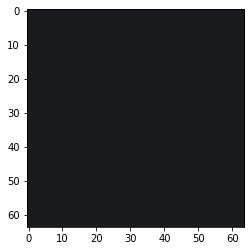

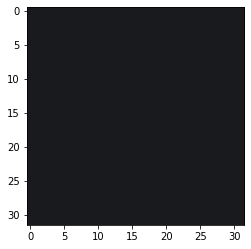

/content/Data_set_Train_x2/590/patch_588_19_4.jpg
/content/Data_set_Train_x2/590/patch_585_8_20.jpg
/content/Data_set_Train_x2/590/patch_585_5_27.jpg
/content/Data_set_Train_x2/590/patch_585_8_16.jpg
/content/Data_set_Train_x2/590/patch_585_11_24.jpg
/content/Data_set_Train_x2/590/patch_585_7_25.jpg
/content/Data_set_Train_x2/590/patch_584_21_8.jpg
/content/Data_set_Train_x2/590/patch_585_3_18.jpg
/content/Data_set_Train_x2/590/patch_585_7_28.jpg
/content/Data_set_Train_x2/590/patch_585_8_6.jpg
/content/Data_set_Train_x2/590/patch_585_3_5.jpg
/content/Data_set_Train_x2/590/patch_585_6_2.jpg
/content/Data_set_Train_x2/590/patch_585_12_15.jpg
/content/Data_set_Train_x2/590/patch_584_20_11.jpg
/content/Data_set_Train_x2/590/patch_585_8_10.jpg
/content/Data_set_Train_x2/590/patch_585_5_9.jpg
/content/Data_set_Train_x2/590/patch_585_1_23.jpg
/content/Data_set_Train_x2/590/patch_585_4_19.jpg
/content/Data_set_Train_x2/590/patch_584_20_24.jpg
/content/Data_set_Train_x2/590/patch_585_0_28.jpg


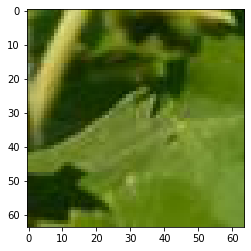

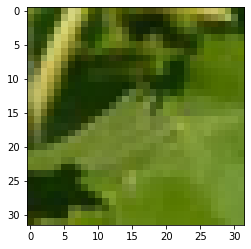

/content/Data_set_Train_x2/590/patch_585_20_11.jpg
/content/Data_set_Train_x2/590/patch_585_16_1.jpg
/content/Data_set_Train_x2/590/patch_586_4_9.jpg
/content/Data_set_Train_x2/590/patch_585_13_27.jpg
/content/Data_set_Train_x2/590/patch_585_20_19.jpg
/content/Data_set_Train_x2/590/patch_586_5_7.jpg
/content/Data_set_Train_x2/590/patch_585_16_11.jpg
/content/Data_set_Train_x2/590/patch_586_5_14.jpg
/content/Data_set_Train_x2/590/patch_586_3_1.jpg
/content/Data_set_Train_x2/590/patch_585_19_4.jpg
/content/Data_set_Train_x2/590/patch_585_15_21.jpg
/content/Data_set_Train_x2/590/patch_586_2_14.jpg
/content/Data_set_Train_x2/590/patch_585_16_29.jpg
/content/Data_set_Train_x2/590/patch_585_17_20.jpg
/content/Data_set_Train_x2/590/patch_585_15_28.jpg
/content/Data_set_Train_x2/590/patch_586_8_14.jpg
/content/Data_set_Train_x2/590/patch_586_4_16.jpg
/content/Data_set_Train_x2/590/patch_585_20_22.jpg
/content/Data_set_Train_x2/590/patch_585_16_25.jpg
/content/Data_set_Train_x2/590/patch_586_1_

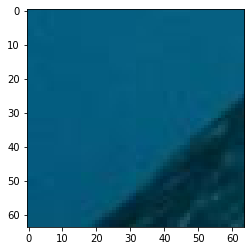

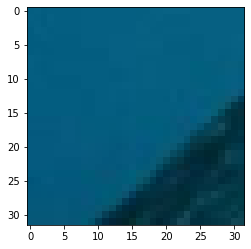

/content/Data_set_Train_x2/590/patch_586_9_13.jpg
/content/Data_set_Train_x2/590/patch_583_9_25.jpg
/content/Data_set_Train_x2/590/patch_583_19_7.jpg
/content/Data_set_Train_x2/590/patch_583_19_14.jpg
/content/Data_set_Train_x2/590/patch_583_18_5.jpg
/content/Data_set_Train_x2/590/patch_583_11_25.jpg
/content/Data_set_Train_x2/590/patch_584_1_15.jpg
/content/Data_set_Train_x2/590/patch_583_18_18.jpg
/content/Data_set_Train_x2/590/patch_584_0_1.jpg
/content/Data_set_Train_x2/590/patch_583_15_24.jpg
/content/Data_set_Train_x2/590/patch_583_19_26.jpg
/content/Data_set_Train_x2/590/patch_583_20_0.jpg
/content/Data_set_Train_x2/590/patch_583_17_16.jpg
/content/Data_set_Train_x2/590/patch_583_10_26.jpg
/content/Data_set_Train_x2/590/patch_583_20_23.jpg
/content/Data_set_Train_x2/590/patch_583_13_11.jpg
/content/Data_set_Train_x2/590/patch_583_9_1.jpg
/content/Data_set_Train_x2/590/patch_583_17_11.jpg
/content/Data_set_Train_x2/590/patch_583_13_12.jpg
/content/Data_set_Train_x2/590/patch_583_

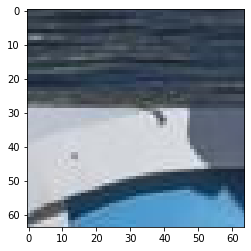

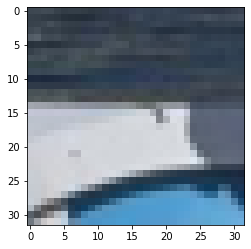

/content/Data_set_Train_x2/590/patch_584_18_6.jpg
/content/Data_set_Train_x2/590/patch_584_14_25.jpg
/content/Data_set_Train_x2/590/patch_584_17_9.jpg
/content/Data_set_Train_x2/590/patch_584_16_3.jpg
/content/Data_set_Train_x2/590/patch_584_3_27.jpg
/content/Data_set_Train_x2/590/patch_584_13_20.jpg
/content/Data_set_Train_x2/590/patch_584_19_0.jpg
/content/Data_set_Train_x2/590/patch_584_14_15.jpg
/content/Data_set_Train_x2/590/patch_584_3_26.jpg
/content/Data_set_Train_x2/590/patch_584_10_14.jpg
/content/Data_set_Train_x2/590/patch_584_2_8.jpg
/content/Data_set_Train_x2/590/patch_584_15_3.jpg
/content/Data_set_Train_x2/590/patch_584_7_24.jpg
/content/Data_set_Train_x2/590/patch_584_17_3.jpg
/content/Data_set_Train_x2/590/patch_584_7_7.jpg
/content/Data_set_Train_x2/590/patch_584_17_10.jpg
/content/Data_set_Train_x2/590/patch_584_4_25.jpg
/content/Data_set_Train_x2/590/patch_584_16_4.jpg
/content/Data_set_Train_x2/590/patch_584_9_18.jpg
/content/Data_set_Train_x2/590/patch_584_3_15.j

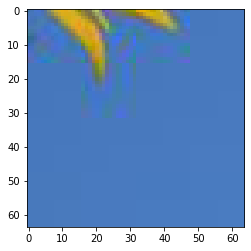

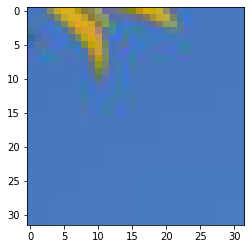

/content/Data_set_Train_x2/590/patch_585_3_9.jpg
/content/Data_set_Train_x2/590/patch_582_8_7.jpg
/content/Data_set_Train_x2/590/patch_582_7_20.jpg
/content/Data_set_Train_x2/590/patch_581_15_15.jpg
/content/Data_set_Train_x2/590/patch_582_5_0.jpg
/content/Data_set_Train_x2/590/patch_582_4_22.jpg
/content/Data_set_Train_x2/590/patch_581_17_1.jpg
/content/Data_set_Train_x2/590/patch_581_16_0.jpg
/content/Data_set_Train_x2/590/patch_581_15_6.jpg
/content/Data_set_Train_x2/590/patch_582_4_27.jpg
/content/Data_set_Train_x2/590/patch_582_8_14.jpg
/content/Data_set_Train_x2/590/patch_581_17_24.jpg
/content/Data_set_Train_x2/590/patch_582_9_24.jpg
/content/Data_set_Train_x2/590/patch_582_4_8.jpg
/content/Data_set_Train_x2/590/patch_582_11_13.jpg
/content/Data_set_Train_x2/590/patch_581_16_13.jpg
/content/Data_set_Train_x2/590/patch_581_16_15.jpg
/content/Data_set_Train_x2/590/patch_581_15_16.jpg
/content/Data_set_Train_x2/590/patch_582_6_16.jpg
/content/Data_set_Train_x2/590/patch_581_16_4.jp

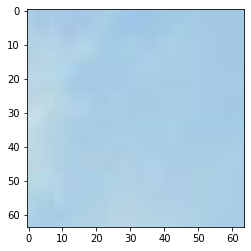

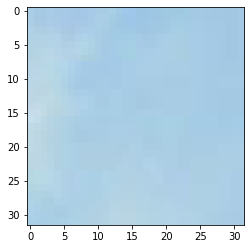

/content/Data_set_Train_x2/590/patch_583_1_18.jpg
/content/Data_set_Train_x2/590/patch_582_12_27.jpg
/content/Data_set_Train_x2/590/patch_583_6_26.jpg
/content/Data_set_Train_x2/590/patch_582_20_18.jpg
/content/Data_set_Train_x2/590/patch_582_15_0.jpg
/content/Data_set_Train_x2/590/patch_582_13_9.jpg
/content/Data_set_Train_x2/590/patch_583_2_21.jpg
/content/Data_set_Train_x2/590/patch_582_20_21.jpg
/content/Data_set_Train_x2/590/patch_582_18_8.jpg
/content/Data_set_Train_x2/590/patch_582_18_27.jpg
/content/Data_set_Train_x2/590/patch_583_2_19.jpg
/content/Data_set_Train_x2/590/patch_583_3_17.jpg
/content/Data_set_Train_x2/590/patch_583_5_29.jpg
/content/Data_set_Train_x2/590/patch_582_17_12.jpg
/content/Data_set_Train_x2/590/patch_582_15_20.jpg
/content/Data_set_Train_x2/590/patch_583_2_0.jpg
/content/Data_set_Train_x2/590/patch_582_19_4.jpg
/content/Data_set_Train_x2/590/patch_583_2_24.jpg
/content/Data_set_Train_x2/590/patch_583_4_22.jpg
/content/Data_set_Train_x2/590/patch_582_20_2

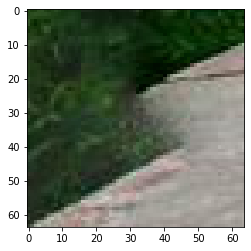

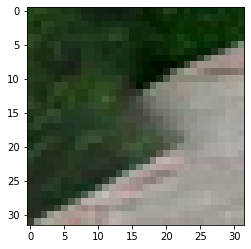

/content/Data_set_Train_x2/590/patch_583_20_12.jpg
/content/Data_set_Train_x2/590/patch_580_18_21.jpg
/content/Data_set_Train_x2/590/patch_580_11_15.jpg
/content/Data_set_Train_x2/590/patch_580_21_15.jpg
/content/Data_set_Train_x2/590/patch_580_8_20.jpg
/content/Data_set_Train_x2/590/patch_580_9_13.jpg
/content/Data_set_Train_x2/590/patch_580_15_29.jpg
/content/Data_set_Train_x2/590/patch_580_20_1.jpg
/content/Data_set_Train_x2/590/patch_580_16_29.jpg
/content/Data_set_Train_x2/590/patch_580_12_22.jpg
/content/Data_set_Train_x2/590/patch_580_10_25.jpg
/content/Data_set_Train_x2/590/patch_580_5_24.jpg
/content/Data_set_Train_x2/590/patch_580_6_24.jpg
/content/Data_set_Train_x2/590/patch_580_9_1.jpg
/content/Data_set_Train_x2/590/patch_580_9_27.jpg
/content/Data_set_Train_x2/590/patch_580_8_23.jpg
/content/Data_set_Train_x2/590/patch_580_18_28.jpg
/content/Data_set_Train_x2/590/patch_580_12_19.jpg
/content/Data_set_Train_x2/590/patch_580_18_5.jpg
/content/Data_set_Train_x2/590/patch_580_

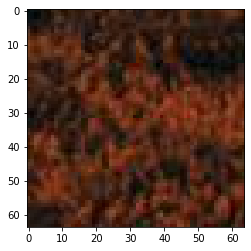

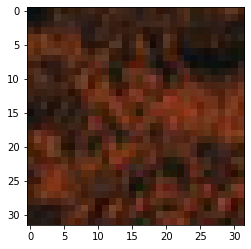

/content/Data_set_Train_x2/590/patch_580_22_8.jpg
/content/Data_set_Train_x2/590/patch_581_0_15.jpg
/content/Data_set_Train_x2/590/patch_581_13_3.jpg
/content/Data_set_Train_x2/590/patch_581_13_10.jpg
/content/Data_set_Train_x2/590/patch_581_9_3.jpg
/content/Data_set_Train_x2/590/patch_580_22_29.jpg
/content/Data_set_Train_x2/590/patch_581_8_7.jpg
/content/Data_set_Train_x2/590/patch_581_9_14.jpg
/content/Data_set_Train_x2/590/patch_581_5_27.jpg
/content/Data_set_Train_x2/590/patch_581_12_13.jpg
/content/Data_set_Train_x2/590/patch_581_1_22.jpg
/content/Data_set_Train_x2/590/patch_580_22_16.jpg
/content/Data_set_Train_x2/590/patch_581_1_20.jpg
/content/Data_set_Train_x2/590/patch_581_1_14.jpg
/content/Data_set_Train_x2/590/patch_581_2_2.jpg
/content/Data_set_Train_x2/590/patch_581_2_17.jpg
/content/Data_set_Train_x2/590/patch_581_5_19.jpg
/content/Data_set_Train_x2/590/patch_581_3_8.jpg
/content/Data_set_Train_x2/590/patch_581_8_13.jpg
/content/Data_set_Train_x2/590/patch_581_4_10.jpg


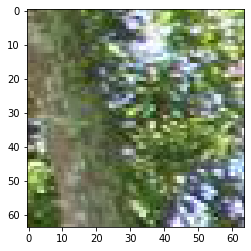

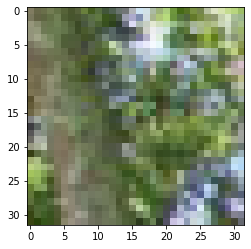

/content/Data_set_Train_x2/590/patch_582_7_0.jpg
/content/Data_set_Train_x2/590/patch_580_5_4.jpg
/content/Data_set_Train_x2/590/patch_580_3_27.jpg
/content/Data_set_Train_x2/590/patch_580_1_10.jpg
/content/Data_set_Train_x2/590/patch_580_1_5.jpg
/content/Data_set_Train_x2/590/patch_580_3_18.jpg
/content/Data_set_Train_x2/590/patch_580_4_8.jpg
/content/Data_set_Train_x2/590/patch_580_0_11.jpg
/content/Data_set_Train_x2/590/patch_580_2_19.jpg
/content/Data_set_Train_x2/590/patch_580_2_3.jpg
/content/Data_set_Train_x2/590/patch_580_0_10.jpg
/content/Data_set_Train_x2/590/patch_580_4_21.jpg
/content/Data_set_Train_x2/590/patch_580_3_8.jpg
/content/Data_set_Train_x2/590/patch_580_0_7.jpg
/content/Data_set_Train_x2/590/patch_580_3_11.jpg
/content/Data_set_Train_x2/590/patch_580_0_4.jpg
/content/Data_set_Train_x2/590/patch_580_4_29.jpg
/content/Data_set_Train_x2/590/patch_580_5_5.jpg
/content/Data_set_Train_x2/590/patch_580_1_26.jpg
/content/Data_set_Train_x2/590/patch_580_1_28.jpg
/content/

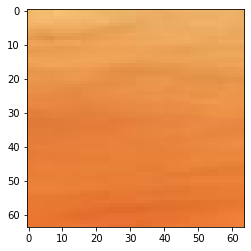

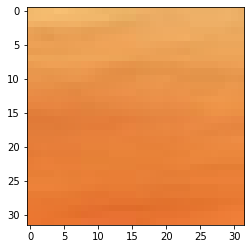

/content/Data_set_Train_x2/590/patch_580_9_23.jpg
/content/Data_set_Train_x2/590/patch_580_19_17.jpg
/content/Data_set_Train_x2/590/patch_580_8_24.jpg
/content/Data_set_Train_x2/590/patch_580_12_14.jpg
/content/Data_set_Train_x2/590/patch_580_19_11.jpg
/content/Data_set_Train_x2/590/patch_580_19_5.jpg
/content/Data_set_Train_x2/590/patch_580_21_3.jpg
/content/Data_set_Train_x2/590/patch_580_16_9.jpg
/content/Data_set_Train_x2/590/patch_580_12_29.jpg
/content/Data_set_Train_x2/590/patch_580_15_2.jpg
/content/Data_set_Train_x2/590/patch_580_15_20.jpg
/content/Data_set_Train_x2/590/patch_580_21_21.jpg
/content/Data_set_Train_x2/590/patch_580_11_20.jpg
/content/Data_set_Train_x2/590/patch_580_20_3.jpg
/content/Data_set_Train_x2/590/patch_580_12_30.jpg
/content/Data_set_Train_x2/590/patch_580_14_28.jpg
/content/Data_set_Train_x2/590/patch_580_12_24.jpg
/content/Data_set_Train_x2/590/patch_580_18_18.jpg
/content/Data_set_Train_x2/590/patch_580_10_18.jpg
/content/Data_set_Train_x2/590/patch_5

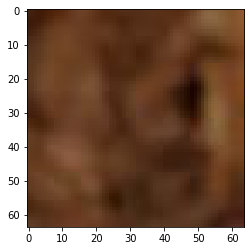

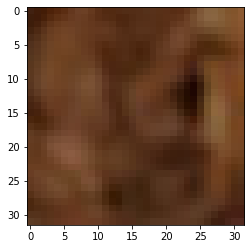

/content/Data_set_Train_x2/600/patch_599_10_9.jpg
/content/Data_set_Train_x2/600/patch_599_9_21.jpg
/content/Data_set_Train_x2/600/patch_599_18_27.jpg
/content/Data_set_Train_x2/600/patch_599_8_19.jpg
/content/Data_set_Train_x2/600/patch_599_18_18.jpg
/content/Data_set_Train_x2/600/patch_599_16_5.jpg
/content/Data_set_Train_x2/600/patch_599_14_14.jpg
/content/Data_set_Train_x2/600/patch_599_13_25.jpg
/content/Data_set_Train_x2/600/patch_599_17_15.jpg
/content/Data_set_Train_x2/600/patch_599_8_1.jpg
/content/Data_set_Train_x2/600/patch_599_5_21.jpg
/content/Data_set_Train_x2/600/patch_599_6_27.jpg
/content/Data_set_Train_x2/600/patch_599_19_20.jpg
/content/Data_set_Train_x2/600/patch_599_11_1.jpg
/content/Data_set_Train_x2/600/patch_599_14_16.jpg
/content/Data_set_Train_x2/600/patch_599_5_27.jpg
/content/Data_set_Train_x2/600/patch_599_18_21.jpg
/content/Data_set_Train_x2/600/patch_599_9_28.jpg
/content/Data_set_Train_x2/600/patch_599_9_22.jpg
/content/Data_set_Train_x2/600/patch_599_11

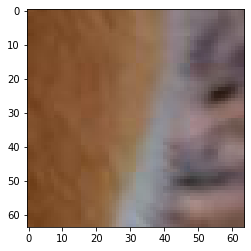

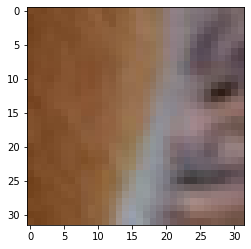

/content/Data_set_Train_x2/600/patch_599_18_24.jpg
/content/Data_set_Train_x2/600/patch_597_3_17.jpg
/content/Data_set_Train_x2/600/patch_597_7_15.jpg
/content/Data_set_Train_x2/600/patch_597_9_20.jpg
/content/Data_set_Train_x2/600/patch_597_1_12.jpg
/content/Data_set_Train_x2/600/patch_596_16_27.jpg
/content/Data_set_Train_x2/600/patch_596_20_8.jpg
/content/Data_set_Train_x2/600/patch_596_19_16.jpg
/content/Data_set_Train_x2/600/patch_597_0_26.jpg
/content/Data_set_Train_x2/600/patch_596_17_19.jpg
/content/Data_set_Train_x2/600/patch_596_20_2.jpg
/content/Data_set_Train_x2/600/patch_596_18_5.jpg
/content/Data_set_Train_x2/600/patch_597_5_22.jpg
/content/Data_set_Train_x2/600/patch_597_3_9.jpg
/content/Data_set_Train_x2/600/patch_596_19_5.jpg
/content/Data_set_Train_x2/600/patch_597_0_8.jpg
/content/Data_set_Train_x2/600/patch_596_16_11.jpg
/content/Data_set_Train_x2/600/patch_597_2_22.jpg
/content/Data_set_Train_x2/600/patch_596_19_17.jpg
/content/Data_set_Train_x2/600/patch_597_10_4.

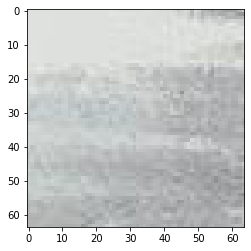

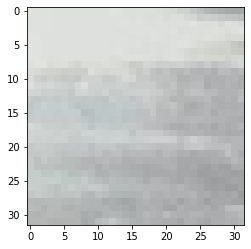

/content/Data_set_Train_x2/600/patch_597_14_29.jpg
/content/Data_set_Train_x2/600/patch_597_11_15.jpg
/content/Data_set_Train_x2/600/patch_598_1_9.jpg
/content/Data_set_Train_x2/600/patch_598_5_22.jpg
/content/Data_set_Train_x2/600/patch_597_16_21.jpg
/content/Data_set_Train_x2/600/patch_598_3_23.jpg
/content/Data_set_Train_x2/600/patch_598_3_17.jpg
/content/Data_set_Train_x2/600/patch_598_1_17.jpg
/content/Data_set_Train_x2/600/patch_597_15_18.jpg
/content/Data_set_Train_x2/600/patch_597_19_26.jpg
/content/Data_set_Train_x2/600/patch_598_0_25.jpg
/content/Data_set_Train_x2/600/patch_597_16_6.jpg
/content/Data_set_Train_x2/600/patch_598_6_5.jpg
/content/Data_set_Train_x2/600/patch_598_2_25.jpg
/content/Data_set_Train_x2/600/patch_598_5_17.jpg
/content/Data_set_Train_x2/600/patch_598_2_10.jpg
/content/Data_set_Train_x2/600/patch_598_4_18.jpg
/content/Data_set_Train_x2/600/patch_598_1_21.jpg
/content/Data_set_Train_x2/600/patch_598_4_6.jpg
/content/Data_set_Train_x2/600/patch_598_3_21.jp

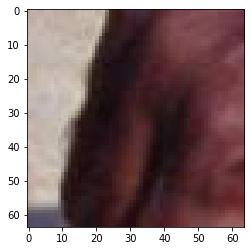

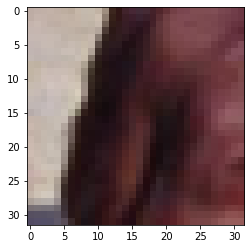

/content/Data_set_Train_x2/600/patch_598_11_7.jpg
/content/Data_set_Train_x2/600/patch_595_8_28.jpg
/content/Data_set_Train_x2/600/patch_595_9_3.jpg
/content/Data_set_Train_x2/600/patch_595_5_20.jpg
/content/Data_set_Train_x2/600/patch_595_10_7.jpg
/content/Data_set_Train_x2/600/patch_595_19_4.jpg
/content/Data_set_Train_x2/600/patch_595_9_23.jpg
/content/Data_set_Train_x2/600/patch_595_14_14.jpg
/content/Data_set_Train_x2/600/patch_595_14_5.jpg
/content/Data_set_Train_x2/600/patch_595_5_26.jpg
/content/Data_set_Train_x2/600/patch_595_15_24.jpg
/content/Data_set_Train_x2/600/patch_595_19_21.jpg
/content/Data_set_Train_x2/600/patch_595_7_29.jpg
/content/Data_set_Train_x2/600/patch_595_7_19.jpg
/content/Data_set_Train_x2/600/patch_595_7_7.jpg
/content/Data_set_Train_x2/600/patch_595_11_26.jpg
/content/Data_set_Train_x2/600/patch_595_15_11.jpg
/content/Data_set_Train_x2/600/patch_595_19_5.jpg
/content/Data_set_Train_x2/600/patch_595_16_22.jpg
/content/Data_set_Train_x2/600/patch_595_4_25.

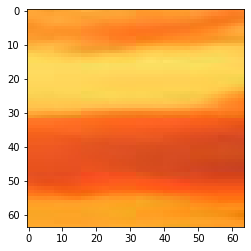

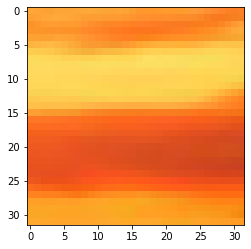

/content/Data_set_Train_x2/600/patch_596_7_14.jpg
/content/Data_set_Train_x2/600/patch_596_4_10.jpg
/content/Data_set_Train_x2/600/patch_596_16_3.jpg
/content/Data_set_Train_x2/600/patch_596_10_27.jpg
/content/Data_set_Train_x2/600/patch_596_15_12.jpg
/content/Data_set_Train_x2/600/patch_596_1_20.jpg
/content/Data_set_Train_x2/600/patch_596_12_12.jpg
/content/Data_set_Train_x2/600/patch_596_8_15.jpg
/content/Data_set_Train_x2/600/patch_596_10_10.jpg
/content/Data_set_Train_x2/600/patch_596_12_10.jpg
/content/Data_set_Train_x2/600/patch_596_6_21.jpg
/content/Data_set_Train_x2/600/patch_596_14_6.jpg
/content/Data_set_Train_x2/600/patch_596_8_9.jpg
/content/Data_set_Train_x2/600/patch_596_6_1.jpg
/content/Data_set_Train_x2/600/patch_596_8_4.jpg
/content/Data_set_Train_x2/600/patch_596_10_14.jpg
/content/Data_set_Train_x2/600/patch_596_5_17.jpg
/content/Data_set_Train_x2/600/patch_596_7_30.jpg
/content/Data_set_Train_x2/600/patch_596_4_5.jpg
/content/Data_set_Train_x2/600/patch_596_14_24.j

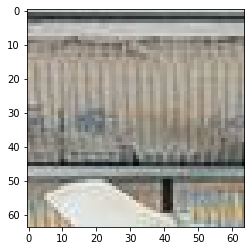

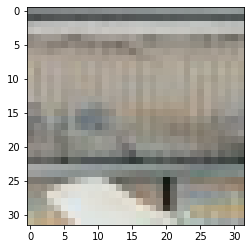

/content/Data_set_Train_x2/600/patch_597_6_15.jpg
/content/Data_set_Train_x2/600/patch_594_1_3.jpg
/content/Data_set_Train_x2/600/patch_593_11_30.jpg
/content/Data_set_Train_x2/600/patch_594_5_8.jpg
/content/Data_set_Train_x2/600/patch_594_5_15.jpg
/content/Data_set_Train_x2/600/patch_594_4_4.jpg
/content/Data_set_Train_x2/600/patch_594_2_9.jpg
/content/Data_set_Train_x2/600/patch_593_13_3.jpg
/content/Data_set_Train_x2/600/patch_594_4_8.jpg
/content/Data_set_Train_x2/600/patch_593_16_26.jpg
/content/Data_set_Train_x2/600/patch_593_16_5.jpg
/content/Data_set_Train_x2/600/patch_593_12_18.jpg
/content/Data_set_Train_x2/600/patch_594_2_11.jpg
/content/Data_set_Train_x2/600/patch_593_11_4.jpg
/content/Data_set_Train_x2/600/patch_593_16_7.jpg
/content/Data_set_Train_x2/600/patch_594_3_8.jpg
/content/Data_set_Train_x2/600/patch_594_1_14.jpg
/content/Data_set_Train_x2/600/patch_594_3_0.jpg
/content/Data_set_Train_x2/600/patch_593_17_21.jpg
/content/Data_set_Train_x2/600/patch_593_11_27.jpg
/c

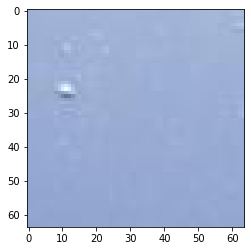

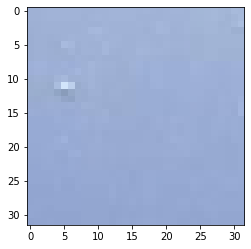

/content/Data_set_Train_x2/600/patch_595_2_9.jpg
/content/Data_set_Train_x2/600/patch_594_9_4.jpg
/content/Data_set_Train_x2/600/patch_594_17_4.jpg
/content/Data_set_Train_x2/600/patch_594_14_12.jpg
/content/Data_set_Train_x2/600/patch_594_17_13.jpg
/content/Data_set_Train_x2/600/patch_594_9_25.jpg
/content/Data_set_Train_x2/600/patch_595_3_22.jpg
/content/Data_set_Train_x2/600/patch_594_17_28.jpg
/content/Data_set_Train_x2/600/patch_594_13_4.jpg
/content/Data_set_Train_x2/600/patch_595_3_27.jpg
/content/Data_set_Train_x2/600/patch_594_17_2.jpg
/content/Data_set_Train_x2/600/patch_595_0_25.jpg
/content/Data_set_Train_x2/600/patch_594_14_8.jpg
/content/Data_set_Train_x2/600/patch_594_11_12.jpg
/content/Data_set_Train_x2/600/patch_595_1_30.jpg
/content/Data_set_Train_x2/600/patch_594_8_16.jpg
/content/Data_set_Train_x2/600/patch_594_12_18.jpg
/content/Data_set_Train_x2/600/patch_595_1_17.jpg
/content/Data_set_Train_x2/600/patch_595_1_24.jpg
/content/Data_set_Train_x2/600/patch_594_10_17.

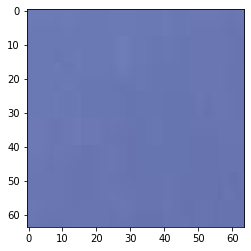

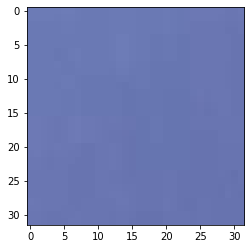

/content/Data_set_Train_x2/600/patch_595_6_28.jpg
/content/Data_set_Train_x2/600/patch_592_6_28.jpg
/content/Data_set_Train_x2/600/patch_592_9_22.jpg
/content/Data_set_Train_x2/600/patch_592_9_20.jpg
/content/Data_set_Train_x2/600/patch_592_7_22.jpg
/content/Data_set_Train_x2/600/patch_592_10_16.jpg
/content/Data_set_Train_x2/600/patch_592_8_11.jpg
/content/Data_set_Train_x2/600/patch_592_10_20.jpg
/content/Data_set_Train_x2/600/patch_592_3_13.jpg
/content/Data_set_Train_x2/600/patch_592_5_24.jpg
/content/Data_set_Train_x2/600/patch_592_0_17.jpg
/content/Data_set_Train_x2/600/patch_592_1_30.jpg
/content/Data_set_Train_x2/600/patch_592_11_10.jpg
/content/Data_set_Train_x2/600/patch_592_5_28.jpg
/content/Data_set_Train_x2/600/patch_592_13_6.jpg
/content/Data_set_Train_x2/600/patch_592_4_27.jpg
/content/Data_set_Train_x2/600/patch_591_21_14.jpg
/content/Data_set_Train_x2/600/patch_592_10_8.jpg
/content/Data_set_Train_x2/600/patch_592_2_1.jpg
/content/Data_set_Train_x2/600/patch_592_12_14.

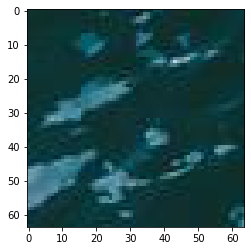

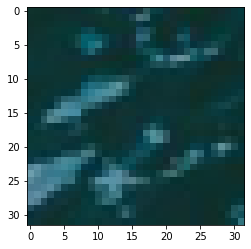

/content/Data_set_Train_x2/600/patch_592_19_3.jpg
/content/Data_set_Train_x2/600/patch_593_0_9.jpg
/content/Data_set_Train_x2/600/patch_593_6_15.jpg
/content/Data_set_Train_x2/600/patch_593_3_19.jpg
/content/Data_set_Train_x2/600/patch_592_16_30.jpg
/content/Data_set_Train_x2/600/patch_592_17_26.jpg
/content/Data_set_Train_x2/600/patch_593_5_14.jpg
/content/Data_set_Train_x2/600/patch_593_5_29.jpg
/content/Data_set_Train_x2/600/patch_593_8_28.jpg
/content/Data_set_Train_x2/600/patch_593_1_28.jpg
/content/Data_set_Train_x2/600/patch_593_9_12.jpg
/content/Data_set_Train_x2/600/patch_592_18_3.jpg
/content/Data_set_Train_x2/600/patch_593_0_22.jpg
/content/Data_set_Train_x2/600/patch_592_16_4.jpg
/content/Data_set_Train_x2/600/patch_593_8_24.jpg
/content/Data_set_Train_x2/600/patch_593_3_28.jpg
/content/Data_set_Train_x2/600/patch_593_10_2.jpg
/content/Data_set_Train_x2/600/patch_592_20_13.jpg
/content/Data_set_Train_x2/600/patch_592_20_18.jpg
/content/Data_set_Train_x2/600/patch_592_17_18.

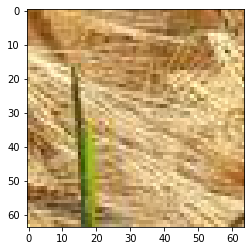

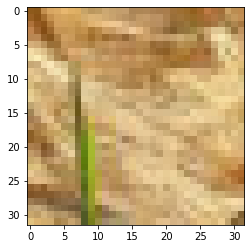

/content/Data_set_Train_x2/600/patch_593_13_18.jpg
/content/Data_set_Train_x2/600/patch_590_14_10.jpg
/content/Data_set_Train_x2/600/patch_590_15_10.jpg
/content/Data_set_Train_x2/600/patch_590_30_3.jpg
/content/Data_set_Train_x2/600/patch_591_3_25.jpg
/content/Data_set_Train_x2/600/patch_591_0_0.jpg
/content/Data_set_Train_x2/600/patch_591_3_6.jpg
/content/Data_set_Train_x2/600/patch_591_1_12.jpg
/content/Data_set_Train_x2/600/patch_590_25_20.jpg
/content/Data_set_Train_x2/600/patch_590_17_16.jpg
/content/Data_set_Train_x2/600/patch_591_3_29.jpg
/content/Data_set_Train_x2/600/patch_590_20_19.jpg
/content/Data_set_Train_x2/600/patch_590_17_0.jpg
/content/Data_set_Train_x2/600/patch_591_3_18.jpg
/content/Data_set_Train_x2/600/patch_590_20_8.jpg
/content/Data_set_Train_x2/600/patch_590_28_16.jpg
/content/Data_set_Train_x2/600/patch_590_14_17.jpg
/content/Data_set_Train_x2/600/patch_590_15_5.jpg
/content/Data_set_Train_x2/600/patch_590_29_16.jpg
/content/Data_set_Train_x2/600/patch_590_14

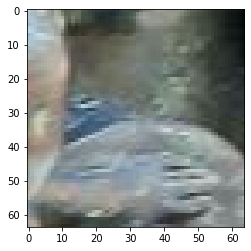

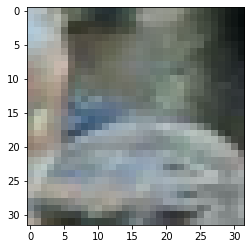

/content/Data_set_Train_x2/600/patch_591_10_27.jpg
/content/Data_set_Train_x2/600/patch_591_15_26.jpg
/content/Data_set_Train_x2/600/patch_591_18_9.jpg
/content/Data_set_Train_x2/600/patch_591_16_7.jpg
/content/Data_set_Train_x2/600/patch_591_10_28.jpg
/content/Data_set_Train_x2/600/patch_591_17_26.jpg
/content/Data_set_Train_x2/600/patch_591_5_29.jpg
/content/Data_set_Train_x2/600/patch_591_10_26.jpg
/content/Data_set_Train_x2/600/patch_591_5_6.jpg
/content/Data_set_Train_x2/600/patch_591_8_5.jpg
/content/Data_set_Train_x2/600/patch_591_14_21.jpg
/content/Data_set_Train_x2/600/patch_591_17_9.jpg
/content/Data_set_Train_x2/600/patch_591_9_28.jpg
/content/Data_set_Train_x2/600/patch_591_13_24.jpg
/content/Data_set_Train_x2/600/patch_591_9_11.jpg
/content/Data_set_Train_x2/600/patch_591_20_2.jpg
/content/Data_set_Train_x2/600/patch_591_8_17.jpg
/content/Data_set_Train_x2/600/patch_591_7_24.jpg
/content/Data_set_Train_x2/600/patch_591_15_20.jpg
/content/Data_set_Train_x2/600/patch_591_6_0

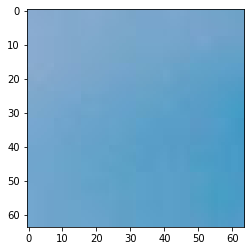

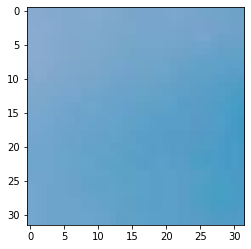

/content/Data_set_Train_x2/600/patch_592_2_29.jpg
/content/Data_set_Train_x2/600/patch_590_13_1.jpg
/content/Data_set_Train_x2/600/patch_590_7_8.jpg
/content/Data_set_Train_x2/600/patch_590_3_2.jpg
/content/Data_set_Train_x2/600/patch_590_2_14.jpg
/content/Data_set_Train_x2/600/patch_590_2_13.jpg
/content/Data_set_Train_x2/600/patch_590_9_12.jpg
/content/Data_set_Train_x2/600/patch_590_6_6.jpg
/content/Data_set_Train_x2/600/patch_590_10_16.jpg
/content/Data_set_Train_x2/600/patch_590_8_10.jpg
/content/Data_set_Train_x2/600/patch_590_7_19.jpg
/content/Data_set_Train_x2/600/patch_590_10_10.jpg
/content/Data_set_Train_x2/600/patch_590_1_20.jpg
/content/Data_set_Train_x2/600/patch_590_0_5.jpg
/content/Data_set_Train_x2/600/patch_590_7_13.jpg
/content/Data_set_Train_x2/600/patch_590_2_11.jpg
/content/Data_set_Train_x2/600/patch_590_9_5.jpg
/content/Data_set_Train_x2/600/patch_590_12_9.jpg
/content/Data_set_Train_x2/600/patch_590_7_17.jpg
/content/Data_set_Train_x2/600/patch_590_12_17.jpg
/c

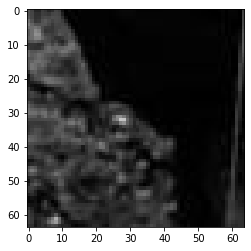

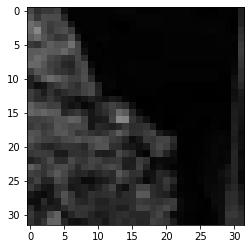

/content/Data_set_Train_x2/610/patch_608_19_10.jpg
/content/Data_set_Train_x2/610/patch_609_9_2.jpg
/content/Data_set_Train_x2/610/patch_609_3_21.jpg
/content/Data_set_Train_x2/610/patch_609_8_1.jpg
/content/Data_set_Train_x2/610/patch_609_6_1.jpg
/content/Data_set_Train_x2/610/patch_609_14_24.jpg
/content/Data_set_Train_x2/610/patch_609_1_8.jpg
/content/Data_set_Train_x2/610/patch_608_19_4.jpg
/content/Data_set_Train_x2/610/patch_609_9_21.jpg
/content/Data_set_Train_x2/610/patch_609_2_0.jpg
/content/Data_set_Train_x2/610/patch_609_11_25.jpg
/content/Data_set_Train_x2/610/patch_609_8_4.jpg
/content/Data_set_Train_x2/610/patch_608_19_13.jpg
/content/Data_set_Train_x2/610/patch_609_1_19.jpg
/content/Data_set_Train_x2/610/patch_609_2_15.jpg
/content/Data_set_Train_x2/610/patch_609_11_12.jpg
/content/Data_set_Train_x2/610/patch_609_11_9.jpg
/content/Data_set_Train_x2/610/patch_608_19_26.jpg
/content/Data_set_Train_x2/610/patch_609_4_26.jpg
/content/Data_set_Train_x2/610/patch_608_19_23.jpg

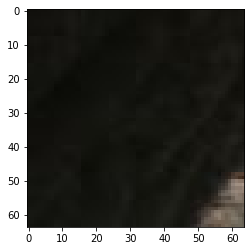

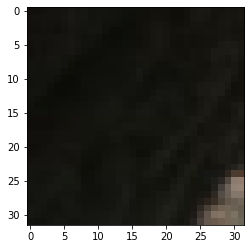

/content/Data_set_Train_x2/610/patch_609_16_19.jpg
/content/Data_set_Train_x2/610/patch_607_7_18.jpg
/content/Data_set_Train_x2/610/patch_607_1_14.jpg
/content/Data_set_Train_x2/610/patch_607_13_14.jpg
/content/Data_set_Train_x2/610/patch_607_14_12.jpg
/content/Data_set_Train_x2/610/patch_607_3_30.jpg
/content/Data_set_Train_x2/610/patch_607_6_18.jpg
/content/Data_set_Train_x2/610/patch_607_3_7.jpg
/content/Data_set_Train_x2/610/patch_607_12_3.jpg
/content/Data_set_Train_x2/610/patch_607_16_19.jpg
/content/Data_set_Train_x2/610/patch_607_9_16.jpg
/content/Data_set_Train_x2/610/patch_607_1_12.jpg
/content/Data_set_Train_x2/610/patch_607_7_11.jpg
/content/Data_set_Train_x2/610/patch_607_11_10.jpg
/content/Data_set_Train_x2/610/patch_607_13_10.jpg
/content/Data_set_Train_x2/610/patch_607_8_25.jpg
/content/Data_set_Train_x2/610/patch_607_9_3.jpg
/content/Data_set_Train_x2/610/patch_607_4_21.jpg
/content/Data_set_Train_x2/610/patch_607_0_30.jpg
/content/Data_set_Train_x2/610/patch_607_12_2.

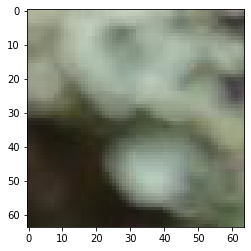

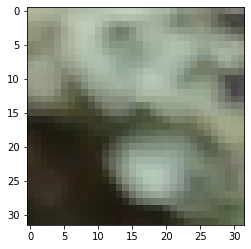

/content/Data_set_Train_x2/610/patch_607_17_12.jpg
/content/Data_set_Train_x2/610/patch_607_17_25.jpg
/content/Data_set_Train_x2/610/patch_607_23_26.jpg
/content/Data_set_Train_x2/610/patch_607_29_1.jpg
/content/Data_set_Train_x2/610/patch_608_0_1.jpg
/content/Data_set_Train_x2/610/patch_608_2_30.jpg
/content/Data_set_Train_x2/610/patch_607_24_9.jpg
/content/Data_set_Train_x2/610/patch_607_19_15.jpg
/content/Data_set_Train_x2/610/patch_607_21_0.jpg
/content/Data_set_Train_x2/610/patch_607_27_19.jpg
/content/Data_set_Train_x2/610/patch_607_30_29.jpg
/content/Data_set_Train_x2/610/patch_607_24_29.jpg
/content/Data_set_Train_x2/610/patch_607_29_28.jpg
/content/Data_set_Train_x2/610/patch_607_25_28.jpg
/content/Data_set_Train_x2/610/patch_607_29_8.jpg
/content/Data_set_Train_x2/610/patch_607_21_14.jpg
/content/Data_set_Train_x2/610/patch_608_1_13.jpg
/content/Data_set_Train_x2/610/patch_607_26_13.jpg
/content/Data_set_Train_x2/610/patch_607_18_11.jpg
/content/Data_set_Train_x2/610/patch_60

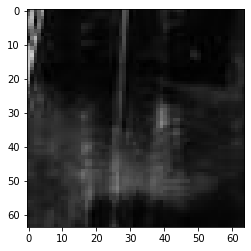

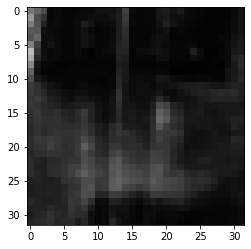

/content/Data_set_Train_x2/610/patch_608_7_0.jpg
/content/Data_set_Train_x2/610/patch_605_13_14.jpg
/content/Data_set_Train_x2/610/patch_605_10_3.jpg
/content/Data_set_Train_x2/610/patch_605_11_14.jpg
/content/Data_set_Train_x2/610/patch_605_15_22.jpg
/content/Data_set_Train_x2/610/patch_605_17_19.jpg
/content/Data_set_Train_x2/610/patch_605_10_26.jpg
/content/Data_set_Train_x2/610/patch_605_14_16.jpg
/content/Data_set_Train_x2/610/patch_606_3_2.jpg
/content/Data_set_Train_x2/610/patch_606_0_9.jpg
/content/Data_set_Train_x2/610/patch_606_4_10.jpg
/content/Data_set_Train_x2/610/patch_605_10_13.jpg
/content/Data_set_Train_x2/610/patch_605_10_29.jpg
/content/Data_set_Train_x2/610/patch_606_4_23.jpg
/content/Data_set_Train_x2/610/patch_605_20_2.jpg
/content/Data_set_Train_x2/610/patch_606_3_23.jpg
/content/Data_set_Train_x2/610/patch_606_3_1.jpg
/content/Data_set_Train_x2/610/patch_606_3_22.jpg
/content/Data_set_Train_x2/610/patch_606_1_28.jpg
/content/Data_set_Train_x2/610/patch_605_20_29

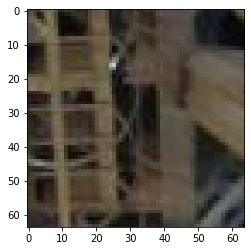

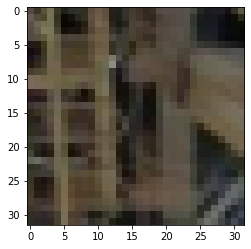

/content/Data_set_Train_x2/610/patch_606_11_12.jpg
/content/Data_set_Train_x2/610/patch_606_14_18.jpg
/content/Data_set_Train_x2/610/patch_606_20_30.jpg
/content/Data_set_Train_x2/610/patch_606_9_15.jpg
/content/Data_set_Train_x2/610/patch_606_13_1.jpg
/content/Data_set_Train_x2/610/patch_606_13_13.jpg
/content/Data_set_Train_x2/610/patch_606_13_8.jpg
/content/Data_set_Train_x2/610/patch_606_16_28.jpg
/content/Data_set_Train_x2/610/patch_606_13_18.jpg
/content/Data_set_Train_x2/610/patch_606_9_10.jpg
/content/Data_set_Train_x2/610/patch_606_16_25.jpg
/content/Data_set_Train_x2/610/patch_606_13_20.jpg
/content/Data_set_Train_x2/610/patch_606_14_26.jpg
/content/Data_set_Train_x2/610/patch_606_12_12.jpg
/content/Data_set_Train_x2/610/patch_606_19_12.jpg
/content/Data_set_Train_x2/610/patch_606_17_8.jpg
/content/Data_set_Train_x2/610/patch_606_14_17.jpg
/content/Data_set_Train_x2/610/patch_606_13_27.jpg
/content/Data_set_Train_x2/610/patch_606_17_16.jpg
/content/Data_set_Train_x2/610/patch

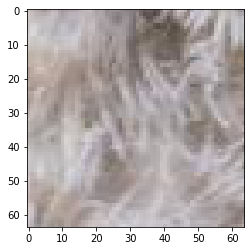

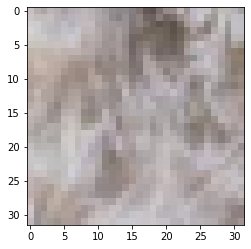

/content/Data_set_Train_x2/610/patch_607_14_16.jpg
/content/Data_set_Train_x2/610/patch_604_2_15.jpg
/content/Data_set_Train_x2/610/patch_604_9_4.jpg
/content/Data_set_Train_x2/610/patch_604_7_19.jpg
/content/Data_set_Train_x2/610/patch_603_21_20.jpg
/content/Data_set_Train_x2/610/patch_603_20_21.jpg
/content/Data_set_Train_x2/610/patch_603_21_24.jpg
/content/Data_set_Train_x2/610/patch_603_19_19.jpg
/content/Data_set_Train_x2/610/patch_604_4_26.jpg
/content/Data_set_Train_x2/610/patch_604_9_11.jpg
/content/Data_set_Train_x2/610/patch_603_19_0.jpg
/content/Data_set_Train_x2/610/patch_603_21_13.jpg
/content/Data_set_Train_x2/610/patch_604_10_23.jpg
/content/Data_set_Train_x2/610/patch_604_11_4.jpg
/content/Data_set_Train_x2/610/patch_604_13_19.jpg
/content/Data_set_Train_x2/610/patch_604_7_9.jpg
/content/Data_set_Train_x2/610/patch_604_13_4.jpg
/content/Data_set_Train_x2/610/patch_604_12_20.jpg
/content/Data_set_Train_x2/610/patch_604_3_5.jpg
/content/Data_set_Train_x2/610/patch_604_2_2

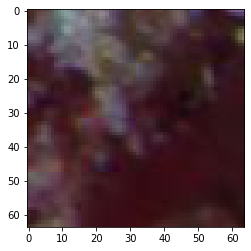

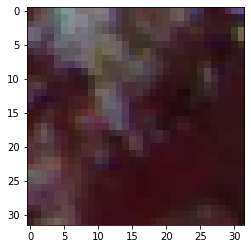

/content/Data_set_Train_x2/610/patch_604_13_30.jpg
/content/Data_set_Train_x2/610/patch_604_18_0.jpg
/content/Data_set_Train_x2/610/patch_605_5_14.jpg
/content/Data_set_Train_x2/610/patch_604_15_19.jpg
/content/Data_set_Train_x2/610/patch_605_2_14.jpg
/content/Data_set_Train_x2/610/patch_605_9_1.jpg
/content/Data_set_Train_x2/610/patch_605_8_6.jpg
/content/Data_set_Train_x2/610/patch_605_4_24.jpg
/content/Data_set_Train_x2/610/patch_604_15_18.jpg
/content/Data_set_Train_x2/610/patch_605_9_17.jpg
/content/Data_set_Train_x2/610/patch_604_15_4.jpg
/content/Data_set_Train_x2/610/patch_605_7_9.jpg
/content/Data_set_Train_x2/610/patch_605_3_20.jpg
/content/Data_set_Train_x2/610/patch_604_18_23.jpg
/content/Data_set_Train_x2/610/patch_604_15_9.jpg
/content/Data_set_Train_x2/610/patch_604_18_15.jpg
/content/Data_set_Train_x2/610/patch_604_18_25.jpg
/content/Data_set_Train_x2/610/patch_604_16_24.jpg
/content/Data_set_Train_x2/610/patch_605_3_10.jpg
/content/Data_set_Train_x2/610/patch_605_4_17.

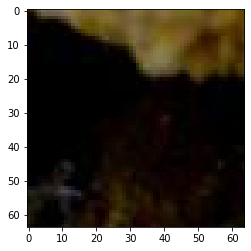

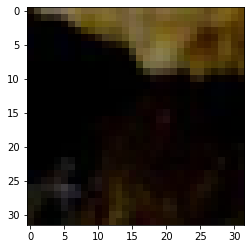

/content/Data_set_Train_x2/610/patch_605_13_21.jpg
/content/Data_set_Train_x2/610/patch_602_13_4.jpg
/content/Data_set_Train_x2/610/patch_602_10_3.jpg
/content/Data_set_Train_x2/610/patch_603_1_6.jpg
/content/Data_set_Train_x2/610/patch_603_1_4.jpg
/content/Data_set_Train_x2/610/patch_602_15_25.jpg
/content/Data_set_Train_x2/610/patch_602_7_19.jpg
/content/Data_set_Train_x2/610/patch_602_11_3.jpg
/content/Data_set_Train_x2/610/patch_602_10_28.jpg
/content/Data_set_Train_x2/610/patch_602_7_24.jpg
/content/Data_set_Train_x2/610/patch_602_20_4.jpg
/content/Data_set_Train_x2/610/patch_603_2_27.jpg
/content/Data_set_Train_x2/610/patch_602_20_3.jpg
/content/Data_set_Train_x2/610/patch_602_8_22.jpg
/content/Data_set_Train_x2/610/patch_602_18_14.jpg
/content/Data_set_Train_x2/610/patch_602_9_20.jpg
/content/Data_set_Train_x2/610/patch_602_15_12.jpg
/content/Data_set_Train_x2/610/patch_602_10_25.jpg
/content/Data_set_Train_x2/610/patch_602_20_12.jpg
/content/Data_set_Train_x2/610/patch_603_1_3.

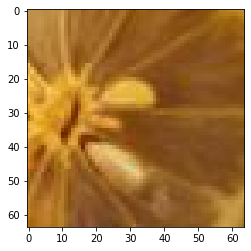

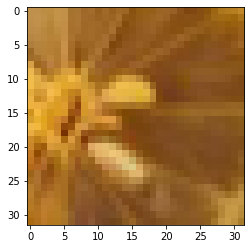

/content/Data_set_Train_x2/610/patch_603_3_10.jpg
/content/Data_set_Train_x2/610/patch_603_8_12.jpg
/content/Data_set_Train_x2/610/patch_603_15_22.jpg
/content/Data_set_Train_x2/610/patch_603_17_1.jpg
/content/Data_set_Train_x2/610/patch_603_10_23.jpg
/content/Data_set_Train_x2/610/patch_603_14_2.jpg
/content/Data_set_Train_x2/610/patch_603_18_20.jpg
/content/Data_set_Train_x2/610/patch_603_8_28.jpg
/content/Data_set_Train_x2/610/patch_603_7_13.jpg
/content/Data_set_Train_x2/610/patch_603_11_6.jpg
/content/Data_set_Train_x2/610/patch_603_9_4.jpg
/content/Data_set_Train_x2/610/patch_603_12_30.jpg
/content/Data_set_Train_x2/610/patch_603_17_0.jpg
/content/Data_set_Train_x2/610/patch_603_7_18.jpg
/content/Data_set_Train_x2/610/patch_603_16_12.jpg
/content/Data_set_Train_x2/610/patch_603_10_26.jpg
/content/Data_set_Train_x2/610/patch_603_12_1.jpg
/content/Data_set_Train_x2/610/patch_603_15_24.jpg
/content/Data_set_Train_x2/610/patch_603_14_30.jpg
/content/Data_set_Train_x2/610/patch_603_10

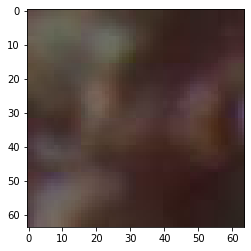

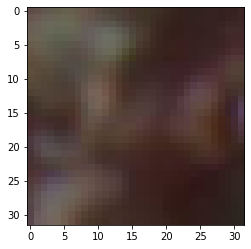

/content/Data_set_Train_x2/610/patch_604_1_11.jpg
/content/Data_set_Train_x2/610/patch_601_4_26.jpg
/content/Data_set_Train_x2/610/patch_600_28_12.jpg
/content/Data_set_Train_x2/610/patch_601_5_30.jpg
/content/Data_set_Train_x2/610/patch_601_2_19.jpg
/content/Data_set_Train_x2/610/patch_601_9_3.jpg
/content/Data_set_Train_x2/610/patch_600_30_4.jpg
/content/Data_set_Train_x2/610/patch_601_7_13.jpg
/content/Data_set_Train_x2/610/patch_601_5_6.jpg
/content/Data_set_Train_x2/610/patch_600_29_18.jpg
/content/Data_set_Train_x2/610/patch_601_2_3.jpg
/content/Data_set_Train_x2/610/patch_601_10_4.jpg
/content/Data_set_Train_x2/610/patch_600_24_14.jpg
/content/Data_set_Train_x2/610/patch_600_26_12.jpg
/content/Data_set_Train_x2/610/patch_601_4_4.jpg
/content/Data_set_Train_x2/610/patch_601_10_3.jpg
/content/Data_set_Train_x2/610/patch_601_0_16.jpg
/content/Data_set_Train_x2/610/patch_601_10_5.jpg
/content/Data_set_Train_x2/610/patch_601_9_29.jpg
/content/Data_set_Train_x2/610/patch_600_27_8.jpg


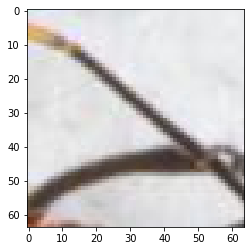

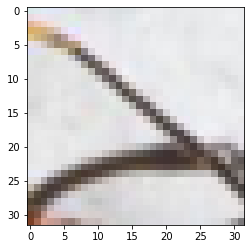

/content/Data_set_Train_x2/610/patch_602_6_27.jpg
/content/Data_set_Train_x2/610/patch_602_6_20.jpg
/content/Data_set_Train_x2/610/patch_601_18_24.jpg
/content/Data_set_Train_x2/610/patch_602_2_18.jpg
/content/Data_set_Train_x2/610/patch_601_20_5.jpg
/content/Data_set_Train_x2/610/patch_602_3_2.jpg
/content/Data_set_Train_x2/610/patch_601_12_16.jpg
/content/Data_set_Train_x2/610/patch_601_18_1.jpg
/content/Data_set_Train_x2/610/patch_601_17_7.jpg
/content/Data_set_Train_x2/610/patch_601_15_0.jpg
/content/Data_set_Train_x2/610/patch_601_15_13.jpg
/content/Data_set_Train_x2/610/patch_601_18_5.jpg
/content/Data_set_Train_x2/610/patch_601_18_30.jpg
/content/Data_set_Train_x2/610/patch_602_3_17.jpg
/content/Data_set_Train_x2/610/patch_601_15_24.jpg
/content/Data_set_Train_x2/610/patch_602_3_4.jpg
/content/Data_set_Train_x2/610/patch_601_18_15.jpg
/content/Data_set_Train_x2/610/patch_601_19_13.jpg
/content/Data_set_Train_x2/610/patch_601_19_22.jpg
/content/Data_set_Train_x2/610/patch_602_7_1

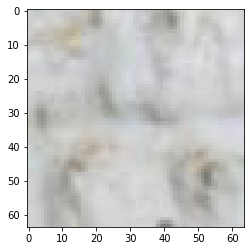

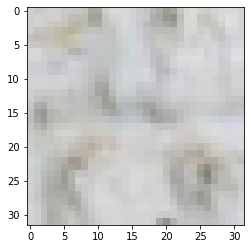

/content/Data_set_Train_x2/610/patch_602_14_1.jpg
/content/Data_set_Train_x2/610/patch_600_0_0.jpg
/content/Data_set_Train_x2/610/patch_600_0_4.jpg
/content/Data_set_Train_x2/610/patch_600_0_2.jpg
/content/Data_set_Train_x2/610/patch_600_0_6.jpg
/content/Data_set_Train_x2/610/patch_600_0_3.jpg
/content/Data_set_Train_x2/610/patch_600_0_5.jpg
/content/Data_set_Train_x2/610/patch_600_0_1.jpg
/content/Data_set_Train_x2/610/patch_600_5_17.jpg
/content/Data_set_Train_x2/610/patch_600_18_9.jpg
/content/Data_set_Train_x2/610/patch_600_15_3.jpg
/content/Data_set_Train_x2/610/patch_600_15_10.jpg
/content/Data_set_Train_x2/610/patch_600_5_1.jpg
/content/Data_set_Train_x2/610/patch_600_9_10.jpg
/content/Data_set_Train_x2/610/patch_600_24_6.jpg
/content/Data_set_Train_x2/610/patch_600_9_8.jpg
/content/Data_set_Train_x2/610/patch_600_13_15.jpg
/content/Data_set_Train_x2/610/patch_600_21_4.jpg
/content/Data_set_Train_x2/610/patch_600_12_12.jpg
/content/Data_set_Train_x2/610/patch_600_14_12.jpg
/cont

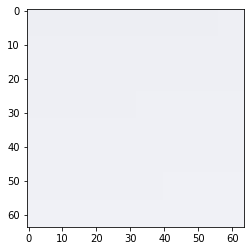

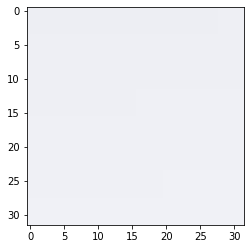

/content/Data_set_Train_x2/610/patch_600_1_9.jpg
/content/Data_set_Train_x2/610/patch_600_11_5.jpg
/content/Data_set_Train_x2/610/patch_600_12_15.jpg
/content/Data_set_Train_x2/610/patch_600_12_20.jpg
/content/Data_set_Train_x2/610/patch_600_16_20.jpg
/content/Data_set_Train_x2/610/patch_600_23_4.jpg
/content/Data_set_Train_x2/610/patch_600_6_18.jpg
/content/Data_set_Train_x2/610/patch_600_0_13.jpg
/content/Data_set_Train_x2/610/patch_600_16_18.jpg
/content/Data_set_Train_x2/610/patch_600_15_6.jpg
/content/Data_set_Train_x2/610/patch_600_22_15.jpg
/content/Data_set_Train_x2/610/patch_600_7_12.jpg
/content/Data_set_Train_x2/610/patch_600_21_17.jpg
/content/Data_set_Train_x2/610/patch_600_16_7.jpg
/content/Data_set_Train_x2/610/patch_600_4_3.jpg
/content/Data_set_Train_x2/610/patch_600_3_12.jpg
/content/Data_set_Train_x2/610/patch_600_14_15.jpg
/content/Data_set_Train_x2/610/patch_600_11_0.jpg
/content/Data_set_Train_x2/610/patch_601_5_24.jpg
/content/Data_set_Train_x2/610/patch_601_8_28

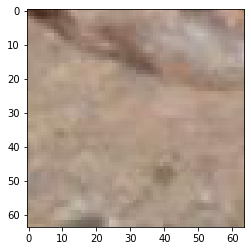

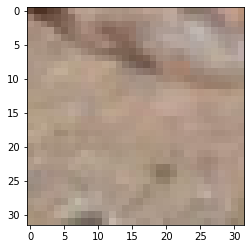

/content/Data_set_Train_x2/620/patch_619_10_4.jpg
/content/Data_set_Train_x2/620/patch_619_18_9.jpg
/content/Data_set_Train_x2/620/patch_619_1_1.jpg
/content/Data_set_Train_x2/620/patch_619_3_2.jpg
/content/Data_set_Train_x2/620/patch_619_9_14.jpg
/content/Data_set_Train_x2/620/patch_619_17_8.jpg
/content/Data_set_Train_x2/620/patch_619_8_6.jpg
/content/Data_set_Train_x2/620/patch_619_1_27.jpg
/content/Data_set_Train_x2/620/patch_619_15_23.jpg
/content/Data_set_Train_x2/620/patch_619_3_26.jpg
/content/Data_set_Train_x2/620/patch_619_6_18.jpg
/content/Data_set_Train_x2/620/patch_619_10_2.jpg
/content/Data_set_Train_x2/620/patch_619_2_12.jpg
/content/Data_set_Train_x2/620/patch_619_4_26.jpg
/content/Data_set_Train_x2/620/patch_619_1_14.jpg
/content/Data_set_Train_x2/620/patch_619_8_8.jpg
/content/Data_set_Train_x2/620/patch_619_7_8.jpg
/content/Data_set_Train_x2/620/patch_619_3_23.jpg
/content/Data_set_Train_x2/620/patch_619_9_21.jpg
/content/Data_set_Train_x2/620/patch_619_13_3.jpg
/con

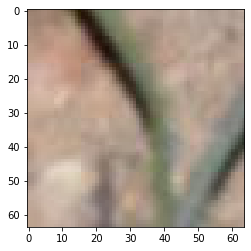

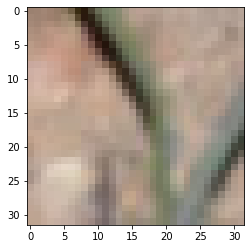

/content/Data_set_Train_x2/620/patch_619_20_20.jpg
/content/Data_set_Train_x2/620/patch_617_1_17.jpg
/content/Data_set_Train_x2/620/patch_616_18_14.jpg
/content/Data_set_Train_x2/620/patch_617_2_9.jpg
/content/Data_set_Train_x2/620/patch_616_19_4.jpg
/content/Data_set_Train_x2/620/patch_616_16_23.jpg
/content/Data_set_Train_x2/620/patch_616_19_22.jpg
/content/Data_set_Train_x2/620/patch_616_14_7.jpg
/content/Data_set_Train_x2/620/patch_616_14_15.jpg
/content/Data_set_Train_x2/620/patch_617_8_4.jpg
/content/Data_set_Train_x2/620/patch_617_1_18.jpg
/content/Data_set_Train_x2/620/patch_617_2_25.jpg
/content/Data_set_Train_x2/620/patch_616_18_4.jpg
/content/Data_set_Train_x2/620/patch_616_15_20.jpg
/content/Data_set_Train_x2/620/patch_617_4_30.jpg
/content/Data_set_Train_x2/620/patch_616_15_26.jpg
/content/Data_set_Train_x2/620/patch_617_8_20.jpg
/content/Data_set_Train_x2/620/patch_617_8_29.jpg
/content/Data_set_Train_x2/620/patch_616_15_9.jpg
/content/Data_set_Train_x2/620/patch_617_3_8.

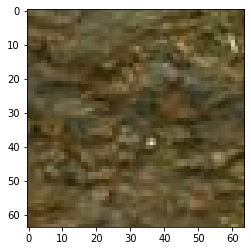

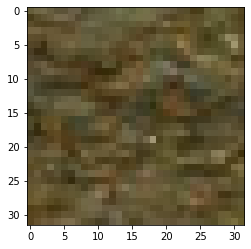

/content/Data_set_Train_x2/620/patch_617_17_10.jpg
/content/Data_set_Train_x2/620/patch_617_14_10.jpg
/content/Data_set_Train_x2/620/patch_617_15_15.jpg
/content/Data_set_Train_x2/620/patch_617_12_23.jpg
/content/Data_set_Train_x2/620/patch_617_12_22.jpg
/content/Data_set_Train_x2/620/patch_618_0_2.jpg
/content/Data_set_Train_x2/620/patch_617_10_2.jpg
/content/Data_set_Train_x2/620/patch_617_19_5.jpg
/content/Data_set_Train_x2/620/patch_617_18_7.jpg
/content/Data_set_Train_x2/620/patch_617_12_7.jpg
/content/Data_set_Train_x2/620/patch_617_10_30.jpg
/content/Data_set_Train_x2/620/patch_618_4_13.jpg
/content/Data_set_Train_x2/620/patch_617_11_21.jpg
/content/Data_set_Train_x2/620/patch_617_13_25.jpg
/content/Data_set_Train_x2/620/patch_617_13_30.jpg
/content/Data_set_Train_x2/620/patch_617_15_29.jpg
/content/Data_set_Train_x2/620/patch_617_16_3.jpg
/content/Data_set_Train_x2/620/patch_617_17_14.jpg
/content/Data_set_Train_x2/620/patch_618_4_26.jpg
/content/Data_set_Train_x2/620/patch_618

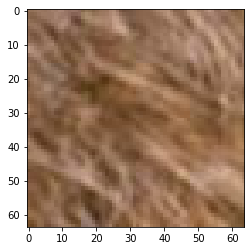

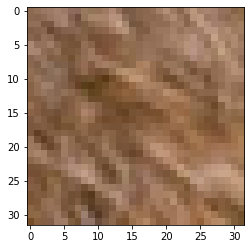

/content/Data_set_Train_x2/620/patch_618_12_26.jpg
/content/Data_set_Train_x2/620/patch_615_17_13.jpg
/content/Data_set_Train_x2/620/patch_615_8_20.jpg
/content/Data_set_Train_x2/620/patch_615_15_25.jpg
/content/Data_set_Train_x2/620/patch_615_4_30.jpg
/content/Data_set_Train_x2/620/patch_615_12_10.jpg
/content/Data_set_Train_x2/620/patch_615_7_29.jpg
/content/Data_set_Train_x2/620/patch_615_17_26.jpg
/content/Data_set_Train_x2/620/patch_615_6_19.jpg
/content/Data_set_Train_x2/620/patch_615_13_4.jpg
/content/Data_set_Train_x2/620/patch_615_10_12.jpg
/content/Data_set_Train_x2/620/patch_615_13_11.jpg
/content/Data_set_Train_x2/620/patch_615_7_30.jpg
/content/Data_set_Train_x2/620/patch_615_2_7.jpg
/content/Data_set_Train_x2/620/patch_615_15_26.jpg
/content/Data_set_Train_x2/620/patch_615_13_1.jpg
/content/Data_set_Train_x2/620/patch_615_4_5.jpg
/content/Data_set_Train_x2/620/patch_615_13_24.jpg
/content/Data_set_Train_x2/620/patch_615_16_20.jpg
/content/Data_set_Train_x2/620/patch_615_2

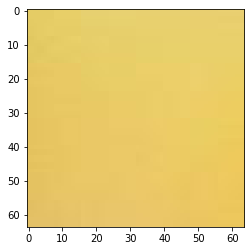

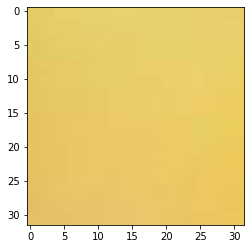

/content/Data_set_Train_x2/620/patch_616_12_2.jpg
/content/Data_set_Train_x2/620/patch_616_1_0.jpg
/content/Data_set_Train_x2/620/patch_616_8_5.jpg
/content/Data_set_Train_x2/620/patch_616_10_30.jpg
/content/Data_set_Train_x2/620/patch_616_11_20.jpg
/content/Data_set_Train_x2/620/patch_616_6_6.jpg
/content/Data_set_Train_x2/620/patch_616_5_10.jpg
/content/Data_set_Train_x2/620/patch_616_8_7.jpg
/content/Data_set_Train_x2/620/patch_616_2_12.jpg
/content/Data_set_Train_x2/620/patch_616_8_24.jpg
/content/Data_set_Train_x2/620/patch_616_10_2.jpg
/content/Data_set_Train_x2/620/patch_615_20_16.jpg
/content/Data_set_Train_x2/620/patch_616_3_23.jpg
/content/Data_set_Train_x2/620/patch_616_8_13.jpg
/content/Data_set_Train_x2/620/patch_616_4_6.jpg
/content/Data_set_Train_x2/620/patch_616_7_9.jpg
/content/Data_set_Train_x2/620/patch_616_6_20.jpg
/content/Data_set_Train_x2/620/patch_616_11_30.jpg
/content/Data_set_Train_x2/620/patch_615_18_17.jpg
/content/Data_set_Train_x2/620/patch_615_20_29.jpg


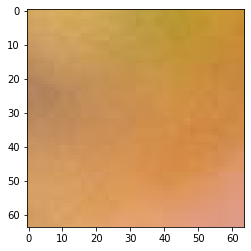

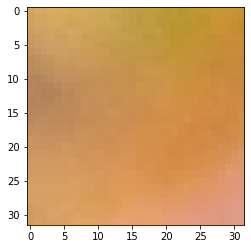

/content/Data_set_Train_x2/620/patch_616_16_11.jpg
/content/Data_set_Train_x2/620/patch_613_14_9.jpg
/content/Data_set_Train_x2/620/patch_613_9_24.jpg
/content/Data_set_Train_x2/620/patch_613_19_8.jpg
/content/Data_set_Train_x2/620/patch_614_1_0.jpg
/content/Data_set_Train_x2/620/patch_613_11_10.jpg
/content/Data_set_Train_x2/620/patch_613_18_0.jpg
/content/Data_set_Train_x2/620/patch_614_4_7.jpg
/content/Data_set_Train_x2/620/patch_614_4_25.jpg
/content/Data_set_Train_x2/620/patch_614_0_28.jpg
/content/Data_set_Train_x2/620/patch_613_13_3.jpg
/content/Data_set_Train_x2/620/patch_613_18_1.jpg
/content/Data_set_Train_x2/620/patch_613_18_3.jpg
/content/Data_set_Train_x2/620/patch_614_4_15.jpg
/content/Data_set_Train_x2/620/patch_614_2_23.jpg
/content/Data_set_Train_x2/620/patch_613_17_26.jpg
/content/Data_set_Train_x2/620/patch_614_3_19.jpg
/content/Data_set_Train_x2/620/patch_613_12_28.jpg
/content/Data_set_Train_x2/620/patch_614_1_17.jpg
/content/Data_set_Train_x2/620/patch_613_15_20.j

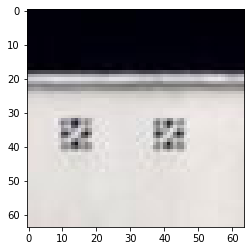

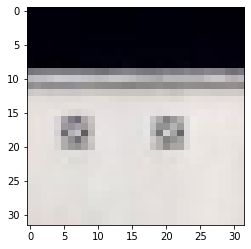

/content/Data_set_Train_x2/620/patch_614_11_10.jpg
/content/Data_set_Train_x2/620/patch_614_12_4.jpg
/content/Data_set_Train_x2/620/patch_614_18_12.jpg
/content/Data_set_Train_x2/620/patch_614_11_24.jpg
/content/Data_set_Train_x2/620/patch_614_5_7.jpg
/content/Data_set_Train_x2/620/patch_614_8_2.jpg
/content/Data_set_Train_x2/620/patch_614_17_7.jpg
/content/Data_set_Train_x2/620/patch_614_11_12.jpg
/content/Data_set_Train_x2/620/patch_614_9_19.jpg
/content/Data_set_Train_x2/620/patch_614_13_24.jpg
/content/Data_set_Train_x2/620/patch_614_19_17.jpg
/content/Data_set_Train_x2/620/patch_614_7_30.jpg
/content/Data_set_Train_x2/620/patch_615_0_26.jpg
/content/Data_set_Train_x2/620/patch_614_10_20.jpg
/content/Data_set_Train_x2/620/patch_614_10_30.jpg
/content/Data_set_Train_x2/620/patch_614_18_25.jpg
/content/Data_set_Train_x2/620/patch_614_17_18.jpg
/content/Data_set_Train_x2/620/patch_614_6_14.jpg
/content/Data_set_Train_x2/620/patch_614_13_6.jpg
/content/Data_set_Train_x2/620/patch_614_1

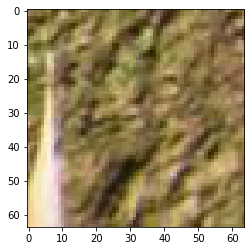

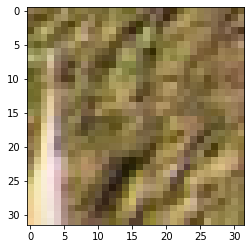

/content/Data_set_Train_x2/620/patch_615_10_3.jpg
/content/Data_set_Train_x2/620/patch_611_22_10.jpg
/content/Data_set_Train_x2/620/patch_612_1_15.jpg
/content/Data_set_Train_x2/620/patch_612_13_23.jpg
/content/Data_set_Train_x2/620/patch_611_23_2.jpg
/content/Data_set_Train_x2/620/patch_612_13_8.jpg
/content/Data_set_Train_x2/620/patch_612_6_5.jpg
/content/Data_set_Train_x2/620/patch_612_6_7.jpg
/content/Data_set_Train_x2/620/patch_612_1_10.jpg
/content/Data_set_Train_x2/620/patch_612_2_29.jpg
/content/Data_set_Train_x2/620/patch_612_2_25.jpg
/content/Data_set_Train_x2/620/patch_612_3_4.jpg
/content/Data_set_Train_x2/620/patch_612_3_22.jpg
/content/Data_set_Train_x2/620/patch_611_21_30.jpg
/content/Data_set_Train_x2/620/patch_611_22_13.jpg
/content/Data_set_Train_x2/620/patch_612_10_4.jpg
/content/Data_set_Train_x2/620/patch_611_21_22.jpg
/content/Data_set_Train_x2/620/patch_612_11_27.jpg
/content/Data_set_Train_x2/620/patch_611_22_20.jpg
/content/Data_set_Train_x2/620/patch_612_10_2.

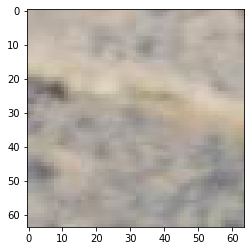

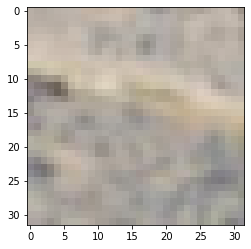

/content/Data_set_Train_x2/620/patch_612_20_21.jpg
/content/Data_set_Train_x2/620/patch_613_4_17.jpg
/content/Data_set_Train_x2/620/patch_613_6_25.jpg
/content/Data_set_Train_x2/620/patch_612_15_17.jpg
/content/Data_set_Train_x2/620/patch_613_6_9.jpg
/content/Data_set_Train_x2/620/patch_612_20_17.jpg
/content/Data_set_Train_x2/620/patch_613_4_25.jpg
/content/Data_set_Train_x2/620/patch_613_4_1.jpg
/content/Data_set_Train_x2/620/patch_612_17_17.jpg
/content/Data_set_Train_x2/620/patch_613_3_6.jpg
/content/Data_set_Train_x2/620/patch_613_9_1.jpg
/content/Data_set_Train_x2/620/patch_613_7_3.jpg
/content/Data_set_Train_x2/620/patch_612_14_5.jpg
/content/Data_set_Train_x2/620/patch_613_6_30.jpg
/content/Data_set_Train_x2/620/patch_613_9_15.jpg
/content/Data_set_Train_x2/620/patch_613_6_1.jpg
/content/Data_set_Train_x2/620/patch_612_16_11.jpg
/content/Data_set_Train_x2/620/patch_613_8_7.jpg
/content/Data_set_Train_x2/620/patch_613_0_29.jpg
/content/Data_set_Train_x2/620/patch_612_14_10.jpg
/

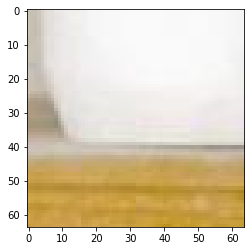

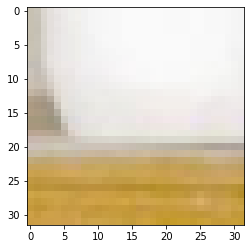

/content/Data_set_Train_x2/620/patch_613_11_19.jpg
/content/Data_set_Train_x2/620/patch_611_0_28.jpg
/content/Data_set_Train_x2/620/patch_611_3_24.jpg
/content/Data_set_Train_x2/620/patch_611_0_18.jpg
/content/Data_set_Train_x2/620/patch_610_20_26.jpg
/content/Data_set_Train_x2/620/patch_610_14_17.jpg
/content/Data_set_Train_x2/620/patch_610_17_3.jpg
/content/Data_set_Train_x2/620/patch_610_19_9.jpg
/content/Data_set_Train_x2/620/patch_610_14_6.jpg
/content/Data_set_Train_x2/620/patch_610_18_11.jpg
/content/Data_set_Train_x2/620/patch_610_14_15.jpg
/content/Data_set_Train_x2/620/patch_611_1_0.jpg
/content/Data_set_Train_x2/620/patch_610_12_12.jpg
/content/Data_set_Train_x2/620/patch_610_13_20.jpg
/content/Data_set_Train_x2/620/patch_610_15_26.jpg
/content/Data_set_Train_x2/620/patch_610_17_21.jpg
/content/Data_set_Train_x2/620/patch_610_19_12.jpg
/content/Data_set_Train_x2/620/patch_610_11_7.jpg
/content/Data_set_Train_x2/620/patch_611_3_29.jpg
/content/Data_set_Train_x2/620/patch_611_

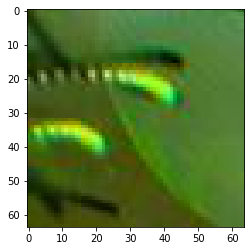

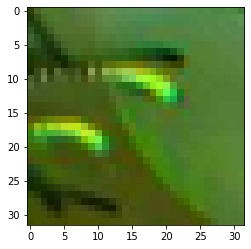

/content/Data_set_Train_x2/620/patch_611_15_23.jpg
/content/Data_set_Train_x2/620/patch_611_19_6.jpg
/content/Data_set_Train_x2/620/patch_611_9_9.jpg
/content/Data_set_Train_x2/620/patch_611_13_16.jpg
/content/Data_set_Train_x2/620/patch_611_10_3.jpg
/content/Data_set_Train_x2/620/patch_611_6_9.jpg
/content/Data_set_Train_x2/620/patch_611_10_16.jpg
/content/Data_set_Train_x2/620/patch_611_17_15.jpg
/content/Data_set_Train_x2/620/patch_611_19_25.jpg
/content/Data_set_Train_x2/620/patch_611_11_19.jpg
/content/Data_set_Train_x2/620/patch_611_21_18.jpg
/content/Data_set_Train_x2/620/patch_611_20_22.jpg
/content/Data_set_Train_x2/620/patch_611_7_9.jpg
/content/Data_set_Train_x2/620/patch_611_17_8.jpg
/content/Data_set_Train_x2/620/patch_611_11_21.jpg
/content/Data_set_Train_x2/620/patch_611_8_20.jpg
/content/Data_set_Train_x2/620/patch_611_10_25.jpg
/content/Data_set_Train_x2/620/patch_611_7_23.jpg
/content/Data_set_Train_x2/620/patch_611_20_12.jpg
/content/Data_set_Train_x2/620/patch_611_7

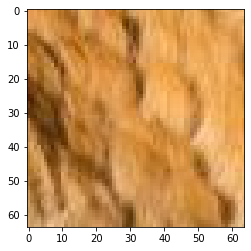

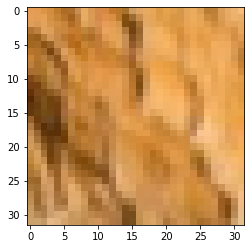

/content/Data_set_Train_x2/620/patch_612_9_14.jpg
/content/Data_set_Train_x2/620/patch_610_3_0.jpg
/content/Data_set_Train_x2/620/patch_610_3_22.jpg
/content/Data_set_Train_x2/620/patch_610_2_12.jpg
/content/Data_set_Train_x2/620/patch_610_6_29.jpg
/content/Data_set_Train_x2/620/patch_610_8_26.jpg
/content/Data_set_Train_x2/620/patch_610_3_14.jpg
/content/Data_set_Train_x2/620/patch_610_8_9.jpg
/content/Data_set_Train_x2/620/patch_610_3_3.jpg
/content/Data_set_Train_x2/620/patch_610_8_5.jpg
/content/Data_set_Train_x2/620/patch_610_6_5.jpg
/content/Data_set_Train_x2/620/patch_610_2_4.jpg
/content/Data_set_Train_x2/620/patch_610_1_2.jpg
/content/Data_set_Train_x2/620/patch_610_8_25.jpg
/content/Data_set_Train_x2/620/patch_610_2_9.jpg
/content/Data_set_Train_x2/620/patch_610_1_24.jpg
/content/Data_set_Train_x2/620/patch_610_2_6.jpg
/content/Data_set_Train_x2/620/patch_610_8_21.jpg
/content/Data_set_Train_x2/620/patch_610_9_5.jpg
/content/Data_set_Train_x2/620/patch_610_1_12.jpg
/content/D

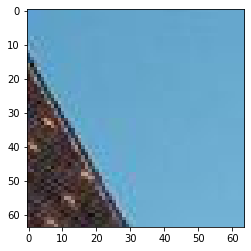

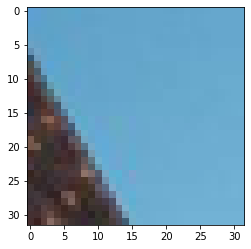

/content/Data_set_Train_x2/620/patch_610_12_14.jpg
/content/Data_set_Train_x2/620/patch_611_2_20.jpg
/content/Data_set_Train_x2/620/patch_611_1_13.jpg
/content/Data_set_Train_x2/620/patch_610_11_30.jpg
/content/Data_set_Train_x2/620/patch_611_5_5.jpg
/content/Data_set_Train_x2/620/patch_610_14_11.jpg
/content/Data_set_Train_x2/620/patch_610_16_6.jpg
/content/Data_set_Train_x2/620/patch_610_14_9.jpg
/content/Data_set_Train_x2/620/patch_610_15_6.jpg
/content/Data_set_Train_x2/620/patch_611_0_19.jpg
/content/Data_set_Train_x2/620/patch_610_17_2.jpg
/content/Data_set_Train_x2/620/patch_610_14_7.jpg
/content/Data_set_Train_x2/620/patch_610_12_2.jpg
/content/Data_set_Train_x2/620/patch_610_10_20.jpg
/content/Data_set_Train_x2/620/patch_610_13_25.jpg
/content/Data_set_Train_x2/620/patch_611_3_13.jpg
/content/Data_set_Train_x2/620/patch_610_14_19.jpg
/content/Data_set_Train_x2/620/patch_610_10_28.jpg
/content/Data_set_Train_x2/620/patch_611_3_10.jpg
/content/Data_set_Train_x2/620/patch_611_2_1

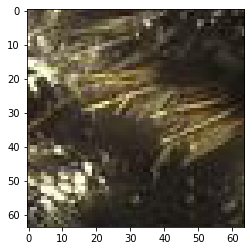

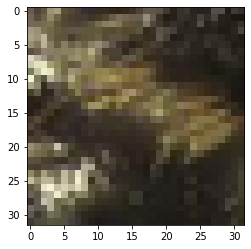

/content/Data_set_Train_x2/630/patch_629_16_12.jpg
/content/Data_set_Train_x2/630/patch_629_14_10.jpg
/content/Data_set_Train_x2/630/patch_629_12_21.jpg
/content/Data_set_Train_x2/630/patch_629_6_26.jpg
/content/Data_set_Train_x2/630/patch_629_4_2.jpg
/content/Data_set_Train_x2/630/patch_629_12_8.jpg
/content/Data_set_Train_x2/630/patch_629_7_29.jpg
/content/Data_set_Train_x2/630/patch_629_8_29.jpg
/content/Data_set_Train_x2/630/patch_629_2_13.jpg
/content/Data_set_Train_x2/630/patch_629_15_28.jpg
/content/Data_set_Train_x2/630/patch_629_6_12.jpg
/content/Data_set_Train_x2/630/patch_629_9_22.jpg
/content/Data_set_Train_x2/630/patch_629_13_26.jpg
/content/Data_set_Train_x2/630/patch_629_11_24.jpg
/content/Data_set_Train_x2/630/patch_629_10_29.jpg
/content/Data_set_Train_x2/630/patch_629_12_7.jpg
/content/Data_set_Train_x2/630/patch_629_14_3.jpg
/content/Data_set_Train_x2/630/patch_629_1_17.jpg
/content/Data_set_Train_x2/630/patch_629_7_25.jpg
/content/Data_set_Train_x2/630/patch_629_4_0

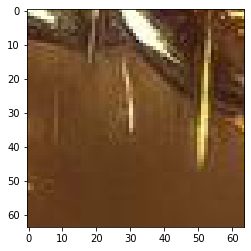

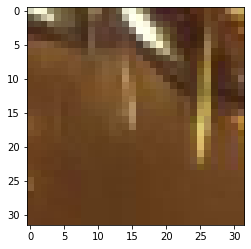

/content/Data_set_Train_x2/630/patch_629_19_21.jpg
/content/Data_set_Train_x2/630/patch_626_20_17.jpg
/content/Data_set_Train_x2/630/patch_627_5_2.jpg
/content/Data_set_Train_x2/630/patch_627_2_15.jpg
/content/Data_set_Train_x2/630/patch_626_17_27.jpg
/content/Data_set_Train_x2/630/patch_626_16_3.jpg
/content/Data_set_Train_x2/630/patch_626_19_24.jpg
/content/Data_set_Train_x2/630/patch_626_20_11.jpg
/content/Data_set_Train_x2/630/patch_626_16_6.jpg
/content/Data_set_Train_x2/630/patch_627_4_15.jpg
/content/Data_set_Train_x2/630/patch_627_15_12.jpg
/content/Data_set_Train_x2/630/patch_627_6_3.jpg
/content/Data_set_Train_x2/630/patch_627_1_14.jpg
/content/Data_set_Train_x2/630/patch_627_12_18.jpg
/content/Data_set_Train_x2/630/patch_627_5_16.jpg
/content/Data_set_Train_x2/630/patch_626_18_24.jpg
/content/Data_set_Train_x2/630/patch_627_15_8.jpg
/content/Data_set_Train_x2/630/patch_627_4_20.jpg
/content/Data_set_Train_x2/630/patch_627_15_17.jpg
/content/Data_set_Train_x2/630/patch_627_5_

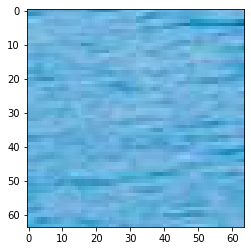

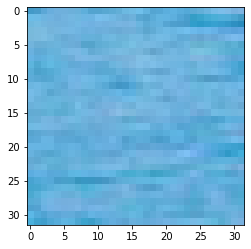

/content/Data_set_Train_x2/630/patch_628_1_0.jpg
/content/Data_set_Train_x2/630/patch_627_25_0.jpg
/content/Data_set_Train_x2/630/patch_628_3_0.jpg
/content/Data_set_Train_x2/630/patch_627_17_12.jpg
/content/Data_set_Train_x2/630/patch_628_2_28.jpg
/content/Data_set_Train_x2/630/patch_627_23_1.jpg
/content/Data_set_Train_x2/630/patch_627_25_19.jpg
/content/Data_set_Train_x2/630/patch_627_24_13.jpg
/content/Data_set_Train_x2/630/patch_627_22_2.jpg
/content/Data_set_Train_x2/630/patch_628_2_30.jpg
/content/Data_set_Train_x2/630/patch_627_18_8.jpg
/content/Data_set_Train_x2/630/patch_628_1_24.jpg
/content/Data_set_Train_x2/630/patch_627_17_21.jpg
/content/Data_set_Train_x2/630/patch_627_23_23.jpg
/content/Data_set_Train_x2/630/patch_627_18_10.jpg
/content/Data_set_Train_x2/630/patch_627_22_14.jpg
/content/Data_set_Train_x2/630/patch_628_2_12.jpg
/content/Data_set_Train_x2/630/patch_628_2_15.jpg
/content/Data_set_Train_x2/630/patch_628_0_15.jpg
/content/Data_set_Train_x2/630/patch_628_4_24

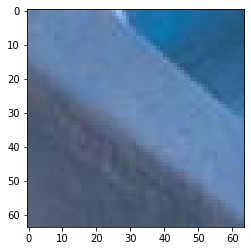

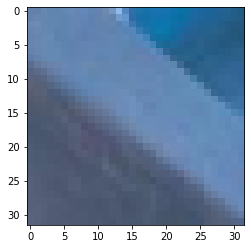

/content/Data_set_Train_x2/630/patch_628_15_8.jpg
/content/Data_set_Train_x2/630/patch_625_16_19.jpg
/content/Data_set_Train_x2/630/patch_625_16_7.jpg
/content/Data_set_Train_x2/630/patch_625_13_10.jpg
/content/Data_set_Train_x2/630/patch_625_16_26.jpg
/content/Data_set_Train_x2/630/patch_625_16_28.jpg
/content/Data_set_Train_x2/630/patch_625_21_9.jpg
/content/Data_set_Train_x2/630/patch_625_18_6.jpg
/content/Data_set_Train_x2/630/patch_625_13_21.jpg
/content/Data_set_Train_x2/630/patch_625_14_2.jpg
/content/Data_set_Train_x2/630/patch_625_10_28.jpg
/content/Data_set_Train_x2/630/patch_625_4_30.jpg
/content/Data_set_Train_x2/630/patch_625_18_19.jpg
/content/Data_set_Train_x2/630/patch_625_10_25.jpg
/content/Data_set_Train_x2/630/patch_625_11_8.jpg
/content/Data_set_Train_x2/630/patch_625_18_4.jpg
/content/Data_set_Train_x2/630/patch_625_11_1.jpg
/content/Data_set_Train_x2/630/patch_625_19_7.jpg
/content/Data_set_Train_x2/630/patch_625_8_17.jpg
/content/Data_set_Train_x2/630/patch_625_1

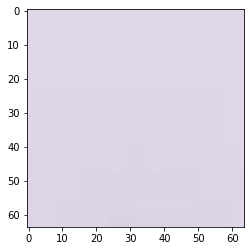

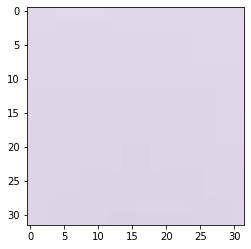

/content/Data_set_Train_x2/630/patch_626_4_29.jpg
/content/Data_set_Train_x2/630/patch_626_9_7.jpg
/content/Data_set_Train_x2/630/patch_626_3_10.jpg
/content/Data_set_Train_x2/630/patch_626_9_6.jpg
/content/Data_set_Train_x2/630/patch_626_8_8.jpg
/content/Data_set_Train_x2/630/patch_626_12_21.jpg
/content/Data_set_Train_x2/630/patch_626_13_18.jpg
/content/Data_set_Train_x2/630/patch_626_11_22.jpg
/content/Data_set_Train_x2/630/patch_626_8_18.jpg
/content/Data_set_Train_x2/630/patch_626_14_27.jpg
/content/Data_set_Train_x2/630/patch_626_9_4.jpg
/content/Data_set_Train_x2/630/patch_626_1_13.jpg
/content/Data_set_Train_x2/630/patch_626_14_25.jpg
/content/Data_set_Train_x2/630/patch_625_21_28.jpg
/content/Data_set_Train_x2/630/patch_626_15_4.jpg
/content/Data_set_Train_x2/630/patch_626_11_6.jpg
/content/Data_set_Train_x2/630/patch_626_1_27.jpg
/content/Data_set_Train_x2/630/patch_626_12_5.jpg
/content/Data_set_Train_x2/630/patch_626_15_11.jpg
/content/Data_set_Train_x2/630/patch_626_10_17.

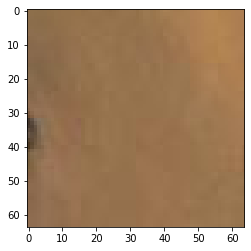

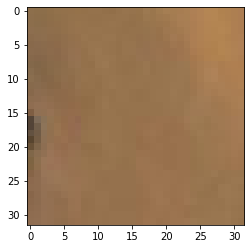

/content/Data_set_Train_x2/630/patch_627_9_1.jpg
/content/Data_set_Train_x2/630/patch_624_9_3.jpg
/content/Data_set_Train_x2/630/patch_623_16_15.jpg
/content/Data_set_Train_x2/630/patch_623_18_20.jpg
/content/Data_set_Train_x2/630/patch_623_16_26.jpg
/content/Data_set_Train_x2/630/patch_624_3_20.jpg
/content/Data_set_Train_x2/630/patch_624_13_3.jpg
/content/Data_set_Train_x2/630/patch_624_11_9.jpg
/content/Data_set_Train_x2/630/patch_624_3_16.jpg
/content/Data_set_Train_x2/630/patch_624_0_0.jpg
/content/Data_set_Train_x2/630/patch_623_16_27.jpg
/content/Data_set_Train_x2/630/patch_624_2_15.jpg
/content/Data_set_Train_x2/630/patch_623_17_23.jpg
/content/Data_set_Train_x2/630/patch_624_9_12.jpg
/content/Data_set_Train_x2/630/patch_623_17_26.jpg
/content/Data_set_Train_x2/630/patch_624_10_18.jpg
/content/Data_set_Train_x2/630/patch_624_0_10.jpg
/content/Data_set_Train_x2/630/patch_624_7_4.jpg
/content/Data_set_Train_x2/630/patch_624_11_11.jpg
/content/Data_set_Train_x2/630/patch_623_17_19

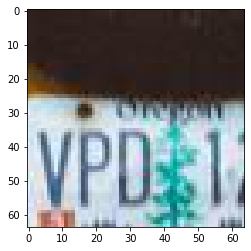

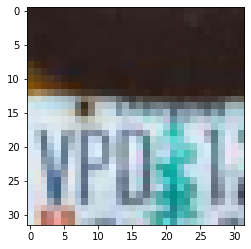

/content/Data_set_Train_x2/630/patch_624_25_10.jpg
/content/Data_set_Train_x2/630/patch_624_30_6.jpg
/content/Data_set_Train_x2/630/patch_624_22_10.jpg
/content/Data_set_Train_x2/630/patch_625_3_8.jpg
/content/Data_set_Train_x2/630/patch_624_22_4.jpg
/content/Data_set_Train_x2/630/patch_624_18_0.jpg
/content/Data_set_Train_x2/630/patch_624_15_18.jpg
/content/Data_set_Train_x2/630/patch_624_30_8.jpg
/content/Data_set_Train_x2/630/patch_624_23_16.jpg
/content/Data_set_Train_x2/630/patch_625_4_20.jpg
/content/Data_set_Train_x2/630/patch_624_29_2.jpg
/content/Data_set_Train_x2/630/patch_625_0_0.jpg
/content/Data_set_Train_x2/630/patch_624_30_4.jpg
/content/Data_set_Train_x2/630/patch_624_17_11.jpg
/content/Data_set_Train_x2/630/patch_624_26_2.jpg
/content/Data_set_Train_x2/630/patch_624_26_4.jpg
/content/Data_set_Train_x2/630/patch_624_25_8.jpg
/content/Data_set_Train_x2/630/patch_625_0_9.jpg
/content/Data_set_Train_x2/630/patch_624_18_8.jpg
/content/Data_set_Train_x2/630/patch_624_19_3.jp

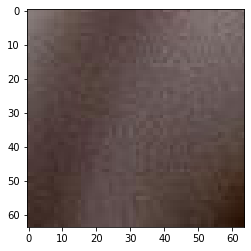

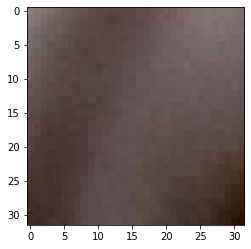

/content/Data_set_Train_x2/630/patch_625_12_30.jpg
/content/Data_set_Train_x2/630/patch_622_12_11.jpg
/content/Data_set_Train_x2/630/patch_623_1_23.jpg
/content/Data_set_Train_x2/630/patch_622_7_2.jpg
/content/Data_set_Train_x2/630/patch_623_2_4.jpg
/content/Data_set_Train_x2/630/patch_622_6_13.jpg
/content/Data_set_Train_x2/630/patch_622_13_6.jpg
/content/Data_set_Train_x2/630/patch_622_13_12.jpg
/content/Data_set_Train_x2/630/patch_622_11_2.jpg
/content/Data_set_Train_x2/630/patch_622_16_25.jpg
/content/Data_set_Train_x2/630/patch_622_10_17.jpg
/content/Data_set_Train_x2/630/patch_622_12_8.jpg
/content/Data_set_Train_x2/630/patch_622_16_12.jpg
/content/Data_set_Train_x2/630/patch_622_9_26.jpg
/content/Data_set_Train_x2/630/patch_622_13_27.jpg
/content/Data_set_Train_x2/630/patch_622_11_13.jpg
/content/Data_set_Train_x2/630/patch_622_17_7.jpg
/content/Data_set_Train_x2/630/patch_622_15_19.jpg
/content/Data_set_Train_x2/630/patch_623_1_9.jpg
/content/Data_set_Train_x2/630/patch_622_18_

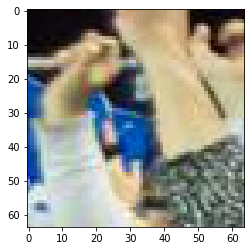

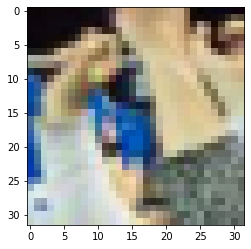

/content/Data_set_Train_x2/630/patch_623_12_0.jpg
/content/Data_set_Train_x2/630/patch_623_4_3.jpg
/content/Data_set_Train_x2/630/patch_623_11_13.jpg
/content/Data_set_Train_x2/630/patch_623_10_11.jpg
/content/Data_set_Train_x2/630/patch_623_12_13.jpg
/content/Data_set_Train_x2/630/patch_623_4_18.jpg
/content/Data_set_Train_x2/630/patch_623_8_21.jpg
/content/Data_set_Train_x2/630/patch_623_4_27.jpg
/content/Data_set_Train_x2/630/patch_623_6_26.jpg
/content/Data_set_Train_x2/630/patch_623_4_9.jpg
/content/Data_set_Train_x2/630/patch_623_7_15.jpg
/content/Data_set_Train_x2/630/patch_623_8_17.jpg
/content/Data_set_Train_x2/630/patch_623_14_4.jpg
/content/Data_set_Train_x2/630/patch_623_8_4.jpg
/content/Data_set_Train_x2/630/patch_623_12_15.jpg
/content/Data_set_Train_x2/630/patch_623_7_4.jpg
/content/Data_set_Train_x2/630/patch_623_3_30.jpg
/content/Data_set_Train_x2/630/patch_623_8_10.jpg
/content/Data_set_Train_x2/630/patch_623_5_3.jpg
/content/Data_set_Train_x2/630/patch_623_6_25.jpg
/

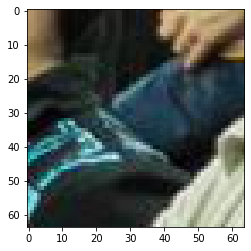

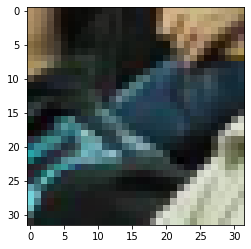

/content/Data_set_Train_x2/630/patch_623_14_6.jpg
/content/Data_set_Train_x2/630/patch_621_4_21.jpg
/content/Data_set_Train_x2/630/patch_620_24_17.jpg
/content/Data_set_Train_x2/630/patch_621_1_1.jpg
/content/Data_set_Train_x2/630/patch_620_28_16.jpg
/content/Data_set_Train_x2/630/patch_620_27_10.jpg
/content/Data_set_Train_x2/630/patch_621_6_5.jpg
/content/Data_set_Train_x2/630/patch_621_8_29.jpg
/content/Data_set_Train_x2/630/patch_621_8_14.jpg
/content/Data_set_Train_x2/630/patch_621_8_16.jpg
/content/Data_set_Train_x2/630/patch_621_1_23.jpg
/content/Data_set_Train_x2/630/patch_621_1_25.jpg
/content/Data_set_Train_x2/630/patch_621_2_7.jpg
/content/Data_set_Train_x2/630/patch_620_26_6.jpg
/content/Data_set_Train_x2/630/patch_621_5_27.jpg
/content/Data_set_Train_x2/630/patch_621_6_6.jpg
/content/Data_set_Train_x2/630/patch_621_6_14.jpg
/content/Data_set_Train_x2/630/patch_621_5_7.jpg
/content/Data_set_Train_x2/630/patch_621_1_22.jpg
/content/Data_set_Train_x2/630/patch_620_24_18.jpg
/

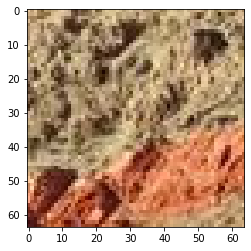

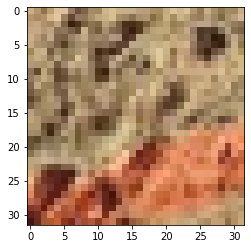

/content/Data_set_Train_x2/630/patch_621_11_26.jpg
/content/Data_set_Train_x2/630/patch_621_15_24.jpg
/content/Data_set_Train_x2/630/patch_621_18_5.jpg
/content/Data_set_Train_x2/630/patch_622_0_1.jpg
/content/Data_set_Train_x2/630/patch_622_0_11.jpg
/content/Data_set_Train_x2/630/patch_621_15_29.jpg
/content/Data_set_Train_x2/630/patch_621_15_3.jpg
/content/Data_set_Train_x2/630/patch_621_11_21.jpg
/content/Data_set_Train_x2/630/patch_621_16_10.jpg
/content/Data_set_Train_x2/630/patch_621_15_22.jpg
/content/Data_set_Train_x2/630/patch_621_15_30.jpg
/content/Data_set_Train_x2/630/patch_622_2_14.jpg
/content/Data_set_Train_x2/630/patch_621_20_15.jpg
/content/Data_set_Train_x2/630/patch_621_10_24.jpg
/content/Data_set_Train_x2/630/patch_621_14_4.jpg
/content/Data_set_Train_x2/630/patch_621_17_27.jpg
/content/Data_set_Train_x2/630/patch_622_0_25.jpg
/content/Data_set_Train_x2/630/patch_621_17_21.jpg
/content/Data_set_Train_x2/630/patch_621_17_17.jpg
/content/Data_set_Train_x2/630/patch_62

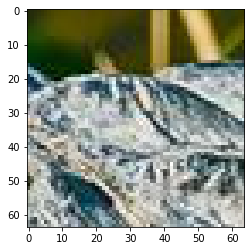

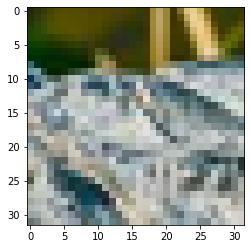

/content/Data_set_Train_x2/630/patch_622_9_1.jpg
/content/Data_set_Train_x2/630/patch_620_12_6.jpg
/content/Data_set_Train_x2/630/patch_620_8_14.jpg
/content/Data_set_Train_x2/630/patch_620_5_20.jpg
/content/Data_set_Train_x2/630/patch_620_3_19.jpg
/content/Data_set_Train_x2/630/patch_620_8_16.jpg
/content/Data_set_Train_x2/630/patch_620_10_4.jpg
/content/Data_set_Train_x2/630/patch_620_4_16.jpg
/content/Data_set_Train_x2/630/patch_620_2_20.jpg
/content/Data_set_Train_x2/630/patch_620_15_10.jpg
/content/Data_set_Train_x2/630/patch_620_4_13.jpg
/content/Data_set_Train_x2/630/patch_620_16_8.jpg
/content/Data_set_Train_x2/630/patch_620_16_19.jpg
/content/Data_set_Train_x2/630/patch_620_4_6.jpg
/content/Data_set_Train_x2/630/patch_620_17_5.jpg
/content/Data_set_Train_x2/630/patch_620_0_12.jpg
/content/Data_set_Train_x2/630/patch_620_3_14.jpg
/content/Data_set_Train_x2/630/patch_620_14_1.jpg
/content/Data_set_Train_x2/630/patch_620_14_13.jpg
/content/Data_set_Train_x2/630/patch_620_4_17.jpg

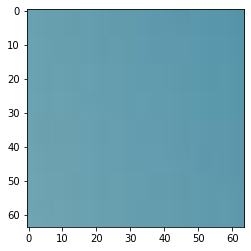

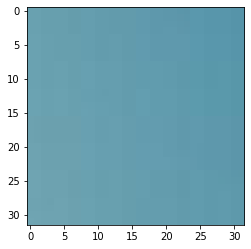

/content/Data_set_Train_x2/630/patch_621_2_12.jpg
/content/Data_set_Train_x2/630/patch_620_24_20.jpg
/content/Data_set_Train_x2/630/patch_621_0_0.jpg
/content/Data_set_Train_x2/630/patch_621_4_13.jpg
/content/Data_set_Train_x2/630/patch_620_19_3.jpg
/content/Data_set_Train_x2/630/patch_621_8_5.jpg
/content/Data_set_Train_x2/630/patch_620_28_4.jpg
/content/Data_set_Train_x2/630/patch_620_22_19.jpg
/content/Data_set_Train_x2/630/patch_620_20_0.jpg
/content/Data_set_Train_x2/630/patch_620_20_9.jpg
/content/Data_set_Train_x2/630/patch_620_22_17.jpg
/content/Data_set_Train_x2/630/patch_621_7_25.jpg
/content/Data_set_Train_x2/630/patch_621_7_7.jpg
/content/Data_set_Train_x2/630/patch_620_29_0.jpg
/content/Data_set_Train_x2/630/patch_621_4_19.jpg
/content/Data_set_Train_x2/630/patch_621_3_8.jpg
/content/Data_set_Train_x2/630/patch_621_4_14.jpg
/content/Data_set_Train_x2/630/patch_621_8_19.jpg
/content/Data_set_Train_x2/630/patch_620_19_0.jpg
/content/Data_set_Train_x2/630/patch_621_2_25.jpg
/

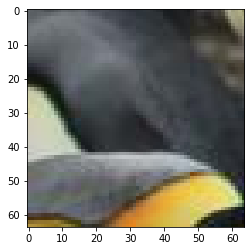

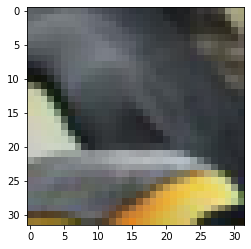

/content/Data_set_Train_x2/640/patch_639_10_4.jpg
/content/Data_set_Train_x2/640/patch_639_12_14.jpg
/content/Data_set_Train_x2/640/patch_639_15_22.jpg
/content/Data_set_Train_x2/640/patch_639_13_20.jpg
/content/Data_set_Train_x2/640/patch_639_12_10.jpg
/content/Data_set_Train_x2/640/patch_639_14_21.jpg
/content/Data_set_Train_x2/640/patch_639_14_30.jpg
/content/Data_set_Train_x2/640/patch_639_16_22.jpg
/content/Data_set_Train_x2/640/patch_639_5_28.jpg
/content/Data_set_Train_x2/640/patch_639_13_19.jpg
/content/Data_set_Train_x2/640/patch_639_18_3.jpg
/content/Data_set_Train_x2/640/patch_639_4_25.jpg
/content/Data_set_Train_x2/640/patch_639_20_1.jpg
/content/Data_set_Train_x2/640/patch_639_17_17.jpg
/content/Data_set_Train_x2/640/patch_639_10_19.jpg
/content/Data_set_Train_x2/640/patch_639_19_15.jpg
/content/Data_set_Train_x2/640/patch_639_5_8.jpg
/content/Data_set_Train_x2/640/patch_639_6_13.jpg
/content/Data_set_Train_x2/640/patch_639_6_16.jpg
/content/Data_set_Train_x2/640/patch_639

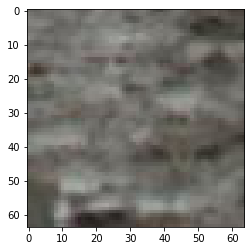

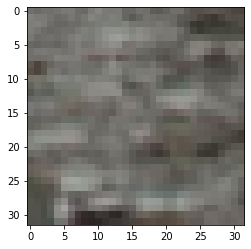

/content/Data_set_Train_x2/640/patch_639_20_26.jpg
/content/Data_set_Train_x2/640/patch_637_3_2.jpg
/content/Data_set_Train_x2/640/patch_637_8_27.jpg
/content/Data_set_Train_x2/640/patch_636_20_9.jpg
/content/Data_set_Train_x2/640/patch_637_12_4.jpg
/content/Data_set_Train_x2/640/patch_637_6_4.jpg
/content/Data_set_Train_x2/640/patch_637_7_6.jpg
/content/Data_set_Train_x2/640/patch_637_4_19.jpg
/content/Data_set_Train_x2/640/patch_637_11_28.jpg
/content/Data_set_Train_x2/640/patch_637_1_30.jpg
/content/Data_set_Train_x2/640/patch_637_3_13.jpg
/content/Data_set_Train_x2/640/patch_637_13_7.jpg
/content/Data_set_Train_x2/640/patch_636_19_2.jpg
/content/Data_set_Train_x2/640/patch_636_19_12.jpg
/content/Data_set_Train_x2/640/patch_637_5_13.jpg
/content/Data_set_Train_x2/640/patch_637_9_24.jpg
/content/Data_set_Train_x2/640/patch_637_7_29.jpg
/content/Data_set_Train_x2/640/patch_637_8_26.jpg
/content/Data_set_Train_x2/640/patch_637_12_25.jpg
/content/Data_set_Train_x2/640/patch_637_13_13.jp

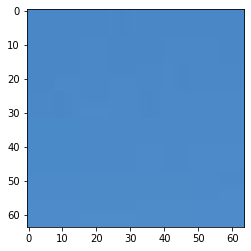

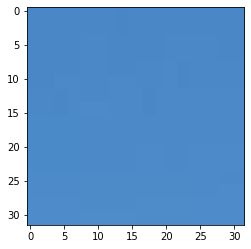

/content/Data_set_Train_x2/640/patch_638_0_9.jpg
/content/Data_set_Train_x2/640/patch_638_6_14.jpg
/content/Data_set_Train_x2/640/patch_637_20_4.jpg
/content/Data_set_Train_x2/640/patch_637_15_9.jpg
/content/Data_set_Train_x2/640/patch_638_3_17.jpg
/content/Data_set_Train_x2/640/patch_638_0_11.jpg
/content/Data_set_Train_x2/640/patch_637_18_6.jpg
/content/Data_set_Train_x2/640/patch_638_7_30.jpg
/content/Data_set_Train_x2/640/patch_638_6_12.jpg
/content/Data_set_Train_x2/640/patch_637_19_3.jpg
/content/Data_set_Train_x2/640/patch_638_4_30.jpg
/content/Data_set_Train_x2/640/patch_638_1_28.jpg
/content/Data_set_Train_x2/640/patch_638_3_12.jpg
/content/Data_set_Train_x2/640/patch_638_1_9.jpg
/content/Data_set_Train_x2/640/patch_638_5_12.jpg
/content/Data_set_Train_x2/640/patch_638_3_3.jpg
/content/Data_set_Train_x2/640/patch_638_8_3.jpg
/content/Data_set_Train_x2/640/patch_638_4_9.jpg
/content/Data_set_Train_x2/640/patch_637_16_3.jpg
/content/Data_set_Train_x2/640/patch_638_4_11.jpg
/cont

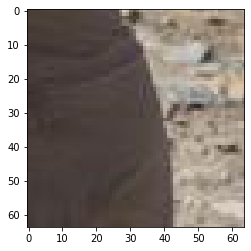

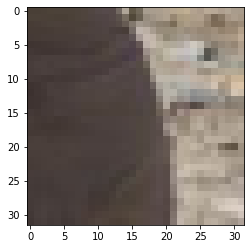

/content/Data_set_Train_x2/640/patch_638_15_16.jpg
/content/Data_set_Train_x2/640/patch_635_24_10.jpg
/content/Data_set_Train_x2/640/patch_635_30_0.jpg
/content/Data_set_Train_x2/640/patch_635_18_3.jpg
/content/Data_set_Train_x2/640/patch_635_23_25.jpg
/content/Data_set_Train_x2/640/patch_635_26_29.jpg
/content/Data_set_Train_x2/640/patch_635_19_14.jpg
/content/Data_set_Train_x2/640/patch_636_1_7.jpg
/content/Data_set_Train_x2/640/patch_635_27_2.jpg
/content/Data_set_Train_x2/640/patch_635_26_21.jpg
/content/Data_set_Train_x2/640/patch_635_25_1.jpg
/content/Data_set_Train_x2/640/patch_635_25_28.jpg
/content/Data_set_Train_x2/640/patch_635_20_21.jpg
/content/Data_set_Train_x2/640/patch_635_23_0.jpg
/content/Data_set_Train_x2/640/patch_635_22_8.jpg
/content/Data_set_Train_x2/640/patch_635_24_17.jpg
/content/Data_set_Train_x2/640/patch_635_26_22.jpg
/content/Data_set_Train_x2/640/patch_635_24_5.jpg
/content/Data_set_Train_x2/640/patch_635_30_6.jpg
/content/Data_set_Train_x2/640/patch_635_

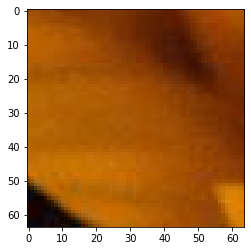

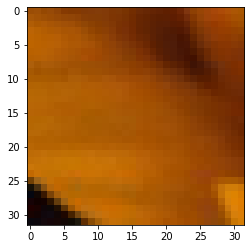

/content/Data_set_Train_x2/640/patch_636_14_6.jpg
/content/Data_set_Train_x2/640/patch_636_8_12.jpg
/content/Data_set_Train_x2/640/patch_636_16_18.jpg
/content/Data_set_Train_x2/640/patch_636_14_11.jpg
/content/Data_set_Train_x2/640/patch_636_5_21.jpg
/content/Data_set_Train_x2/640/patch_636_16_16.jpg
/content/Data_set_Train_x2/640/patch_636_12_15.jpg
/content/Data_set_Train_x2/640/patch_636_11_7.jpg
/content/Data_set_Train_x2/640/patch_636_10_27.jpg
/content/Data_set_Train_x2/640/patch_636_11_25.jpg
/content/Data_set_Train_x2/640/patch_636_3_2.jpg
/content/Data_set_Train_x2/640/patch_636_11_15.jpg
/content/Data_set_Train_x2/640/patch_636_15_0.jpg
/content/Data_set_Train_x2/640/patch_636_18_7.jpg
/content/Data_set_Train_x2/640/patch_636_4_22.jpg
/content/Data_set_Train_x2/640/patch_636_16_20.jpg
/content/Data_set_Train_x2/640/patch_636_14_17.jpg
/content/Data_set_Train_x2/640/patch_636_7_29.jpg
/content/Data_set_Train_x2/640/patch_636_6_29.jpg
/content/Data_set_Train_x2/640/patch_636_1

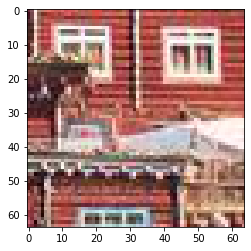

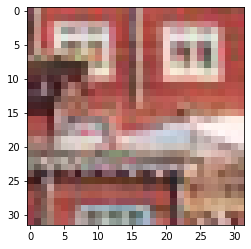

/content/Data_set_Train_x2/640/patch_637_12_16.jpg
/content/Data_set_Train_x2/640/patch_634_17_3.jpg
/content/Data_set_Train_x2/640/patch_634_15_18.jpg
/content/Data_set_Train_x2/640/patch_634_5_5.jpg
/content/Data_set_Train_x2/640/patch_634_18_8.jpg
/content/Data_set_Train_x2/640/patch_634_4_29.jpg
/content/Data_set_Train_x2/640/patch_634_17_16.jpg
/content/Data_set_Train_x2/640/patch_634_13_3.jpg
/content/Data_set_Train_x2/640/patch_634_18_16.jpg
/content/Data_set_Train_x2/640/patch_634_9_4.jpg
/content/Data_set_Train_x2/640/patch_634_9_17.jpg
/content/Data_set_Train_x2/640/patch_634_13_8.jpg
/content/Data_set_Train_x2/640/patch_634_12_19.jpg
/content/Data_set_Train_x2/640/patch_634_18_29.jpg
/content/Data_set_Train_x2/640/patch_634_9_25.jpg
/content/Data_set_Train_x2/640/patch_634_13_9.jpg
/content/Data_set_Train_x2/640/patch_634_12_26.jpg
/content/Data_set_Train_x2/640/patch_634_7_3.jpg
/content/Data_set_Train_x2/640/patch_634_17_19.jpg
/content/Data_set_Train_x2/640/patch_634_7_5.

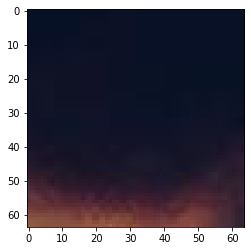

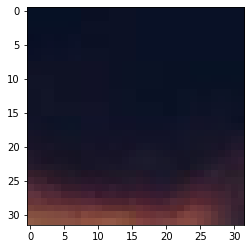

/content/Data_set_Train_x2/640/patch_635_4_18.jpg
/content/Data_set_Train_x2/640/patch_635_12_19.jpg
/content/Data_set_Train_x2/640/patch_635_7_20.jpg
/content/Data_set_Train_x2/640/patch_635_12_23.jpg
/content/Data_set_Train_x2/640/patch_635_5_11.jpg
/content/Data_set_Train_x2/640/patch_635_4_12.jpg
/content/Data_set_Train_x2/640/patch_635_1_29.jpg
/content/Data_set_Train_x2/640/patch_635_14_22.jpg
/content/Data_set_Train_x2/640/patch_635_15_22.jpg
/content/Data_set_Train_x2/640/patch_635_11_15.jpg
/content/Data_set_Train_x2/640/patch_635_6_7.jpg
/content/Data_set_Train_x2/640/patch_635_2_3.jpg
/content/Data_set_Train_x2/640/patch_635_13_12.jpg
/content/Data_set_Train_x2/640/patch_635_11_7.jpg
/content/Data_set_Train_x2/640/patch_635_16_21.jpg
/content/Data_set_Train_x2/640/patch_635_1_26.jpg
/content/Data_set_Train_x2/640/patch_635_2_1.jpg
/content/Data_set_Train_x2/640/patch_635_0_4.jpg
/content/Data_set_Train_x2/640/patch_635_10_27.jpg
/content/Data_set_Train_x2/640/patch_635_8_13.

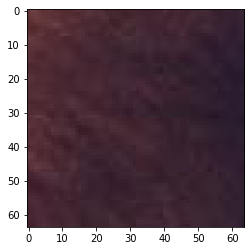

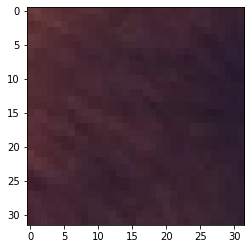

/content/Data_set_Train_x2/640/patch_635_29_2.jpg
/content/Data_set_Train_x2/640/patch_633_1_22.jpg
/content/Data_set_Train_x2/640/patch_633_5_10.jpg
/content/Data_set_Train_x2/640/patch_633_2_20.jpg
/content/Data_set_Train_x2/640/patch_633_11_8.jpg
/content/Data_set_Train_x2/640/patch_632_20_11.jpg
/content/Data_set_Train_x2/640/patch_632_22_18.jpg
/content/Data_set_Train_x2/640/patch_633_9_1.jpg
/content/Data_set_Train_x2/640/patch_633_3_2.jpg
/content/Data_set_Train_x2/640/patch_633_9_8.jpg
/content/Data_set_Train_x2/640/patch_633_9_15.jpg
/content/Data_set_Train_x2/640/patch_633_2_16.jpg
/content/Data_set_Train_x2/640/patch_633_10_13.jpg
/content/Data_set_Train_x2/640/patch_632_23_25.jpg
/content/Data_set_Train_x2/640/patch_632_20_9.jpg
/content/Data_set_Train_x2/640/patch_633_11_11.jpg
/content/Data_set_Train_x2/640/patch_633_4_27.jpg
/content/Data_set_Train_x2/640/patch_633_9_11.jpg
/content/Data_set_Train_x2/640/patch_633_9_2.jpg
/content/Data_set_Train_x2/640/patch_632_23_5.jpg

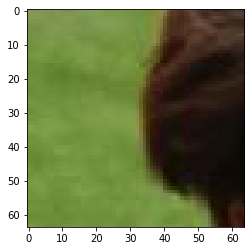

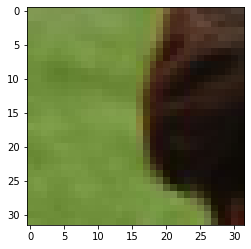

/content/Data_set_Train_x2/640/patch_634_3_13.jpg
/content/Data_set_Train_x2/640/patch_633_13_22.jpg
/content/Data_set_Train_x2/640/patch_633_21_24.jpg
/content/Data_set_Train_x2/640/patch_633_18_18.jpg
/content/Data_set_Train_x2/640/patch_633_21_9.jpg
/content/Data_set_Train_x2/640/patch_633_20_11.jpg
/content/Data_set_Train_x2/640/patch_634_4_1.jpg
/content/Data_set_Train_x2/640/patch_633_23_30.jpg
/content/Data_set_Train_x2/640/patch_633_23_22.jpg
/content/Data_set_Train_x2/640/patch_634_1_15.jpg
/content/Data_set_Train_x2/640/patch_633_14_25.jpg
/content/Data_set_Train_x2/640/patch_633_21_27.jpg
/content/Data_set_Train_x2/640/patch_633_23_18.jpg
/content/Data_set_Train_x2/640/patch_633_19_1.jpg
/content/Data_set_Train_x2/640/patch_634_3_3.jpg
/content/Data_set_Train_x2/640/patch_633_22_11.jpg
/content/Data_set_Train_x2/640/patch_634_0_22.jpg
/content/Data_set_Train_x2/640/patch_633_12_7.jpg
/content/Data_set_Train_x2/640/patch_633_13_28.jpg
/content/Data_set_Train_x2/640/patch_633_

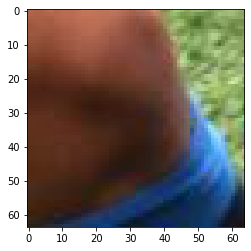

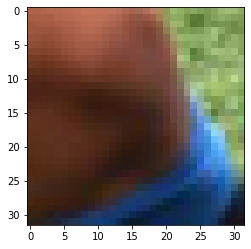

/content/Data_set_Train_x2/640/patch_634_13_18.jpg
/content/Data_set_Train_x2/640/patch_631_20_16.jpg
/content/Data_set_Train_x2/640/patch_631_10_22.jpg
/content/Data_set_Train_x2/640/patch_632_2_17.jpg
/content/Data_set_Train_x2/640/patch_631_14_27.jpg
/content/Data_set_Train_x2/640/patch_632_2_27.jpg
/content/Data_set_Train_x2/640/patch_632_3_13.jpg
/content/Data_set_Train_x2/640/patch_631_11_27.jpg
/content/Data_set_Train_x2/640/patch_631_8_23.jpg
/content/Data_set_Train_x2/640/patch_631_9_13.jpg
/content/Data_set_Train_x2/640/patch_631_19_28.jpg
/content/Data_set_Train_x2/640/patch_631_12_3.jpg
/content/Data_set_Train_x2/640/patch_631_19_24.jpg
/content/Data_set_Train_x2/640/patch_631_17_0.jpg
/content/Data_set_Train_x2/640/patch_631_13_16.jpg
/content/Data_set_Train_x2/640/patch_631_15_25.jpg
/content/Data_set_Train_x2/640/patch_632_1_29.jpg
/content/Data_set_Train_x2/640/patch_631_20_8.jpg
/content/Data_set_Train_x2/640/patch_631_9_9.jpg
/content/Data_set_Train_x2/640/patch_631_1

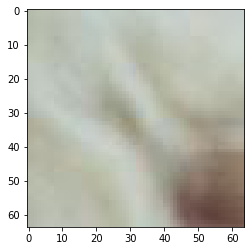

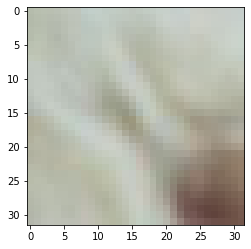

/content/Data_set_Train_x2/640/patch_632_13_27.jpg
/content/Data_set_Train_x2/640/patch_632_5_26.jpg
/content/Data_set_Train_x2/640/patch_632_14_14.jpg
/content/Data_set_Train_x2/640/patch_632_7_30.jpg
/content/Data_set_Train_x2/640/patch_632_19_1.jpg
/content/Data_set_Train_x2/640/patch_632_16_9.jpg
/content/Data_set_Train_x2/640/patch_632_14_22.jpg
/content/Data_set_Train_x2/640/patch_632_14_24.jpg
/content/Data_set_Train_x2/640/patch_632_14_20.jpg
/content/Data_set_Train_x2/640/patch_632_18_17.jpg
/content/Data_set_Train_x2/640/patch_632_6_5.jpg
/content/Data_set_Train_x2/640/patch_632_7_20.jpg
/content/Data_set_Train_x2/640/patch_632_15_15.jpg
/content/Data_set_Train_x2/640/patch_632_5_15.jpg
/content/Data_set_Train_x2/640/patch_632_10_26.jpg
/content/Data_set_Train_x2/640/patch_632_12_5.jpg
/content/Data_set_Train_x2/640/patch_632_12_12.jpg
/content/Data_set_Train_x2/640/patch_632_13_13.jpg
/content/Data_set_Train_x2/640/patch_632_11_11.jpg
/content/Data_set_Train_x2/640/patch_632

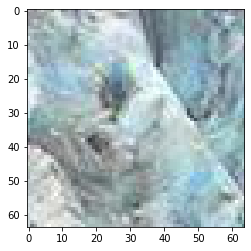

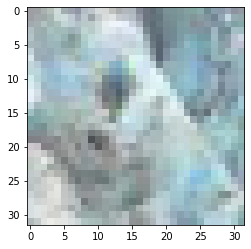

/content/Data_set_Train_x2/640/patch_633_8_20.jpg
/content/Data_set_Train_x2/640/patch_630_5_5.jpg
/content/Data_set_Train_x2/640/patch_630_11_0.jpg
/content/Data_set_Train_x2/640/patch_630_5_3.jpg
/content/Data_set_Train_x2/640/patch_630_8_18.jpg
/content/Data_set_Train_x2/640/patch_630_9_26.jpg
/content/Data_set_Train_x2/640/patch_630_9_5.jpg
/content/Data_set_Train_x2/640/patch_630_4_22.jpg
/content/Data_set_Train_x2/640/patch_630_8_2.jpg
/content/Data_set_Train_x2/640/patch_630_11_14.jpg
/content/Data_set_Train_x2/640/patch_630_0_12.jpg
/content/Data_set_Train_x2/640/patch_630_3_3.jpg
/content/Data_set_Train_x2/640/patch_630_10_9.jpg
/content/Data_set_Train_x2/640/patch_630_7_14.jpg
/content/Data_set_Train_x2/640/patch_630_11_22.jpg
/content/Data_set_Train_x2/640/patch_630_2_11.jpg
/content/Data_set_Train_x2/640/patch_630_4_24.jpg
/content/Data_set_Train_x2/640/patch_630_5_17.jpg
/content/Data_set_Train_x2/640/patch_630_7_25.jpg
/content/Data_set_Train_x2/640/patch_630_0_10.jpg
/co

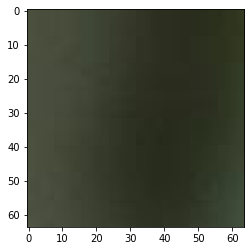

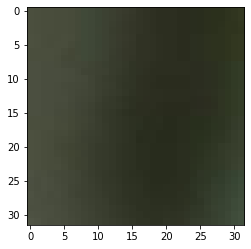

/content/Data_set_Train_x2/640/patch_631_4_4.jpg
/content/Data_set_Train_x2/640/patch_631_5_17.jpg
/content/Data_set_Train_x2/640/patch_630_20_25.jpg
/content/Data_set_Train_x2/640/patch_631_3_12.jpg
/content/Data_set_Train_x2/640/patch_631_5_8.jpg
/content/Data_set_Train_x2/640/patch_630_15_6.jpg
/content/Data_set_Train_x2/640/patch_631_0_6.jpg
/content/Data_set_Train_x2/640/patch_630_18_13.jpg
/content/Data_set_Train_x2/640/patch_631_8_3.jpg
/content/Data_set_Train_x2/640/patch_631_6_8.jpg
/content/Data_set_Train_x2/640/patch_630_20_17.jpg
/content/Data_set_Train_x2/640/patch_631_1_0.jpg
/content/Data_set_Train_x2/640/patch_630_18_30.jpg
/content/Data_set_Train_x2/640/patch_631_1_13.jpg
/content/Data_set_Train_x2/640/patch_631_2_7.jpg
/content/Data_set_Train_x2/640/patch_630_14_11.jpg
/content/Data_set_Train_x2/640/patch_630_16_17.jpg
/content/Data_set_Train_x2/640/patch_630_15_4.jpg
/content/Data_set_Train_x2/640/patch_631_5_27.jpg
/content/Data_set_Train_x2/640/patch_631_4_3.jpg
/c

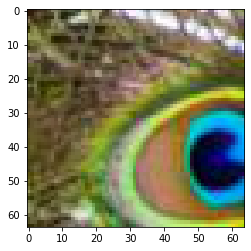

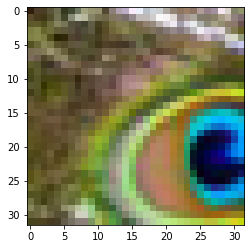

/content/Data_set_Train_x2/650/patch_649_14_6.jpg
/content/Data_set_Train_x2/650/patch_649_10_20.jpg
/content/Data_set_Train_x2/650/patch_649_14_14.jpg
/content/Data_set_Train_x2/650/patch_649_4_11.jpg
/content/Data_set_Train_x2/650/patch_649_13_4.jpg
/content/Data_set_Train_x2/650/patch_649_7_0.jpg
/content/Data_set_Train_x2/650/patch_649_13_22.jpg
/content/Data_set_Train_x2/650/patch_649_11_2.jpg
/content/Data_set_Train_x2/650/patch_649_10_6.jpg
/content/Data_set_Train_x2/650/patch_649_5_14.jpg
/content/Data_set_Train_x2/650/patch_649_9_2.jpg
/content/Data_set_Train_x2/650/patch_649_14_3.jpg
/content/Data_set_Train_x2/650/patch_649_12_21.jpg
/content/Data_set_Train_x2/650/patch_649_5_21.jpg
/content/Data_set_Train_x2/650/patch_649_1_28.jpg
/content/Data_set_Train_x2/650/patch_649_12_2.jpg
/content/Data_set_Train_x2/650/patch_649_6_8.jpg
/content/Data_set_Train_x2/650/patch_649_10_10.jpg
/content/Data_set_Train_x2/650/patch_649_11_0.jpg
/content/Data_set_Train_x2/650/patch_649_6_3.jpg

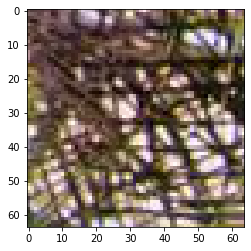

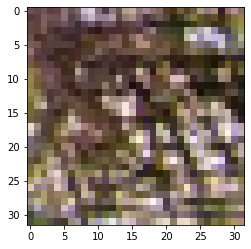

/content/Data_set_Train_x2/650/patch_649_19_29.jpg
/content/Data_set_Train_x2/650/patch_646_17_5.jpg
/content/Data_set_Train_x2/650/patch_647_5_28.jpg
/content/Data_set_Train_x2/650/patch_647_4_28.jpg
/content/Data_set_Train_x2/650/patch_647_9_15.jpg
/content/Data_set_Train_x2/650/patch_647_11_0.jpg
/content/Data_set_Train_x2/650/patch_647_1_29.jpg
/content/Data_set_Train_x2/650/patch_647_0_15.jpg
/content/Data_set_Train_x2/650/patch_647_5_18.jpg
/content/Data_set_Train_x2/650/patch_647_0_8.jpg
/content/Data_set_Train_x2/650/patch_647_6_4.jpg
/content/Data_set_Train_x2/650/patch_647_5_3.jpg
/content/Data_set_Train_x2/650/patch_647_3_13.jpg
/content/Data_set_Train_x2/650/patch_646_20_9.jpg
/content/Data_set_Train_x2/650/patch_646_16_5.jpg
/content/Data_set_Train_x2/650/patch_647_1_28.jpg
/content/Data_set_Train_x2/650/patch_647_2_13.jpg
/content/Data_set_Train_x2/650/patch_647_6_18.jpg
/content/Data_set_Train_x2/650/patch_647_6_19.jpg
/content/Data_set_Train_x2/650/patch_646_16_6.jpg
/c

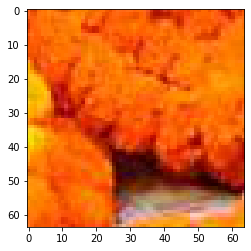

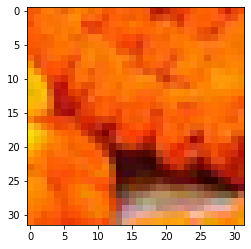

/content/Data_set_Train_x2/650/patch_647_16_21.jpg
/content/Data_set_Train_x2/650/patch_648_3_18.jpg
/content/Data_set_Train_x2/650/patch_647_14_11.jpg
/content/Data_set_Train_x2/650/patch_647_17_27.jpg
/content/Data_set_Train_x2/650/patch_648_2_26.jpg
/content/Data_set_Train_x2/650/patch_647_11_28.jpg
/content/Data_set_Train_x2/650/patch_647_20_11.jpg
/content/Data_set_Train_x2/650/patch_647_19_13.jpg
/content/Data_set_Train_x2/650/patch_647_20_24.jpg
/content/Data_set_Train_x2/650/patch_647_19_21.jpg
/content/Data_set_Train_x2/650/patch_648_1_13.jpg
/content/Data_set_Train_x2/650/patch_648_4_0.jpg
/content/Data_set_Train_x2/650/patch_648_6_2.jpg
/content/Data_set_Train_x2/650/patch_648_2_0.jpg
/content/Data_set_Train_x2/650/patch_647_19_19.jpg
/content/Data_set_Train_x2/650/patch_647_13_25.jpg
/content/Data_set_Train_x2/650/patch_647_13_12.jpg
/content/Data_set_Train_x2/650/patch_647_19_18.jpg
/content/Data_set_Train_x2/650/patch_647_15_21.jpg
/content/Data_set_Train_x2/650/patch_648

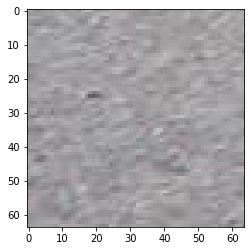

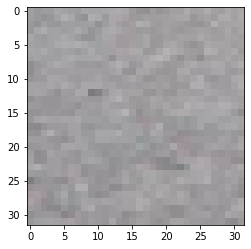

/content/Data_set_Train_x2/650/patch_648_18_8.jpg
/content/Data_set_Train_x2/650/patch_645_22_29.jpg
/content/Data_set_Train_x2/650/patch_645_20_21.jpg
/content/Data_set_Train_x2/650/patch_645_16_4.jpg
/content/Data_set_Train_x2/650/patch_645_21_17.jpg
/content/Data_set_Train_x2/650/patch_645_11_23.jpg
/content/Data_set_Train_x2/650/patch_645_14_28.jpg
/content/Data_set_Train_x2/650/patch_645_9_29.jpg
/content/Data_set_Train_x2/650/patch_645_12_12.jpg
/content/Data_set_Train_x2/650/patch_645_9_12.jpg
/content/Data_set_Train_x2/650/patch_645_18_17.jpg
/content/Data_set_Train_x2/650/patch_645_11_29.jpg
/content/Data_set_Train_x2/650/patch_645_13_22.jpg
/content/Data_set_Train_x2/650/patch_645_8_30.jpg
/content/Data_set_Train_x2/650/patch_645_19_28.jpg
/content/Data_set_Train_x2/650/patch_645_12_11.jpg
/content/Data_set_Train_x2/650/patch_645_19_3.jpg
/content/Data_set_Train_x2/650/patch_645_17_2.jpg
/content/Data_set_Train_x2/650/patch_645_12_27.jpg
/content/Data_set_Train_x2/650/patch_6

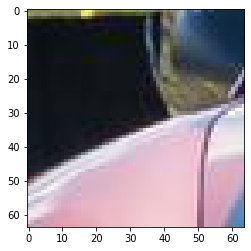

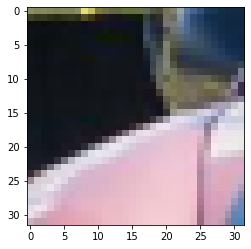

/content/Data_set_Train_x2/650/patch_646_9_11.jpg
/content/Data_set_Train_x2/650/patch_646_7_4.jpg
/content/Data_set_Train_x2/650/patch_646_9_19.jpg
/content/Data_set_Train_x2/650/patch_646_1_27.jpg
/content/Data_set_Train_x2/650/patch_646_3_3.jpg
/content/Data_set_Train_x2/650/patch_646_13_19.jpg
/content/Data_set_Train_x2/650/patch_646_13_24.jpg
/content/Data_set_Train_x2/650/patch_646_14_17.jpg
/content/Data_set_Train_x2/650/patch_646_5_17.jpg
/content/Data_set_Train_x2/650/patch_646_0_16.jpg
/content/Data_set_Train_x2/650/patch_646_8_12.jpg
/content/Data_set_Train_x2/650/patch_646_9_25.jpg
/content/Data_set_Train_x2/650/patch_646_14_20.jpg
/content/Data_set_Train_x2/650/patch_646_5_19.jpg
/content/Data_set_Train_x2/650/patch_646_13_25.jpg
/content/Data_set_Train_x2/650/patch_646_15_17.jpg
/content/Data_set_Train_x2/650/patch_646_10_2.jpg
/content/Data_set_Train_x2/650/patch_646_9_8.jpg
/content/Data_set_Train_x2/650/patch_646_12_16.jpg
/content/Data_set_Train_x2/650/patch_646_6_22.

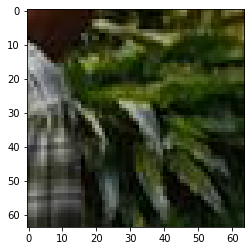

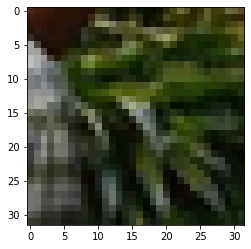

/content/Data_set_Train_x2/650/patch_647_7_19.jpg
/content/Data_set_Train_x2/650/patch_644_4_30.jpg
/content/Data_set_Train_x2/650/patch_644_7_26.jpg
/content/Data_set_Train_x2/650/patch_643_17_4.jpg
/content/Data_set_Train_x2/650/patch_644_6_8.jpg
/content/Data_set_Train_x2/650/patch_643_20_3.jpg
/content/Data_set_Train_x2/650/patch_644_8_23.jpg
/content/Data_set_Train_x2/650/patch_644_8_24.jpg
/content/Data_set_Train_x2/650/patch_644_8_8.jpg
/content/Data_set_Train_x2/650/patch_644_1_18.jpg
/content/Data_set_Train_x2/650/patch_643_17_6.jpg
/content/Data_set_Train_x2/650/patch_644_2_22.jpg
/content/Data_set_Train_x2/650/patch_644_0_19.jpg
/content/Data_set_Train_x2/650/patch_643_17_3.jpg
/content/Data_set_Train_x2/650/patch_644_8_30.jpg
/content/Data_set_Train_x2/650/patch_644_8_27.jpg
/content/Data_set_Train_x2/650/patch_644_2_6.jpg
/content/Data_set_Train_x2/650/patch_644_6_14.jpg
/content/Data_set_Train_x2/650/patch_643_20_19.jpg
/content/Data_set_Train_x2/650/patch_644_2_26.jpg
/c

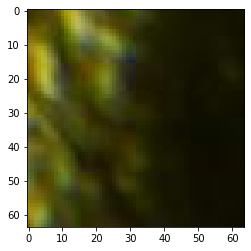

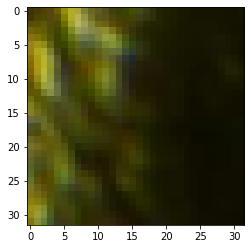

/content/Data_set_Train_x2/650/patch_644_11_30.jpg
/content/Data_set_Train_x2/650/patch_645_5_7.jpg
/content/Data_set_Train_x2/650/patch_645_1_8.jpg
/content/Data_set_Train_x2/650/patch_644_19_25.jpg
/content/Data_set_Train_x2/650/patch_645_6_2.jpg
/content/Data_set_Train_x2/650/patch_645_0_11.jpg
/content/Data_set_Train_x2/650/patch_644_16_1.jpg
/content/Data_set_Train_x2/650/patch_644_18_22.jpg
/content/Data_set_Train_x2/650/patch_644_12_11.jpg
/content/Data_set_Train_x2/650/patch_645_5_0.jpg
/content/Data_set_Train_x2/650/patch_645_5_21.jpg
/content/Data_set_Train_x2/650/patch_645_2_16.jpg
/content/Data_set_Train_x2/650/patch_644_19_20.jpg
/content/Data_set_Train_x2/650/patch_644_19_26.jpg
/content/Data_set_Train_x2/650/patch_645_4_8.jpg
/content/Data_set_Train_x2/650/patch_645_5_5.jpg
/content/Data_set_Train_x2/650/patch_644_15_6.jpg
/content/Data_set_Train_x2/650/patch_644_18_7.jpg
/content/Data_set_Train_x2/650/patch_645_2_20.jpg
/content/Data_set_Train_x2/650/patch_645_5_6.jpg
/

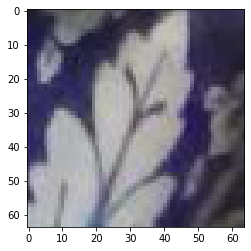

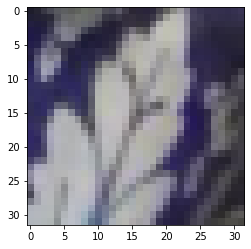

/content/Data_set_Train_x2/650/patch_645_16_22.jpg
/content/Data_set_Train_x2/650/patch_642_10_12.jpg
/content/Data_set_Train_x2/650/patch_642_17_3.jpg
/content/Data_set_Train_x2/650/patch_642_18_6.jpg
/content/Data_set_Train_x2/650/patch_642_19_29.jpg
/content/Data_set_Train_x2/650/patch_642_19_3.jpg
/content/Data_set_Train_x2/650/patch_642_18_22.jpg
/content/Data_set_Train_x2/650/patch_642_23_19.jpg
/content/Data_set_Train_x2/650/patch_642_20_8.jpg
/content/Data_set_Train_x2/650/patch_642_7_24.jpg
/content/Data_set_Train_x2/650/patch_642_11_26.jpg
/content/Data_set_Train_x2/650/patch_642_7_17.jpg
/content/Data_set_Train_x2/650/patch_642_9_19.jpg
/content/Data_set_Train_x2/650/patch_642_9_15.jpg
/content/Data_set_Train_x2/650/patch_642_12_29.jpg
/content/Data_set_Train_x2/650/patch_642_13_28.jpg
/content/Data_set_Train_x2/650/patch_642_23_12.jpg
/content/Data_set_Train_x2/650/patch_642_11_20.jpg
/content/Data_set_Train_x2/650/patch_642_12_1.jpg
/content/Data_set_Train_x2/650/patch_642

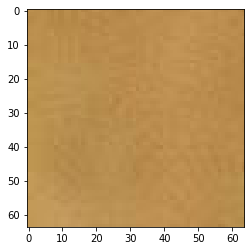

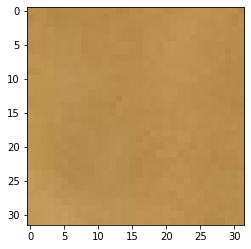

/content/Data_set_Train_x2/650/patch_643_0_12.jpg
/content/Data_set_Train_x2/650/patch_643_2_14.jpg
/content/Data_set_Train_x2/650/patch_643_0_6.jpg
/content/Data_set_Train_x2/650/patch_643_15_9.jpg
/content/Data_set_Train_x2/650/patch_643_4_2.jpg
/content/Data_set_Train_x2/650/patch_643_9_25.jpg
/content/Data_set_Train_x2/650/patch_643_7_16.jpg
/content/Data_set_Train_x2/650/patch_643_10_9.jpg
/content/Data_set_Train_x2/650/patch_643_9_6.jpg
/content/Data_set_Train_x2/650/patch_643_3_25.jpg
/content/Data_set_Train_x2/650/patch_643_9_30.jpg
/content/Data_set_Train_x2/650/patch_643_7_0.jpg
/content/Data_set_Train_x2/650/patch_643_14_3.jpg
/content/Data_set_Train_x2/650/patch_643_6_4.jpg
/content/Data_set_Train_x2/650/patch_642_23_27.jpg
/content/Data_set_Train_x2/650/patch_643_0_30.jpg
/content/Data_set_Train_x2/650/patch_643_12_11.jpg
/content/Data_set_Train_x2/650/patch_643_8_1.jpg
/content/Data_set_Train_x2/650/patch_643_0_16.jpg
/content/Data_set_Train_x2/650/patch_643_4_13.jpg
/con

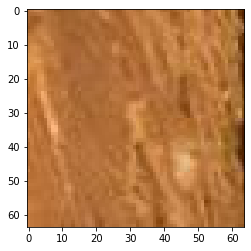

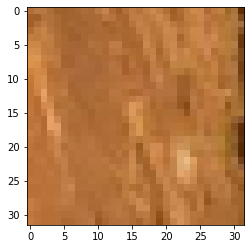

/content/Data_set_Train_x2/650/patch_643_19_19.jpg
/content/Data_set_Train_x2/650/patch_641_5_7.jpg
/content/Data_set_Train_x2/650/patch_641_2_5.jpg
/content/Data_set_Train_x2/650/patch_641_1_28.jpg
/content/Data_set_Train_x2/650/patch_641_0_8.jpg
/content/Data_set_Train_x2/650/patch_641_8_26.jpg
/content/Data_set_Train_x2/650/patch_640_16_4.jpg
/content/Data_set_Train_x2/650/patch_641_3_7.jpg
/content/Data_set_Train_x2/650/patch_641_9_19.jpg
/content/Data_set_Train_x2/650/patch_641_3_29.jpg
/content/Data_set_Train_x2/650/patch_640_16_19.jpg
/content/Data_set_Train_x2/650/patch_640_20_5.jpg
/content/Data_set_Train_x2/650/patch_641_10_30.jpg
/content/Data_set_Train_x2/650/patch_640_20_22.jpg
/content/Data_set_Train_x2/650/patch_641_4_23.jpg
/content/Data_set_Train_x2/650/patch_641_7_7.jpg
/content/Data_set_Train_x2/650/patch_641_9_28.jpg
/content/Data_set_Train_x2/650/patch_641_10_25.jpg
/content/Data_set_Train_x2/650/patch_640_19_26.jpg
/content/Data_set_Train_x2/650/patch_641_10_0.jpg

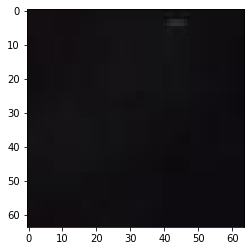

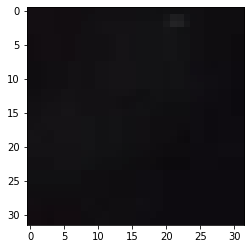

/content/Data_set_Train_x2/650/patch_641_16_26.jpg
/content/Data_set_Train_x2/650/patch_642_5_27.jpg
/content/Data_set_Train_x2/650/patch_641_12_25.jpg
/content/Data_set_Train_x2/650/patch_642_3_17.jpg
/content/Data_set_Train_x2/650/patch_641_18_20.jpg
/content/Data_set_Train_x2/650/patch_641_16_11.jpg
/content/Data_set_Train_x2/650/patch_641_17_21.jpg
/content/Data_set_Train_x2/650/patch_641_19_7.jpg
/content/Data_set_Train_x2/650/patch_641_12_7.jpg
/content/Data_set_Train_x2/650/patch_642_3_5.jpg
/content/Data_set_Train_x2/650/patch_641_13_3.jpg
/content/Data_set_Train_x2/650/patch_641_19_27.jpg
/content/Data_set_Train_x2/650/patch_641_13_30.jpg
/content/Data_set_Train_x2/650/patch_642_0_25.jpg
/content/Data_set_Train_x2/650/patch_642_6_0.jpg
/content/Data_set_Train_x2/650/patch_641_11_20.jpg
/content/Data_set_Train_x2/650/patch_641_15_13.jpg
/content/Data_set_Train_x2/650/patch_642_6_12.jpg
/content/Data_set_Train_x2/650/patch_641_14_1.jpg
/content/Data_set_Train_x2/650/patch_641_18

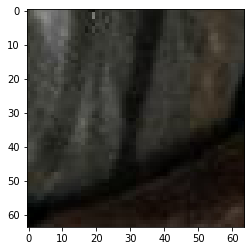

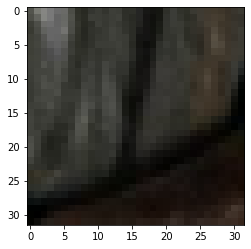

/content/Data_set_Train_x2/650/patch_642_21_11.jpg
/content/Data_set_Train_x2/650/patch_640_6_30.jpg
/content/Data_set_Train_x2/650/patch_640_7_29.jpg
/content/Data_set_Train_x2/650/patch_640_5_8.jpg
/content/Data_set_Train_x2/650/patch_640_9_3.jpg
/content/Data_set_Train_x2/650/patch_640_5_14.jpg
/content/Data_set_Train_x2/650/patch_640_14_1.jpg
/content/Data_set_Train_x2/650/patch_640_6_0.jpg
/content/Data_set_Train_x2/650/patch_640_12_8.jpg
/content/Data_set_Train_x2/650/patch_640_14_10.jpg
/content/Data_set_Train_x2/650/patch_640_11_29.jpg
/content/Data_set_Train_x2/650/patch_640_15_1.jpg
/content/Data_set_Train_x2/650/patch_640_7_3.jpg
/content/Data_set_Train_x2/650/patch_640_7_11.jpg
/content/Data_set_Train_x2/650/patch_640_8_5.jpg
/content/Data_set_Train_x2/650/patch_640_14_6.jpg
/content/Data_set_Train_x2/650/patch_640_3_28.jpg
/content/Data_set_Train_x2/650/patch_640_11_3.jpg
/content/Data_set_Train_x2/650/patch_640_3_2.jpg
/content/Data_set_Train_x2/650/patch_640_2_2.jpg
/con

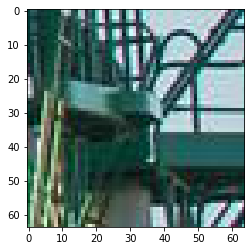

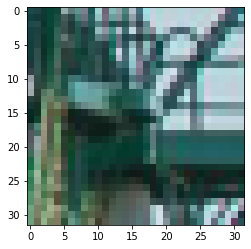

/content/Data_set_Train_x2/650/patch_640_17_30.jpg
/content/Data_set_Train_x2/650/patch_640_18_0.jpg
/content/Data_set_Train_x2/650/patch_640_18_8.jpg
/content/Data_set_Train_x2/650/patch_641_11_1.jpg
/content/Data_set_Train_x2/650/patch_640_17_26.jpg
/content/Data_set_Train_x2/650/patch_641_8_9.jpg
/content/Data_set_Train_x2/650/patch_641_6_22.jpg
/content/Data_set_Train_x2/650/patch_641_1_13.jpg
/content/Data_set_Train_x2/650/patch_641_9_25.jpg
/content/Data_set_Train_x2/650/patch_641_2_2.jpg
/content/Data_set_Train_x2/650/patch_641_1_26.jpg
/content/Data_set_Train_x2/650/patch_640_17_18.jpg
/content/Data_set_Train_x2/650/patch_641_7_6.jpg
/content/Data_set_Train_x2/650/patch_640_19_12.jpg
/content/Data_set_Train_x2/650/patch_641_8_17.jpg
/content/Data_set_Train_x2/650/patch_641_9_1.jpg
/content/Data_set_Train_x2/650/patch_641_5_19.jpg
/content/Data_set_Train_x2/650/patch_640_19_6.jpg
/content/Data_set_Train_x2/650/patch_640_16_17.jpg
/content/Data_set_Train_x2/650/patch_641_8_18.jpg

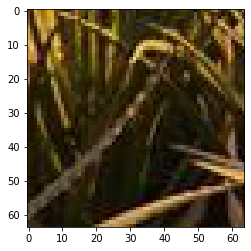

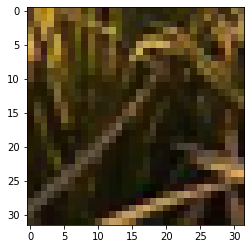

/content/Data_set_Train_x2/660/patch_658_14_10.jpg
/content/Data_set_Train_x2/660/patch_658_8_6.jpg
/content/Data_set_Train_x2/660/patch_659_11_1.jpg
/content/Data_set_Train_x2/660/patch_659_6_0.jpg
/content/Data_set_Train_x2/660/patch_659_10_22.jpg
/content/Data_set_Train_x2/660/patch_659_16_13.jpg
/content/Data_set_Train_x2/660/patch_659_6_30.jpg
/content/Data_set_Train_x2/660/patch_659_3_12.jpg
/content/Data_set_Train_x2/660/patch_659_2_16.jpg
/content/Data_set_Train_x2/660/patch_659_7_29.jpg
/content/Data_set_Train_x2/660/patch_659_11_13.jpg
/content/Data_set_Train_x2/660/patch_659_15_26.jpg
/content/Data_set_Train_x2/660/patch_659_9_21.jpg
/content/Data_set_Train_x2/660/patch_659_6_25.jpg
/content/Data_set_Train_x2/660/patch_659_5_25.jpg
/content/Data_set_Train_x2/660/patch_659_16_29.jpg
/content/Data_set_Train_x2/660/patch_659_4_8.jpg
/content/Data_set_Train_x2/660/patch_659_7_15.jpg
/content/Data_set_Train_x2/660/patch_659_7_25.jpg
/content/Data_set_Train_x2/660/patch_659_13_26.

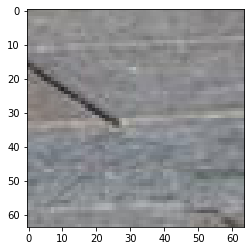

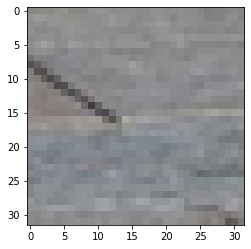

/content/Data_set_Train_x2/660/patch_659_17_19.jpg
/content/Data_set_Train_x2/660/patch_657_1_12.jpg
/content/Data_set_Train_x2/660/patch_657_5_8.jpg
/content/Data_set_Train_x2/660/patch_657_5_26.jpg
/content/Data_set_Train_x2/660/patch_656_20_14.jpg
/content/Data_set_Train_x2/660/patch_656_20_10.jpg
/content/Data_set_Train_x2/660/patch_657_9_1.jpg
/content/Data_set_Train_x2/660/patch_657_4_10.jpg
/content/Data_set_Train_x2/660/patch_657_8_5.jpg
/content/Data_set_Train_x2/660/patch_657_3_16.jpg
/content/Data_set_Train_x2/660/patch_656_17_6.jpg
/content/Data_set_Train_x2/660/patch_657_7_15.jpg
/content/Data_set_Train_x2/660/patch_656_17_17.jpg
/content/Data_set_Train_x2/660/patch_657_5_13.jpg
/content/Data_set_Train_x2/660/patch_657_7_8.jpg
/content/Data_set_Train_x2/660/patch_657_5_10.jpg
/content/Data_set_Train_x2/660/patch_657_7_7.jpg
/content/Data_set_Train_x2/660/patch_656_17_2.jpg
/content/Data_set_Train_x2/660/patch_656_18_7.jpg
/content/Data_set_Train_x2/660/patch_656_18_18.jpg


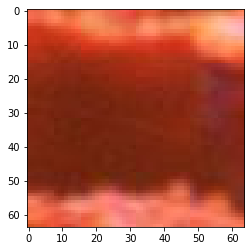

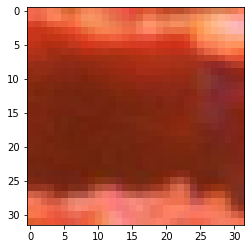

/content/Data_set_Train_x2/660/patch_657_13_26.jpg
/content/Data_set_Train_x2/660/patch_657_11_1.jpg
/content/Data_set_Train_x2/660/patch_658_6_11.jpg
/content/Data_set_Train_x2/660/patch_657_13_28.jpg
/content/Data_set_Train_x2/660/patch_657_18_16.jpg
/content/Data_set_Train_x2/660/patch_657_18_18.jpg
/content/Data_set_Train_x2/660/patch_658_5_14.jpg
/content/Data_set_Train_x2/660/patch_657_11_2.jpg
/content/Data_set_Train_x2/660/patch_657_11_9.jpg
/content/Data_set_Train_x2/660/patch_657_18_24.jpg
/content/Data_set_Train_x2/660/patch_657_13_19.jpg
/content/Data_set_Train_x2/660/patch_657_12_27.jpg
/content/Data_set_Train_x2/660/patch_658_2_13.jpg
/content/Data_set_Train_x2/660/patch_658_2_28.jpg
/content/Data_set_Train_x2/660/patch_657_17_12.jpg
/content/Data_set_Train_x2/660/patch_658_5_26.jpg
/content/Data_set_Train_x2/660/patch_658_5_3.jpg
/content/Data_set_Train_x2/660/patch_657_11_22.jpg
/content/Data_set_Train_x2/660/patch_657_15_26.jpg
/content/Data_set_Train_x2/660/patch_658_

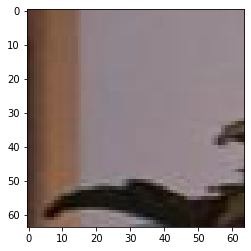

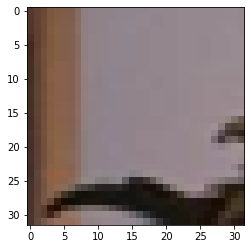

/content/Data_set_Train_x2/660/patch_658_12_0.jpg
/content/Data_set_Train_x2/660/patch_655_13_26.jpg
/content/Data_set_Train_x2/660/patch_655_18_26.jpg
/content/Data_set_Train_x2/660/patch_655_17_29.jpg
/content/Data_set_Train_x2/660/patch_655_19_9.jpg
/content/Data_set_Train_x2/660/patch_655_11_28.jpg
/content/Data_set_Train_x2/660/patch_655_11_11.jpg
/content/Data_set_Train_x2/660/patch_655_8_23.jpg
/content/Data_set_Train_x2/660/patch_655_13_7.jpg
/content/Data_set_Train_x2/660/patch_655_16_8.jpg
/content/Data_set_Train_x2/660/patch_655_15_4.jpg
/content/Data_set_Train_x2/660/patch_655_13_30.jpg
/content/Data_set_Train_x2/660/patch_655_5_9.jpg
/content/Data_set_Train_x2/660/patch_655_8_18.jpg
/content/Data_set_Train_x2/660/patch_655_12_19.jpg
/content/Data_set_Train_x2/660/patch_655_19_10.jpg
/content/Data_set_Train_x2/660/patch_655_15_24.jpg
/content/Data_set_Train_x2/660/patch_655_15_3.jpg
/content/Data_set_Train_x2/660/patch_655_12_17.jpg
/content/Data_set_Train_x2/660/patch_655_

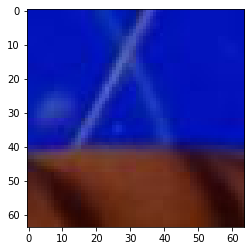

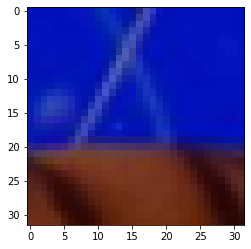

/content/Data_set_Train_x2/660/patch_656_3_16.jpg
/content/Data_set_Train_x2/660/patch_656_13_22.jpg
/content/Data_set_Train_x2/660/patch_656_10_6.jpg
/content/Data_set_Train_x2/660/patch_656_3_17.jpg
/content/Data_set_Train_x2/660/patch_656_2_21.jpg
/content/Data_set_Train_x2/660/patch_656_6_7.jpg
/content/Data_set_Train_x2/660/patch_656_8_30.jpg
/content/Data_set_Train_x2/660/patch_656_12_10.jpg
/content/Data_set_Train_x2/660/patch_656_7_2.jpg
/content/Data_set_Train_x2/660/patch_656_5_19.jpg
/content/Data_set_Train_x2/660/patch_656_13_8.jpg
/content/Data_set_Train_x2/660/patch_656_3_15.jpg
/content/Data_set_Train_x2/660/patch_656_0_5.jpg
/content/Data_set_Train_x2/660/patch_656_2_7.jpg
/content/Data_set_Train_x2/660/patch_656_9_14.jpg
/content/Data_set_Train_x2/660/patch_656_5_11.jpg
/content/Data_set_Train_x2/660/patch_656_9_27.jpg
/content/Data_set_Train_x2/660/patch_656_1_30.jpg
/content/Data_set_Train_x2/660/patch_656_6_4.jpg
/content/Data_set_Train_x2/660/patch_656_8_10.jpg
/co

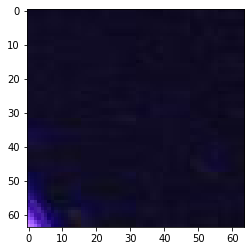

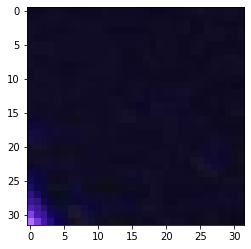

/content/Data_set_Train_x2/660/patch_657_1_26.jpg
/content/Data_set_Train_x2/660/patch_654_2_12.jpg
/content/Data_set_Train_x2/660/patch_653_16_10.jpg
/content/Data_set_Train_x2/660/patch_653_16_19.jpg
/content/Data_set_Train_x2/660/patch_654_1_24.jpg
/content/Data_set_Train_x2/660/patch_654_3_9.jpg
/content/Data_set_Train_x2/660/patch_653_17_0.jpg
/content/Data_set_Train_x2/660/patch_654_1_27.jpg
/content/Data_set_Train_x2/660/patch_653_18_13.jpg
/content/Data_set_Train_x2/660/patch_653_15_8.jpg
/content/Data_set_Train_x2/660/patch_653_14_17.jpg
/content/Data_set_Train_x2/660/patch_654_7_8.jpg
/content/Data_set_Train_x2/660/patch_654_1_2.jpg
/content/Data_set_Train_x2/660/patch_653_20_7.jpg
/content/Data_set_Train_x2/660/patch_653_19_23.jpg
/content/Data_set_Train_x2/660/patch_654_6_21.jpg
/content/Data_set_Train_x2/660/patch_654_2_14.jpg
/content/Data_set_Train_x2/660/patch_653_14_19.jpg
/content/Data_set_Train_x2/660/patch_654_2_29.jpg
/content/Data_set_Train_x2/660/patch_653_16_0.j

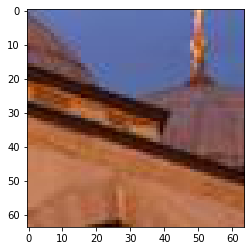

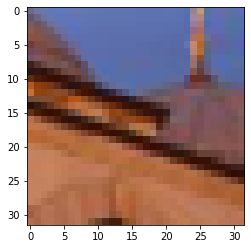

/content/Data_set_Train_x2/660/patch_654_11_6.jpg
/content/Data_set_Train_x2/660/patch_654_13_21.jpg
/content/Data_set_Train_x2/660/patch_654_18_13.jpg
/content/Data_set_Train_x2/660/patch_655_2_4.jpg
/content/Data_set_Train_x2/660/patch_655_0_29.jpg
/content/Data_set_Train_x2/660/patch_654_19_12.jpg
/content/Data_set_Train_x2/660/patch_654_18_29.jpg
/content/Data_set_Train_x2/660/patch_654_19_23.jpg
/content/Data_set_Train_x2/660/patch_654_13_14.jpg
/content/Data_set_Train_x2/660/patch_655_1_17.jpg
/content/Data_set_Train_x2/660/patch_654_14_28.jpg
/content/Data_set_Train_x2/660/patch_654_20_22.jpg
/content/Data_set_Train_x2/660/patch_655_0_11.jpg
/content/Data_set_Train_x2/660/patch_654_20_25.jpg
/content/Data_set_Train_x2/660/patch_654_15_14.jpg
/content/Data_set_Train_x2/660/patch_654_9_6.jpg
/content/Data_set_Train_x2/660/patch_655_2_15.jpg
/content/Data_set_Train_x2/660/patch_654_20_7.jpg
/content/Data_set_Train_x2/660/patch_654_13_30.jpg
/content/Data_set_Train_x2/660/patch_654_

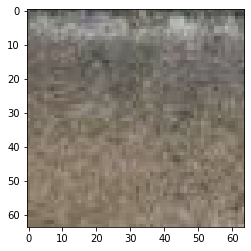

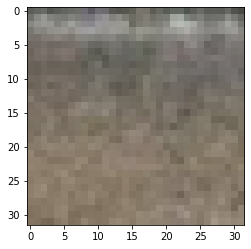

/content/Data_set_Train_x2/660/patch_655_19_1.jpg
/content/Data_set_Train_x2/660/patch_652_16_17.jpg
/content/Data_set_Train_x2/660/patch_652_4_14.jpg
/content/Data_set_Train_x2/660/patch_652_3_29.jpg
/content/Data_set_Train_x2/660/patch_652_14_21.jpg
/content/Data_set_Train_x2/660/patch_652_4_0.jpg
/content/Data_set_Train_x2/660/patch_652_17_1.jpg
/content/Data_set_Train_x2/660/patch_652_8_11.jpg
/content/Data_set_Train_x2/660/patch_652_14_0.jpg
/content/Data_set_Train_x2/660/patch_652_5_12.jpg
/content/Data_set_Train_x2/660/patch_652_15_17.jpg
/content/Data_set_Train_x2/660/patch_652_12_23.jpg
/content/Data_set_Train_x2/660/patch_652_4_16.jpg
/content/Data_set_Train_x2/660/patch_652_11_20.jpg
/content/Data_set_Train_x2/660/patch_652_5_20.jpg
/content/Data_set_Train_x2/660/patch_652_13_17.jpg
/content/Data_set_Train_x2/660/patch_652_12_30.jpg
/content/Data_set_Train_x2/660/patch_652_5_8.jpg
/content/Data_set_Train_x2/660/patch_652_16_20.jpg
/content/Data_set_Train_x2/660/patch_652_17_

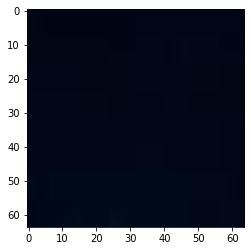

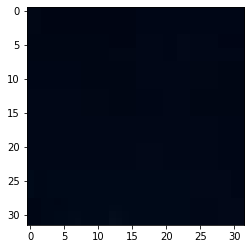

/content/Data_set_Train_x2/660/patch_653_4_7.jpg
/content/Data_set_Train_x2/660/patch_653_9_8.jpg
/content/Data_set_Train_x2/660/patch_653_8_1.jpg
/content/Data_set_Train_x2/660/patch_653_10_12.jpg
/content/Data_set_Train_x2/660/patch_653_0_15.jpg
/content/Data_set_Train_x2/660/patch_653_5_1.jpg
/content/Data_set_Train_x2/660/patch_652_20_24.jpg
/content/Data_set_Train_x2/660/patch_653_10_18.jpg
/content/Data_set_Train_x2/660/patch_652_19_4.jpg
/content/Data_set_Train_x2/660/patch_653_11_1.jpg
/content/Data_set_Train_x2/660/patch_653_12_25.jpg
/content/Data_set_Train_x2/660/patch_653_11_21.jpg
/content/Data_set_Train_x2/660/patch_653_12_1.jpg
/content/Data_set_Train_x2/660/patch_653_9_0.jpg
/content/Data_set_Train_x2/660/patch_653_8_19.jpg
/content/Data_set_Train_x2/660/patch_652_19_25.jpg
/content/Data_set_Train_x2/660/patch_653_6_23.jpg
/content/Data_set_Train_x2/660/patch_653_3_21.jpg
/content/Data_set_Train_x2/660/patch_653_9_14.jpg
/content/Data_set_Train_x2/660/patch_653_3_8.jpg


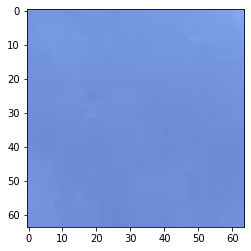

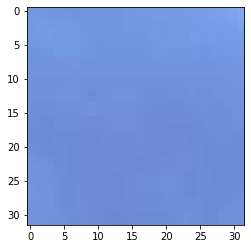

/content/Data_set_Train_x2/660/patch_654_3_2.jpg
/content/Data_set_Train_x2/660/patch_651_6_7.jpg
/content/Data_set_Train_x2/660/patch_651_6_25.jpg
/content/Data_set_Train_x2/660/patch_651_0_15.jpg
/content/Data_set_Train_x2/660/patch_650_12_10.jpg
/content/Data_set_Train_x2/660/patch_650_20_18.jpg
/content/Data_set_Train_x2/660/patch_651_1_13.jpg
/content/Data_set_Train_x2/660/patch_651_2_30.jpg
/content/Data_set_Train_x2/660/patch_651_5_17.jpg
/content/Data_set_Train_x2/660/patch_650_19_6.jpg
/content/Data_set_Train_x2/660/patch_651_3_27.jpg
/content/Data_set_Train_x2/660/patch_650_14_30.jpg
/content/Data_set_Train_x2/660/patch_650_15_20.jpg
/content/Data_set_Train_x2/660/patch_650_20_29.jpg
/content/Data_set_Train_x2/660/patch_651_5_18.jpg
/content/Data_set_Train_x2/660/patch_650_15_12.jpg
/content/Data_set_Train_x2/660/patch_651_2_6.jpg
/content/Data_set_Train_x2/660/patch_651_6_24.jpg
/content/Data_set_Train_x2/660/patch_651_3_26.jpg
/content/Data_set_Train_x2/660/patch_651_5_24.j

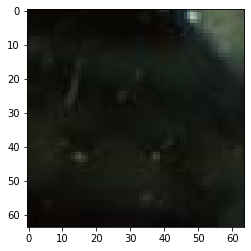

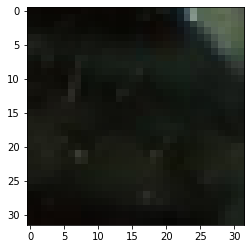

/content/Data_set_Train_x2/660/patch_651_14_12.jpg
/content/Data_set_Train_x2/660/patch_651_16_23.jpg
/content/Data_set_Train_x2/660/patch_652_0_1.jpg
/content/Data_set_Train_x2/660/patch_651_20_9.jpg
/content/Data_set_Train_x2/660/patch_651_15_2.jpg
/content/Data_set_Train_x2/660/patch_651_19_0.jpg
/content/Data_set_Train_x2/660/patch_651_11_18.jpg
/content/Data_set_Train_x2/660/patch_651_16_12.jpg
/content/Data_set_Train_x2/660/patch_651_11_13.jpg
/content/Data_set_Train_x2/660/patch_651_9_25.jpg
/content/Data_set_Train_x2/660/patch_651_7_21.jpg
/content/Data_set_Train_x2/660/patch_651_13_22.jpg
/content/Data_set_Train_x2/660/patch_651_20_5.jpg
/content/Data_set_Train_x2/660/patch_651_16_4.jpg
/content/Data_set_Train_x2/660/patch_651_19_26.jpg
/content/Data_set_Train_x2/660/patch_652_0_13.jpg
/content/Data_set_Train_x2/660/patch_651_17_8.jpg
/content/Data_set_Train_x2/660/patch_651_17_28.jpg
/content/Data_set_Train_x2/660/patch_651_12_12.jpg
/content/Data_set_Train_x2/660/patch_651_2

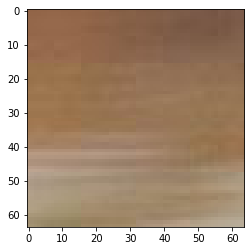

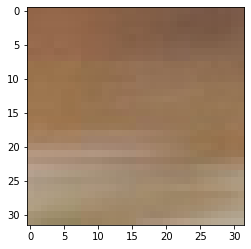

/content/Data_set_Train_x2/660/patch_652_4_7.jpg
/content/Data_set_Train_x2/660/patch_650_2_8.jpg
/content/Data_set_Train_x2/660/patch_650_3_30.jpg
/content/Data_set_Train_x2/660/patch_650_11_3.jpg
/content/Data_set_Train_x2/660/patch_650_9_13.jpg
/content/Data_set_Train_x2/660/patch_650_6_14.jpg
/content/Data_set_Train_x2/660/patch_650_3_1.jpg
/content/Data_set_Train_x2/660/patch_650_5_22.jpg
/content/Data_set_Train_x2/660/patch_650_2_20.jpg
/content/Data_set_Train_x2/660/patch_650_11_5.jpg
/content/Data_set_Train_x2/660/patch_650_5_15.jpg
/content/Data_set_Train_x2/660/patch_650_0_8.jpg
/content/Data_set_Train_x2/660/patch_650_11_28.jpg
/content/Data_set_Train_x2/660/patch_650_6_18.jpg
/content/Data_set_Train_x2/660/patch_650_11_1.jpg
/content/Data_set_Train_x2/660/patch_650_0_23.jpg
/content/Data_set_Train_x2/660/patch_650_6_29.jpg
/content/Data_set_Train_x2/660/patch_650_1_5.jpg
/content/Data_set_Train_x2/660/patch_650_11_30.jpg
/content/Data_set_Train_x2/660/patch_650_10_9.jpg
/co

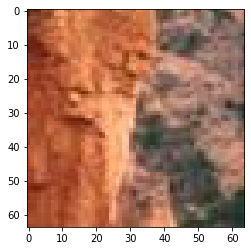

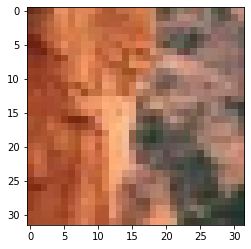

/content/Data_set_Train_x2/670/patch_669_9_12.jpg
/content/Data_set_Train_x2/670/patch_669_3_1.jpg
/content/Data_set_Train_x2/670/patch_668_30_20.jpg
/content/Data_set_Train_x2/670/patch_669_7_3.jpg
/content/Data_set_Train_x2/670/patch_669_7_16.jpg
/content/Data_set_Train_x2/670/patch_669_11_10.jpg
/content/Data_set_Train_x2/670/patch_669_7_29.jpg
/content/Data_set_Train_x2/670/patch_669_0_6.jpg
/content/Data_set_Train_x2/670/patch_669_2_4.jpg
/content/Data_set_Train_x2/670/patch_669_1_6.jpg
/content/Data_set_Train_x2/670/patch_669_10_26.jpg
/content/Data_set_Train_x2/670/patch_669_5_15.jpg
/content/Data_set_Train_x2/670/patch_669_0_5.jpg
/content/Data_set_Train_x2/670/patch_669_8_1.jpg
/content/Data_set_Train_x2/670/patch_669_2_18.jpg
/content/Data_set_Train_x2/670/patch_669_13_12.jpg
/content/Data_set_Train_x2/670/patch_669_3_6.jpg
/content/Data_set_Train_x2/670/patch_669_6_29.jpg
/content/Data_set_Train_x2/670/patch_669_1_17.jpg
/content/Data_set_Train_x2/670/patch_669_11_1.jpg
/con

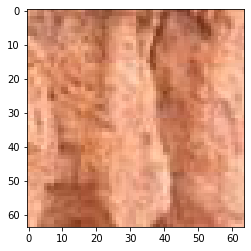

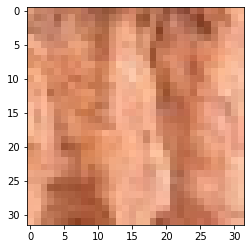

/content/Data_set_Train_x2/670/patch_669_14_19.jpg
/content/Data_set_Train_x2/670/patch_667_2_30.jpg
/content/Data_set_Train_x2/670/patch_667_12_3.jpg
/content/Data_set_Train_x2/670/patch_667_5_5.jpg
/content/Data_set_Train_x2/670/patch_667_13_23.jpg
/content/Data_set_Train_x2/670/patch_667_14_14.jpg
/content/Data_set_Train_x2/670/patch_667_12_21.jpg
/content/Data_set_Train_x2/670/patch_667_10_26.jpg
/content/Data_set_Train_x2/670/patch_667_0_23.jpg
/content/Data_set_Train_x2/670/patch_667_11_30.jpg
/content/Data_set_Train_x2/670/patch_667_0_14.jpg
/content/Data_set_Train_x2/670/patch_667_9_23.jpg
/content/Data_set_Train_x2/670/patch_667_12_2.jpg
/content/Data_set_Train_x2/670/patch_667_12_17.jpg
/content/Data_set_Train_x2/670/patch_667_9_29.jpg
/content/Data_set_Train_x2/670/patch_667_2_16.jpg
/content/Data_set_Train_x2/670/patch_667_6_29.jpg
/content/Data_set_Train_x2/670/patch_667_5_26.jpg
/content/Data_set_Train_x2/670/patch_667_4_11.jpg
/content/Data_set_Train_x2/670/patch_667_7_1

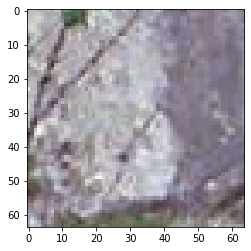

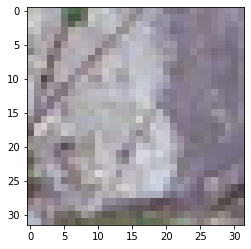

/content/Data_set_Train_x2/670/patch_667_24_21.jpg
/content/Data_set_Train_x2/670/patch_667_26_7.jpg
/content/Data_set_Train_x2/670/patch_667_26_8.jpg
/content/Data_set_Train_x2/670/patch_667_16_19.jpg
/content/Data_set_Train_x2/670/patch_667_21_7.jpg
/content/Data_set_Train_x2/670/patch_668_0_12.jpg
/content/Data_set_Train_x2/670/patch_667_21_10.jpg
/content/Data_set_Train_x2/670/patch_667_29_26.jpg
/content/Data_set_Train_x2/670/patch_667_16_25.jpg
/content/Data_set_Train_x2/670/patch_667_18_22.jpg
/content/Data_set_Train_x2/670/patch_667_18_10.jpg
/content/Data_set_Train_x2/670/patch_667_25_30.jpg
/content/Data_set_Train_x2/670/patch_667_18_26.jpg
/content/Data_set_Train_x2/670/patch_667_24_26.jpg
/content/Data_set_Train_x2/670/patch_667_23_17.jpg
/content/Data_set_Train_x2/670/patch_667_26_29.jpg
/content/Data_set_Train_x2/670/patch_667_24_23.jpg
/content/Data_set_Train_x2/670/patch_667_28_26.jpg
/content/Data_set_Train_x2/670/patch_667_28_8.jpg
/content/Data_set_Train_x2/670/patch

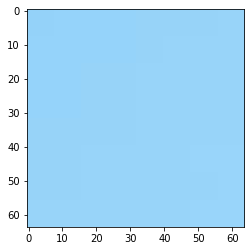

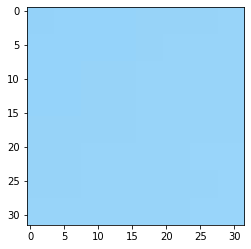

/content/Data_set_Train_x2/670/patch_668_17_5.jpg
/content/Data_set_Train_x2/670/patch_665_20_16.jpg
/content/Data_set_Train_x2/670/patch_665_15_25.jpg
/content/Data_set_Train_x2/670/patch_665_9_26.jpg
/content/Data_set_Train_x2/670/patch_665_20_6.jpg
/content/Data_set_Train_x2/670/patch_665_14_12.jpg
/content/Data_set_Train_x2/670/patch_666_2_3.jpg
/content/Data_set_Train_x2/670/patch_666_2_15.jpg
/content/Data_set_Train_x2/670/patch_665_16_3.jpg
/content/Data_set_Train_x2/670/patch_665_17_23.jpg
/content/Data_set_Train_x2/670/patch_665_17_20.jpg
/content/Data_set_Train_x2/670/patch_666_3_22.jpg
/content/Data_set_Train_x2/670/patch_665_10_10.jpg
/content/Data_set_Train_x2/670/patch_665_11_8.jpg
/content/Data_set_Train_x2/670/patch_665_11_15.jpg
/content/Data_set_Train_x2/670/patch_665_20_24.jpg
/content/Data_set_Train_x2/670/patch_666_3_18.jpg
/content/Data_set_Train_x2/670/patch_665_20_7.jpg
/content/Data_set_Train_x2/670/patch_665_20_10.jpg
/content/Data_set_Train_x2/670/patch_666_3

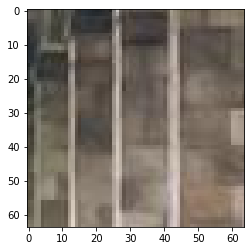

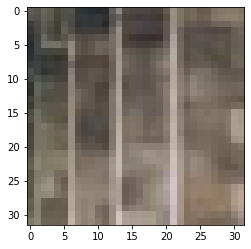

/content/Data_set_Train_x2/670/patch_666_9_17.jpg
/content/Data_set_Train_x2/670/patch_666_16_4.jpg
/content/Data_set_Train_x2/670/patch_666_17_13.jpg
/content/Data_set_Train_x2/670/patch_666_5_29.jpg
/content/Data_set_Train_x2/670/patch_666_11_30.jpg
/content/Data_set_Train_x2/670/patch_666_20_3.jpg
/content/Data_set_Train_x2/670/patch_666_5_18.jpg
/content/Data_set_Train_x2/670/patch_666_10_29.jpg
/content/Data_set_Train_x2/670/patch_666_14_21.jpg
/content/Data_set_Train_x2/670/patch_666_7_22.jpg
/content/Data_set_Train_x2/670/patch_666_14_17.jpg
/content/Data_set_Train_x2/670/patch_666_16_5.jpg
/content/Data_set_Train_x2/670/patch_666_8_14.jpg
/content/Data_set_Train_x2/670/patch_666_14_18.jpg
/content/Data_set_Train_x2/670/patch_666_7_3.jpg
/content/Data_set_Train_x2/670/patch_666_8_10.jpg
/content/Data_set_Train_x2/670/patch_666_6_30.jpg
/content/Data_set_Train_x2/670/patch_666_11_10.jpg
/content/Data_set_Train_x2/670/patch_666_7_11.jpg
/content/Data_set_Train_x2/670/patch_666_17_

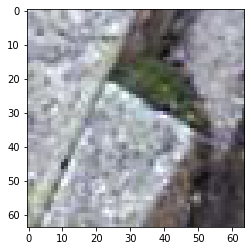

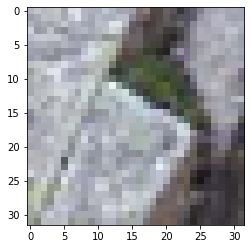

/content/Data_set_Train_x2/670/patch_667_5_28.jpg
/content/Data_set_Train_x2/670/patch_664_13_8.jpg
/content/Data_set_Train_x2/670/patch_664_3_6.jpg
/content/Data_set_Train_x2/670/patch_664_7_30.jpg
/content/Data_set_Train_x2/670/patch_663_19_9.jpg
/content/Data_set_Train_x2/670/patch_663_19_18.jpg
/content/Data_set_Train_x2/670/patch_664_13_24.jpg
/content/Data_set_Train_x2/670/patch_663_19_27.jpg
/content/Data_set_Train_x2/670/patch_664_13_21.jpg
/content/Data_set_Train_x2/670/patch_664_7_15.jpg
/content/Data_set_Train_x2/670/patch_664_3_1.jpg
/content/Data_set_Train_x2/670/patch_664_13_1.jpg
/content/Data_set_Train_x2/670/patch_664_6_1.jpg
/content/Data_set_Train_x2/670/patch_664_1_21.jpg
/content/Data_set_Train_x2/670/patch_664_5_1.jpg
/content/Data_set_Train_x2/670/patch_663_20_9.jpg
/content/Data_set_Train_x2/670/patch_664_0_29.jpg
/content/Data_set_Train_x2/670/patch_664_13_4.jpg
/content/Data_set_Train_x2/670/patch_664_9_29.jpg
/content/Data_set_Train_x2/670/patch_664_6_23.jpg


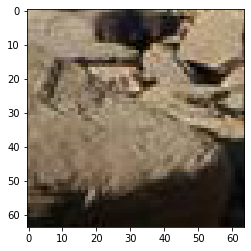

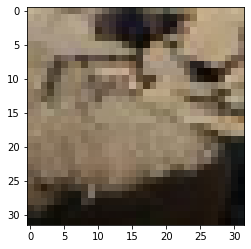

/content/Data_set_Train_x2/670/patch_664_17_10.jpg
/content/Data_set_Train_x2/670/patch_665_5_9.jpg
/content/Data_set_Train_x2/670/patch_664_14_28.jpg
/content/Data_set_Train_x2/670/patch_664_19_18.jpg
/content/Data_set_Train_x2/670/patch_665_8_27.jpg
/content/Data_set_Train_x2/670/patch_664_18_14.jpg
/content/Data_set_Train_x2/670/patch_665_3_26.jpg
/content/Data_set_Train_x2/670/patch_664_16_16.jpg
/content/Data_set_Train_x2/670/patch_665_3_21.jpg
/content/Data_set_Train_x2/670/patch_665_5_17.jpg
/content/Data_set_Train_x2/670/patch_665_2_26.jpg
/content/Data_set_Train_x2/670/patch_664_16_29.jpg
/content/Data_set_Train_x2/670/patch_664_20_5.jpg
/content/Data_set_Train_x2/670/patch_664_16_27.jpg
/content/Data_set_Train_x2/670/patch_665_6_18.jpg
/content/Data_set_Train_x2/670/patch_664_20_13.jpg
/content/Data_set_Train_x2/670/patch_664_15_2.jpg
/content/Data_set_Train_x2/670/patch_664_15_15.jpg
/content/Data_set_Train_x2/670/patch_665_3_15.jpg
/content/Data_set_Train_x2/670/patch_665_2

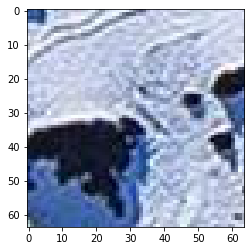

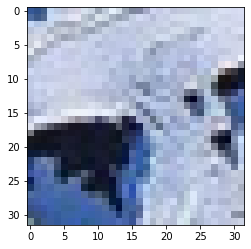

/content/Data_set_Train_x2/670/patch_665_14_11.jpg
/content/Data_set_Train_x2/670/patch_662_9_28.jpg
/content/Data_set_Train_x2/670/patch_662_8_7.jpg
/content/Data_set_Train_x2/670/patch_662_11_20.jpg
/content/Data_set_Train_x2/670/patch_662_9_16.jpg
/content/Data_set_Train_x2/670/patch_662_10_17.jpg
/content/Data_set_Train_x2/670/patch_662_7_27.jpg
/content/Data_set_Train_x2/670/patch_662_9_29.jpg
/content/Data_set_Train_x2/670/patch_663_0_14.jpg
/content/Data_set_Train_x2/670/patch_662_10_27.jpg
/content/Data_set_Train_x2/670/patch_662_9_22.jpg
/content/Data_set_Train_x2/670/patch_662_18_19.jpg
/content/Data_set_Train_x2/670/patch_662_11_15.jpg
/content/Data_set_Train_x2/670/patch_662_15_3.jpg
/content/Data_set_Train_x2/670/patch_662_12_5.jpg
/content/Data_set_Train_x2/670/patch_662_16_16.jpg
/content/Data_set_Train_x2/670/patch_662_11_26.jpg
/content/Data_set_Train_x2/670/patch_662_10_8.jpg
/content/Data_set_Train_x2/670/patch_662_16_30.jpg
/content/Data_set_Train_x2/670/patch_662_1

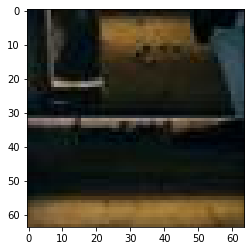

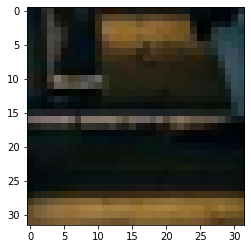

/content/Data_set_Train_x2/670/patch_663_11_18.jpg
/content/Data_set_Train_x2/670/patch_663_7_17.jpg
/content/Data_set_Train_x2/670/patch_663_12_4.jpg
/content/Data_set_Train_x2/670/patch_663_10_20.jpg
/content/Data_set_Train_x2/670/patch_663_4_7.jpg
/content/Data_set_Train_x2/670/patch_663_15_2.jpg
/content/Data_set_Train_x2/670/patch_663_3_26.jpg
/content/Data_set_Train_x2/670/patch_663_4_4.jpg
/content/Data_set_Train_x2/670/patch_663_12_21.jpg
/content/Data_set_Train_x2/670/patch_663_17_13.jpg
/content/Data_set_Train_x2/670/patch_663_9_7.jpg
/content/Data_set_Train_x2/670/patch_663_2_29.jpg
/content/Data_set_Train_x2/670/patch_663_14_10.jpg
/content/Data_set_Train_x2/670/patch_663_8_12.jpg
/content/Data_set_Train_x2/670/patch_663_18_9.jpg
/content/Data_set_Train_x2/670/patch_663_12_25.jpg
/content/Data_set_Train_x2/670/patch_663_3_19.jpg
/content/Data_set_Train_x2/670/patch_663_7_28.jpg
/content/Data_set_Train_x2/670/patch_663_16_28.jpg
/content/Data_set_Train_x2/670/patch_663_3_1.j

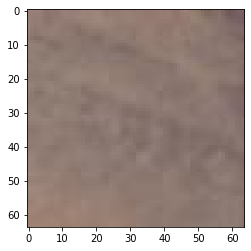

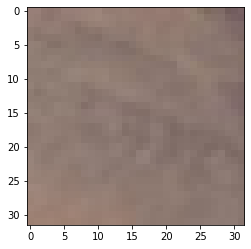

/content/Data_set_Train_x2/670/patch_664_10_29.jpg
/content/Data_set_Train_x2/670/patch_660_18_23.jpg
/content/Data_set_Train_x2/670/patch_661_5_8.jpg
/content/Data_set_Train_x2/670/patch_661_2_4.jpg
/content/Data_set_Train_x2/670/patch_661_5_26.jpg
/content/Data_set_Train_x2/670/patch_661_1_24.jpg
/content/Data_set_Train_x2/670/patch_661_2_3.jpg
/content/Data_set_Train_x2/670/patch_661_2_0.jpg
/content/Data_set_Train_x2/670/patch_661_1_28.jpg
/content/Data_set_Train_x2/670/patch_661_5_22.jpg
/content/Data_set_Train_x2/670/patch_661_2_5.jpg
/content/Data_set_Train_x2/670/patch_660_18_10.jpg
/content/Data_set_Train_x2/670/patch_660_19_21.jpg
/content/Data_set_Train_x2/670/patch_661_3_3.jpg
/content/Data_set_Train_x2/670/patch_661_7_14.jpg
/content/Data_set_Train_x2/670/patch_661_5_18.jpg
/content/Data_set_Train_x2/670/patch_660_16_25.jpg
/content/Data_set_Train_x2/670/patch_661_2_23.jpg
/content/Data_set_Train_x2/670/patch_661_0_19.jpg
/content/Data_set_Train_x2/670/patch_660_20_26.jpg


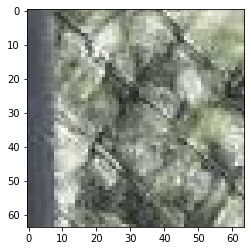

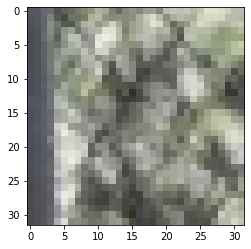

/content/Data_set_Train_x2/670/patch_662_4_27.jpg
/content/Data_set_Train_x2/670/patch_661_12_21.jpg
/content/Data_set_Train_x2/670/patch_661_19_18.jpg
/content/Data_set_Train_x2/670/patch_661_18_1.jpg
/content/Data_set_Train_x2/670/patch_661_16_18.jpg
/content/Data_set_Train_x2/670/patch_661_15_0.jpg
/content/Data_set_Train_x2/670/patch_661_17_27.jpg
/content/Data_set_Train_x2/670/patch_661_18_24.jpg
/content/Data_set_Train_x2/670/patch_662_2_2.jpg
/content/Data_set_Train_x2/670/patch_662_2_7.jpg
/content/Data_set_Train_x2/670/patch_661_18_6.jpg
/content/Data_set_Train_x2/670/patch_661_11_13.jpg
/content/Data_set_Train_x2/670/patch_662_3_26.jpg
/content/Data_set_Train_x2/670/patch_661_13_11.jpg
/content/Data_set_Train_x2/670/patch_661_19_7.jpg
/content/Data_set_Train_x2/670/patch_661_13_22.jpg
/content/Data_set_Train_x2/670/patch_661_12_15.jpg
/content/Data_set_Train_x2/670/patch_661_20_28.jpg
/content/Data_set_Train_x2/670/patch_662_6_5.jpg
/content/Data_set_Train_x2/670/patch_661_12

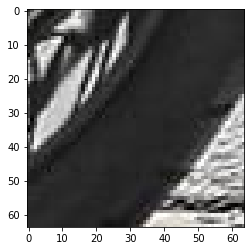

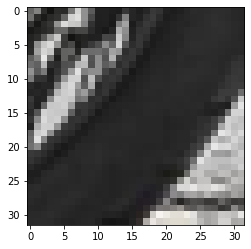

/content/Data_set_Train_x2/670/patch_662_17_17.jpg
/content/Data_set_Train_x2/670/patch_660_0_21.jpg
/content/Data_set_Train_x2/670/patch_660_5_22.jpg
/content/Data_set_Train_x2/670/patch_660_15_22.jpg
/content/Data_set_Train_x2/670/patch_660_6_4.jpg
/content/Data_set_Train_x2/670/patch_660_11_30.jpg
/content/Data_set_Train_x2/670/patch_660_2_4.jpg
/content/Data_set_Train_x2/670/patch_660_13_29.jpg
/content/Data_set_Train_x2/670/patch_660_9_17.jpg
/content/Data_set_Train_x2/670/patch_660_11_11.jpg
/content/Data_set_Train_x2/670/patch_660_7_17.jpg
/content/Data_set_Train_x2/670/patch_660_7_3.jpg
/content/Data_set_Train_x2/670/patch_660_3_23.jpg
/content/Data_set_Train_x2/670/patch_660_14_14.jpg
/content/Data_set_Train_x2/670/patch_660_8_15.jpg
/content/Data_set_Train_x2/670/patch_660_1_6.jpg
/content/Data_set_Train_x2/670/patch_660_0_16.jpg
/content/Data_set_Train_x2/670/patch_660_10_25.jpg
/content/Data_set_Train_x2/670/patch_660_10_7.jpg
/content/Data_set_Train_x2/670/patch_660_2_28.j

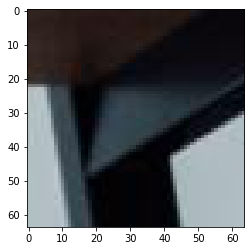

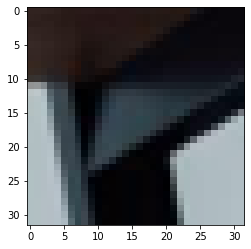

/content/Data_set_Train_x2/670/patch_661_2_21.jpg
/content/Data_set_Train_x2/670/patch_661_5_29.jpg
/content/Data_set_Train_x2/670/patch_660_15_24.jpg
/content/Data_set_Train_x2/670/patch_660_16_22.jpg
/content/Data_set_Train_x2/670/patch_661_8_6.jpg
/content/Data_set_Train_x2/670/patch_661_4_26.jpg
/content/Data_set_Train_x2/670/patch_661_0_25.jpg
/content/Data_set_Train_x2/670/patch_661_10_2.jpg
/content/Data_set_Train_x2/670/patch_660_17_2.jpg
/content/Data_set_Train_x2/670/patch_661_7_27.jpg
/content/Data_set_Train_x2/670/patch_661_5_11.jpg
/content/Data_set_Train_x2/670/patch_661_7_21.jpg
/content/Data_set_Train_x2/670/patch_660_16_10.jpg
/content/Data_set_Train_x2/670/patch_661_0_16.jpg
/content/Data_set_Train_x2/670/patch_661_7_18.jpg
/content/Data_set_Train_x2/670/patch_660_15_30.jpg
/content/Data_set_Train_x2/670/patch_661_11_1.jpg
/content/Data_set_Train_x2/670/patch_661_10_28.jpg
/content/Data_set_Train_x2/670/patch_661_1_16.jpg
/content/Data_set_Train_x2/670/patch_660_17_29

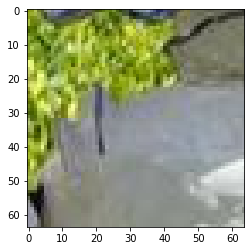

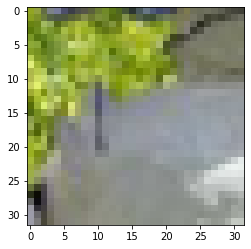

/content/Data_set_Train_x2/680/patch_679_6_11.jpg
/content/Data_set_Train_x2/680/patch_679_0_25.jpg
/content/Data_set_Train_x2/680/patch_679_8_20.jpg
/content/Data_set_Train_x2/680/patch_679_14_30.jpg
/content/Data_set_Train_x2/680/patch_679_0_22.jpg
/content/Data_set_Train_x2/680/patch_679_6_27.jpg
/content/Data_set_Train_x2/680/patch_679_2_25.jpg
/content/Data_set_Train_x2/680/patch_679_9_21.jpg
/content/Data_set_Train_x2/680/patch_679_9_19.jpg
/content/Data_set_Train_x2/680/patch_679_7_7.jpg
/content/Data_set_Train_x2/680/patch_679_14_12.jpg
/content/Data_set_Train_x2/680/patch_679_13_27.jpg
/content/Data_set_Train_x2/680/patch_678_20_15.jpg
/content/Data_set_Train_x2/680/patch_679_0_17.jpg
/content/Data_set_Train_x2/680/patch_679_10_7.jpg
/content/Data_set_Train_x2/680/patch_679_9_29.jpg
/content/Data_set_Train_x2/680/patch_679_6_30.jpg
/content/Data_set_Train_x2/680/patch_679_10_21.jpg
/content/Data_set_Train_x2/680/patch_679_7_10.jpg
/content/Data_set_Train_x2/680/patch_679_8_15.

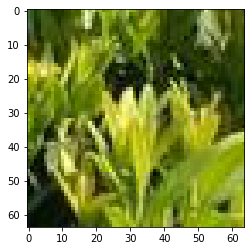

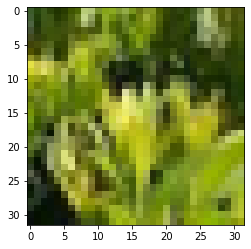

/content/Data_set_Train_x2/680/patch_679_16_17.jpg
/content/Data_set_Train_x2/680/patch_677_0_13.jpg
/content/Data_set_Train_x2/680/patch_677_1_4.jpg
/content/Data_set_Train_x2/680/patch_677_2_4.jpg
/content/Data_set_Train_x2/680/patch_677_6_25.jpg
/content/Data_set_Train_x2/680/patch_676_16_19.jpg
/content/Data_set_Train_x2/680/patch_677_5_17.jpg
/content/Data_set_Train_x2/680/patch_677_6_12.jpg
/content/Data_set_Train_x2/680/patch_677_0_29.jpg
/content/Data_set_Train_x2/680/patch_677_1_9.jpg
/content/Data_set_Train_x2/680/patch_677_1_29.jpg
/content/Data_set_Train_x2/680/patch_676_20_16.jpg
/content/Data_set_Train_x2/680/patch_676_20_24.jpg
/content/Data_set_Train_x2/680/patch_677_2_25.jpg
/content/Data_set_Train_x2/680/patch_676_12_29.jpg
/content/Data_set_Train_x2/680/patch_676_19_25.jpg
/content/Data_set_Train_x2/680/patch_677_2_10.jpg
/content/Data_set_Train_x2/680/patch_677_4_15.jpg
/content/Data_set_Train_x2/680/patch_676_17_28.jpg
/content/Data_set_Train_x2/680/patch_677_5_20.

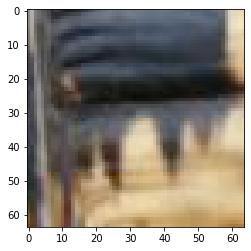

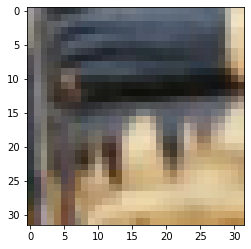

/content/Data_set_Train_x2/680/patch_677_10_11.jpg
/content/Data_set_Train_x2/680/patch_677_16_15.jpg
/content/Data_set_Train_x2/680/patch_678_0_3.jpg
/content/Data_set_Train_x2/680/patch_677_9_2.jpg
/content/Data_set_Train_x2/680/patch_677_13_30.jpg
/content/Data_set_Train_x2/680/patch_677_19_13.jpg
/content/Data_set_Train_x2/680/patch_677_8_0.jpg
/content/Data_set_Train_x2/680/patch_677_17_28.jpg
/content/Data_set_Train_x2/680/patch_677_19_25.jpg
/content/Data_set_Train_x2/680/patch_677_8_17.jpg
/content/Data_set_Train_x2/680/patch_677_12_7.jpg
/content/Data_set_Train_x2/680/patch_678_2_15.jpg
/content/Data_set_Train_x2/680/patch_677_11_8.jpg
/content/Data_set_Train_x2/680/patch_678_1_12.jpg
/content/Data_set_Train_x2/680/patch_677_16_3.jpg
/content/Data_set_Train_x2/680/patch_677_10_16.jpg
/content/Data_set_Train_x2/680/patch_678_0_0.jpg
/content/Data_set_Train_x2/680/patch_677_8_11.jpg
/content/Data_set_Train_x2/680/patch_677_12_24.jpg
/content/Data_set_Train_x2/680/patch_677_14_0.

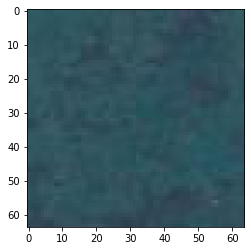

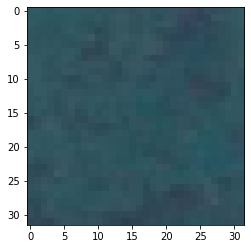

/content/Data_set_Train_x2/680/patch_678_7_12.jpg
/content/Data_set_Train_x2/680/patch_675_2_6.jpg
/content/Data_set_Train_x2/680/patch_675_1_24.jpg
/content/Data_set_Train_x2/680/patch_675_11_12.jpg
/content/Data_set_Train_x2/680/patch_675_3_7.jpg
/content/Data_set_Train_x2/680/patch_675_2_14.jpg
/content/Data_set_Train_x2/680/patch_675_2_10.jpg
/content/Data_set_Train_x2/680/patch_675_6_16.jpg
/content/Data_set_Train_x2/680/patch_675_1_19.jpg
/content/Data_set_Train_x2/680/patch_674_17_3.jpg
/content/Data_set_Train_x2/680/patch_675_5_30.jpg
/content/Data_set_Train_x2/680/patch_675_9_16.jpg
/content/Data_set_Train_x2/680/patch_675_4_8.jpg
/content/Data_set_Train_x2/680/patch_675_10_9.jpg
/content/Data_set_Train_x2/680/patch_675_7_24.jpg
/content/Data_set_Train_x2/680/patch_674_17_19.jpg
/content/Data_set_Train_x2/680/patch_675_4_20.jpg
/content/Data_set_Train_x2/680/patch_675_10_26.jpg
/content/Data_set_Train_x2/680/patch_675_3_8.jpg
/content/Data_set_Train_x2/680/patch_675_0_5.jpg
/c

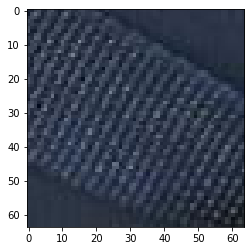

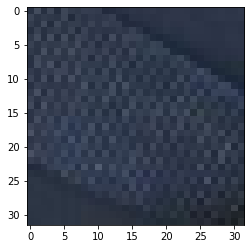

/content/Data_set_Train_x2/680/patch_676_4_22.jpg
/content/Data_set_Train_x2/680/patch_675_14_25.jpg
/content/Data_set_Train_x2/680/patch_676_0_23.jpg
/content/Data_set_Train_x2/680/patch_676_7_30.jpg
/content/Data_set_Train_x2/680/patch_675_12_17.jpg
/content/Data_set_Train_x2/680/patch_675_15_11.jpg
/content/Data_set_Train_x2/680/patch_676_11_2.jpg
/content/Data_set_Train_x2/680/patch_676_1_20.jpg
/content/Data_set_Train_x2/680/patch_676_6_0.jpg
/content/Data_set_Train_x2/680/patch_676_2_7.jpg
/content/Data_set_Train_x2/680/patch_675_14_9.jpg
/content/Data_set_Train_x2/680/patch_676_8_14.jpg
/content/Data_set_Train_x2/680/patch_676_6_22.jpg
/content/Data_set_Train_x2/680/patch_676_1_27.jpg
/content/Data_set_Train_x2/680/patch_676_10_23.jpg
/content/Data_set_Train_x2/680/patch_676_12_10.jpg
/content/Data_set_Train_x2/680/patch_676_2_13.jpg
/content/Data_set_Train_x2/680/patch_676_11_6.jpg
/content/Data_set_Train_x2/680/patch_676_0_5.jpg
/content/Data_set_Train_x2/680/patch_676_8_13.jp

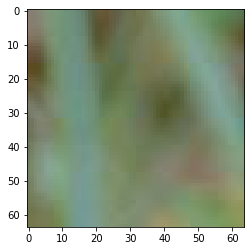

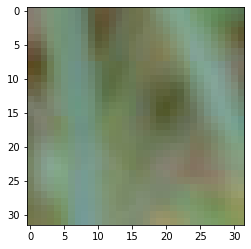

/content/Data_set_Train_x2/680/patch_677_1_24.jpg
/content/Data_set_Train_x2/680/patch_673_12_25.jpg
/content/Data_set_Train_x2/680/patch_673_4_22.jpg
/content/Data_set_Train_x2/680/patch_673_13_5.jpg
/content/Data_set_Train_x2/680/patch_673_14_28.jpg
/content/Data_set_Train_x2/680/patch_673_6_20.jpg
/content/Data_set_Train_x2/680/patch_673_18_23.jpg
/content/Data_set_Train_x2/680/patch_673_4_11.jpg
/content/Data_set_Train_x2/680/patch_673_7_27.jpg
/content/Data_set_Train_x2/680/patch_673_18_20.jpg
/content/Data_set_Train_x2/680/patch_673_4_26.jpg
/content/Data_set_Train_x2/680/patch_673_17_9.jpg
/content/Data_set_Train_x2/680/patch_673_12_2.jpg
/content/Data_set_Train_x2/680/patch_673_7_23.jpg
/content/Data_set_Train_x2/680/patch_673_11_11.jpg
/content/Data_set_Train_x2/680/patch_673_15_11.jpg
/content/Data_set_Train_x2/680/patch_673_9_10.jpg
/content/Data_set_Train_x2/680/patch_673_5_30.jpg
/content/Data_set_Train_x2/680/patch_673_18_17.jpg
/content/Data_set_Train_x2/680/patch_673_13

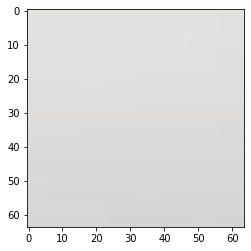

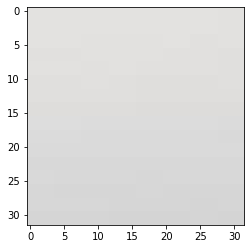

/content/Data_set_Train_x2/680/patch_674_0_14.jpg
/content/Data_set_Train_x2/680/patch_674_7_21.jpg
/content/Data_set_Train_x2/680/patch_674_13_1.jpg
/content/Data_set_Train_x2/680/patch_674_4_2.jpg
/content/Data_set_Train_x2/680/patch_674_6_18.jpg
/content/Data_set_Train_x2/680/patch_674_7_22.jpg
/content/Data_set_Train_x2/680/patch_674_10_28.jpg
/content/Data_set_Train_x2/680/patch_674_9_12.jpg
/content/Data_set_Train_x2/680/patch_674_0_23.jpg
/content/Data_set_Train_x2/680/patch_674_11_19.jpg
/content/Data_set_Train_x2/680/patch_673_19_24.jpg
/content/Data_set_Train_x2/680/patch_674_4_13.jpg
/content/Data_set_Train_x2/680/patch_673_20_29.jpg
/content/Data_set_Train_x2/680/patch_674_6_11.jpg
/content/Data_set_Train_x2/680/patch_674_6_24.jpg
/content/Data_set_Train_x2/680/patch_673_19_17.jpg
/content/Data_set_Train_x2/680/patch_673_19_18.jpg
/content/Data_set_Train_x2/680/patch_674_10_7.jpg
/content/Data_set_Train_x2/680/patch_674_13_2.jpg
/content/Data_set_Train_x2/680/patch_674_3_21

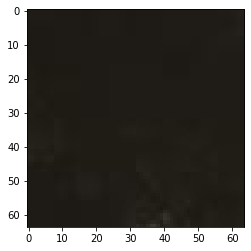

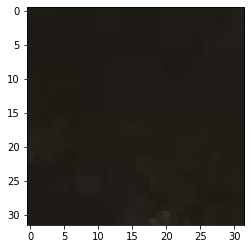

/content/Data_set_Train_x2/680/patch_675_7_0.jpg
/content/Data_set_Train_x2/680/patch_672_2_15.jpg
/content/Data_set_Train_x2/680/patch_672_5_6.jpg
/content/Data_set_Train_x2/680/patch_671_11_18.jpg
/content/Data_set_Train_x2/680/patch_671_7_7.jpg
/content/Data_set_Train_x2/680/patch_671_8_27.jpg
/content/Data_set_Train_x2/680/patch_671_6_28.jpg
/content/Data_set_Train_x2/680/patch_672_4_3.jpg
/content/Data_set_Train_x2/680/patch_672_0_8.jpg
/content/Data_set_Train_x2/680/patch_672_6_4.jpg
/content/Data_set_Train_x2/680/patch_672_4_23.jpg
/content/Data_set_Train_x2/680/patch_671_6_26.jpg
/content/Data_set_Train_x2/680/patch_672_0_24.jpg
/content/Data_set_Train_x2/680/patch_672_1_11.jpg
/content/Data_set_Train_x2/680/patch_672_4_30.jpg
/content/Data_set_Train_x2/680/patch_672_2_3.jpg
/content/Data_set_Train_x2/680/patch_671_11_0.jpg
/content/Data_set_Train_x2/680/patch_672_6_10.jpg
/content/Data_set_Train_x2/680/patch_672_4_18.jpg
/content/Data_set_Train_x2/680/patch_672_7_23.jpg
/conte

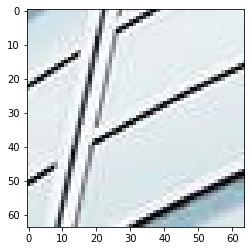

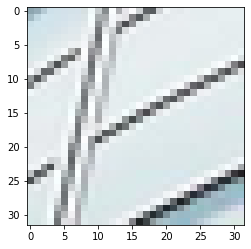

/content/Data_set_Train_x2/680/patch_672_15_15.jpg
/content/Data_set_Train_x2/680/patch_672_17_2.jpg
/content/Data_set_Train_x2/680/patch_672_14_4.jpg
/content/Data_set_Train_x2/680/patch_672_18_15.jpg
/content/Data_set_Train_x2/680/patch_672_19_13.jpg
/content/Data_set_Train_x2/680/patch_672_16_18.jpg
/content/Data_set_Train_x2/680/patch_672_20_22.jpg
/content/Data_set_Train_x2/680/patch_673_1_13.jpg
/content/Data_set_Train_x2/680/patch_673_2_10.jpg
/content/Data_set_Train_x2/680/patch_672_16_9.jpg
/content/Data_set_Train_x2/680/patch_672_16_19.jpg
/content/Data_set_Train_x2/680/patch_672_18_2.jpg
/content/Data_set_Train_x2/680/patch_672_15_28.jpg
/content/Data_set_Train_x2/680/patch_672_15_18.jpg
/content/Data_set_Train_x2/680/patch_672_19_10.jpg
/content/Data_set_Train_x2/680/patch_672_18_21.jpg
/content/Data_set_Train_x2/680/patch_672_20_25.jpg
/content/Data_set_Train_x2/680/patch_673_3_4.jpg
/content/Data_set_Train_x2/680/patch_673_2_5.jpg
/content/Data_set_Train_x2/680/patch_672_

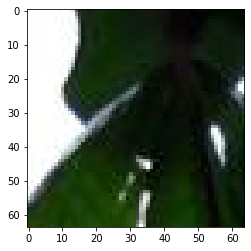

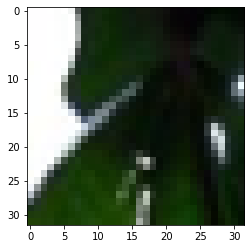

/content/Data_set_Train_x2/680/patch_673_6_30.jpg
/content/Data_set_Train_x2/680/patch_670_11_18.jpg
/content/Data_set_Train_x2/680/patch_670_12_17.jpg
/content/Data_set_Train_x2/680/patch_670_13_15.jpg
/content/Data_set_Train_x2/680/patch_670_7_18.jpg
/content/Data_set_Train_x2/680/patch_670_2_12.jpg
/content/Data_set_Train_x2/680/patch_670_12_16.jpg
/content/Data_set_Train_x2/680/patch_670_7_17.jpg
/content/Data_set_Train_x2/680/patch_670_5_0.jpg
/content/Data_set_Train_x2/680/patch_670_9_18.jpg
/content/Data_set_Train_x2/680/patch_670_9_6.jpg
/content/Data_set_Train_x2/680/patch_670_2_16.jpg
/content/Data_set_Train_x2/680/patch_670_1_11.jpg
/content/Data_set_Train_x2/680/patch_670_1_17.jpg
/content/Data_set_Train_x2/680/patch_670_5_3.jpg
/content/Data_set_Train_x2/680/patch_670_5_15.jpg
/content/Data_set_Train_x2/680/patch_670_11_19.jpg
/content/Data_set_Train_x2/680/patch_670_13_3.jpg
/content/Data_set_Train_x2/680/patch_670_1_19.jpg
/content/Data_set_Train_x2/680/patch_670_7_8.jpg

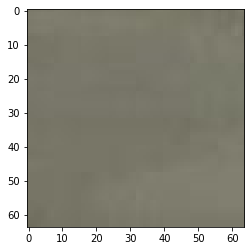

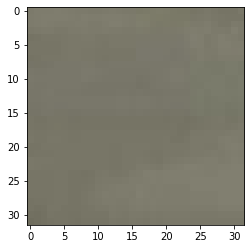

/content/Data_set_Train_x2/680/patch_670_29_5.jpg
/content/Data_set_Train_x2/680/patch_670_18_8.jpg
/content/Data_set_Train_x2/680/patch_670_17_5.jpg
/content/Data_set_Train_x2/680/patch_670_28_20.jpg
/content/Data_set_Train_x2/680/patch_670_29_16.jpg
/content/Data_set_Train_x2/680/patch_671_2_10.jpg
/content/Data_set_Train_x2/680/patch_670_14_2.jpg
/content/Data_set_Train_x2/680/patch_671_3_24.jpg
/content/Data_set_Train_x2/680/patch_670_17_17.jpg
/content/Data_set_Train_x2/680/patch_670_21_12.jpg
/content/Data_set_Train_x2/680/patch_670_17_7.jpg
/content/Data_set_Train_x2/680/patch_671_4_19.jpg
/content/Data_set_Train_x2/680/patch_670_27_17.jpg
/content/Data_set_Train_x2/680/patch_670_23_5.jpg
/content/Data_set_Train_x2/680/patch_671_2_16.jpg
/content/Data_set_Train_x2/680/patch_670_16_14.jpg
/content/Data_set_Train_x2/680/patch_670_22_14.jpg
/content/Data_set_Train_x2/680/patch_671_3_20.jpg
/content/Data_set_Train_x2/680/patch_670_29_8.jpg
/content/Data_set_Train_x2/680/patch_670_16

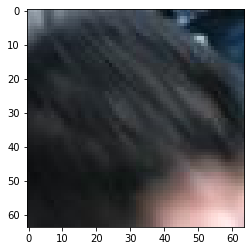

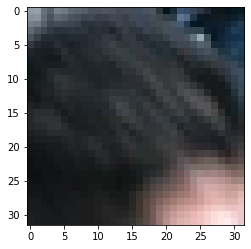

/content/Data_set_Train_x2/680/patch_671_9_16.jpg
/content/Data_set_Train_x2/680/patch_670_10_13.jpg
/content/Data_set_Train_x2/680/patch_670_4_7.jpg
/content/Data_set_Train_x2/680/patch_670_9_12.jpg
/content/Data_set_Train_x2/680/patch_670_13_8.jpg
/content/Data_set_Train_x2/680/patch_670_6_9.jpg
/content/Data_set_Train_x2/680/patch_670_4_19.jpg
/content/Data_set_Train_x2/680/patch_670_4_20.jpg
/content/Data_set_Train_x2/680/patch_670_9_0.jpg
/content/Data_set_Train_x2/680/patch_670_13_12.jpg
/content/Data_set_Train_x2/680/patch_670_4_14.jpg
/content/Data_set_Train_x2/680/patch_670_11_15.jpg
/content/Data_set_Train_x2/680/patch_670_2_9.jpg
/content/Data_set_Train_x2/680/patch_670_3_15.jpg
/content/Data_set_Train_x2/680/patch_670_3_9.jpg
6355
/content/Data_set_Train_x2/690/patch_687_12_2.jpg
/content/Data_set_Train_x2/690/patch_687_14_10.jpg
/content/Data_set_Train_x2/690/patch_687_13_29.jpg
/content/Data_set_Train_x2/690/patch_688_1_16.jpg
/content/Data_set_Train_x2/690/patch_687_15_2

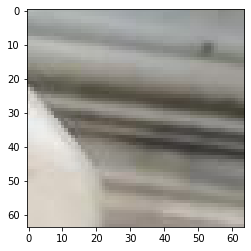

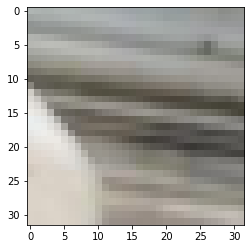

/content/Data_set_Train_x2/690/patch_688_13_16.jpg
/content/Data_set_Train_x2/690/patch_688_27_20.jpg
/content/Data_set_Train_x2/690/patch_688_26_20.jpg
/content/Data_set_Train_x2/690/patch_688_19_2.jpg
/content/Data_set_Train_x2/690/patch_688_25_0.jpg
/content/Data_set_Train_x2/690/patch_688_12_13.jpg
/content/Data_set_Train_x2/690/patch_688_26_5.jpg
/content/Data_set_Train_x2/690/patch_688_19_8.jpg
/content/Data_set_Train_x2/690/patch_688_15_9.jpg
/content/Data_set_Train_x2/690/patch_688_26_15.jpg
/content/Data_set_Train_x2/690/patch_688_30_10.jpg
/content/Data_set_Train_x2/690/patch_688_17_4.jpg
/content/Data_set_Train_x2/690/patch_688_29_0.jpg
/content/Data_set_Train_x2/690/patch_688_24_2.jpg
/content/Data_set_Train_x2/690/patch_688_21_11.jpg
/content/Data_set_Train_x2/690/patch_688_15_1.jpg
/content/Data_set_Train_x2/690/patch_688_16_0.jpg
/content/Data_set_Train_x2/690/patch_688_8_10.jpg
/content/Data_set_Train_x2/690/patch_688_25_15.jpg
/content/Data_set_Train_x2/690/patch_688_1

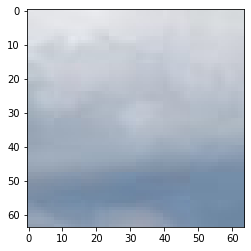

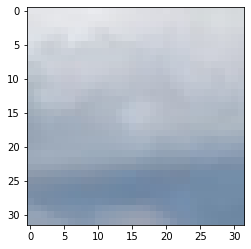

/content/Data_set_Train_x2/690/patch_689_5_28.jpg
/content/Data_set_Train_x2/690/patch_686_4_11.jpg
/content/Data_set_Train_x2/690/patch_686_1_1.jpg
/content/Data_set_Train_x2/690/patch_686_12_13.jpg
/content/Data_set_Train_x2/690/patch_685_19_14.jpg
/content/Data_set_Train_x2/690/patch_686_2_30.jpg
/content/Data_set_Train_x2/690/patch_686_4_19.jpg
/content/Data_set_Train_x2/690/patch_686_9_19.jpg
/content/Data_set_Train_x2/690/patch_686_11_26.jpg
/content/Data_set_Train_x2/690/patch_686_9_6.jpg
/content/Data_set_Train_x2/690/patch_686_1_5.jpg
/content/Data_set_Train_x2/690/patch_686_4_25.jpg
/content/Data_set_Train_x2/690/patch_686_7_28.jpg
/content/Data_set_Train_x2/690/patch_686_2_24.jpg
/content/Data_set_Train_x2/690/patch_686_10_22.jpg
/content/Data_set_Train_x2/690/patch_686_8_1.jpg
/content/Data_set_Train_x2/690/patch_686_6_29.jpg
/content/Data_set_Train_x2/690/patch_686_3_18.jpg
/content/Data_set_Train_x2/690/patch_685_20_0.jpg
/content/Data_set_Train_x2/690/patch_686_3_4.jpg
/

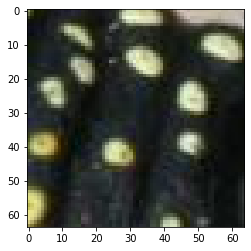

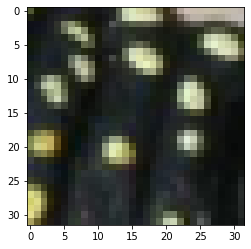

/content/Data_set_Train_x2/690/patch_687_9_13.jpg
/content/Data_set_Train_x2/690/patch_686_19_18.jpg
/content/Data_set_Train_x2/690/patch_687_6_10.jpg
/content/Data_set_Train_x2/690/patch_686_17_26.jpg
/content/Data_set_Train_x2/690/patch_687_2_11.jpg
/content/Data_set_Train_x2/690/patch_687_2_4.jpg
/content/Data_set_Train_x2/690/patch_687_9_16.jpg
/content/Data_set_Train_x2/690/patch_686_19_26.jpg
/content/Data_set_Train_x2/690/patch_687_1_24.jpg
/content/Data_set_Train_x2/690/patch_686_18_14.jpg
/content/Data_set_Train_x2/690/patch_686_19_0.jpg
/content/Data_set_Train_x2/690/patch_686_20_25.jpg
/content/Data_set_Train_x2/690/patch_687_2_22.jpg
/content/Data_set_Train_x2/690/patch_687_4_18.jpg
/content/Data_set_Train_x2/690/patch_687_3_25.jpg
/content/Data_set_Train_x2/690/patch_687_7_24.jpg
/content/Data_set_Train_x2/690/patch_687_0_15.jpg
/content/Data_set_Train_x2/690/patch_686_18_16.jpg
/content/Data_set_Train_x2/690/patch_687_8_1.jpg
/content/Data_set_Train_x2/690/patch_686_18_24

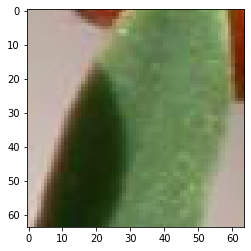

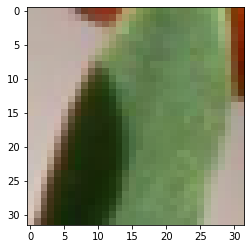

/content/Data_set_Train_x2/690/patch_687_11_4.jpg
/content/Data_set_Train_x2/690/patch_685_9_16.jpg
/content/Data_set_Train_x2/690/patch_685_17_30.jpg
/content/Data_set_Train_x2/690/patch_685_14_5.jpg
/content/Data_set_Train_x2/690/patch_685_16_12.jpg
/content/Data_set_Train_x2/690/patch_685_5_11.jpg
/content/Data_set_Train_x2/690/patch_685_16_30.jpg
/content/Data_set_Train_x2/690/patch_685_18_7.jpg
/content/Data_set_Train_x2/690/patch_685_14_10.jpg
/content/Data_set_Train_x2/690/patch_685_11_20.jpg
/content/Data_set_Train_x2/690/patch_685_5_18.jpg
/content/Data_set_Train_x2/690/patch_685_15_7.jpg
/content/Data_set_Train_x2/690/patch_685_13_22.jpg
/content/Data_set_Train_x2/690/patch_685_7_1.jpg
/content/Data_set_Train_x2/690/patch_685_8_14.jpg
/content/Data_set_Train_x2/690/patch_685_18_10.jpg
/content/Data_set_Train_x2/690/patch_685_3_22.jpg
/content/Data_set_Train_x2/690/patch_685_17_23.jpg
/content/Data_set_Train_x2/690/patch_685_6_26.jpg
/content/Data_set_Train_x2/690/patch_685_10

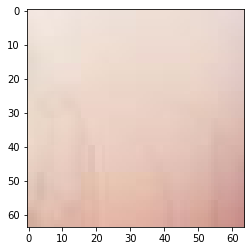

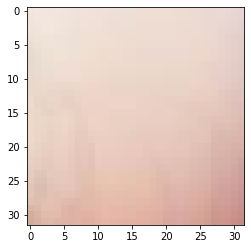

/content/Data_set_Train_x2/690/patch_686_10_23.jpg
/content/Data_set_Train_x2/690/patch_686_5_7.jpg
/content/Data_set_Train_x2/690/patch_685_20_20.jpg
/content/Data_set_Train_x2/690/patch_686_8_30.jpg
/content/Data_set_Train_x2/690/patch_686_11_13.jpg
/content/Data_set_Train_x2/690/patch_686_4_0.jpg
/content/Data_set_Train_x2/690/patch_686_0_17.jpg
/content/Data_set_Train_x2/690/patch_686_13_8.jpg
/content/Data_set_Train_x2/690/patch_686_9_29.jpg
/content/Data_set_Train_x2/690/patch_686_7_13.jpg
/content/Data_set_Train_x2/690/patch_686_7_29.jpg
/content/Data_set_Train_x2/690/patch_686_1_27.jpg
/content/Data_set_Train_x2/690/patch_686_11_28.jpg
/content/Data_set_Train_x2/690/patch_686_0_1.jpg
/content/Data_set_Train_x2/690/patch_686_8_4.jpg
/content/Data_set_Train_x2/690/patch_686_5_27.jpg
/content/Data_set_Train_x2/690/patch_686_6_28.jpg
/content/Data_set_Train_x2/690/patch_686_7_2.jpg
/content/Data_set_Train_x2/690/patch_686_4_28.jpg
/content/Data_set_Train_x2/690/patch_686_10_12.jpg


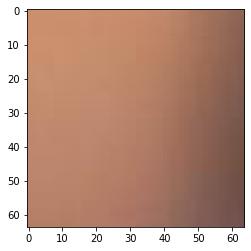

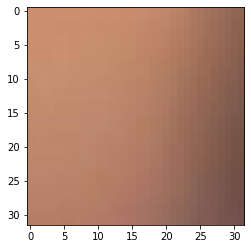

/content/Data_set_Train_x2/690/patch_686_6_10.jpg
/content/Data_set_Train_x2/690/patch_684_9_23.jpg
/content/Data_set_Train_x2/690/patch_684_4_19.jpg
/content/Data_set_Train_x2/690/patch_684_1_13.jpg
/content/Data_set_Train_x2/690/patch_683_15_27.jpg
/content/Data_set_Train_x2/690/patch_684_9_10.jpg
/content/Data_set_Train_x2/690/patch_684_3_18.jpg
/content/Data_set_Train_x2/690/patch_684_5_14.jpg
/content/Data_set_Train_x2/690/patch_684_12_17.jpg
/content/Data_set_Train_x2/690/patch_684_0_4.jpg
/content/Data_set_Train_x2/690/patch_683_18_15.jpg
/content/Data_set_Train_x2/690/patch_684_4_13.jpg
/content/Data_set_Train_x2/690/patch_684_10_17.jpg
/content/Data_set_Train_x2/690/patch_683_20_8.jpg
/content/Data_set_Train_x2/690/patch_684_10_21.jpg
/content/Data_set_Train_x2/690/patch_684_5_2.jpg
/content/Data_set_Train_x2/690/patch_684_9_11.jpg
/content/Data_set_Train_x2/690/patch_683_17_9.jpg
/content/Data_set_Train_x2/690/patch_683_18_0.jpg
/content/Data_set_Train_x2/690/patch_683_17_8.j

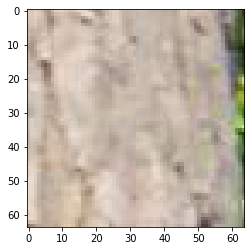

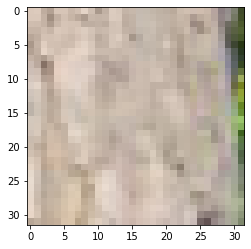

/content/Data_set_Train_x2/690/patch_684_14_21.jpg
/content/Data_set_Train_x2/690/patch_684_24_16.jpg
/content/Data_set_Train_x2/690/patch_684_24_10.jpg
/content/Data_set_Train_x2/690/patch_684_14_11.jpg
/content/Data_set_Train_x2/690/patch_684_24_21.jpg
/content/Data_set_Train_x2/690/patch_685_0_18.jpg
/content/Data_set_Train_x2/690/patch_684_26_12.jpg
/content/Data_set_Train_x2/690/patch_684_20_6.jpg
/content/Data_set_Train_x2/690/patch_684_14_13.jpg
/content/Data_set_Train_x2/690/patch_684_15_7.jpg
/content/Data_set_Train_x2/690/patch_684_20_20.jpg
/content/Data_set_Train_x2/690/patch_684_18_14.jpg
/content/Data_set_Train_x2/690/patch_684_28_15.jpg
/content/Data_set_Train_x2/690/patch_684_30_10.jpg
/content/Data_set_Train_x2/690/patch_684_15_1.jpg
/content/Data_set_Train_x2/690/patch_684_21_22.jpg
/content/Data_set_Train_x2/690/patch_685_0_28.jpg
/content/Data_set_Train_x2/690/patch_684_21_9.jpg
/content/Data_set_Train_x2/690/patch_684_20_3.jpg
/content/Data_set_Train_x2/690/patch_6

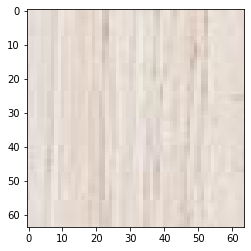

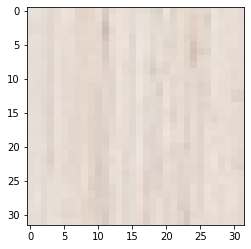

/content/Data_set_Train_x2/690/patch_685_12_6.jpg
/content/Data_set_Train_x2/690/patch_682_11_7.jpg
/content/Data_set_Train_x2/690/patch_682_5_13.jpg
/content/Data_set_Train_x2/690/patch_682_12_2.jpg
/content/Data_set_Train_x2/690/patch_682_4_23.jpg
/content/Data_set_Train_x2/690/patch_682_7_0.jpg
/content/Data_set_Train_x2/690/patch_682_11_2.jpg
/content/Data_set_Train_x2/690/patch_682_16_1.jpg
/content/Data_set_Train_x2/690/patch_682_12_18.jpg
/content/Data_set_Train_x2/690/patch_682_15_24.jpg
/content/Data_set_Train_x2/690/patch_682_10_14.jpg
/content/Data_set_Train_x2/690/patch_682_5_8.jpg
/content/Data_set_Train_x2/690/patch_682_11_6.jpg
/content/Data_set_Train_x2/690/patch_682_16_17.jpg
/content/Data_set_Train_x2/690/patch_682_4_3.jpg
/content/Data_set_Train_x2/690/patch_682_15_14.jpg
/content/Data_set_Train_x2/690/patch_682_5_29.jpg
/content/Data_set_Train_x2/690/patch_682_6_17.jpg
/content/Data_set_Train_x2/690/patch_682_20_8.jpg
/content/Data_set_Train_x2/690/patch_682_7_1.jpg

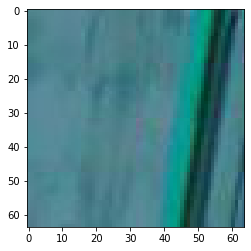

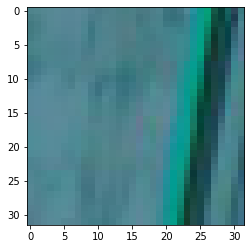

/content/Data_set_Train_x2/690/patch_683_10_17.jpg
/content/Data_set_Train_x2/690/patch_683_4_14.jpg
/content/Data_set_Train_x2/690/patch_683_8_20.jpg
/content/Data_set_Train_x2/690/patch_683_4_1.jpg
/content/Data_set_Train_x2/690/patch_683_13_15.jpg
/content/Data_set_Train_x2/690/patch_683_12_13.jpg
/content/Data_set_Train_x2/690/patch_683_12_19.jpg
/content/Data_set_Train_x2/690/patch_683_8_12.jpg
/content/Data_set_Train_x2/690/patch_683_0_25.jpg
/content/Data_set_Train_x2/690/patch_683_15_2.jpg
/content/Data_set_Train_x2/690/patch_683_8_13.jpg
/content/Data_set_Train_x2/690/patch_683_8_2.jpg
/content/Data_set_Train_x2/690/patch_683_9_22.jpg
/content/Data_set_Train_x2/690/patch_683_6_21.jpg
/content/Data_set_Train_x2/690/patch_683_2_16.jpg
/content/Data_set_Train_x2/690/patch_683_13_18.jpg
/content/Data_set_Train_x2/690/patch_683_13_28.jpg
/content/Data_set_Train_x2/690/patch_683_6_1.jpg
/content/Data_set_Train_x2/690/patch_683_2_26.jpg
/content/Data_set_Train_x2/690/patch_683_6_17.j

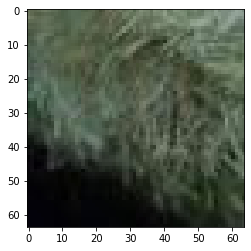

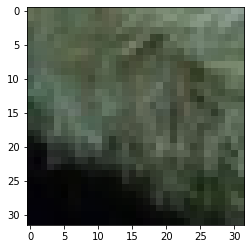

/content/Data_set_Train_x2/690/patch_684_12_5.jpg
/content/Data_set_Train_x2/690/patch_680_14_20.jpg
/content/Data_set_Train_x2/690/patch_681_8_17.jpg
/content/Data_set_Train_x2/690/patch_681_7_3.jpg
/content/Data_set_Train_x2/690/patch_680_11_23.jpg
/content/Data_set_Train_x2/690/patch_681_6_0.jpg
/content/Data_set_Train_x2/690/patch_681_8_12.jpg
/content/Data_set_Train_x2/690/patch_681_4_10.jpg
/content/Data_set_Train_x2/690/patch_680_10_27.jpg
/content/Data_set_Train_x2/690/patch_681_0_10.jpg
/content/Data_set_Train_x2/690/patch_680_16_6.jpg
/content/Data_set_Train_x2/690/patch_680_14_27.jpg
/content/Data_set_Train_x2/690/patch_681_5_23.jpg
/content/Data_set_Train_x2/690/patch_681_0_17.jpg
/content/Data_set_Train_x2/690/patch_681_6_16.jpg
/content/Data_set_Train_x2/690/patch_681_6_14.jpg
/content/Data_set_Train_x2/690/patch_680_10_22.jpg
/content/Data_set_Train_x2/690/patch_681_3_24.jpg
/content/Data_set_Train_x2/690/patch_681_2_16.jpg
/content/Data_set_Train_x2/690/patch_681_5_19.j

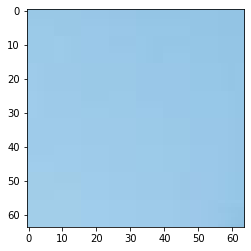

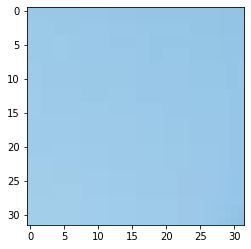

/content/Data_set_Train_x2/690/patch_681_14_14.jpg
/content/Data_set_Train_x2/690/patch_681_20_23.jpg
/content/Data_set_Train_x2/690/patch_682_2_12.jpg
/content/Data_set_Train_x2/690/patch_681_20_21.jpg
/content/Data_set_Train_x2/690/patch_681_12_4.jpg
/content/Data_set_Train_x2/690/patch_682_1_27.jpg
/content/Data_set_Train_x2/690/patch_681_19_9.jpg
/content/Data_set_Train_x2/690/patch_681_9_22.jpg
/content/Data_set_Train_x2/690/patch_682_1_3.jpg
/content/Data_set_Train_x2/690/patch_681_14_20.jpg
/content/Data_set_Train_x2/690/patch_681_10_5.jpg
/content/Data_set_Train_x2/690/patch_681_14_23.jpg
/content/Data_set_Train_x2/690/patch_681_14_8.jpg
/content/Data_set_Train_x2/690/patch_681_18_26.jpg
/content/Data_set_Train_x2/690/patch_681_13_18.jpg
/content/Data_set_Train_x2/690/patch_681_19_6.jpg
/content/Data_set_Train_x2/690/patch_682_3_2.jpg
/content/Data_set_Train_x2/690/patch_682_2_28.jpg
/content/Data_set_Train_x2/690/patch_681_11_10.jpg
/content/Data_set_Train_x2/690/patch_681_14_

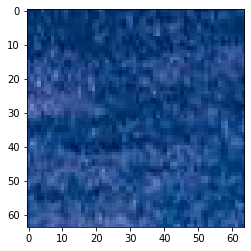

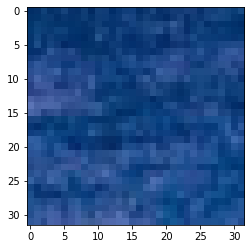

/content/Data_set_Train_x2/690/patch_682_18_15.jpg
/content/Data_set_Train_x2/690/patch_680_1_0.jpg
/content/Data_set_Train_x2/690/patch_680_2_1.jpg
/content/Data_set_Train_x2/690/patch_680_4_22.jpg
/content/Data_set_Train_x2/690/patch_680_5_10.jpg
/content/Data_set_Train_x2/690/patch_680_3_28.jpg
/content/Data_set_Train_x2/690/patch_680_1_22.jpg
/content/Data_set_Train_x2/690/patch_680_7_2.jpg
/content/Data_set_Train_x2/690/patch_680_2_6.jpg
/content/Data_set_Train_x2/690/patch_680_7_21.jpg
/content/Data_set_Train_x2/690/patch_680_4_18.jpg
/content/Data_set_Train_x2/690/patch_680_4_6.jpg
/content/Data_set_Train_x2/690/patch_680_9_12.jpg
/content/Data_set_Train_x2/690/patch_680_2_29.jpg
/content/Data_set_Train_x2/690/patch_680_3_5.jpg
/content/Data_set_Train_x2/690/patch_680_3_20.jpg
/content/Data_set_Train_x2/690/patch_680_1_11.jpg
/content/Data_set_Train_x2/690/patch_680_9_1.jpg
/content/Data_set_Train_x2/690/patch_680_7_15.jpg
/content/Data_set_Train_x2/690/patch_680_3_6.jpg
/conten

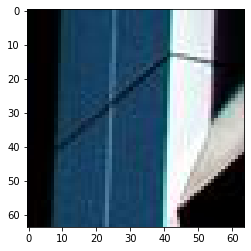

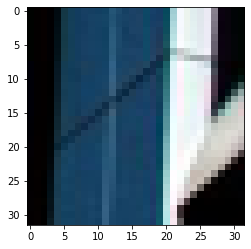

/content/Data_set_Train_x2/700/patch_699_9_5.jpg
/content/Data_set_Train_x2/700/patch_699_18_18.jpg
/content/Data_set_Train_x2/700/patch_699_10_5.jpg
/content/Data_set_Train_x2/700/patch_699_17_19.jpg
/content/Data_set_Train_x2/700/patch_699_6_13.jpg
/content/Data_set_Train_x2/700/patch_699_6_18.jpg
/content/Data_set_Train_x2/700/patch_699_3_19.jpg
/content/Data_set_Train_x2/700/patch_699_11_8.jpg
/content/Data_set_Train_x2/700/patch_699_4_30.jpg
/content/Data_set_Train_x2/700/patch_699_2_22.jpg
/content/Data_set_Train_x2/700/patch_699_3_21.jpg
/content/Data_set_Train_x2/700/patch_699_5_1.jpg
/content/Data_set_Train_x2/700/patch_699_7_30.jpg
/content/Data_set_Train_x2/700/patch_699_16_10.jpg
/content/Data_set_Train_x2/700/patch_699_6_21.jpg
/content/Data_set_Train_x2/700/patch_699_14_3.jpg
/content/Data_set_Train_x2/700/patch_699_4_7.jpg
/content/Data_set_Train_x2/700/patch_699_13_21.jpg
/content/Data_set_Train_x2/700/patch_699_2_19.jpg
/content/Data_set_Train_x2/700/patch_699_7_15.jpg

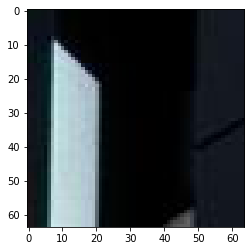

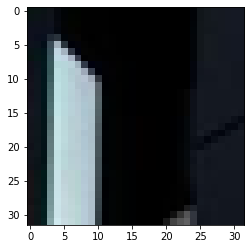

/content/Data_set_Train_x2/700/patch_699_20_11.jpg
/content/Data_set_Train_x2/700/patch_697_0_10.jpg
/content/Data_set_Train_x2/700/patch_697_6_19.jpg
/content/Data_set_Train_x2/700/patch_697_8_19.jpg
/content/Data_set_Train_x2/700/patch_697_3_1.jpg
/content/Data_set_Train_x2/700/patch_697_14_14.jpg
/content/Data_set_Train_x2/700/patch_697_13_11.jpg
/content/Data_set_Train_x2/700/patch_697_16_3.jpg
/content/Data_set_Train_x2/700/patch_697_7_1.jpg
/content/Data_set_Train_x2/700/patch_696_26_18.jpg
/content/Data_set_Train_x2/700/patch_696_25_9.jpg
/content/Data_set_Train_x2/700/patch_697_6_9.jpg
/content/Data_set_Train_x2/700/patch_696_24_20.jpg
/content/Data_set_Train_x2/700/patch_696_30_5.jpg
/content/Data_set_Train_x2/700/patch_697_3_3.jpg
/content/Data_set_Train_x2/700/patch_697_7_17.jpg
/content/Data_set_Train_x2/700/patch_697_6_2.jpg
/content/Data_set_Train_x2/700/patch_696_23_19.jpg
/content/Data_set_Train_x2/700/patch_696_25_14.jpg
/content/Data_set_Train_x2/700/patch_697_16_2.jp

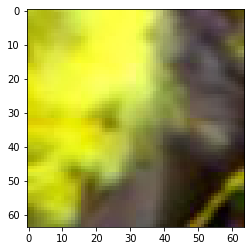

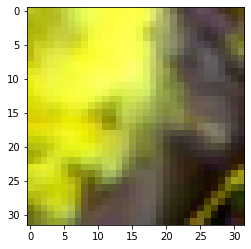

/content/Data_set_Train_x2/700/patch_697_25_6.jpg
/content/Data_set_Train_x2/700/patch_697_19_19.jpg
/content/Data_set_Train_x2/700/patch_698_1_30.jpg
/content/Data_set_Train_x2/700/patch_697_29_0.jpg
/content/Data_set_Train_x2/700/patch_697_24_10.jpg
/content/Data_set_Train_x2/700/patch_697_29_3.jpg
/content/Data_set_Train_x2/700/patch_698_5_12.jpg
/content/Data_set_Train_x2/700/patch_698_3_17.jpg
/content/Data_set_Train_x2/700/patch_697_17_6.jpg
/content/Data_set_Train_x2/700/patch_698_4_0.jpg
/content/Data_set_Train_x2/700/patch_698_4_15.jpg
/content/Data_set_Train_x2/700/patch_697_26_18.jpg
/content/Data_set_Train_x2/700/patch_697_30_12.jpg
/content/Data_set_Train_x2/700/patch_698_4_23.jpg
/content/Data_set_Train_x2/700/patch_698_5_22.jpg
/content/Data_set_Train_x2/700/patch_698_5_24.jpg
/content/Data_set_Train_x2/700/patch_697_29_6.jpg
/content/Data_set_Train_x2/700/patch_697_18_13.jpg
/content/Data_set_Train_x2/700/patch_698_2_2.jpg
/content/Data_set_Train_x2/700/patch_697_23_12.

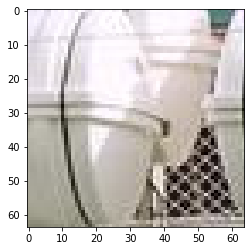

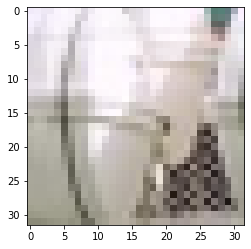

/content/Data_set_Train_x2/700/patch_698_12_18.jpg
/content/Data_set_Train_x2/700/patch_695_5_4.jpg
/content/Data_set_Train_x2/700/patch_695_9_7.jpg
/content/Data_set_Train_x2/700/patch_695_7_10.jpg
/content/Data_set_Train_x2/700/patch_695_9_17.jpg
/content/Data_set_Train_x2/700/patch_695_15_18.jpg
/content/Data_set_Train_x2/700/patch_695_14_23.jpg
/content/Data_set_Train_x2/700/patch_695_13_23.jpg
/content/Data_set_Train_x2/700/patch_695_7_30.jpg
/content/Data_set_Train_x2/700/patch_695_9_10.jpg
/content/Data_set_Train_x2/700/patch_695_5_13.jpg
/content/Data_set_Train_x2/700/patch_695_6_28.jpg
/content/Data_set_Train_x2/700/patch_695_20_8.jpg
/content/Data_set_Train_x2/700/patch_695_10_27.jpg
/content/Data_set_Train_x2/700/patch_695_17_8.jpg
/content/Data_set_Train_x2/700/patch_695_20_5.jpg
/content/Data_set_Train_x2/700/patch_695_19_18.jpg
/content/Data_set_Train_x2/700/patch_695_4_22.jpg
/content/Data_set_Train_x2/700/patch_695_7_9.jpg
/content/Data_set_Train_x2/700/patch_695_12_7.j

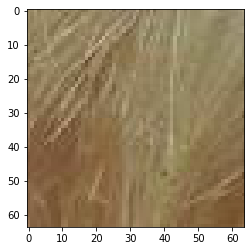

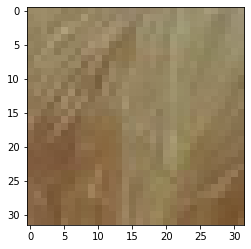

/content/Data_set_Train_x2/700/patch_696_21_11.jpg
/content/Data_set_Train_x2/700/patch_696_16_15.jpg
/content/Data_set_Train_x2/700/patch_696_12_18.jpg
/content/Data_set_Train_x2/700/patch_696_18_12.jpg
/content/Data_set_Train_x2/700/patch_696_10_20.jpg
/content/Data_set_Train_x2/700/patch_696_19_16.jpg
/content/Data_set_Train_x2/700/patch_696_6_15.jpg
/content/Data_set_Train_x2/700/patch_696_8_0.jpg
/content/Data_set_Train_x2/700/patch_696_14_12.jpg
/content/Data_set_Train_x2/700/patch_696_13_4.jpg
/content/Data_set_Train_x2/700/patch_696_6_4.jpg
/content/Data_set_Train_x2/700/patch_696_4_18.jpg
/content/Data_set_Train_x2/700/patch_696_22_16.jpg
/content/Data_set_Train_x2/700/patch_696_18_18.jpg
/content/Data_set_Train_x2/700/patch_696_9_13.jpg
/content/Data_set_Train_x2/700/patch_696_4_14.jpg
/content/Data_set_Train_x2/700/patch_696_20_9.jpg
/content/Data_set_Train_x2/700/patch_696_17_6.jpg
/content/Data_set_Train_x2/700/patch_696_16_17.jpg
/content/Data_set_Train_x2/700/patch_696_0

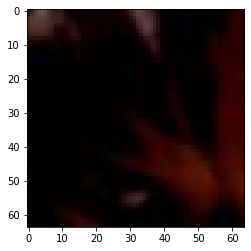

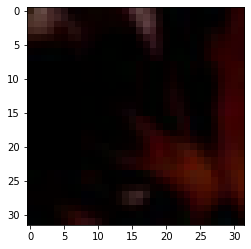

/content/Data_set_Train_x2/700/patch_697_6_11.jpg
/content/Data_set_Train_x2/700/patch_694_14_28.jpg
/content/Data_set_Train_x2/700/patch_694_12_16.jpg
/content/Data_set_Train_x2/700/patch_694_8_12.jpg
/content/Data_set_Train_x2/700/patch_694_2_1.jpg
/content/Data_set_Train_x2/700/patch_694_10_4.jpg
/content/Data_set_Train_x2/700/patch_694_8_26.jpg
/content/Data_set_Train_x2/700/patch_694_0_1.jpg
/content/Data_set_Train_x2/700/patch_693_20_29.jpg
/content/Data_set_Train_x2/700/patch_694_15_15.jpg
/content/Data_set_Train_x2/700/patch_694_4_18.jpg
/content/Data_set_Train_x2/700/patch_694_5_16.jpg
/content/Data_set_Train_x2/700/patch_694_0_10.jpg
/content/Data_set_Train_x2/700/patch_694_15_6.jpg
/content/Data_set_Train_x2/700/patch_694_6_4.jpg
/content/Data_set_Train_x2/700/patch_694_1_21.jpg
/content/Data_set_Train_x2/700/patch_694_0_29.jpg
/content/Data_set_Train_x2/700/patch_694_5_27.jpg
/content/Data_set_Train_x2/700/patch_694_5_15.jpg
/content/Data_set_Train_x2/700/patch_694_14_0.jpg

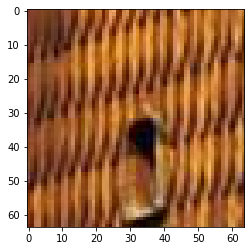

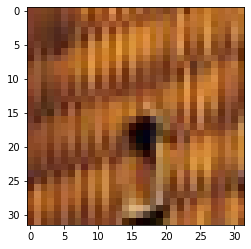

/content/Data_set_Train_x2/700/patch_694_16_9.jpg
/content/Data_set_Train_x2/700/patch_695_1_2.jpg
/content/Data_set_Train_x2/700/patch_694_26_8.jpg
/content/Data_set_Train_x2/700/patch_694_21_13.jpg
/content/Data_set_Train_x2/700/patch_695_2_19.jpg
/content/Data_set_Train_x2/700/patch_694_26_24.jpg
/content/Data_set_Train_x2/700/patch_694_16_17.jpg
/content/Data_set_Train_x2/700/patch_694_26_19.jpg
/content/Data_set_Train_x2/700/patch_694_15_30.jpg
/content/Data_set_Train_x2/700/patch_694_17_0.jpg
/content/Data_set_Train_x2/700/patch_694_26_10.jpg
/content/Data_set_Train_x2/700/patch_694_26_15.jpg
/content/Data_set_Train_x2/700/patch_694_26_25.jpg
/content/Data_set_Train_x2/700/patch_694_25_19.jpg
/content/Data_set_Train_x2/700/patch_694_20_21.jpg
/content/Data_set_Train_x2/700/patch_694_26_4.jpg
/content/Data_set_Train_x2/700/patch_695_2_24.jpg
/content/Data_set_Train_x2/700/patch_695_0_16.jpg
/content/Data_set_Train_x2/700/patch_694_20_2.jpg
/content/Data_set_Train_x2/700/patch_694_

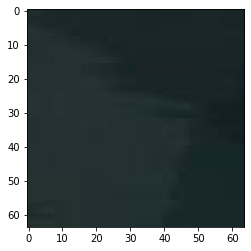

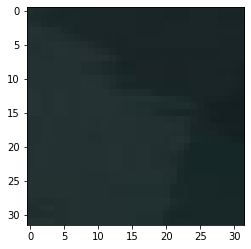

/content/Data_set_Train_x2/700/patch_695_18_18.jpg
/content/Data_set_Train_x2/700/patch_693_0_24.jpg
/content/Data_set_Train_x2/700/patch_692_8_8.jpg
/content/Data_set_Train_x2/700/patch_692_16_20.jpg
/content/Data_set_Train_x2/700/patch_692_12_27.jpg
/content/Data_set_Train_x2/700/patch_692_11_2.jpg
/content/Data_set_Train_x2/700/patch_693_2_13.jpg
/content/Data_set_Train_x2/700/patch_692_16_0.jpg
/content/Data_set_Train_x2/700/patch_692_13_1.jpg
/content/Data_set_Train_x2/700/patch_693_3_6.jpg
/content/Data_set_Train_x2/700/patch_692_18_25.jpg
/content/Data_set_Train_x2/700/patch_692_14_30.jpg
/content/Data_set_Train_x2/700/patch_692_13_27.jpg
/content/Data_set_Train_x2/700/patch_693_0_28.jpg
/content/Data_set_Train_x2/700/patch_692_11_9.jpg
/content/Data_set_Train_x2/700/patch_692_13_21.jpg
/content/Data_set_Train_x2/700/patch_692_17_24.jpg
/content/Data_set_Train_x2/700/patch_693_2_16.jpg
/content/Data_set_Train_x2/700/patch_693_1_26.jpg
/content/Data_set_Train_x2/700/patch_693_0_2

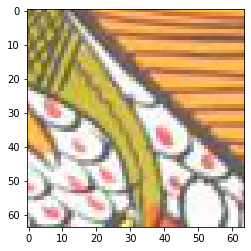

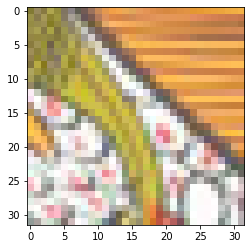

/content/Data_set_Train_x2/700/patch_693_5_24.jpg
/content/Data_set_Train_x2/700/patch_693_16_18.jpg
/content/Data_set_Train_x2/700/patch_693_14_23.jpg
/content/Data_set_Train_x2/700/patch_693_14_18.jpg
/content/Data_set_Train_x2/700/patch_693_19_30.jpg
/content/Data_set_Train_x2/700/patch_693_16_8.jpg
/content/Data_set_Train_x2/700/patch_693_11_2.jpg
/content/Data_set_Train_x2/700/patch_693_17_26.jpg
/content/Data_set_Train_x2/700/patch_693_10_25.jpg
/content/Data_set_Train_x2/700/patch_693_14_27.jpg
/content/Data_set_Train_x2/700/patch_693_13_23.jpg
/content/Data_set_Train_x2/700/patch_693_14_0.jpg
/content/Data_set_Train_x2/700/patch_693_17_24.jpg
/content/Data_set_Train_x2/700/patch_693_10_8.jpg
/content/Data_set_Train_x2/700/patch_693_11_29.jpg
/content/Data_set_Train_x2/700/patch_693_9_4.jpg
/content/Data_set_Train_x2/700/patch_693_15_14.jpg
/content/Data_set_Train_x2/700/patch_693_11_16.jpg
/content/Data_set_Train_x2/700/patch_693_11_27.jpg
/content/Data_set_Train_x2/700/patch_6

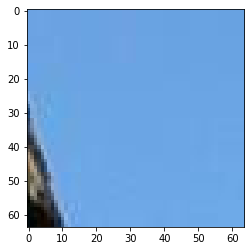

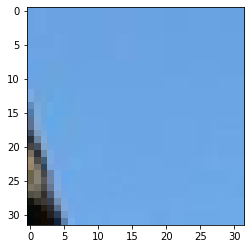

/content/Data_set_Train_x2/700/patch_694_9_20.jpg
/content/Data_set_Train_x2/700/patch_690_20_6.jpg
/content/Data_set_Train_x2/700/patch_691_11_19.jpg
/content/Data_set_Train_x2/700/patch_690_17_29.jpg
/content/Data_set_Train_x2/700/patch_691_2_3.jpg
/content/Data_set_Train_x2/700/patch_691_2_10.jpg
/content/Data_set_Train_x2/700/patch_691_1_23.jpg
/content/Data_set_Train_x2/700/patch_690_19_28.jpg
/content/Data_set_Train_x2/700/patch_691_7_20.jpg
/content/Data_set_Train_x2/700/patch_691_11_16.jpg
/content/Data_set_Train_x2/700/patch_690_17_21.jpg
/content/Data_set_Train_x2/700/patch_691_3_5.jpg
/content/Data_set_Train_x2/700/patch_691_4_30.jpg
/content/Data_set_Train_x2/700/patch_691_5_7.jpg
/content/Data_set_Train_x2/700/patch_691_11_23.jpg
/content/Data_set_Train_x2/700/patch_691_6_27.jpg
/content/Data_set_Train_x2/700/patch_690_19_0.jpg
/content/Data_set_Train_x2/700/patch_691_10_28.jpg
/content/Data_set_Train_x2/700/patch_691_10_25.jpg
/content/Data_set_Train_x2/700/patch_691_5_6.

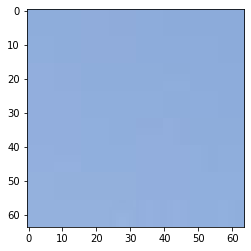

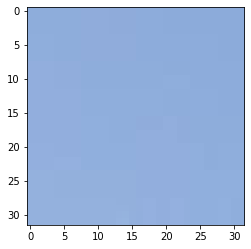

/content/Data_set_Train_x2/700/patch_692_2_24.jpg
/content/Data_set_Train_x2/700/patch_692_5_17.jpg
/content/Data_set_Train_x2/700/patch_692_3_10.jpg
/content/Data_set_Train_x2/700/patch_691_13_0.jpg
/content/Data_set_Train_x2/700/patch_691_16_6.jpg
/content/Data_set_Train_x2/700/patch_691_16_14.jpg
/content/Data_set_Train_x2/700/patch_692_5_7.jpg
/content/Data_set_Train_x2/700/patch_691_14_0.jpg
/content/Data_set_Train_x2/700/patch_692_0_27.jpg
/content/Data_set_Train_x2/700/patch_692_7_11.jpg
/content/Data_set_Train_x2/700/patch_691_14_22.jpg
/content/Data_set_Train_x2/700/patch_692_8_2.jpg
/content/Data_set_Train_x2/700/patch_691_14_24.jpg
/content/Data_set_Train_x2/700/patch_692_6_24.jpg
/content/Data_set_Train_x2/700/patch_691_13_29.jpg
/content/Data_set_Train_x2/700/patch_691_19_27.jpg
/content/Data_set_Train_x2/700/patch_691_17_10.jpg
/content/Data_set_Train_x2/700/patch_691_18_28.jpg
/content/Data_set_Train_x2/700/patch_691_15_5.jpg
/content/Data_set_Train_x2/700/patch_692_3_20

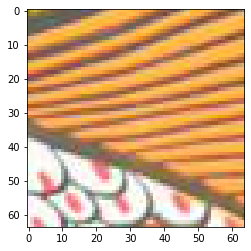

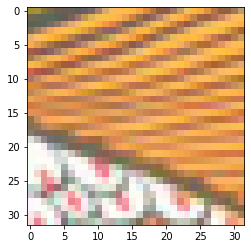

/content/Data_set_Train_x2/700/patch_693_3_22.jpg
/content/Data_set_Train_x2/700/patch_690_0_9.jpg
/content/Data_set_Train_x2/700/patch_690_1_2.jpg
/content/Data_set_Train_x2/700/patch_690_0_25.jpg
/content/Data_set_Train_x2/700/patch_690_0_6.jpg
/content/Data_set_Train_x2/700/patch_690_0_20.jpg
/content/Data_set_Train_x2/700/patch_690_0_8.jpg
/content/Data_set_Train_x2/700/patch_690_0_18.jpg
/content/Data_set_Train_x2/700/patch_690_0_22.jpg
/content/Data_set_Train_x2/700/patch_690_0_2.jpg
/content/Data_set_Train_x2/700/patch_690_0_5.jpg
/content/Data_set_Train_x2/700/patch_690_0_0.jpg
/content/Data_set_Train_x2/700/patch_690_0_3.jpg
/content/Data_set_Train_x2/700/patch_690_0_30.jpg
/content/Data_set_Train_x2/700/patch_690_0_24.jpg
/content/Data_set_Train_x2/700/patch_690_1_11.jpg
/content/Data_set_Train_x2/700/patch_690_1_5.jpg
/content/Data_set_Train_x2/700/patch_690_0_11.jpg
/content/Data_set_Train_x2/700/patch_690_0_26.jpg
/content/Data_set_Train_x2/700/patch_690_0_7.jpg
/content/D

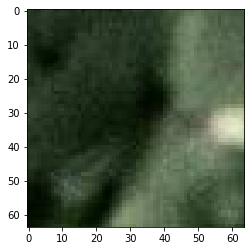

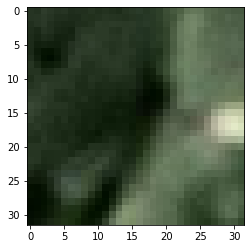

/content/Data_set_Train_x2/700/patch_690_2_23.jpg
/content/Data_set_Train_x2/700/patch_690_15_15.jpg
/content/Data_set_Train_x2/700/patch_690_14_10.jpg
/content/Data_set_Train_x2/700/patch_690_13_25.jpg
/content/Data_set_Train_x2/700/patch_690_2_12.jpg
/content/Data_set_Train_x2/700/patch_690_13_15.jpg
/content/Data_set_Train_x2/700/patch_690_10_12.jpg
/content/Data_set_Train_x2/700/patch_690_4_0.jpg
/content/Data_set_Train_x2/700/patch_690_14_21.jpg
/content/Data_set_Train_x2/700/patch_690_15_20.jpg
/content/Data_set_Train_x2/700/patch_690_2_18.jpg
/content/Data_set_Train_x2/700/patch_690_4_16.jpg
/content/Data_set_Train_x2/700/patch_690_15_21.jpg
/content/Data_set_Train_x2/700/patch_690_12_29.jpg
/content/Data_set_Train_x2/700/patch_690_16_29.jpg
/content/Data_set_Train_x2/700/patch_690_6_24.jpg
/content/Data_set_Train_x2/700/patch_690_16_12.jpg
/content/Data_set_Train_x2/700/patch_690_6_28.jpg
/content/Data_set_Train_x2/700/patch_690_4_3.jpg
/content/Data_set_Train_x2/700/patch_690_

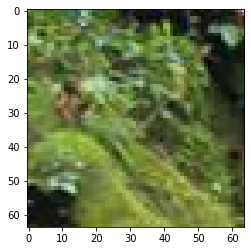

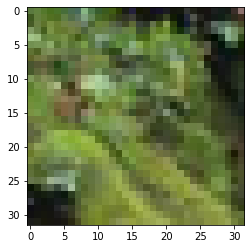

/content/Data_set_Train_x2/710/patch_709_2_4.jpg
/content/Data_set_Train_x2/710/patch_709_8_18.jpg
/content/Data_set_Train_x2/710/patch_709_7_8.jpg
/content/Data_set_Train_x2/710/patch_709_12_4.jpg
/content/Data_set_Train_x2/710/patch_709_16_10.jpg
/content/Data_set_Train_x2/710/patch_709_15_1.jpg
/content/Data_set_Train_x2/710/patch_709_12_9.jpg
/content/Data_set_Train_x2/710/patch_709_13_12.jpg
/content/Data_set_Train_x2/710/patch_709_2_30.jpg
/content/Data_set_Train_x2/710/patch_709_13_27.jpg
/content/Data_set_Train_x2/710/patch_709_2_0.jpg
/content/Data_set_Train_x2/710/patch_709_11_12.jpg
/content/Data_set_Train_x2/710/patch_709_16_8.jpg
/content/Data_set_Train_x2/710/patch_709_13_15.jpg
/content/Data_set_Train_x2/710/patch_709_7_21.jpg
/content/Data_set_Train_x2/710/patch_709_3_15.jpg
/content/Data_set_Train_x2/710/patch_709_15_5.jpg
/content/Data_set_Train_x2/710/patch_709_4_5.jpg
/content/Data_set_Train_x2/710/patch_709_5_9.jpg
/content/Data_set_Train_x2/710/patch_709_12_7.jpg


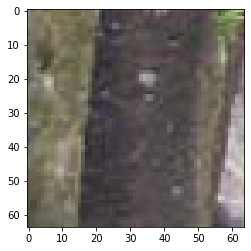

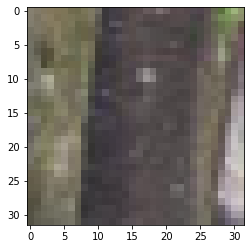

/content/Data_set_Train_x2/710/patch_709_19_2.jpg
/content/Data_set_Train_x2/710/patch_707_10_12.jpg
/content/Data_set_Train_x2/710/patch_707_8_24.jpg
/content/Data_set_Train_x2/710/patch_707_2_21.jpg
/content/Data_set_Train_x2/710/patch_707_11_11.jpg
/content/Data_set_Train_x2/710/patch_707_7_26.jpg
/content/Data_set_Train_x2/710/patch_707_11_6.jpg
/content/Data_set_Train_x2/710/patch_707_6_7.jpg
/content/Data_set_Train_x2/710/patch_707_10_30.jpg
/content/Data_set_Train_x2/710/patch_707_8_9.jpg
/content/Data_set_Train_x2/710/patch_706_20_2.jpg
/content/Data_set_Train_x2/710/patch_707_12_20.jpg
/content/Data_set_Train_x2/710/patch_707_0_14.jpg
/content/Data_set_Train_x2/710/patch_707_7_7.jpg
/content/Data_set_Train_x2/710/patch_707_8_29.jpg
/content/Data_set_Train_x2/710/patch_707_9_16.jpg
/content/Data_set_Train_x2/710/patch_707_13_16.jpg
/content/Data_set_Train_x2/710/patch_707_13_19.jpg
/content/Data_set_Train_x2/710/patch_707_3_9.jpg
/content/Data_set_Train_x2/710/patch_707_3_27.jp

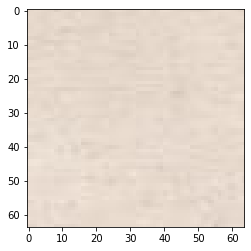

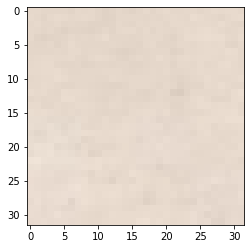

/content/Data_set_Train_x2/710/patch_708_1_22.jpg
/content/Data_set_Train_x2/710/patch_707_16_3.jpg
/content/Data_set_Train_x2/710/patch_708_2_3.jpg
/content/Data_set_Train_x2/710/patch_708_5_4.jpg
/content/Data_set_Train_x2/710/patch_708_10_1.jpg
/content/Data_set_Train_x2/710/patch_708_8_16.jpg
/content/Data_set_Train_x2/710/patch_708_7_17.jpg
/content/Data_set_Train_x2/710/patch_708_1_10.jpg
/content/Data_set_Train_x2/710/patch_708_3_19.jpg
/content/Data_set_Train_x2/710/patch_707_16_7.jpg
/content/Data_set_Train_x2/710/patch_708_1_5.jpg
/content/Data_set_Train_x2/710/patch_708_9_18.jpg
/content/Data_set_Train_x2/710/patch_707_19_23.jpg
/content/Data_set_Train_x2/710/patch_707_20_29.jpg
/content/Data_set_Train_x2/710/patch_708_6_18.jpg
/content/Data_set_Train_x2/710/patch_707_16_29.jpg
/content/Data_set_Train_x2/710/patch_707_14_30.jpg
/content/Data_set_Train_x2/710/patch_708_2_15.jpg
/content/Data_set_Train_x2/710/patch_708_9_9.jpg
/content/Data_set_Train_x2/710/patch_708_0_10.jpg


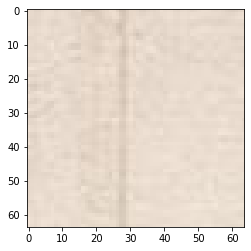

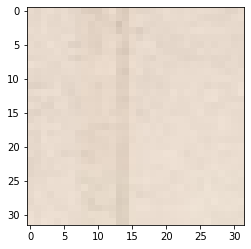

/content/Data_set_Train_x2/710/patch_708_15_4.jpg
/content/Data_set_Train_x2/710/patch_705_19_11.jpg
/content/Data_set_Train_x2/710/patch_706_3_9.jpg
/content/Data_set_Train_x2/710/patch_705_11_23.jpg
/content/Data_set_Train_x2/710/patch_706_3_15.jpg
/content/Data_set_Train_x2/710/patch_705_12_15.jpg
/content/Data_set_Train_x2/710/patch_705_13_11.jpg
/content/Data_set_Train_x2/710/patch_705_14_21.jpg
/content/Data_set_Train_x2/710/patch_705_10_27.jpg
/content/Data_set_Train_x2/710/patch_705_13_19.jpg
/content/Data_set_Train_x2/710/patch_705_14_8.jpg
/content/Data_set_Train_x2/710/patch_705_16_28.jpg
/content/Data_set_Train_x2/710/patch_706_0_20.jpg
/content/Data_set_Train_x2/710/patch_705_9_3.jpg
/content/Data_set_Train_x2/710/patch_705_13_7.jpg
/content/Data_set_Train_x2/710/patch_706_0_19.jpg
/content/Data_set_Train_x2/710/patch_705_9_8.jpg
/content/Data_set_Train_x2/710/patch_705_16_26.jpg
/content/Data_set_Train_x2/710/patch_705_16_8.jpg
/content/Data_set_Train_x2/710/patch_705_14_

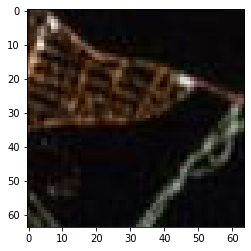

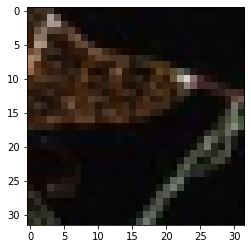

/content/Data_set_Train_x2/710/patch_706_17_0.jpg
/content/Data_set_Train_x2/710/patch_706_11_28.jpg
/content/Data_set_Train_x2/710/patch_706_9_14.jpg
/content/Data_set_Train_x2/710/patch_706_16_6.jpg
/content/Data_set_Train_x2/710/patch_706_4_14.jpg
/content/Data_set_Train_x2/710/patch_706_17_22.jpg
/content/Data_set_Train_x2/710/patch_706_11_23.jpg
/content/Data_set_Train_x2/710/patch_706_13_0.jpg
/content/Data_set_Train_x2/710/patch_706_8_5.jpg
/content/Data_set_Train_x2/710/patch_706_14_18.jpg
/content/Data_set_Train_x2/710/patch_706_5_14.jpg
/content/Data_set_Train_x2/710/patch_706_12_3.jpg
/content/Data_set_Train_x2/710/patch_706_9_1.jpg
/content/Data_set_Train_x2/710/patch_706_10_9.jpg
/content/Data_set_Train_x2/710/patch_706_9_8.jpg
/content/Data_set_Train_x2/710/patch_706_14_0.jpg
/content/Data_set_Train_x2/710/patch_706_8_14.jpg
/content/Data_set_Train_x2/710/patch_706_19_11.jpg
/content/Data_set_Train_x2/710/patch_706_13_1.jpg
/content/Data_set_Train_x2/710/patch_706_16_21.j

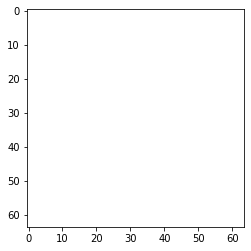

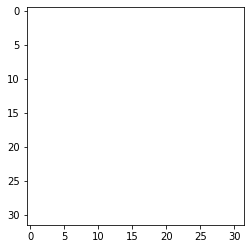

/content/Data_set_Train_x2/710/patch_707_3_1.jpg
/content/Data_set_Train_x2/710/patch_704_7_25.jpg
/content/Data_set_Train_x2/710/patch_704_12_12.jpg
/content/Data_set_Train_x2/710/patch_704_3_29.jpg
/content/Data_set_Train_x2/710/patch_704_8_0.jpg
/content/Data_set_Train_x2/710/patch_703_19_0.jpg
/content/Data_set_Train_x2/710/patch_704_2_23.jpg
/content/Data_set_Train_x2/710/patch_704_7_4.jpg
/content/Data_set_Train_x2/710/patch_704_8_27.jpg
/content/Data_set_Train_x2/710/patch_704_11_10.jpg
/content/Data_set_Train_x2/710/patch_704_11_9.jpg
/content/Data_set_Train_x2/710/patch_704_4_13.jpg
/content/Data_set_Train_x2/710/patch_704_2_20.jpg
/content/Data_set_Train_x2/710/patch_704_6_20.jpg
/content/Data_set_Train_x2/710/patch_703_20_19.jpg
/content/Data_set_Train_x2/710/patch_703_18_16.jpg
/content/Data_set_Train_x2/710/patch_704_9_28.jpg
/content/Data_set_Train_x2/710/patch_704_11_3.jpg
/content/Data_set_Train_x2/710/patch_703_20_1.jpg
/content/Data_set_Train_x2/710/patch_704_7_11.jpg

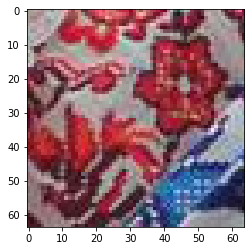

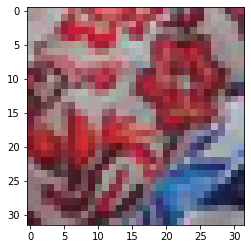

/content/Data_set_Train_x2/710/patch_705_8_12.jpg
/content/Data_set_Train_x2/710/patch_705_5_3.jpg
/content/Data_set_Train_x2/710/patch_705_1_14.jpg
/content/Data_set_Train_x2/710/patch_705_5_11.jpg
/content/Data_set_Train_x2/710/patch_705_4_21.jpg
/content/Data_set_Train_x2/710/patch_705_8_20.jpg
/content/Data_set_Train_x2/710/patch_704_20_11.jpg
/content/Data_set_Train_x2/710/patch_705_6_13.jpg
/content/Data_set_Train_x2/710/patch_705_4_4.jpg
/content/Data_set_Train_x2/710/patch_705_6_24.jpg
/content/Data_set_Train_x2/710/patch_705_2_24.jpg
/content/Data_set_Train_x2/710/patch_704_13_26.jpg
/content/Data_set_Train_x2/710/patch_705_3_12.jpg
/content/Data_set_Train_x2/710/patch_705_1_4.jpg
/content/Data_set_Train_x2/710/patch_704_18_16.jpg
/content/Data_set_Train_x2/710/patch_704_20_8.jpg
/content/Data_set_Train_x2/710/patch_705_4_26.jpg
/content/Data_set_Train_x2/710/patch_704_19_27.jpg
/content/Data_set_Train_x2/710/patch_704_14_21.jpg
/content/Data_set_Train_x2/710/patch_704_16_12.j

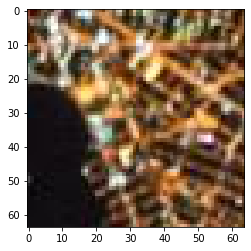

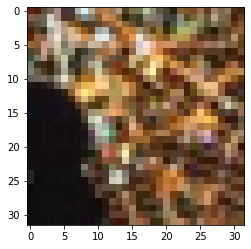

/content/Data_set_Train_x2/710/patch_706_0_12.jpg
/content/Data_set_Train_x2/710/patch_702_14_26.jpg
/content/Data_set_Train_x2/710/patch_702_13_24.jpg
/content/Data_set_Train_x2/710/patch_702_7_2.jpg
/content/Data_set_Train_x2/710/patch_702_3_28.jpg
/content/Data_set_Train_x2/710/patch_702_13_10.jpg
/content/Data_set_Train_x2/710/patch_702_8_3.jpg
/content/Data_set_Train_x2/710/patch_702_14_2.jpg
/content/Data_set_Train_x2/710/patch_702_10_3.jpg
/content/Data_set_Train_x2/710/patch_702_11_13.jpg
/content/Data_set_Train_x2/710/patch_702_16_10.jpg
/content/Data_set_Train_x2/710/patch_702_12_4.jpg
/content/Data_set_Train_x2/710/patch_703_1_18.jpg
/content/Data_set_Train_x2/710/patch_702_14_5.jpg
/content/Data_set_Train_x2/710/patch_702_15_7.jpg
/content/Data_set_Train_x2/710/patch_702_10_29.jpg
/content/Data_set_Train_x2/710/patch_702_11_27.jpg
/content/Data_set_Train_x2/710/patch_702_14_9.jpg
/content/Data_set_Train_x2/710/patch_702_10_7.jpg
/content/Data_set_Train_x2/710/patch_702_11_1

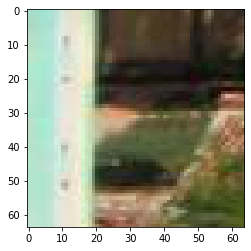

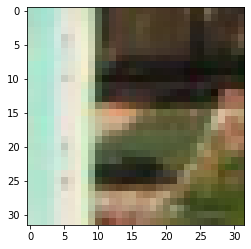

/content/Data_set_Train_x2/710/patch_703_16_4.jpg
/content/Data_set_Train_x2/710/patch_703_8_5.jpg
/content/Data_set_Train_x2/710/patch_703_13_14.jpg
/content/Data_set_Train_x2/710/patch_703_8_2.jpg
/content/Data_set_Train_x2/710/patch_703_12_8.jpg
/content/Data_set_Train_x2/710/patch_703_17_11.jpg
/content/Data_set_Train_x2/710/patch_703_15_0.jpg
/content/Data_set_Train_x2/710/patch_703_4_2.jpg
/content/Data_set_Train_x2/710/patch_703_5_15.jpg
/content/Data_set_Train_x2/710/patch_703_15_14.jpg
/content/Data_set_Train_x2/710/patch_703_4_29.jpg
/content/Data_set_Train_x2/710/patch_703_5_23.jpg
/content/Data_set_Train_x2/710/patch_703_10_20.jpg
/content/Data_set_Train_x2/710/patch_703_11_9.jpg
/content/Data_set_Train_x2/710/patch_703_2_29.jpg
/content/Data_set_Train_x2/710/patch_703_15_16.jpg
/content/Data_set_Train_x2/710/patch_703_17_15.jpg
/content/Data_set_Train_x2/710/patch_703_7_17.jpg
/content/Data_set_Train_x2/710/patch_703_3_21.jpg
/content/Data_set_Train_x2/710/patch_703_9_29.j

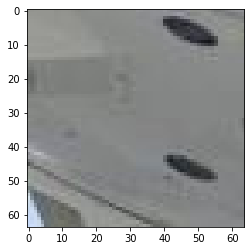

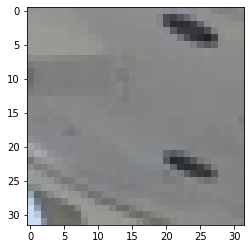

/content/Data_set_Train_x2/710/patch_704_8_4.jpg
/content/Data_set_Train_x2/710/patch_701_7_24.jpg
/content/Data_set_Train_x2/710/patch_700_16_0.jpg
/content/Data_set_Train_x2/710/patch_701_4_19.jpg
/content/Data_set_Train_x2/710/patch_701_7_13.jpg
/content/Data_set_Train_x2/710/patch_700_14_12.jpg
/content/Data_set_Train_x2/710/patch_700_15_7.jpg
/content/Data_set_Train_x2/710/patch_701_2_18.jpg
/content/Data_set_Train_x2/710/patch_700_18_11.jpg
/content/Data_set_Train_x2/710/patch_700_14_17.jpg
/content/Data_set_Train_x2/710/patch_700_19_7.jpg
/content/Data_set_Train_x2/710/patch_700_15_12.jpg
/content/Data_set_Train_x2/710/patch_700_19_26.jpg
/content/Data_set_Train_x2/710/patch_701_6_19.jpg
/content/Data_set_Train_x2/710/patch_701_0_19.jpg
/content/Data_set_Train_x2/710/patch_701_8_0.jpg
/content/Data_set_Train_x2/710/patch_700_14_5.jpg
/content/Data_set_Train_x2/710/patch_701_7_2.jpg
/content/Data_set_Train_x2/710/patch_701_7_22.jpg
/content/Data_set_Train_x2/710/patch_700_16_15.j

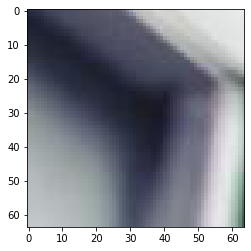

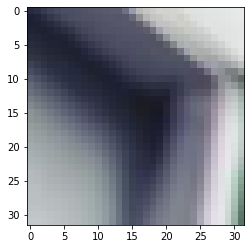

/content/Data_set_Train_x2/710/patch_702_3_1.jpg
/content/Data_set_Train_x2/710/patch_701_14_27.jpg
/content/Data_set_Train_x2/710/patch_701_15_7.jpg
/content/Data_set_Train_x2/710/patch_701_16_17.jpg
/content/Data_set_Train_x2/710/patch_701_11_1.jpg
/content/Data_set_Train_x2/710/patch_701_15_22.jpg
/content/Data_set_Train_x2/710/patch_701_12_25.jpg
/content/Data_set_Train_x2/710/patch_701_18_19.jpg
/content/Data_set_Train_x2/710/patch_702_2_19.jpg
/content/Data_set_Train_x2/710/patch_701_10_6.jpg
/content/Data_set_Train_x2/710/patch_701_12_5.jpg
/content/Data_set_Train_x2/710/patch_701_19_22.jpg
/content/Data_set_Train_x2/710/patch_701_15_25.jpg
/content/Data_set_Train_x2/710/patch_701_14_15.jpg
/content/Data_set_Train_x2/710/patch_701_11_30.jpg
/content/Data_set_Train_x2/710/patch_702_1_9.jpg
/content/Data_set_Train_x2/710/patch_701_16_15.jpg
/content/Data_set_Train_x2/710/patch_701_13_28.jpg
/content/Data_set_Train_x2/710/patch_701_9_22.jpg
/content/Data_set_Train_x2/710/patch_701_

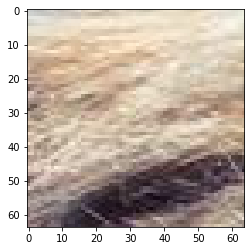

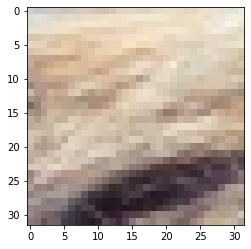

/content/Data_set_Train_x2/710/patch_702_8_7.jpg
/content/Data_set_Train_x2/710/patch_700_12_10.jpg
/content/Data_set_Train_x2/710/patch_700_2_26.jpg
/content/Data_set_Train_x2/710/patch_700_7_18.jpg
/content/Data_set_Train_x2/710/patch_700_9_4.jpg
/content/Data_set_Train_x2/710/patch_700_8_25.jpg
/content/Data_set_Train_x2/710/patch_700_13_15.jpg
/content/Data_set_Train_x2/710/patch_700_3_0.jpg
/content/Data_set_Train_x2/710/patch_700_4_28.jpg
/content/Data_set_Train_x2/710/patch_700_5_4.jpg
/content/Data_set_Train_x2/710/patch_700_2_6.jpg
/content/Data_set_Train_x2/710/patch_700_8_16.jpg
/content/Data_set_Train_x2/710/patch_700_3_29.jpg
/content/Data_set_Train_x2/710/patch_700_11_24.jpg
/content/Data_set_Train_x2/710/patch_700_8_6.jpg
/content/Data_set_Train_x2/710/patch_700_1_0.jpg
/content/Data_set_Train_x2/710/patch_700_8_10.jpg
/content/Data_set_Train_x2/710/patch_700_5_10.jpg
/content/Data_set_Train_x2/710/patch_700_7_27.jpg
/content/Data_set_Train_x2/710/patch_700_9_29.jpg
/con

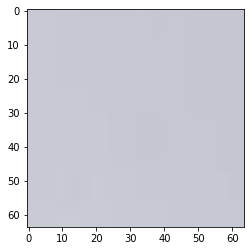

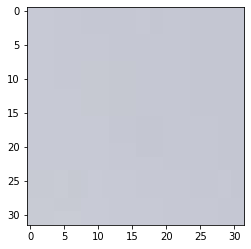

/content/Data_set_Train_x2/710/patch_701_3_30.jpg
/content/Data_set_Train_x2/710/patch_700_17_5.jpg
/content/Data_set_Train_x2/710/patch_701_5_21.jpg
/content/Data_set_Train_x2/710/patch_701_4_29.jpg
/content/Data_set_Train_x2/710/patch_701_7_12.jpg
/content/Data_set_Train_x2/710/patch_701_6_4.jpg
/content/Data_set_Train_x2/710/patch_700_15_20.jpg
/content/Data_set_Train_x2/710/patch_700_18_25.jpg
/content/Data_set_Train_x2/710/patch_701_7_23.jpg
/content/Data_set_Train_x2/710/patch_700_20_2.jpg
/content/Data_set_Train_x2/710/patch_700_14_23.jpg
/content/Data_set_Train_x2/710/patch_701_2_0.jpg
/content/Data_set_Train_x2/710/patch_700_19_6.jpg
/content/Data_set_Train_x2/710/patch_700_20_26.jpg
/content/Data_set_Train_x2/710/patch_701_0_21.jpg
/content/Data_set_Train_x2/710/patch_701_2_1.jpg
/content/Data_set_Train_x2/710/patch_700_15_6.jpg
/content/Data_set_Train_x2/710/patch_700_20_30.jpg
/content/Data_set_Train_x2/710/patch_700_13_24.jpg
/content/Data_set_Train_x2/710/patch_701_6_5.jp

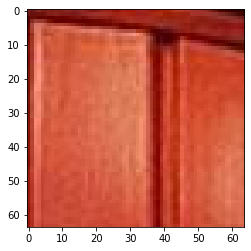

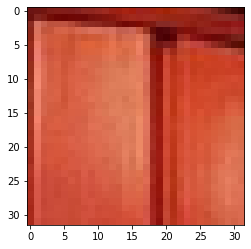

/content/Data_set_Train_x2/720/patch_719_9_10.jpg
/content/Data_set_Train_x2/720/patch_719_7_10.jpg
/content/Data_set_Train_x2/720/patch_719_19_15.jpg
/content/Data_set_Train_x2/720/patch_719_7_6.jpg
/content/Data_set_Train_x2/720/patch_719_11_6.jpg
/content/Data_set_Train_x2/720/patch_719_21_2.jpg
/content/Data_set_Train_x2/720/patch_719_9_18.jpg
/content/Data_set_Train_x2/720/patch_719_13_11.jpg
/content/Data_set_Train_x2/720/patch_719_15_28.jpg
/content/Data_set_Train_x2/720/patch_719_17_27.jpg
/content/Data_set_Train_x2/720/patch_719_16_14.jpg
/content/Data_set_Train_x2/720/patch_719_17_22.jpg
/content/Data_set_Train_x2/720/patch_719_18_13.jpg
/content/Data_set_Train_x2/720/patch_719_12_3.jpg
/content/Data_set_Train_x2/720/patch_719_7_30.jpg
/content/Data_set_Train_x2/720/patch_719_8_10.jpg
/content/Data_set_Train_x2/720/patch_719_10_30.jpg
/content/Data_set_Train_x2/720/patch_719_22_9.jpg
/content/Data_set_Train_x2/720/patch_719_14_4.jpg
/content/Data_set_Train_x2/720/patch_719_15

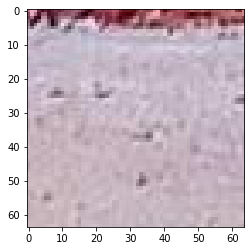

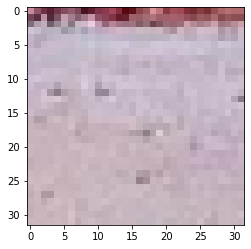

/content/Data_set_Train_x2/720/patch_719_29_14.jpg
/content/Data_set_Train_x2/720/patch_717_12_3.jpg
/content/Data_set_Train_x2/720/patch_717_8_24.jpg
/content/Data_set_Train_x2/720/patch_717_15_17.jpg
/content/Data_set_Train_x2/720/patch_717_5_4.jpg
/content/Data_set_Train_x2/720/patch_717_2_16.jpg
/content/Data_set_Train_x2/720/patch_717_7_12.jpg
/content/Data_set_Train_x2/720/patch_717_12_16.jpg
/content/Data_set_Train_x2/720/patch_717_7_7.jpg
/content/Data_set_Train_x2/720/patch_717_9_27.jpg
/content/Data_set_Train_x2/720/patch_717_3_29.jpg
/content/Data_set_Train_x2/720/patch_717_10_12.jpg
/content/Data_set_Train_x2/720/patch_717_9_9.jpg
/content/Data_set_Train_x2/720/patch_717_10_6.jpg
/content/Data_set_Train_x2/720/patch_717_0_16.jpg
/content/Data_set_Train_x2/720/patch_717_5_0.jpg
/content/Data_set_Train_x2/720/patch_717_14_8.jpg
/content/Data_set_Train_x2/720/patch_717_6_0.jpg
/content/Data_set_Train_x2/720/patch_717_13_9.jpg
/content/Data_set_Train_x2/720/patch_717_6_29.jpg
/

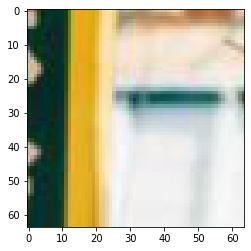

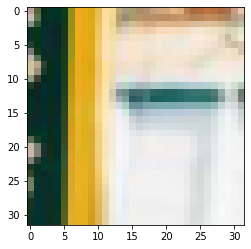

/content/Data_set_Train_x2/720/patch_718_10_14.jpg
/content/Data_set_Train_x2/720/patch_717_15_25.jpg
/content/Data_set_Train_x2/720/patch_717_18_2.jpg
/content/Data_set_Train_x2/720/patch_718_3_21.jpg
/content/Data_set_Train_x2/720/patch_717_18_25.jpg
/content/Data_set_Train_x2/720/patch_718_8_5.jpg
/content/Data_set_Train_x2/720/patch_717_19_5.jpg
/content/Data_set_Train_x2/720/patch_718_1_6.jpg
/content/Data_set_Train_x2/720/patch_718_7_29.jpg
/content/Data_set_Train_x2/720/patch_718_3_8.jpg
/content/Data_set_Train_x2/720/patch_718_7_1.jpg
/content/Data_set_Train_x2/720/patch_718_4_29.jpg
/content/Data_set_Train_x2/720/patch_717_20_6.jpg
/content/Data_set_Train_x2/720/patch_718_3_13.jpg
/content/Data_set_Train_x2/720/patch_718_9_21.jpg
/content/Data_set_Train_x2/720/patch_717_20_23.jpg
/content/Data_set_Train_x2/720/patch_717_19_27.jpg
/content/Data_set_Train_x2/720/patch_718_3_17.jpg
/content/Data_set_Train_x2/720/patch_718_2_0.jpg
/content/Data_set_Train_x2/720/patch_718_5_3.jpg
/

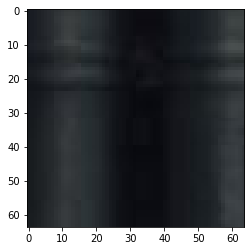

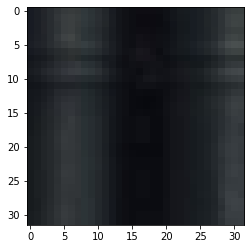

/content/Data_set_Train_x2/720/patch_718_12_7.jpg
/content/Data_set_Train_x2/720/patch_715_9_28.jpg
/content/Data_set_Train_x2/720/patch_715_19_23.jpg
/content/Data_set_Train_x2/720/patch_715_12_19.jpg
/content/Data_set_Train_x2/720/patch_715_16_29.jpg
/content/Data_set_Train_x2/720/patch_715_15_22.jpg
/content/Data_set_Train_x2/720/patch_715_15_29.jpg
/content/Data_set_Train_x2/720/patch_715_6_24.jpg
/content/Data_set_Train_x2/720/patch_715_6_18.jpg
/content/Data_set_Train_x2/720/patch_715_19_19.jpg
/content/Data_set_Train_x2/720/patch_715_18_25.jpg
/content/Data_set_Train_x2/720/patch_715_17_22.jpg
/content/Data_set_Train_x2/720/patch_715_15_2.jpg
/content/Data_set_Train_x2/720/patch_715_8_22.jpg
/content/Data_set_Train_x2/720/patch_715_10_19.jpg
/content/Data_set_Train_x2/720/patch_715_10_27.jpg
/content/Data_set_Train_x2/720/patch_715_12_29.jpg
/content/Data_set_Train_x2/720/patch_715_16_19.jpg
/content/Data_set_Train_x2/720/patch_715_16_26.jpg
/content/Data_set_Train_x2/720/patch_

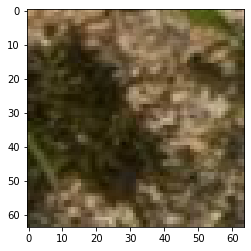

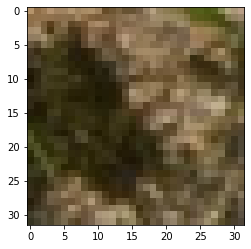

/content/Data_set_Train_x2/720/patch_716_13_29.jpg
/content/Data_set_Train_x2/720/patch_716_11_4.jpg
/content/Data_set_Train_x2/720/patch_716_6_9.jpg
/content/Data_set_Train_x2/720/patch_716_3_12.jpg
/content/Data_set_Train_x2/720/patch_716_16_30.jpg
/content/Data_set_Train_x2/720/patch_716_6_30.jpg
/content/Data_set_Train_x2/720/patch_716_11_19.jpg
/content/Data_set_Train_x2/720/patch_716_13_5.jpg
/content/Data_set_Train_x2/720/patch_716_17_9.jpg
/content/Data_set_Train_x2/720/patch_716_13_26.jpg
/content/Data_set_Train_x2/720/patch_716_9_18.jpg
/content/Data_set_Train_x2/720/patch_716_15_11.jpg
/content/Data_set_Train_x2/720/patch_716_16_15.jpg
/content/Data_set_Train_x2/720/patch_716_6_18.jpg
/content/Data_set_Train_x2/720/patch_716_4_9.jpg
/content/Data_set_Train_x2/720/patch_716_10_12.jpg
/content/Data_set_Train_x2/720/patch_716_18_3.jpg
/content/Data_set_Train_x2/720/patch_716_5_14.jpg
/content/Data_set_Train_x2/720/patch_716_17_14.jpg
/content/Data_set_Train_x2/720/patch_716_12_

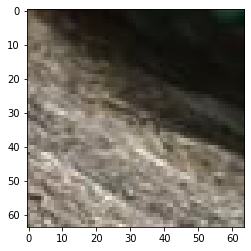

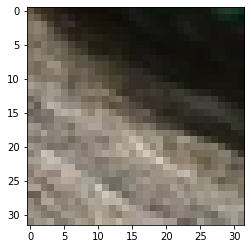

/content/Data_set_Train_x2/720/patch_717_12_14.jpg
/content/Data_set_Train_x2/720/patch_714_9_12.jpg
/content/Data_set_Train_x2/720/patch_714_8_27.jpg
/content/Data_set_Train_x2/720/patch_713_16_12.jpg
/content/Data_set_Train_x2/720/patch_713_18_24.jpg
/content/Data_set_Train_x2/720/patch_714_4_21.jpg
/content/Data_set_Train_x2/720/patch_714_2_24.jpg
/content/Data_set_Train_x2/720/patch_713_17_2.jpg
/content/Data_set_Train_x2/720/patch_714_0_23.jpg
/content/Data_set_Train_x2/720/patch_714_2_23.jpg
/content/Data_set_Train_x2/720/patch_714_9_16.jpg
/content/Data_set_Train_x2/720/patch_713_17_19.jpg
/content/Data_set_Train_x2/720/patch_713_18_10.jpg
/content/Data_set_Train_x2/720/patch_714_2_16.jpg
/content/Data_set_Train_x2/720/patch_713_17_29.jpg
/content/Data_set_Train_x2/720/patch_713_20_28.jpg
/content/Data_set_Train_x2/720/patch_713_18_1.jpg
/content/Data_set_Train_x2/720/patch_713_17_26.jpg
/content/Data_set_Train_x2/720/patch_714_1_12.jpg
/content/Data_set_Train_x2/720/patch_714_8

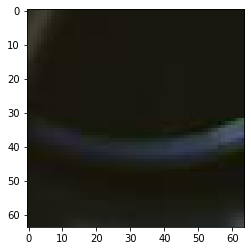

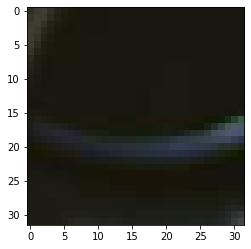

/content/Data_set_Train_x2/720/patch_715_4_17.jpg
/content/Data_set_Train_x2/720/patch_714_14_12.jpg
/content/Data_set_Train_x2/720/patch_714_17_26.jpg
/content/Data_set_Train_x2/720/patch_715_1_17.jpg
/content/Data_set_Train_x2/720/patch_714_18_28.jpg
/content/Data_set_Train_x2/720/patch_714_12_6.jpg
/content/Data_set_Train_x2/720/patch_714_12_26.jpg
/content/Data_set_Train_x2/720/patch_714_10_22.jpg
/content/Data_set_Train_x2/720/patch_715_4_11.jpg
/content/Data_set_Train_x2/720/patch_714_18_24.jpg
/content/Data_set_Train_x2/720/patch_715_2_8.jpg
/content/Data_set_Train_x2/720/patch_714_12_7.jpg
/content/Data_set_Train_x2/720/patch_715_4_28.jpg
/content/Data_set_Train_x2/720/patch_714_15_2.jpg
/content/Data_set_Train_x2/720/patch_714_19_12.jpg
/content/Data_set_Train_x2/720/patch_714_13_18.jpg
/content/Data_set_Train_x2/720/patch_715_5_3.jpg
/content/Data_set_Train_x2/720/patch_714_11_4.jpg
/content/Data_set_Train_x2/720/patch_714_14_22.jpg
/content/Data_set_Train_x2/720/patch_715_1_

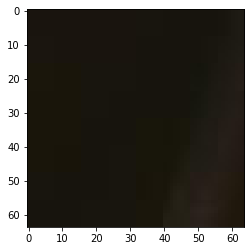

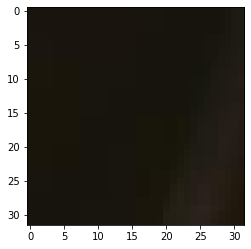

/content/Data_set_Train_x2/720/patch_715_18_6.jpg
/content/Data_set_Train_x2/720/patch_712_16_25.jpg
/content/Data_set_Train_x2/720/patch_712_9_21.jpg
/content/Data_set_Train_x2/720/patch_712_19_26.jpg
/content/Data_set_Train_x2/720/patch_712_7_26.jpg
/content/Data_set_Train_x2/720/patch_712_7_21.jpg
/content/Data_set_Train_x2/720/patch_712_17_2.jpg
/content/Data_set_Train_x2/720/patch_712_10_26.jpg
/content/Data_set_Train_x2/720/patch_712_11_5.jpg
/content/Data_set_Train_x2/720/patch_712_18_25.jpg
/content/Data_set_Train_x2/720/patch_712_8_24.jpg
/content/Data_set_Train_x2/720/patch_712_14_8.jpg
/content/Data_set_Train_x2/720/patch_712_8_10.jpg
/content/Data_set_Train_x2/720/patch_712_11_30.jpg
/content/Data_set_Train_x2/720/patch_712_14_29.jpg
/content/Data_set_Train_x2/720/patch_712_19_20.jpg
/content/Data_set_Train_x2/720/patch_712_7_14.jpg
/content/Data_set_Train_x2/720/patch_712_9_0.jpg
/content/Data_set_Train_x2/720/patch_712_20_7.jpg
/content/Data_set_Train_x2/720/patch_712_16_

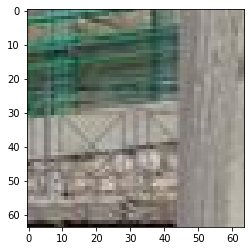

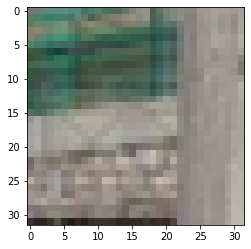

/content/Data_set_Train_x2/720/patch_713_9_16.jpg
/content/Data_set_Train_x2/720/patch_713_5_7.jpg
/content/Data_set_Train_x2/720/patch_713_13_20.jpg
/content/Data_set_Train_x2/720/patch_713_2_18.jpg
/content/Data_set_Train_x2/720/patch_713_4_23.jpg
/content/Data_set_Train_x2/720/patch_713_13_12.jpg
/content/Data_set_Train_x2/720/patch_713_2_24.jpg
/content/Data_set_Train_x2/720/patch_713_3_19.jpg
/content/Data_set_Train_x2/720/patch_713_14_24.jpg
/content/Data_set_Train_x2/720/patch_713_3_11.jpg
/content/Data_set_Train_x2/720/patch_713_1_28.jpg
/content/Data_set_Train_x2/720/patch_713_15_4.jpg
/content/Data_set_Train_x2/720/patch_713_5_24.jpg
/content/Data_set_Train_x2/720/patch_713_6_15.jpg
/content/Data_set_Train_x2/720/patch_713_5_17.jpg
/content/Data_set_Train_x2/720/patch_713_3_14.jpg
/content/Data_set_Train_x2/720/patch_713_5_5.jpg
/content/Data_set_Train_x2/720/patch_713_1_16.jpg
/content/Data_set_Train_x2/720/patch_713_13_17.jpg
/content/Data_set_Train_x2/720/patch_713_14_23.j

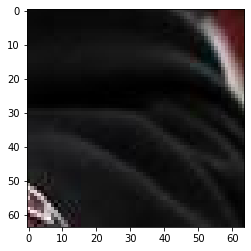

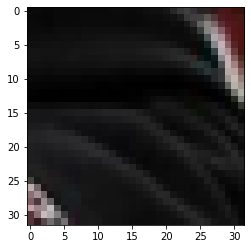

/content/Data_set_Train_x2/720/patch_714_9_19.jpg
/content/Data_set_Train_x2/720/patch_710_21_10.jpg
/content/Data_set_Train_x2/720/patch_710_30_11.jpg
/content/Data_set_Train_x2/720/patch_710_29_18.jpg
/content/Data_set_Train_x2/720/patch_710_25_15.jpg
/content/Data_set_Train_x2/720/patch_711_1_13.jpg
/content/Data_set_Train_x2/720/patch_710_20_14.jpg
/content/Data_set_Train_x2/720/patch_711_6_8.jpg
/content/Data_set_Train_x2/720/patch_711_3_22.jpg
/content/Data_set_Train_x2/720/patch_711_0_24.jpg
/content/Data_set_Train_x2/720/patch_710_21_19.jpg
/content/Data_set_Train_x2/720/patch_711_4_17.jpg
/content/Data_set_Train_x2/720/patch_711_6_28.jpg
/content/Data_set_Train_x2/720/patch_710_23_17.jpg
/content/Data_set_Train_x2/720/patch_710_29_17.jpg
/content/Data_set_Train_x2/720/patch_711_3_16.jpg
/content/Data_set_Train_x2/720/patch_710_30_4.jpg
/content/Data_set_Train_x2/720/patch_711_3_15.jpg
/content/Data_set_Train_x2/720/patch_711_6_22.jpg
/content/Data_set_Train_x2/720/patch_710_27

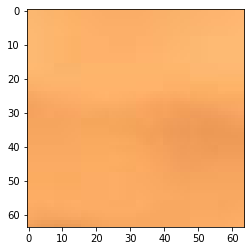

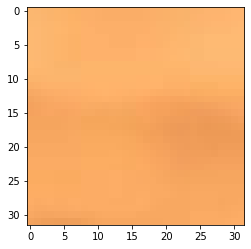

/content/Data_set_Train_x2/720/patch_711_11_17.jpg
/content/Data_set_Train_x2/720/patch_712_1_12.jpg
/content/Data_set_Train_x2/720/patch_711_20_22.jpg
/content/Data_set_Train_x2/720/patch_711_19_5.jpg
/content/Data_set_Train_x2/720/patch_711_15_15.jpg
/content/Data_set_Train_x2/720/patch_712_0_18.jpg
/content/Data_set_Train_x2/720/patch_712_0_25.jpg
/content/Data_set_Train_x2/720/patch_712_3_19.jpg
/content/Data_set_Train_x2/720/patch_711_17_3.jpg
/content/Data_set_Train_x2/720/patch_711_17_16.jpg
/content/Data_set_Train_x2/720/patch_711_13_17.jpg
/content/Data_set_Train_x2/720/patch_712_1_29.jpg
/content/Data_set_Train_x2/720/patch_711_13_14.jpg
/content/Data_set_Train_x2/720/patch_712_2_23.jpg
/content/Data_set_Train_x2/720/patch_711_12_12.jpg
/content/Data_set_Train_x2/720/patch_712_1_13.jpg
/content/Data_set_Train_x2/720/patch_711_8_28.jpg
/content/Data_set_Train_x2/720/patch_711_11_8.jpg
/content/Data_set_Train_x2/720/patch_711_19_15.jpg
/content/Data_set_Train_x2/720/patch_711_9

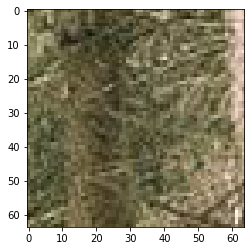

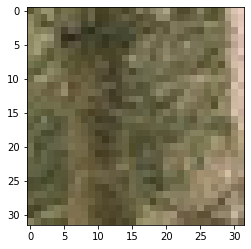

/content/Data_set_Train_x2/720/patch_712_5_22.jpg
/content/Data_set_Train_x2/720/patch_710_9_9.jpg
/content/Data_set_Train_x2/720/patch_710_2_18.jpg
/content/Data_set_Train_x2/720/patch_710_9_13.jpg
/content/Data_set_Train_x2/720/patch_710_1_0.jpg
/content/Data_set_Train_x2/720/patch_710_0_6.jpg
/content/Data_set_Train_x2/720/patch_710_4_8.jpg
/content/Data_set_Train_x2/720/patch_710_11_12.jpg
/content/Data_set_Train_x2/720/patch_710_0_11.jpg
/content/Data_set_Train_x2/720/patch_710_9_19.jpg
/content/Data_set_Train_x2/720/patch_710_2_17.jpg
/content/Data_set_Train_x2/720/patch_710_7_12.jpg
/content/Data_set_Train_x2/720/patch_710_5_12.jpg
/content/Data_set_Train_x2/720/patch_710_19_7.jpg
/content/Data_set_Train_x2/720/patch_710_11_9.jpg
/content/Data_set_Train_x2/720/patch_710_0_16.jpg
/content/Data_set_Train_x2/720/patch_710_4_17.jpg
/content/Data_set_Train_x2/720/patch_710_2_20.jpg
/content/Data_set_Train_x2/720/patch_710_11_5.jpg
/content/Data_set_Train_x2/720/patch_710_0_8.jpg
/con

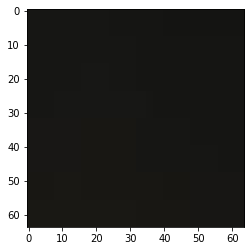

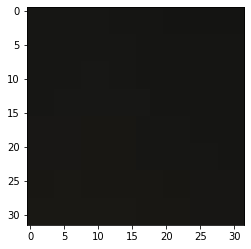

/content/Data_set_Train_x2/720/patch_711_0_30.jpg
/content/Data_set_Train_x2/720/patch_710_23_7.jpg
/content/Data_set_Train_x2/720/patch_710_27_14.jpg
/content/Data_set_Train_x2/720/patch_710_23_3.jpg
/content/Data_set_Train_x2/720/patch_711_6_12.jpg
/content/Data_set_Train_x2/720/patch_711_3_19.jpg
/content/Data_set_Train_x2/720/patch_710_29_16.jpg
/content/Data_set_Train_x2/720/patch_711_2_5.jpg
/content/Data_set_Train_x2/720/patch_710_24_13.jpg
/content/Data_set_Train_x2/720/patch_711_0_7.jpg
/content/Data_set_Train_x2/720/patch_711_1_8.jpg
/content/Data_set_Train_x2/720/patch_710_23_15.jpg
/content/Data_set_Train_x2/720/patch_710_25_11.jpg
/content/Data_set_Train_x2/720/patch_711_6_18.jpg
/content/Data_set_Train_x2/720/patch_711_4_21.jpg
/content/Data_set_Train_x2/720/patch_710_29_4.jpg
/content/Data_set_Train_x2/720/patch_710_23_14.jpg
/content/Data_set_Train_x2/720/patch_711_6_15.jpg
/content/Data_set_Train_x2/720/patch_710_29_3.jpg
/content/Data_set_Train_x2/720/patch_711_0_29.j

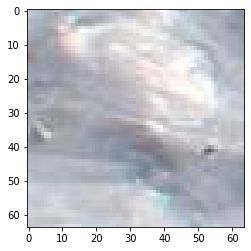

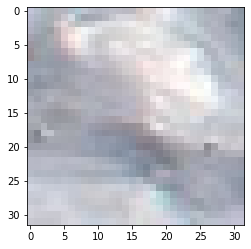

/content/Data_set_Train_x2/730/patch_729_14_3.jpg
/content/Data_set_Train_x2/730/patch_729_0_28.jpg
/content/Data_set_Train_x2/730/patch_729_5_19.jpg
/content/Data_set_Train_x2/730/patch_729_3_5.jpg
/content/Data_set_Train_x2/730/patch_729_11_9.jpg
/content/Data_set_Train_x2/730/patch_729_2_10.jpg
/content/Data_set_Train_x2/730/patch_729_6_14.jpg
/content/Data_set_Train_x2/730/patch_729_7_15.jpg
/content/Data_set_Train_x2/730/patch_729_0_27.jpg
/content/Data_set_Train_x2/730/patch_729_13_10.jpg
/content/Data_set_Train_x2/730/patch_729_5_23.jpg
/content/Data_set_Train_x2/730/patch_729_10_9.jpg
/content/Data_set_Train_x2/730/patch_729_16_11.jpg
/content/Data_set_Train_x2/730/patch_729_12_30.jpg
/content/Data_set_Train_x2/730/patch_729_1_19.jpg
/content/Data_set_Train_x2/730/patch_729_11_13.jpg
/content/Data_set_Train_x2/730/patch_729_11_17.jpg
/content/Data_set_Train_x2/730/patch_729_5_20.jpg
/content/Data_set_Train_x2/730/patch_729_15_21.jpg
/content/Data_set_Train_x2/730/patch_729_9_30

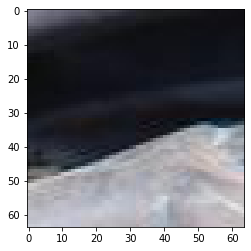

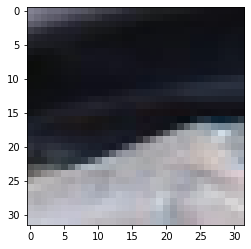

/content/Data_set_Train_x2/730/patch_729_19_1.jpg
/content/Data_set_Train_x2/730/patch_727_1_21.jpg
/content/Data_set_Train_x2/730/patch_727_4_17.jpg
/content/Data_set_Train_x2/730/patch_727_12_7.jpg
/content/Data_set_Train_x2/730/patch_727_9_26.jpg
/content/Data_set_Train_x2/730/patch_727_11_28.jpg
/content/Data_set_Train_x2/730/patch_727_1_26.jpg
/content/Data_set_Train_x2/730/patch_726_20_5.jpg
/content/Data_set_Train_x2/730/patch_726_20_26.jpg
/content/Data_set_Train_x2/730/patch_726_20_19.jpg
/content/Data_set_Train_x2/730/patch_727_14_0.jpg
/content/Data_set_Train_x2/730/patch_727_1_0.jpg
/content/Data_set_Train_x2/730/patch_727_2_27.jpg
/content/Data_set_Train_x2/730/patch_727_5_6.jpg
/content/Data_set_Train_x2/730/patch_727_2_19.jpg
/content/Data_set_Train_x2/730/patch_727_8_23.jpg
/content/Data_set_Train_x2/730/patch_727_10_24.jpg
/content/Data_set_Train_x2/730/patch_727_12_13.jpg
/content/Data_set_Train_x2/730/patch_727_6_29.jpg
/content/Data_set_Train_x2/730/patch_727_0_18.j

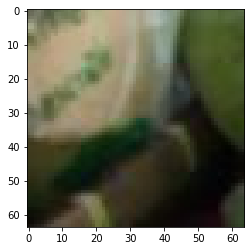

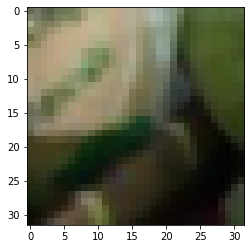

/content/Data_set_Train_x2/730/patch_728_4_8.jpg
/content/Data_set_Train_x2/730/patch_728_5_7.jpg
/content/Data_set_Train_x2/730/patch_728_0_30.jpg
/content/Data_set_Train_x2/730/patch_727_19_13.jpg
/content/Data_set_Train_x2/730/patch_728_4_14.jpg
/content/Data_set_Train_x2/730/patch_728_5_3.jpg
/content/Data_set_Train_x2/730/patch_728_3_18.jpg
/content/Data_set_Train_x2/730/patch_727_18_17.jpg
/content/Data_set_Train_x2/730/patch_727_21_12.jpg
/content/Data_set_Train_x2/730/patch_727_20_10.jpg
/content/Data_set_Train_x2/730/patch_727_20_17.jpg
/content/Data_set_Train_x2/730/patch_728_2_10.jpg
/content/Data_set_Train_x2/730/patch_728_0_24.jpg
/content/Data_set_Train_x2/730/patch_727_21_18.jpg
/content/Data_set_Train_x2/730/patch_728_2_13.jpg
/content/Data_set_Train_x2/730/patch_727_18_27.jpg
/content/Data_set_Train_x2/730/patch_727_23_27.jpg
/content/Data_set_Train_x2/730/patch_728_4_26.jpg
/content/Data_set_Train_x2/730/patch_727_18_21.jpg
/content/Data_set_Train_x2/730/patch_727_21_

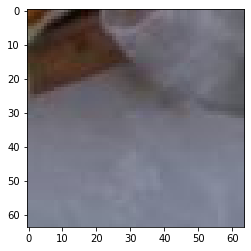

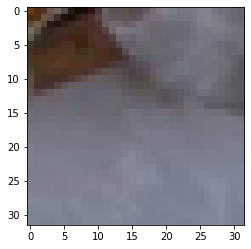

/content/Data_set_Train_x2/730/patch_728_10_1.jpg
/content/Data_set_Train_x2/730/patch_726_2_7.jpg
/content/Data_set_Train_x2/730/patch_725_15_0.jpg
/content/Data_set_Train_x2/730/patch_725_16_2.jpg
/content/Data_set_Train_x2/730/patch_725_11_8.jpg
/content/Data_set_Train_x2/730/patch_725_10_7.jpg
/content/Data_set_Train_x2/730/patch_725_11_21.jpg
/content/Data_set_Train_x2/730/patch_725_11_7.jpg
/content/Data_set_Train_x2/730/patch_726_2_23.jpg
/content/Data_set_Train_x2/730/patch_725_17_17.jpg
/content/Data_set_Train_x2/730/patch_726_4_8.jpg
/content/Data_set_Train_x2/730/patch_725_19_15.jpg
/content/Data_set_Train_x2/730/patch_726_1_28.jpg
/content/Data_set_Train_x2/730/patch_726_3_16.jpg
/content/Data_set_Train_x2/730/patch_726_2_28.jpg
/content/Data_set_Train_x2/730/patch_725_9_16.jpg
/content/Data_set_Train_x2/730/patch_725_11_17.jpg
/content/Data_set_Train_x2/730/patch_725_17_12.jpg
/content/Data_set_Train_x2/730/patch_726_4_21.jpg
/content/Data_set_Train_x2/730/patch_725_13_18.

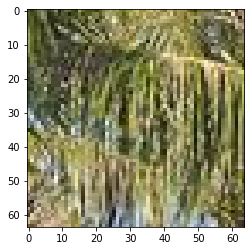

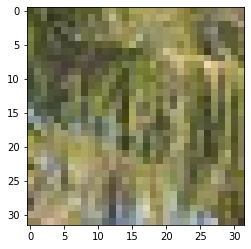

/content/Data_set_Train_x2/730/patch_726_8_23.jpg
/content/Data_set_Train_x2/730/patch_726_10_3.jpg
/content/Data_set_Train_x2/730/patch_726_13_18.jpg
/content/Data_set_Train_x2/730/patch_726_13_30.jpg
/content/Data_set_Train_x2/730/patch_726_15_1.jpg
/content/Data_set_Train_x2/730/patch_726_11_6.jpg
/content/Data_set_Train_x2/730/patch_726_7_27.jpg
/content/Data_set_Train_x2/730/patch_726_10_20.jpg
/content/Data_set_Train_x2/730/patch_726_11_5.jpg
/content/Data_set_Train_x2/730/patch_726_17_24.jpg
/content/Data_set_Train_x2/730/patch_726_19_15.jpg
/content/Data_set_Train_x2/730/patch_726_18_27.jpg
/content/Data_set_Train_x2/730/patch_726_10_28.jpg
/content/Data_set_Train_x2/730/patch_726_13_5.jpg
/content/Data_set_Train_x2/730/patch_726_5_16.jpg
/content/Data_set_Train_x2/730/patch_726_8_27.jpg
/content/Data_set_Train_x2/730/patch_726_12_5.jpg
/content/Data_set_Train_x2/730/patch_726_15_11.jpg
/content/Data_set_Train_x2/730/patch_726_15_4.jpg
/content/Data_set_Train_x2/730/patch_726_1

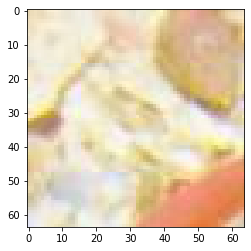

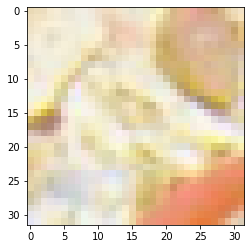

/content/Data_set_Train_x2/730/patch_727_5_14.jpg
/content/Data_set_Train_x2/730/patch_723_29_3.jpg
/content/Data_set_Train_x2/730/patch_724_7_12.jpg
/content/Data_set_Train_x2/730/patch_724_5_30.jpg
/content/Data_set_Train_x2/730/patch_723_23_18.jpg
/content/Data_set_Train_x2/730/patch_724_4_17.jpg
/content/Data_set_Train_x2/730/patch_724_3_22.jpg
/content/Data_set_Train_x2/730/patch_724_7_20.jpg
/content/Data_set_Train_x2/730/patch_723_16_11.jpg
/content/Data_set_Train_x2/730/patch_723_17_4.jpg
/content/Data_set_Train_x2/730/patch_723_22_0.jpg
/content/Data_set_Train_x2/730/patch_724_4_19.jpg
/content/Data_set_Train_x2/730/patch_723_18_7.jpg
/content/Data_set_Train_x2/730/patch_724_6_23.jpg
/content/Data_set_Train_x2/730/patch_724_0_19.jpg
/content/Data_set_Train_x2/730/patch_724_3_20.jpg
/content/Data_set_Train_x2/730/patch_723_28_5.jpg
/content/Data_set_Train_x2/730/patch_723_27_15.jpg
/content/Data_set_Train_x2/730/patch_724_7_13.jpg
/content/Data_set_Train_x2/730/patch_723_18_4.j

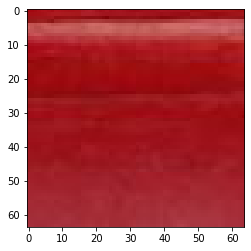

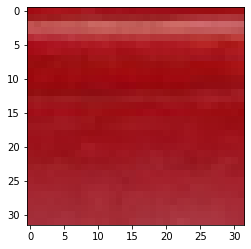

/content/Data_set_Train_x2/730/patch_724_13_12.jpg
/content/Data_set_Train_x2/730/patch_725_2_15.jpg
/content/Data_set_Train_x2/730/patch_725_2_23.jpg
/content/Data_set_Train_x2/730/patch_725_1_15.jpg
/content/Data_set_Train_x2/730/patch_724_14_21.jpg
/content/Data_set_Train_x2/730/patch_725_6_24.jpg
/content/Data_set_Train_x2/730/patch_725_5_12.jpg
/content/Data_set_Train_x2/730/patch_724_16_25.jpg
/content/Data_set_Train_x2/730/patch_724_12_30.jpg
/content/Data_set_Train_x2/730/patch_725_3_29.jpg
/content/Data_set_Train_x2/730/patch_725_0_13.jpg
/content/Data_set_Train_x2/730/patch_724_9_29.jpg
/content/Data_set_Train_x2/730/patch_724_11_18.jpg
/content/Data_set_Train_x2/730/patch_724_13_19.jpg
/content/Data_set_Train_x2/730/patch_725_0_28.jpg
/content/Data_set_Train_x2/730/patch_725_5_17.jpg
/content/Data_set_Train_x2/730/patch_725_4_5.jpg
/content/Data_set_Train_x2/730/patch_725_3_27.jpg
/content/Data_set_Train_x2/730/patch_725_7_16.jpg
/content/Data_set_Train_x2/730/patch_725_3_30

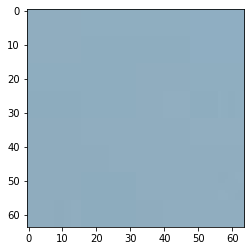

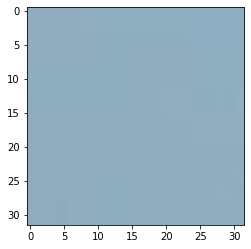

/content/Data_set_Train_x2/730/patch_725_10_4.jpg
/content/Data_set_Train_x2/730/patch_722_7_15.jpg
/content/Data_set_Train_x2/730/patch_722_10_16.jpg
/content/Data_set_Train_x2/730/patch_722_10_27.jpg
/content/Data_set_Train_x2/730/patch_722_9_18.jpg
/content/Data_set_Train_x2/730/patch_722_8_14.jpg
/content/Data_set_Train_x2/730/patch_722_5_14.jpg
/content/Data_set_Train_x2/730/patch_722_13_3.jpg
/content/Data_set_Train_x2/730/patch_722_1_3.jpg
/content/Data_set_Train_x2/730/patch_722_5_29.jpg
/content/Data_set_Train_x2/730/patch_722_3_9.jpg
/content/Data_set_Train_x2/730/patch_722_6_25.jpg
/content/Data_set_Train_x2/730/patch_722_0_23.jpg
/content/Data_set_Train_x2/730/patch_722_13_21.jpg
/content/Data_set_Train_x2/730/patch_722_6_9.jpg
/content/Data_set_Train_x2/730/patch_722_3_0.jpg
/content/Data_set_Train_x2/730/patch_722_3_13.jpg
/content/Data_set_Train_x2/730/patch_722_4_19.jpg
/content/Data_set_Train_x2/730/patch_722_3_22.jpg
/content/Data_set_Train_x2/730/patch_722_10_4.jpg
/

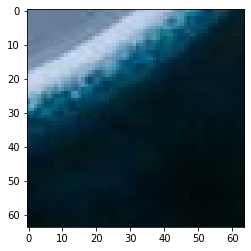

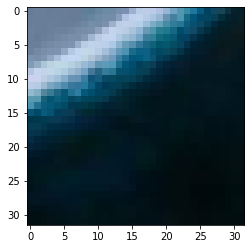

/content/Data_set_Train_x2/730/patch_723_0_3.jpg
/content/Data_set_Train_x2/730/patch_722_16_25.jpg
/content/Data_set_Train_x2/730/patch_723_8_2.jpg
/content/Data_set_Train_x2/730/patch_722_20_18.jpg
/content/Data_set_Train_x2/730/patch_722_16_27.jpg
/content/Data_set_Train_x2/730/patch_723_8_17.jpg
/content/Data_set_Train_x2/730/patch_722_20_4.jpg
/content/Data_set_Train_x2/730/patch_722_19_17.jpg
/content/Data_set_Train_x2/730/patch_723_1_2.jpg
/content/Data_set_Train_x2/730/patch_722_17_5.jpg
/content/Data_set_Train_x2/730/patch_723_4_19.jpg
/content/Data_set_Train_x2/730/patch_723_7_20.jpg
/content/Data_set_Train_x2/730/patch_723_11_12.jpg
/content/Data_set_Train_x2/730/patch_722_16_21.jpg
/content/Data_set_Train_x2/730/patch_723_0_7.jpg
/content/Data_set_Train_x2/730/patch_723_12_6.jpg
/content/Data_set_Train_x2/730/patch_722_20_16.jpg
/content/Data_set_Train_x2/730/patch_722_16_2.jpg
/content/Data_set_Train_x2/730/patch_722_16_15.jpg
/content/Data_set_Train_x2/730/patch_722_17_18

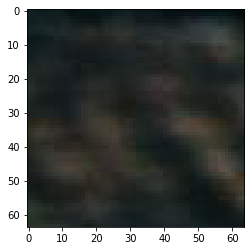

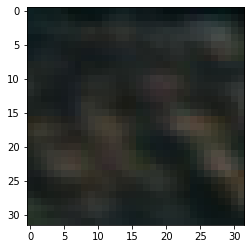

/content/Data_set_Train_x2/730/patch_723_28_2.jpg
/content/Data_set_Train_x2/730/patch_721_2_12.jpg
/content/Data_set_Train_x2/730/patch_720_29_20.jpg
/content/Data_set_Train_x2/730/patch_721_1_15.jpg
/content/Data_set_Train_x2/730/patch_720_15_4.jpg
/content/Data_set_Train_x2/730/patch_720_26_11.jpg
/content/Data_set_Train_x2/730/patch_720_22_12.jpg
/content/Data_set_Train_x2/730/patch_720_13_2.jpg
/content/Data_set_Train_x2/730/patch_720_27_0.jpg
/content/Data_set_Train_x2/730/patch_721_1_19.jpg
/content/Data_set_Train_x2/730/patch_720_24_17.jpg
/content/Data_set_Train_x2/730/patch_721_1_4.jpg
/content/Data_set_Train_x2/730/patch_721_1_30.jpg
/content/Data_set_Train_x2/730/patch_721_0_28.jpg
/content/Data_set_Train_x2/730/patch_720_16_13.jpg
/content/Data_set_Train_x2/730/patch_720_16_0.jpg
/content/Data_set_Train_x2/730/patch_720_20_17.jpg
/content/Data_set_Train_x2/730/patch_720_25_7.jpg
/content/Data_set_Train_x2/730/patch_720_18_1.jpg
/content/Data_set_Train_x2/730/patch_720_23_1

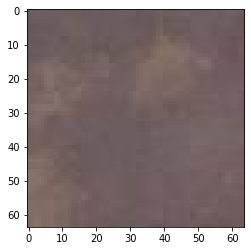

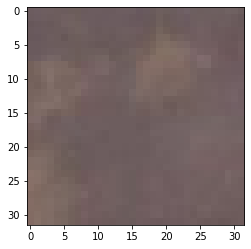

/content/Data_set_Train_x2/730/patch_721_12_4.jpg
/content/Data_set_Train_x2/730/patch_721_7_26.jpg
/content/Data_set_Train_x2/730/patch_721_5_26.jpg
/content/Data_set_Train_x2/730/patch_721_8_13.jpg
/content/Data_set_Train_x2/730/patch_721_17_11.jpg
/content/Data_set_Train_x2/730/patch_721_13_14.jpg
/content/Data_set_Train_x2/730/patch_721_10_23.jpg
/content/Data_set_Train_x2/730/patch_721_6_2.jpg
/content/Data_set_Train_x2/730/patch_721_10_20.jpg
/content/Data_set_Train_x2/730/patch_721_18_8.jpg
/content/Data_set_Train_x2/730/patch_721_19_1.jpg
/content/Data_set_Train_x2/730/patch_721_17_8.jpg
/content/Data_set_Train_x2/730/patch_721_7_15.jpg
/content/Data_set_Train_x2/730/patch_721_4_19.jpg
/content/Data_set_Train_x2/730/patch_721_19_20.jpg
/content/Data_set_Train_x2/730/patch_721_14_16.jpg
/content/Data_set_Train_x2/730/patch_721_13_8.jpg
/content/Data_set_Train_x2/730/patch_721_19_18.jpg
/content/Data_set_Train_x2/730/patch_721_9_28.jpg
/content/Data_set_Train_x2/730/patch_721_12_

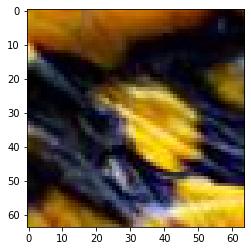

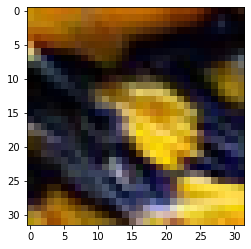

/content/Data_set_Train_x2/730/patch_722_12_21.jpg
/content/Data_set_Train_x2/730/patch_720_3_2.jpg
/content/Data_set_Train_x2/730/patch_720_10_17.jpg
/content/Data_set_Train_x2/730/patch_720_5_19.jpg
/content/Data_set_Train_x2/730/patch_720_9_3.jpg
/content/Data_set_Train_x2/730/patch_720_8_1.jpg
/content/Data_set_Train_x2/730/patch_720_1_18.jpg
/content/Data_set_Train_x2/730/patch_720_11_5.jpg
/content/Data_set_Train_x2/730/patch_720_3_1.jpg
/content/Data_set_Train_x2/730/patch_720_4_13.jpg
/content/Data_set_Train_x2/730/patch_720_9_17.jpg
/content/Data_set_Train_x2/730/patch_720_3_18.jpg
/content/Data_set_Train_x2/730/patch_720_1_17.jpg
/content/Data_set_Train_x2/730/patch_720_4_9.jpg
/content/Data_set_Train_x2/730/patch_720_7_13.jpg
/content/Data_set_Train_x2/730/patch_720_7_16.jpg
/content/Data_set_Train_x2/730/patch_720_0_6.jpg
/content/Data_set_Train_x2/730/patch_720_6_2.jpg
/content/Data_set_Train_x2/730/patch_720_10_18.jpg
/content/Data_set_Train_x2/730/patch_720_3_16.jpg
/con

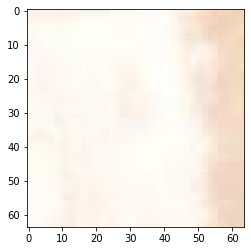

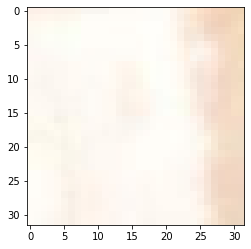

/content/Data_set_Train_x2/730/patch_721_1_20.jpg
/content/Data_set_Train_x2/730/patch_720_17_0.jpg
/content/Data_set_Train_x2/730/patch_720_30_5.jpg
/content/Data_set_Train_x2/730/patch_720_25_9.jpg
/content/Data_set_Train_x2/730/patch_720_15_6.jpg
/content/Data_set_Train_x2/730/patch_720_23_4.jpg
/content/Data_set_Train_x2/730/patch_720_26_5.jpg
/content/Data_set_Train_x2/730/patch_720_15_12.jpg
/content/Data_set_Train_x2/730/patch_720_27_10.jpg
/content/Data_set_Train_x2/730/patch_721_0_0.jpg
/content/Data_set_Train_x2/730/patch_721_3_12.jpg
/content/Data_set_Train_x2/730/patch_721_0_16.jpg
/content/Data_set_Train_x2/730/patch_720_22_10.jpg
/content/Data_set_Train_x2/730/patch_720_19_14.jpg
/content/Data_set_Train_x2/730/patch_720_13_5.jpg
/content/Data_set_Train_x2/730/patch_720_14_10.jpg
/content/Data_set_Train_x2/730/patch_720_22_17.jpg
/content/Data_set_Train_x2/730/patch_720_21_20.jpg
/content/Data_set_Train_x2/730/patch_720_23_14.jpg
/content/Data_set_Train_x2/730/patch_720_17

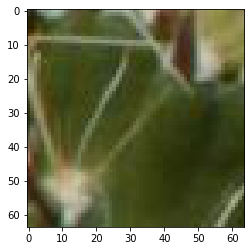

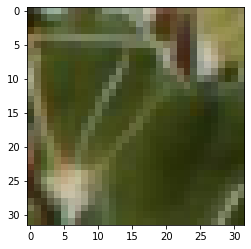

/content/Data_set_Train_x2/740/patch_739_5_27.jpg
/content/Data_set_Train_x2/740/patch_739_1_14.jpg
/content/Data_set_Train_x2/740/patch_739_5_8.jpg
/content/Data_set_Train_x2/740/patch_739_15_0.jpg
/content/Data_set_Train_x2/740/patch_739_10_0.jpg
/content/Data_set_Train_x2/740/patch_739_14_9.jpg
/content/Data_set_Train_x2/740/patch_739_10_10.jpg
/content/Data_set_Train_x2/740/patch_739_2_22.jpg
/content/Data_set_Train_x2/740/patch_739_4_1.jpg
/content/Data_set_Train_x2/740/patch_739_3_14.jpg
/content/Data_set_Train_x2/740/patch_739_8_25.jpg
/content/Data_set_Train_x2/740/patch_739_16_26.jpg
/content/Data_set_Train_x2/740/patch_739_8_22.jpg
/content/Data_set_Train_x2/740/patch_739_15_6.jpg
/content/Data_set_Train_x2/740/patch_739_8_4.jpg
/content/Data_set_Train_x2/740/patch_739_11_11.jpg
/content/Data_set_Train_x2/740/patch_739_9_9.jpg
/content/Data_set_Train_x2/740/patch_739_15_27.jpg
/content/Data_set_Train_x2/740/patch_739_16_5.jpg
/content/Data_set_Train_x2/740/patch_739_13_14.jpg

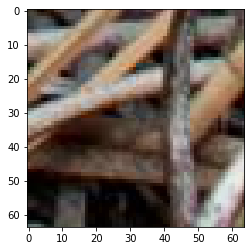

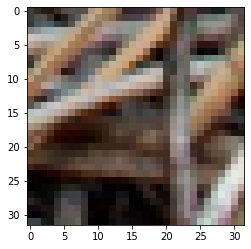

/content/Data_set_Train_x2/740/patch_739_20_20.jpg
/content/Data_set_Train_x2/740/patch_736_23_26.jpg
/content/Data_set_Train_x2/740/patch_737_0_9.jpg
/content/Data_set_Train_x2/740/patch_737_8_12.jpg
/content/Data_set_Train_x2/740/patch_736_21_4.jpg
/content/Data_set_Train_x2/740/patch_737_4_13.jpg
/content/Data_set_Train_x2/740/patch_736_21_17.jpg
/content/Data_set_Train_x2/740/patch_737_4_16.jpg
/content/Data_set_Train_x2/740/patch_737_6_5.jpg
/content/Data_set_Train_x2/740/patch_737_12_16.jpg
/content/Data_set_Train_x2/740/patch_737_4_4.jpg
/content/Data_set_Train_x2/740/patch_736_18_24.jpg
/content/Data_set_Train_x2/740/patch_736_21_5.jpg
/content/Data_set_Train_x2/740/patch_736_18_22.jpg
/content/Data_set_Train_x2/740/patch_736_19_25.jpg
/content/Data_set_Train_x2/740/patch_736_23_4.jpg
/content/Data_set_Train_x2/740/patch_737_2_6.jpg
/content/Data_set_Train_x2/740/patch_736_22_10.jpg
/content/Data_set_Train_x2/740/patch_737_14_7.jpg
/content/Data_set_Train_x2/740/patch_737_3_15.

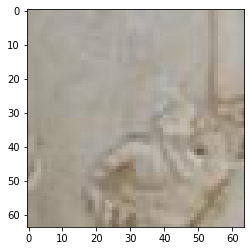

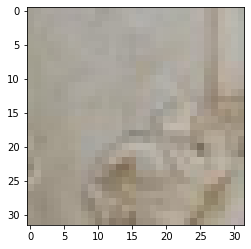

/content/Data_set_Train_x2/740/patch_737_27_12.jpg
/content/Data_set_Train_x2/740/patch_737_25_2.jpg
/content/Data_set_Train_x2/740/patch_737_30_9.jpg
/content/Data_set_Train_x2/740/patch_737_16_15.jpg
/content/Data_set_Train_x2/740/patch_737_25_18.jpg
/content/Data_set_Train_x2/740/patch_737_15_0.jpg
/content/Data_set_Train_x2/740/patch_738_3_14.jpg
/content/Data_set_Train_x2/740/patch_737_19_17.jpg
/content/Data_set_Train_x2/740/patch_737_25_14.jpg
/content/Data_set_Train_x2/740/patch_737_20_9.jpg
/content/Data_set_Train_x2/740/patch_737_15_2.jpg
/content/Data_set_Train_x2/740/patch_737_23_9.jpg
/content/Data_set_Train_x2/740/patch_737_23_7.jpg
/content/Data_set_Train_x2/740/patch_737_18_1.jpg
/content/Data_set_Train_x2/740/patch_738_0_20.jpg
/content/Data_set_Train_x2/740/patch_738_3_13.jpg
/content/Data_set_Train_x2/740/patch_738_1_18.jpg
/content/Data_set_Train_x2/740/patch_738_4_16.jpg
/content/Data_set_Train_x2/740/patch_738_1_12.jpg
/content/Data_set_Train_x2/740/patch_738_0_19

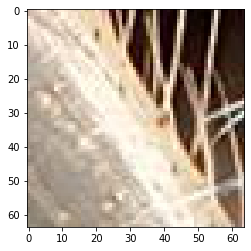

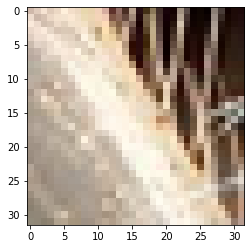

/content/Data_set_Train_x2/740/patch_738_11_9.jpg
/content/Data_set_Train_x2/740/patch_735_13_14.jpg
/content/Data_set_Train_x2/740/patch_736_1_11.jpg
/content/Data_set_Train_x2/740/patch_735_15_5.jpg
/content/Data_set_Train_x2/740/patch_735_16_18.jpg
/content/Data_set_Train_x2/740/patch_736_2_5.jpg
/content/Data_set_Train_x2/740/patch_735_13_13.jpg
/content/Data_set_Train_x2/740/patch_735_12_27.jpg
/content/Data_set_Train_x2/740/patch_735_17_23.jpg
/content/Data_set_Train_x2/740/patch_736_1_1.jpg
/content/Data_set_Train_x2/740/patch_735_12_25.jpg
/content/Data_set_Train_x2/740/patch_735_19_28.jpg
/content/Data_set_Train_x2/740/patch_735_16_24.jpg
/content/Data_set_Train_x2/740/patch_735_9_17.jpg
/content/Data_set_Train_x2/740/patch_735_7_21.jpg
/content/Data_set_Train_x2/740/patch_735_19_23.jpg
/content/Data_set_Train_x2/740/patch_735_20_23.jpg
/content/Data_set_Train_x2/740/patch_736_0_10.jpg
/content/Data_set_Train_x2/740/patch_735_11_2.jpg
/content/Data_set_Train_x2/740/patch_735_1

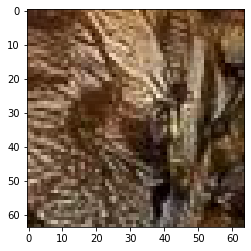

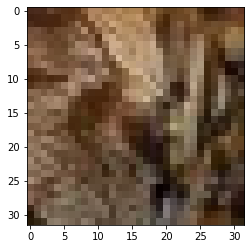

/content/Data_set_Train_x2/740/patch_736_11_18.jpg
/content/Data_set_Train_x2/740/patch_736_11_22.jpg
/content/Data_set_Train_x2/740/patch_736_13_8.jpg
/content/Data_set_Train_x2/740/patch_736_10_29.jpg
/content/Data_set_Train_x2/740/patch_736_8_0.jpg
/content/Data_set_Train_x2/740/patch_736_4_23.jpg
/content/Data_set_Train_x2/740/patch_736_15_0.jpg
/content/Data_set_Train_x2/740/patch_736_5_7.jpg
/content/Data_set_Train_x2/740/patch_736_11_27.jpg
/content/Data_set_Train_x2/740/patch_736_15_13.jpg
/content/Data_set_Train_x2/740/patch_736_6_29.jpg
/content/Data_set_Train_x2/740/patch_736_17_26.jpg
/content/Data_set_Train_x2/740/patch_736_3_24.jpg
/content/Data_set_Train_x2/740/patch_736_6_27.jpg
/content/Data_set_Train_x2/740/patch_736_6_25.jpg
/content/Data_set_Train_x2/740/patch_736_4_18.jpg
/content/Data_set_Train_x2/740/patch_736_9_13.jpg
/content/Data_set_Train_x2/740/patch_736_6_4.jpg
/content/Data_set_Train_x2/740/patch_736_7_1.jpg
/content/Data_set_Train_x2/740/patch_736_6_14.jp

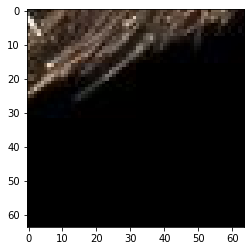

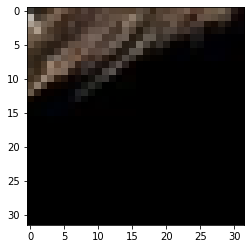

/content/Data_set_Train_x2/740/patch_736_24_25.jpg
/content/Data_set_Train_x2/740/patch_734_3_13.jpg
/content/Data_set_Train_x2/740/patch_733_15_17.jpg
/content/Data_set_Train_x2/740/patch_733_16_12.jpg
/content/Data_set_Train_x2/740/patch_734_3_7.jpg
/content/Data_set_Train_x2/740/patch_734_6_2.jpg
/content/Data_set_Train_x2/740/patch_733_14_29.jpg
/content/Data_set_Train_x2/740/patch_734_11_4.jpg
/content/Data_set_Train_x2/740/patch_734_10_19.jpg
/content/Data_set_Train_x2/740/patch_733_18_16.jpg
/content/Data_set_Train_x2/740/patch_734_6_9.jpg
/content/Data_set_Train_x2/740/patch_734_4_0.jpg
/content/Data_set_Train_x2/740/patch_734_1_13.jpg
/content/Data_set_Train_x2/740/patch_734_7_22.jpg
/content/Data_set_Train_x2/740/patch_734_9_27.jpg
/content/Data_set_Train_x2/740/patch_734_1_25.jpg
/content/Data_set_Train_x2/740/patch_733_15_5.jpg
/content/Data_set_Train_x2/740/patch_734_0_26.jpg
/content/Data_set_Train_x2/740/patch_734_5_10.jpg
/content/Data_set_Train_x2/740/patch_734_2_30.jp

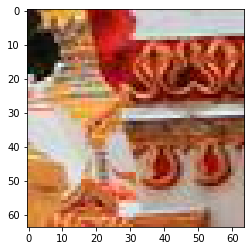

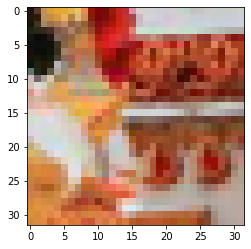

/content/Data_set_Train_x2/740/patch_734_13_25.jpg
/content/Data_set_Train_x2/740/patch_734_14_8.jpg
/content/Data_set_Train_x2/740/patch_734_16_24.jpg
/content/Data_set_Train_x2/740/patch_734_18_2.jpg
/content/Data_set_Train_x2/740/patch_734_14_28.jpg
/content/Data_set_Train_x2/740/patch_734_17_14.jpg
/content/Data_set_Train_x2/740/patch_735_4_22.jpg
/content/Data_set_Train_x2/740/patch_734_18_14.jpg
/content/Data_set_Train_x2/740/patch_734_15_8.jpg
/content/Data_set_Train_x2/740/patch_735_7_10.jpg
/content/Data_set_Train_x2/740/patch_735_4_27.jpg
/content/Data_set_Train_x2/740/patch_734_13_24.jpg
/content/Data_set_Train_x2/740/patch_735_4_23.jpg
/content/Data_set_Train_x2/740/patch_735_2_28.jpg
/content/Data_set_Train_x2/740/patch_735_4_19.jpg
/content/Data_set_Train_x2/740/patch_735_3_28.jpg
/content/Data_set_Train_x2/740/patch_735_5_15.jpg
/content/Data_set_Train_x2/740/patch_734_20_2.jpg
/content/Data_set_Train_x2/740/patch_735_1_27.jpg
/content/Data_set_Train_x2/740/patch_735_1_2

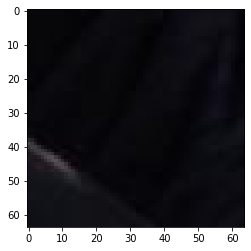

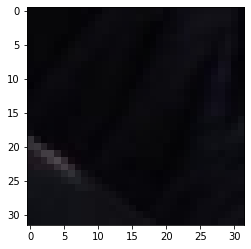

/content/Data_set_Train_x2/740/patch_735_16_15.jpg
/content/Data_set_Train_x2/740/patch_732_13_3.jpg
/content/Data_set_Train_x2/740/patch_732_3_20.jpg
/content/Data_set_Train_x2/740/patch_732_8_30.jpg
/content/Data_set_Train_x2/740/patch_732_4_11.jpg
/content/Data_set_Train_x2/740/patch_732_10_14.jpg
/content/Data_set_Train_x2/740/patch_732_10_21.jpg
/content/Data_set_Train_x2/740/patch_732_10_25.jpg
/content/Data_set_Train_x2/740/patch_732_13_17.jpg
/content/Data_set_Train_x2/740/patch_732_5_26.jpg
/content/Data_set_Train_x2/740/patch_732_11_6.jpg
/content/Data_set_Train_x2/740/patch_732_9_0.jpg
/content/Data_set_Train_x2/740/patch_732_6_28.jpg
/content/Data_set_Train_x2/740/patch_732_8_2.jpg
/content/Data_set_Train_x2/740/patch_732_19_3.jpg
/content/Data_set_Train_x2/740/patch_732_15_26.jpg
/content/Data_set_Train_x2/740/patch_732_16_14.jpg
/content/Data_set_Train_x2/740/patch_732_3_24.jpg
/content/Data_set_Train_x2/740/patch_732_10_5.jpg
/content/Data_set_Train_x2/740/patch_732_17_1

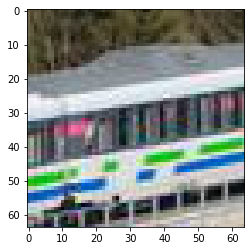

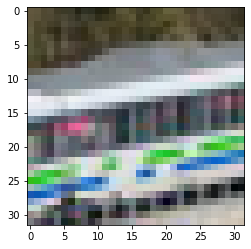

/content/Data_set_Train_x2/740/patch_733_8_24.jpg
/content/Data_set_Train_x2/740/patch_733_7_23.jpg
/content/Data_set_Train_x2/740/patch_733_3_30.jpg
/content/Data_set_Train_x2/740/patch_733_12_7.jpg
/content/Data_set_Train_x2/740/patch_733_14_12.jpg
/content/Data_set_Train_x2/740/patch_733_7_17.jpg
/content/Data_set_Train_x2/740/patch_733_4_10.jpg
/content/Data_set_Train_x2/740/patch_733_5_10.jpg
/content/Data_set_Train_x2/740/patch_733_5_18.jpg
/content/Data_set_Train_x2/740/patch_733_5_24.jpg
/content/Data_set_Train_x2/740/patch_733_7_18.jpg
/content/Data_set_Train_x2/740/patch_733_9_20.jpg
/content/Data_set_Train_x2/740/patch_733_5_8.jpg
/content/Data_set_Train_x2/740/patch_733_10_12.jpg
/content/Data_set_Train_x2/740/patch_732_20_2.jpg
/content/Data_set_Train_x2/740/patch_733_14_13.jpg
/content/Data_set_Train_x2/740/patch_733_3_11.jpg
/content/Data_set_Train_x2/740/patch_733_12_24.jpg
/content/Data_set_Train_x2/740/patch_733_0_4.jpg
/content/Data_set_Train_x2/740/patch_733_2_13.jp

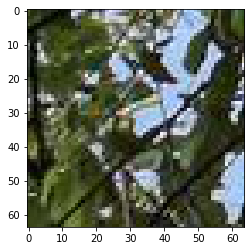

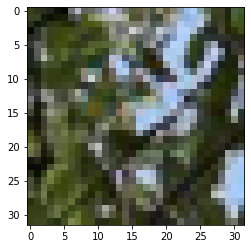

/content/Data_set_Train_x2/740/patch_734_1_27.jpg
/content/Data_set_Train_x2/740/patch_730_20_2.jpg
/content/Data_set_Train_x2/740/patch_730_13_21.jpg
/content/Data_set_Train_x2/740/patch_730_13_0.jpg
/content/Data_set_Train_x2/740/patch_731_7_17.jpg
/content/Data_set_Train_x2/740/patch_730_17_16.jpg
/content/Data_set_Train_x2/740/patch_731_3_24.jpg
/content/Data_set_Train_x2/740/patch_730_18_18.jpg
/content/Data_set_Train_x2/740/patch_731_6_14.jpg
/content/Data_set_Train_x2/740/patch_730_19_12.jpg
/content/Data_set_Train_x2/740/patch_730_13_18.jpg
/content/Data_set_Train_x2/740/patch_731_1_22.jpg
/content/Data_set_Train_x2/740/patch_731_1_15.jpg
/content/Data_set_Train_x2/740/patch_731_2_26.jpg
/content/Data_set_Train_x2/740/patch_731_6_0.jpg
/content/Data_set_Train_x2/740/patch_730_16_8.jpg
/content/Data_set_Train_x2/740/patch_731_3_29.jpg
/content/Data_set_Train_x2/740/patch_730_13_26.jpg
/content/Data_set_Train_x2/740/patch_730_15_3.jpg
/content/Data_set_Train_x2/740/patch_730_16_2

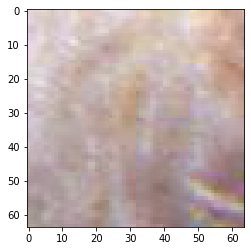

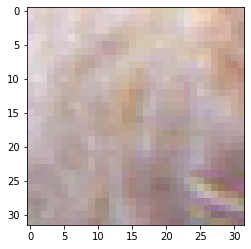

/content/Data_set_Train_x2/740/patch_731_9_5.jpg
/content/Data_set_Train_x2/740/patch_731_8_23.jpg
/content/Data_set_Train_x2/740/patch_731_10_18.jpg
/content/Data_set_Train_x2/740/patch_732_1_23.jpg
/content/Data_set_Train_x2/740/patch_731_18_6.jpg
/content/Data_set_Train_x2/740/patch_732_1_27.jpg
/content/Data_set_Train_x2/740/patch_731_17_30.jpg
/content/Data_set_Train_x2/740/patch_731_11_16.jpg
/content/Data_set_Train_x2/740/patch_732_1_3.jpg
/content/Data_set_Train_x2/740/patch_731_12_12.jpg
/content/Data_set_Train_x2/740/patch_731_17_0.jpg
/content/Data_set_Train_x2/740/patch_731_11_11.jpg
/content/Data_set_Train_x2/740/patch_732_3_2.jpg
/content/Data_set_Train_x2/740/patch_732_2_30.jpg
/content/Data_set_Train_x2/740/patch_731_15_11.jpg
/content/Data_set_Train_x2/740/patch_731_14_17.jpg
/content/Data_set_Train_x2/740/patch_731_13_15.jpg
/content/Data_set_Train_x2/740/patch_731_8_17.jpg
/content/Data_set_Train_x2/740/patch_731_10_27.jpg
/content/Data_set_Train_x2/740/patch_731_8_2

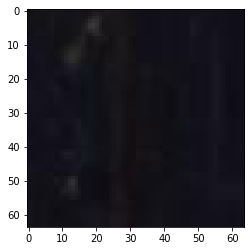

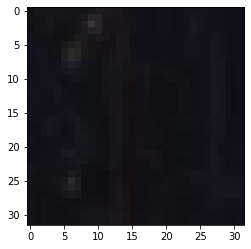

/content/Data_set_Train_x2/740/patch_732_15_6.jpg
/content/Data_set_Train_x2/740/patch_730_0_30.jpg
/content/Data_set_Train_x2/740/patch_730_6_2.jpg
/content/Data_set_Train_x2/740/patch_730_4_3.jpg
/content/Data_set_Train_x2/740/patch_730_7_22.jpg
/content/Data_set_Train_x2/740/patch_730_4_16.jpg
/content/Data_set_Train_x2/740/patch_730_10_2.jpg
/content/Data_set_Train_x2/740/patch_730_8_12.jpg
/content/Data_set_Train_x2/740/patch_730_11_6.jpg
/content/Data_set_Train_x2/740/patch_730_8_23.jpg
/content/Data_set_Train_x2/740/patch_730_4_29.jpg
/content/Data_set_Train_x2/740/patch_730_10_3.jpg
/content/Data_set_Train_x2/740/patch_730_9_17.jpg
/content/Data_set_Train_x2/740/patch_730_1_17.jpg
/content/Data_set_Train_x2/740/patch_730_7_5.jpg
/content/Data_set_Train_x2/740/patch_730_1_29.jpg
/content/Data_set_Train_x2/740/patch_730_7_2.jpg
/content/Data_set_Train_x2/740/patch_730_3_10.jpg
/content/Data_set_Train_x2/740/patch_730_7_25.jpg
/content/Data_set_Train_x2/740/patch_730_9_11.jpg
/con

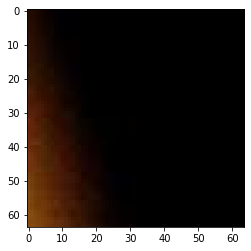

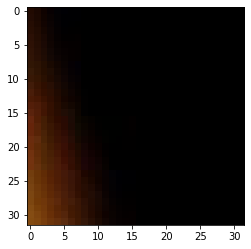

/content/Data_set_Train_x2/740/patch_730_14_2.jpg
/content/Data_set_Train_x2/740/patch_730_16_7.jpg
/content/Data_set_Train_x2/740/patch_731_7_12.jpg
/content/Data_set_Train_x2/740/patch_731_6_22.jpg
/content/Data_set_Train_x2/740/patch_731_1_13.jpg
/content/Data_set_Train_x2/740/patch_730_13_13.jpg
/content/Data_set_Train_x2/740/patch_730_20_9.jpg
/content/Data_set_Train_x2/740/patch_730_12_22.jpg
/content/Data_set_Train_x2/740/patch_730_13_2.jpg
/content/Data_set_Train_x2/740/patch_731_0_10.jpg
/content/Data_set_Train_x2/740/patch_730_15_4.jpg
/content/Data_set_Train_x2/740/patch_730_17_22.jpg
/content/Data_set_Train_x2/740/patch_730_12_23.jpg
/content/Data_set_Train_x2/740/patch_731_5_16.jpg
/content/Data_set_Train_x2/740/patch_730_16_13.jpg
/content/Data_set_Train_x2/740/patch_730_18_0.jpg
/content/Data_set_Train_x2/740/patch_731_2_16.jpg
/content/Data_set_Train_x2/740/patch_731_1_5.jpg
/content/Data_set_Train_x2/740/patch_730_17_19.jpg
/content/Data_set_Train_x2/740/patch_731_5_14

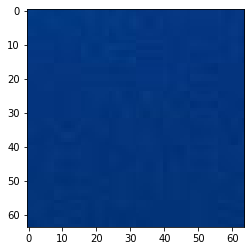

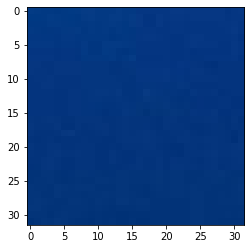

/content/Data_set_Train_x2/750/patch_749_20_14.jpg
/content/Data_set_Train_x2/750/patch_749_15_25.jpg
/content/Data_set_Train_x2/750/patch_749_16_10.jpg
/content/Data_set_Train_x2/750/patch_749_20_8.jpg
/content/Data_set_Train_x2/750/patch_749_10_11.jpg
/content/Data_set_Train_x2/750/patch_749_5_7.jpg
/content/Data_set_Train_x2/750/patch_749_9_10.jpg
/content/Data_set_Train_x2/750/patch_749_19_14.jpg
/content/Data_set_Train_x2/750/patch_749_6_29.jpg
/content/Data_set_Train_x2/750/patch_749_6_5.jpg
/content/Data_set_Train_x2/750/patch_749_16_17.jpg
/content/Data_set_Train_x2/750/patch_749_10_12.jpg
/content/Data_set_Train_x2/750/patch_749_14_23.jpg
/content/Data_set_Train_x2/750/patch_749_8_18.jpg
/content/Data_set_Train_x2/750/patch_749_8_1.jpg
/content/Data_set_Train_x2/750/patch_749_13_20.jpg
/content/Data_set_Train_x2/750/patch_749_3_25.jpg
/content/Data_set_Train_x2/750/patch_749_20_19.jpg
/content/Data_set_Train_x2/750/patch_749_11_26.jpg
/content/Data_set_Train_x2/750/patch_749_1

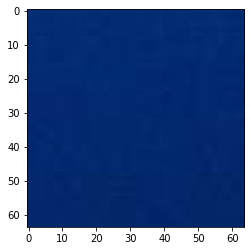

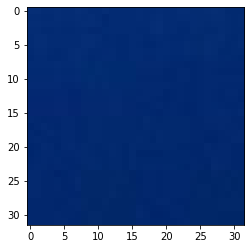

/content/Data_set_Train_x2/750/patch_749_20_21.jpg
/content/Data_set_Train_x2/750/patch_747_13_10.jpg
/content/Data_set_Train_x2/750/patch_746_20_28.jpg
/content/Data_set_Train_x2/750/patch_747_1_15.jpg
/content/Data_set_Train_x2/750/patch_747_14_27.jpg
/content/Data_set_Train_x2/750/patch_746_20_4.jpg
/content/Data_set_Train_x2/750/patch_747_7_7.jpg
/content/Data_set_Train_x2/750/patch_747_15_1.jpg
/content/Data_set_Train_x2/750/patch_747_6_21.jpg
/content/Data_set_Train_x2/750/patch_747_13_15.jpg
/content/Data_set_Train_x2/750/patch_747_3_17.jpg
/content/Data_set_Train_x2/750/patch_747_3_20.jpg
/content/Data_set_Train_x2/750/patch_747_5_15.jpg
/content/Data_set_Train_x2/750/patch_747_1_14.jpg
/content/Data_set_Train_x2/750/patch_747_10_27.jpg
/content/Data_set_Train_x2/750/patch_747_8_15.jpg
/content/Data_set_Train_x2/750/patch_747_2_7.jpg
/content/Data_set_Train_x2/750/patch_747_7_28.jpg
/content/Data_set_Train_x2/750/patch_747_9_0.jpg
/content/Data_set_Train_x2/750/patch_747_14_5.j

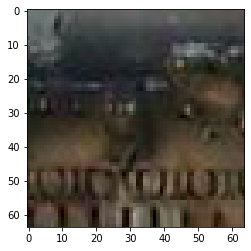

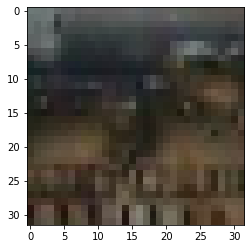

/content/Data_set_Train_x2/750/patch_748_8_9.jpg
/content/Data_set_Train_x2/750/patch_748_3_8.jpg
/content/Data_set_Train_x2/750/patch_748_4_22.jpg
/content/Data_set_Train_x2/750/patch_747_18_20.jpg
/content/Data_set_Train_x2/750/patch_747_19_30.jpg
/content/Data_set_Train_x2/750/patch_747_17_17.jpg
/content/Data_set_Train_x2/750/patch_747_19_4.jpg
/content/Data_set_Train_x2/750/patch_748_4_2.jpg
/content/Data_set_Train_x2/750/patch_748_9_4.jpg
/content/Data_set_Train_x2/750/patch_747_18_7.jpg
/content/Data_set_Train_x2/750/patch_747_19_15.jpg
/content/Data_set_Train_x2/750/patch_747_17_21.jpg
/content/Data_set_Train_x2/750/patch_748_5_14.jpg
/content/Data_set_Train_x2/750/patch_748_3_12.jpg
/content/Data_set_Train_x2/750/patch_747_16_8.jpg
/content/Data_set_Train_x2/750/patch_747_18_21.jpg
/content/Data_set_Train_x2/750/patch_747_18_26.jpg
/content/Data_set_Train_x2/750/patch_747_20_2.jpg
/content/Data_set_Train_x2/750/patch_748_4_11.jpg
/content/Data_set_Train_x2/750/patch_748_7_25.j

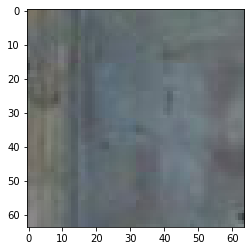

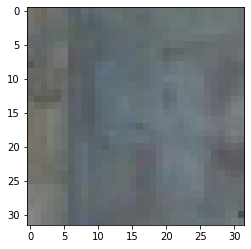

/content/Data_set_Train_x2/750/patch_748_16_11.jpg
/content/Data_set_Train_x2/750/patch_745_12_19.jpg
/content/Data_set_Train_x2/750/patch_746_3_16.jpg
/content/Data_set_Train_x2/750/patch_745_14_7.jpg
/content/Data_set_Train_x2/750/patch_745_14_6.jpg
/content/Data_set_Train_x2/750/patch_746_3_20.jpg
/content/Data_set_Train_x2/750/patch_745_17_9.jpg
/content/Data_set_Train_x2/750/patch_745_11_0.jpg
/content/Data_set_Train_x2/750/patch_745_11_4.jpg
/content/Data_set_Train_x2/750/patch_745_16_19.jpg
/content/Data_set_Train_x2/750/patch_745_19_13.jpg
/content/Data_set_Train_x2/750/patch_745_13_21.jpg
/content/Data_set_Train_x2/750/patch_745_12_0.jpg
/content/Data_set_Train_x2/750/patch_745_18_6.jpg
/content/Data_set_Train_x2/750/patch_745_9_22.jpg
/content/Data_set_Train_x2/750/patch_746_0_29.jpg
/content/Data_set_Train_x2/750/patch_746_0_8.jpg
/content/Data_set_Train_x2/750/patch_745_17_25.jpg
/content/Data_set_Train_x2/750/patch_745_15_23.jpg
/content/Data_set_Train_x2/750/patch_745_18_

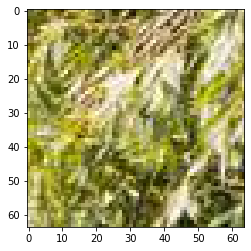

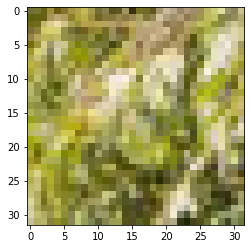

/content/Data_set_Train_x2/750/patch_746_6_26.jpg
/content/Data_set_Train_x2/750/patch_746_9_11.jpg
/content/Data_set_Train_x2/750/patch_746_9_26.jpg
/content/Data_set_Train_x2/750/patch_746_12_6.jpg
/content/Data_set_Train_x2/750/patch_746_6_17.jpg
/content/Data_set_Train_x2/750/patch_746_17_12.jpg
/content/Data_set_Train_x2/750/patch_746_16_6.jpg
/content/Data_set_Train_x2/750/patch_746_15_21.jpg
/content/Data_set_Train_x2/750/patch_746_10_1.jpg
/content/Data_set_Train_x2/750/patch_746_13_28.jpg
/content/Data_set_Train_x2/750/patch_746_18_18.jpg
/content/Data_set_Train_x2/750/patch_746_14_12.jpg
/content/Data_set_Train_x2/750/patch_746_19_18.jpg
/content/Data_set_Train_x2/750/patch_746_5_1.jpg
/content/Data_set_Train_x2/750/patch_746_10_11.jpg
/content/Data_set_Train_x2/750/patch_746_4_1.jpg
/content/Data_set_Train_x2/750/patch_746_9_13.jpg
/content/Data_set_Train_x2/750/patch_746_7_10.jpg
/content/Data_set_Train_x2/750/patch_746_6_27.jpg
/content/Data_set_Train_x2/750/patch_746_7_19

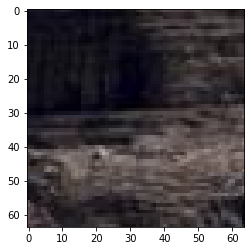

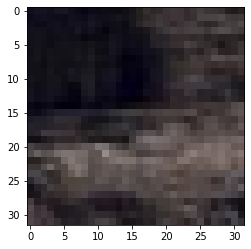

/content/Data_set_Train_x2/750/patch_747_14_0.jpg
/content/Data_set_Train_x2/750/patch_744_7_10.jpg
/content/Data_set_Train_x2/750/patch_744_20_23.jpg
/content/Data_set_Train_x2/750/patch_744_20_14.jpg
/content/Data_set_Train_x2/750/patch_744_16_3.jpg
/content/Data_set_Train_x2/750/patch_744_16_28.jpg
/content/Data_set_Train_x2/750/patch_744_20_19.jpg
/content/Data_set_Train_x2/750/patch_744_11_27.jpg
/content/Data_set_Train_x2/750/patch_744_11_12.jpg
/content/Data_set_Train_x2/750/patch_744_19_3.jpg
/content/Data_set_Train_x2/750/patch_744_13_12.jpg
/content/Data_set_Train_x2/750/patch_744_7_29.jpg
/content/Data_set_Train_x2/750/patch_744_10_10.jpg
/content/Data_set_Train_x2/750/patch_744_8_26.jpg
/content/Data_set_Train_x2/750/patch_744_12_5.jpg
/content/Data_set_Train_x2/750/patch_744_16_15.jpg
/content/Data_set_Train_x2/750/patch_744_8_4.jpg
/content/Data_set_Train_x2/750/patch_744_13_29.jpg
/content/Data_set_Train_x2/750/patch_744_21_11.jpg
/content/Data_set_Train_x2/750/patch_744

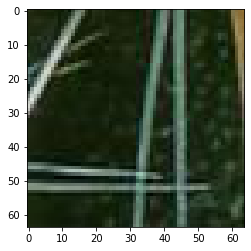

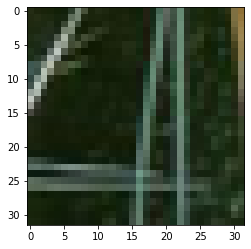

/content/Data_set_Train_x2/750/patch_744_21_18.jpg
/content/Data_set_Train_x2/750/patch_745_3_8.jpg
/content/Data_set_Train_x2/750/patch_745_6_3.jpg
/content/Data_set_Train_x2/750/patch_745_2_4.jpg
/content/Data_set_Train_x2/750/patch_744_24_11.jpg
/content/Data_set_Train_x2/750/patch_744_24_21.jpg
/content/Data_set_Train_x2/750/patch_745_3_27.jpg
/content/Data_set_Train_x2/750/patch_745_6_26.jpg
/content/Data_set_Train_x2/750/patch_745_6_28.jpg
/content/Data_set_Train_x2/750/patch_745_1_16.jpg
/content/Data_set_Train_x2/750/patch_745_8_22.jpg
/content/Data_set_Train_x2/750/patch_744_23_25.jpg
/content/Data_set_Train_x2/750/patch_745_0_22.jpg
/content/Data_set_Train_x2/750/patch_745_7_17.jpg
/content/Data_set_Train_x2/750/patch_745_4_20.jpg
/content/Data_set_Train_x2/750/patch_745_7_28.jpg
/content/Data_set_Train_x2/750/patch_745_2_27.jpg
/content/Data_set_Train_x2/750/patch_744_23_2.jpg
/content/Data_set_Train_x2/750/patch_745_3_4.jpg
/content/Data_set_Train_x2/750/patch_744_26_6.jpg


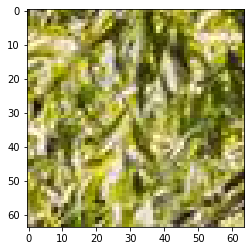

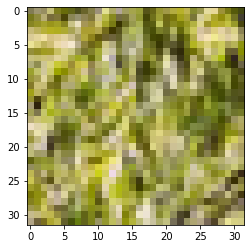

/content/Data_set_Train_x2/750/patch_746_0_28.jpg
/content/Data_set_Train_x2/750/patch_743_10_2.jpg
/content/Data_set_Train_x2/750/patch_743_7_14.jpg
/content/Data_set_Train_x2/750/patch_743_10_13.jpg
/content/Data_set_Train_x2/750/patch_743_10_8.jpg
/content/Data_set_Train_x2/750/patch_742_19_29.jpg
/content/Data_set_Train_x2/750/patch_743_0_16.jpg
/content/Data_set_Train_x2/750/patch_743_0_10.jpg
/content/Data_set_Train_x2/750/patch_743_2_13.jpg
/content/Data_set_Train_x2/750/patch_743_10_26.jpg
/content/Data_set_Train_x2/750/patch_743_9_15.jpg
/content/Data_set_Train_x2/750/patch_742_18_19.jpg
/content/Data_set_Train_x2/750/patch_743_4_5.jpg
/content/Data_set_Train_x2/750/patch_743_4_30.jpg
/content/Data_set_Train_x2/750/patch_743_8_16.jpg
/content/Data_set_Train_x2/750/patch_743_9_13.jpg
/content/Data_set_Train_x2/750/patch_743_5_9.jpg
/content/Data_set_Train_x2/750/patch_742_18_22.jpg
/content/Data_set_Train_x2/750/patch_743_2_17.jpg
/content/Data_set_Train_x2/750/patch_743_9_21.j

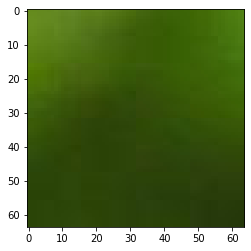

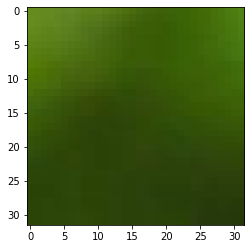

/content/Data_set_Train_x2/750/patch_744_0_25.jpg
/content/Data_set_Train_x2/750/patch_743_17_28.jpg
/content/Data_set_Train_x2/750/patch_743_14_15.jpg
/content/Data_set_Train_x2/750/patch_743_17_5.jpg
/content/Data_set_Train_x2/750/patch_744_2_11.jpg
/content/Data_set_Train_x2/750/patch_743_23_17.jpg
/content/Data_set_Train_x2/750/patch_744_0_9.jpg
/content/Data_set_Train_x2/750/patch_743_13_19.jpg
/content/Data_set_Train_x2/750/patch_743_19_25.jpg
/content/Data_set_Train_x2/750/patch_743_13_9.jpg
/content/Data_set_Train_x2/750/patch_744_1_0.jpg
/content/Data_set_Train_x2/750/patch_743_15_18.jpg
/content/Data_set_Train_x2/750/patch_744_1_22.jpg
/content/Data_set_Train_x2/750/patch_743_19_6.jpg
/content/Data_set_Train_x2/750/patch_743_23_9.jpg
/content/Data_set_Train_x2/750/patch_743_16_19.jpg
/content/Data_set_Train_x2/750/patch_743_18_22.jpg
/content/Data_set_Train_x2/750/patch_743_18_29.jpg
/content/Data_set_Train_x2/750/patch_744_0_12.jpg
/content/Data_set_Train_x2/750/patch_743_20

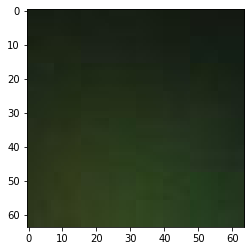

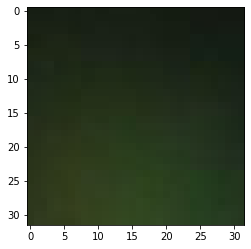

/content/Data_set_Train_x2/750/patch_744_19_0.jpg
/content/Data_set_Train_x2/750/patch_742_1_29.jpg
/content/Data_set_Train_x2/750/patch_741_19_3.jpg
/content/Data_set_Train_x2/750/patch_741_14_16.jpg
/content/Data_set_Train_x2/750/patch_741_10_14.jpg
/content/Data_set_Train_x2/750/patch_741_16_4.jpg
/content/Data_set_Train_x2/750/patch_741_11_29.jpg
/content/Data_set_Train_x2/750/patch_741_10_29.jpg
/content/Data_set_Train_x2/750/patch_741_11_13.jpg
/content/Data_set_Train_x2/750/patch_741_10_20.jpg
/content/Data_set_Train_x2/750/patch_742_1_24.jpg
/content/Data_set_Train_x2/750/patch_741_18_9.jpg
/content/Data_set_Train_x2/750/patch_742_0_1.jpg
/content/Data_set_Train_x2/750/patch_742_0_11.jpg
/content/Data_set_Train_x2/750/patch_741_12_24.jpg
/content/Data_set_Train_x2/750/patch_741_16_7.jpg
/content/Data_set_Train_x2/750/patch_741_14_10.jpg
/content/Data_set_Train_x2/750/patch_741_7_12.jpg
/content/Data_set_Train_x2/750/patch_741_15_0.jpg
/content/Data_set_Train_x2/750/patch_742_1_

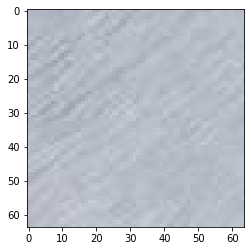

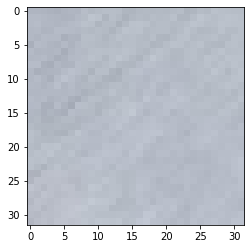

/content/Data_set_Train_x2/750/patch_742_17_8.jpg
/content/Data_set_Train_x2/750/patch_742_9_0.jpg
/content/Data_set_Train_x2/750/patch_742_5_12.jpg
/content/Data_set_Train_x2/750/patch_742_6_5.jpg
/content/Data_set_Train_x2/750/patch_742_16_11.jpg
/content/Data_set_Train_x2/750/patch_742_7_10.jpg
/content/Data_set_Train_x2/750/patch_742_11_12.jpg
/content/Data_set_Train_x2/750/patch_742_11_27.jpg
/content/Data_set_Train_x2/750/patch_742_16_21.jpg
/content/Data_set_Train_x2/750/patch_742_3_4.jpg
/content/Data_set_Train_x2/750/patch_742_17_16.jpg
/content/Data_set_Train_x2/750/patch_742_11_10.jpg
/content/Data_set_Train_x2/750/patch_742_14_6.jpg
/content/Data_set_Train_x2/750/patch_742_16_10.jpg
/content/Data_set_Train_x2/750/patch_742_6_26.jpg
/content/Data_set_Train_x2/750/patch_742_11_24.jpg
/content/Data_set_Train_x2/750/patch_742_9_26.jpg
/content/Data_set_Train_x2/750/patch_742_16_4.jpg
/content/Data_set_Train_x2/750/patch_742_12_26.jpg
/content/Data_set_Train_x2/750/patch_742_5_2

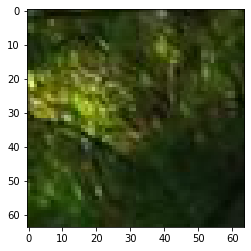

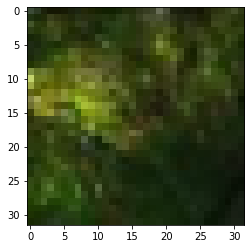

/content/Data_set_Train_x2/750/patch_743_1_11.jpg
/content/Data_set_Train_x2/750/patch_740_4_5.jpg
/content/Data_set_Train_x2/750/patch_740_5_14.jpg
/content/Data_set_Train_x2/750/patch_740_8_1.jpg
/content/Data_set_Train_x2/750/patch_740_10_2.jpg
/content/Data_set_Train_x2/750/patch_740_6_11.jpg
/content/Data_set_Train_x2/750/patch_740_10_11.jpg
/content/Data_set_Train_x2/750/patch_740_4_25.jpg
/content/Data_set_Train_x2/750/patch_740_8_14.jpg
/content/Data_set_Train_x2/750/patch_740_8_17.jpg
/content/Data_set_Train_x2/750/patch_740_7_16.jpg
/content/Data_set_Train_x2/750/patch_740_0_3.jpg
/content/Data_set_Train_x2/750/patch_740_9_23.jpg
/content/Data_set_Train_x2/750/patch_740_5_6.jpg
/content/Data_set_Train_x2/750/patch_740_7_30.jpg
/content/Data_set_Train_x2/750/patch_740_8_23.jpg
/content/Data_set_Train_x2/750/patch_740_7_27.jpg
/content/Data_set_Train_x2/750/patch_740_7_21.jpg
/content/Data_set_Train_x2/750/patch_740_3_17.jpg
/content/Data_set_Train_x2/750/patch_740_7_4.jpg
/con

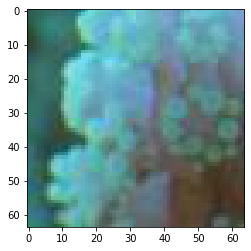

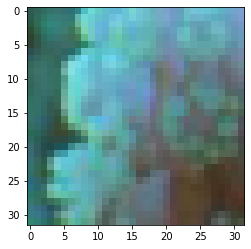

/content/Data_set_Train_x2/750/patch_741_6_19.jpg
/content/Data_set_Train_x2/750/patch_740_13_16.jpg
/content/Data_set_Train_x2/750/patch_740_17_2.jpg
/content/Data_set_Train_x2/750/patch_740_15_15.jpg
/content/Data_set_Train_x2/750/patch_740_18_7.jpg
/content/Data_set_Train_x2/750/patch_741_2_25.jpg
/content/Data_set_Train_x2/750/patch_740_13_25.jpg
/content/Data_set_Train_x2/750/patch_740_13_1.jpg
/content/Data_set_Train_x2/750/patch_741_6_13.jpg
/content/Data_set_Train_x2/750/patch_740_14_16.jpg
/content/Data_set_Train_x2/750/patch_741_6_25.jpg
/content/Data_set_Train_x2/750/patch_741_5_13.jpg
/content/Data_set_Train_x2/750/patch_741_1_2.jpg
/content/Data_set_Train_x2/750/patch_740_17_0.jpg
/content/Data_set_Train_x2/750/patch_740_18_3.jpg
/content/Data_set_Train_x2/750/patch_740_18_16.jpg
/content/Data_set_Train_x2/750/patch_741_4_17.jpg
/content/Data_set_Train_x2/750/patch_741_4_9.jpg
/content/Data_set_Train_x2/750/patch_740_13_19.jpg
/content/Data_set_Train_x2/750/patch_740_14_22

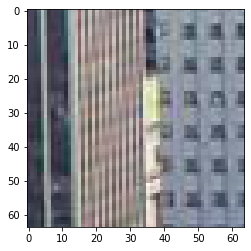

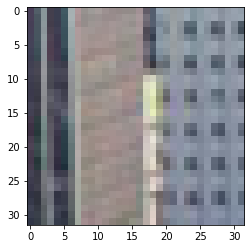

/content/Data_set_Train_x2/760/patch_753_9_7.jpg
/content/Data_set_Train_x2/760/patch_750_11_5.jpg
/content/Data_set_Train_x2/760/patch_750_17_17.jpg
/content/Data_set_Train_x2/760/patch_758_10_9.jpg
/content/Data_set_Train_x2/760/patch_751_11_29.jpg
/content/Data_set_Train_x2/760/patch_755_17_30.jpg
/content/Data_set_Train_x2/760/patch_752_2_11.jpg
/content/Data_set_Train_x2/760/patch_752_5_18.jpg
/content/Data_set_Train_x2/760/patch_755_8_15.jpg
/content/Data_set_Train_x2/760/patch_757_5_2.jpg
/content/Data_set_Train_x2/760/patch_754_1_25.jpg
/content/Data_set_Train_x2/760/patch_754_20_2.jpg
/content/Data_set_Train_x2/760/patch_753_2_11.jpg
/content/Data_set_Train_x2/760/patch_756_7_5.jpg
/content/Data_set_Train_x2/760/patch_753_5_18.jpg
/content/Data_set_Train_x2/760/patch_755_17_24.jpg
/content/Data_set_Train_x2/760/patch_755_1_25.jpg
/content/Data_set_Train_x2/760/patch_755_20_2.jpg
/content/Data_set_Train_x2/760/patch_754_16_13.jpg
/content/Data_set_Train_x2/760/patch_754_8_15.jp

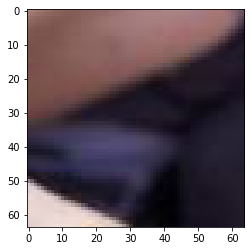

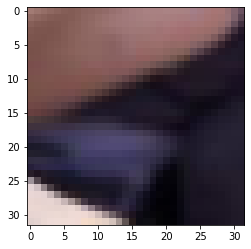

/content/Data_set_Train_x2/760/patch_756_5_11.jpg
/content/Data_set_Train_x2/760/patch_753_8_4.jpg
/content/Data_set_Train_x2/760/patch_750_2_21.jpg
/content/Data_set_Train_x2/760/patch_750_10_6.jpg
/content/Data_set_Train_x2/760/patch_756_8_25.jpg
/content/Data_set_Train_x2/760/patch_753_16_28.jpg
/content/Data_set_Train_x2/760/patch_751_5_28.jpg
/content/Data_set_Train_x2/760/patch_751_10_6.jpg
/content/Data_set_Train_x2/760/patch_757_1_15.jpg
/content/Data_set_Train_x2/760/patch_752_19_0.jpg
/content/Data_set_Train_x2/760/patch_751_2_21.jpg
/content/Data_set_Train_x2/760/patch_752_6_16.jpg
/content/Data_set_Train_x2/760/patch_753_11_21.jpg
/content/Data_set_Train_x2/760/patch_752_10_16.jpg
/content/Data_set_Train_x2/760/patch_753_6_16.jpg
/content/Data_set_Train_x2/760/patch_757_0_5.jpg
/content/Data_set_Train_x2/760/patch_754_5_22.jpg
/content/Data_set_Train_x2/760/patch_755_5_22.jpg
/content/Data_set_Train_x2/760/patch_755_13_23.jpg
/content/Data_set_Train_x2/760/patch_756_2_2.jpg

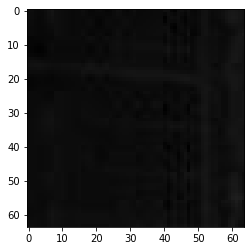

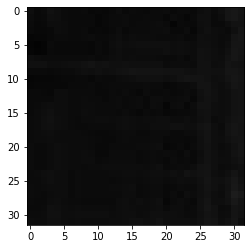

/content/Data_set_Train_x2/760/patch_758_10_15.jpg
/content/Data_set_Train_x2/760/patch_759_9_20.jpg
/content/Data_set_Train_x2/760/patch_751_13_17.jpg
/content/Data_set_Train_x2/760/patch_755_6_2.jpg
/content/Data_set_Train_x2/760/patch_759_11_22.jpg
/content/Data_set_Train_x2/760/patch_750_12_20.jpg
/content/Data_set_Train_x2/760/patch_758_0_10.jpg
/content/Data_set_Train_x2/760/patch_750_15_29.jpg
/content/Data_set_Train_x2/760/patch_758_7_19.jpg
/content/Data_set_Train_x2/760/patch_758_19_19.jpg
/content/Data_set_Train_x2/760/patch_759_7_25.jpg
/content/Data_set_Train_x2/760/patch_750_17_4.jpg
/content/Data_set_Train_x2/760/patch_758_10_29.jpg
/content/Data_set_Train_x2/760/patch_758_16_8.jpg
/content/Data_set_Train_x2/760/patch_750_0_9.jpg
/content/Data_set_Train_x2/760/patch_758_7_25.jpg
/content/Data_set_Train_x2/760/patch_750_15_15.jpg
/content/Data_set_Train_x2/760/patch_758_6_9.jpg
/content/Data_set_Train_x2/760/patch_758_17_20.jpg
/content/Data_set_Train_x2/760/patch_759_16_

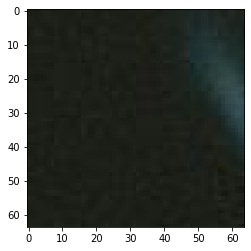

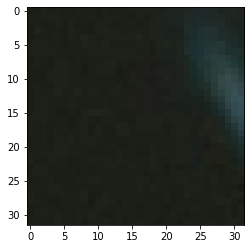

/content/Data_set_Train_x2/760/patch_752_18_15.jpg
/content/Data_set_Train_x2/760/patch_751_18_8.jpg
/content/Data_set_Train_x2/760/patch_756_18_19.jpg
/content/Data_set_Train_x2/760/patch_756_11_29.jpg
/content/Data_set_Train_x2/760/patch_757_17_17.jpg
/content/Data_set_Train_x2/760/patch_759_19_4.jpg
/content/Data_set_Train_x2/760/patch_756_16_20.jpg
/content/Data_set_Train_x2/760/patch_759_19_19.jpg
/content/Data_set_Train_x2/760/patch_755_5_3.jpg
/content/Data_set_Train_x2/760/patch_754_18_2.jpg
/content/Data_set_Train_x2/760/patch_759_6_12.jpg
/content/Data_set_Train_x2/760/patch_757_11_4.jpg
/content/Data_set_Train_x2/760/patch_759_10_29.jpg
/content/Data_set_Train_x2/760/patch_754_7_4.jpg
/content/Data_set_Train_x2/760/patch_751_15_15.jpg
/content/Data_set_Train_x2/760/patch_756_11_4.jpg
/content/Data_set_Train_x2/760/patch_758_16_17.jpg
/content/Data_set_Train_x2/760/patch_750_14_22.jpg
/content/Data_set_Train_x2/760/patch_759_17_20.jpg
/content/Data_set_Train_x2/760/patch_758_

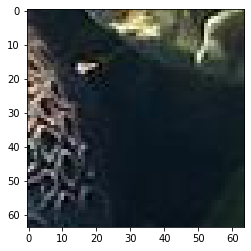

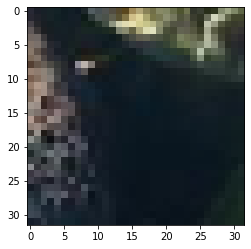

/content/Data_set_Train_x2/760/patch_750_13_15.jpg
/content/Data_set_Train_x2/760/patch_759_10_17.jpg
/content/Data_set_Train_x2/760/patch_759_6_10.jpg
/content/Data_set_Train_x2/760/patch_757_11_6.jpg
/content/Data_set_Train_x2/760/patch_754_18_0.jpg
/content/Data_set_Train_x2/760/patch_757_8_9.jpg
/content/Data_set_Train_x2/760/patch_755_5_1.jpg
/content/Data_set_Train_x2/760/patch_759_1_19.jpg
/content/Data_set_Train_x2/760/patch_758_8_29.jpg
/content/Data_set_Train_x2/760/patch_755_18_0.jpg
/content/Data_set_Train_x2/760/patch_758_6_10.jpg
/content/Data_set_Train_x2/760/patch_759_17_22.jpg
/content/Data_set_Train_x2/760/patch_750_14_20.jpg
/content/Data_set_Train_x2/760/patch_751_15_17.jpg
/content/Data_set_Train_x2/760/patch_756_11_6.jpg
/content/Data_set_Train_x2/760/patch_758_16_15.jpg
/content/Data_set_Train_x2/760/patch_754_7_6.jpg
/content/Data_set_Train_x2/760/patch_759_8_29.jpg
/content/Data_set_Train_x2/760/patch_750_13_29.jpg
/content/Data_set_Train_x2/760/patch_758_1_19.

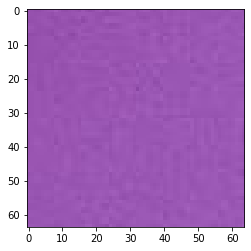

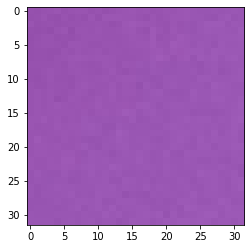

/content/Data_set_Train_x2/760/patch_752_19_26.jpg
/content/Data_set_Train_x2/760/patch_753_1_13.jpg
/content/Data_set_Train_x2/760/patch_752_8_23.jpg
/content/Data_set_Train_x2/760/patch_754_2_27.jpg
/content/Data_set_Train_x2/760/patch_757_19_6.jpg
/content/Data_set_Train_x2/760/patch_757_0_9.jpg
/content/Data_set_Train_x2/760/patch_754_10_0.jpg
/content/Data_set_Train_x2/760/patch_753_8_23.jpg
/content/Data_set_Train_x2/760/patch_753_6_26.jpg
/content/Data_set_Train_x2/760/patch_752_1_13.jpg
/content/Data_set_Train_x2/760/patch_753_4_5.jpg
/content/Data_set_Train_x2/760/patch_755_13_13.jpg
/content/Data_set_Train_x2/760/patch_753_15_1.jpg
/content/Data_set_Train_x2/760/patch_755_5_12.jpg
/content/Data_set_Train_x2/760/patch_754_12_30.jpg
/content/Data_set_Train_x2/760/patch_754_12_24.jpg
/content/Data_set_Train_x2/760/patch_752_6_26.jpg
/content/Data_set_Train_x2/760/patch_752_6_2.jpg
/content/Data_set_Train_x2/760/patch_754_5_12.jpg
/content/Data_set_Train_x2/760/patch_752_15_1.jpg

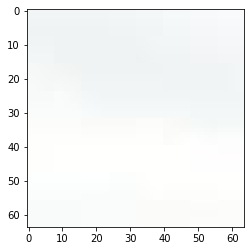

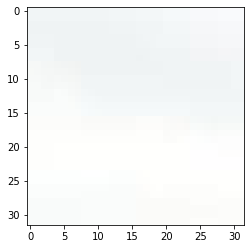

/content/Data_set_Train_x2/760/patch_753_1_14.jpg
/content/Data_set_Train_x2/760/patch_752_8_30.jpg
/content/Data_set_Train_x2/760/patch_754_10_7.jpg
/content/Data_set_Train_x2/760/patch_754_5_29.jpg
/content/Data_set_Train_x2/760/patch_753_8_24.jpg
/content/Data_set_Train_x2/760/patch_753_6_21.jpg
/content/Data_set_Train_x2/760/patch_755_5_15.jpg
/content/Data_set_Train_x2/760/patch_752_1_14.jpg
/content/Data_set_Train_x2/760/patch_755_13_14.jpg
/content/Data_set_Train_x2/760/patch_754_12_23.jpg
/content/Data_set_Train_x2/760/patch_753_15_6.jpg
/content/Data_set_Train_x2/760/patch_753_1_28.jpg
/content/Data_set_Train_x2/760/patch_753_4_2.jpg
/content/Data_set_Train_x2/760/patch_752_8_18.jpg
/content/Data_set_Train_x2/760/patch_752_6_21.jpg
/content/Data_set_Train_x2/760/patch_752_15_6.jpg
/content/Data_set_Train_x2/760/patch_752_6_5.jpg
/content/Data_set_Train_x2/760/patch_753_8_18.jpg
/content/Data_set_Train_x2/760/patch_754_5_15.jpg
/content/Data_set_Train_x2/760/patch_752_1_28.jpg


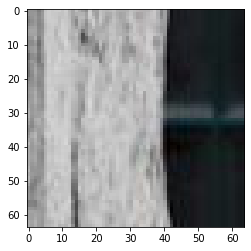

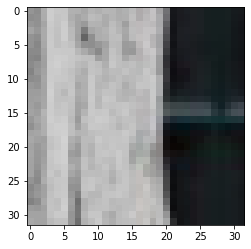

/content/Data_set_Train_x2/760/patch_758_9_5.jpg
/content/Data_set_Train_x2/760/patch_756_12_17.jpg
/content/Data_set_Train_x2/760/patch_756_15_22.jpg
/content/Data_set_Train_x2/760/patch_756_18_2.jpg
/content/Data_set_Train_x2/760/patch_757_13_20.jpg
/content/Data_set_Train_x2/760/patch_750_21_21.jpg
/content/Data_set_Train_x2/760/patch_751_20_16.jpg
/content/Data_set_Train_x2/760/patch_757_14_15.jpg
/content/Data_set_Train_x2/760/patch_752_7_6.jpg
/content/Data_set_Train_x2/760/patch_752_14_5.jpg
/content/Data_set_Train_x2/760/patch_753_5_1.jpg
/content/Data_set_Train_x2/760/patch_751_8_8.jpg
/content/Data_set_Train_x2/760/patch_753_14_5.jpg
/content/Data_set_Train_x2/760/patch_756_15_23.jpg
/content/Data_set_Train_x2/760/patch_751_8_9.jpg
/content/Data_set_Train_x2/760/patch_757_14_14.jpg
/content/Data_set_Train_x2/760/patch_753_5_0.jpg
/content/Data_set_Train_x2/760/patch_752_14_4.jpg
/content/Data_set_Train_x2/760/patch_752_7_7.jpg
/content/Data_set_Train_x2/760/patch_753_14_4.jpg

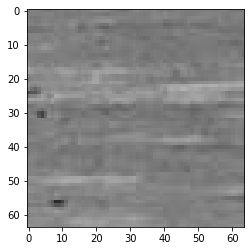

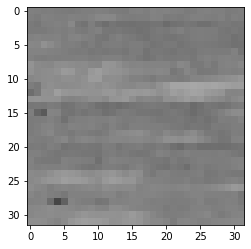

/content/Data_set_Train_x2/760/patch_758_20_22.jpg
/content/Data_set_Train_x2/760/patch_756_16_28.jpg
/content/Data_set_Train_x2/760/patch_757_10_16.jpg
/content/Data_set_Train_x2/760/patch_752_2_5.jpg
/content/Data_set_Train_x2/760/patch_752_11_6.jpg
/content/Data_set_Train_x2/760/patch_756_11_21.jpg
/content/Data_set_Train_x2/760/patch_756_3_23.jpg
/content/Data_set_Train_x2/760/patch_751_18_0.jpg
/content/Data_set_Train_x2/760/patch_755_7_9.jpg
/content/Data_set_Train_x2/760/patch_752_15_29.jpg
/content/Data_set_Train_x2/760/patch_751_0_17.jpg
/content/Data_set_Train_x2/760/patch_755_20_21.jpg
/content/Data_set_Train_x2/760/patch_751_9_27.jpg
/content/Data_set_Train_x2/760/patch_756_8_6.jpg
/content/Data_set_Train_x2/760/patch_750_0_17.jpg
/content/Data_set_Train_x2/760/patch_750_9_27.jpg
/content/Data_set_Train_x2/760/patch_757_3_23.jpg
/content/Data_set_Train_x2/760/patch_753_13_17.jpg
/content/Data_set_Train_x2/760/patch_752_12_20.jpg
/content/Data_set_Train_x2/760/patch_756_4_16

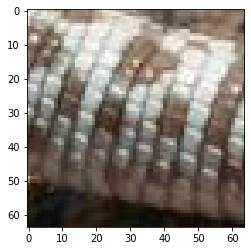

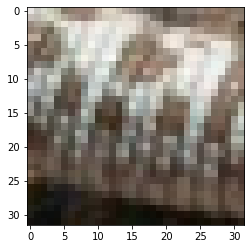

/content/Data_set_Train_x2/760/patch_754_12_18.jpg
/content/Data_set_Train_x2/760/patch_751_8_12.jpg
/content/Data_set_Train_x2/760/patch_751_1_20.jpg
/content/Data_set_Train_x2/760/patch_758_4_1.jpg
/content/Data_set_Train_x2/760/patch_756_2_16.jpg
/content/Data_set_Train_x2/760/patch_753_12_22.jpg
/content/Data_set_Train_x2/760/patch_751_1_22.jpg
/content/Data_set_Train_x2/760/patch_759_6_6.jpg
/content/Data_set_Train_x2/760/patch_750_6_17.jpg
/content/Data_set_Train_x2/760/patch_757_2_16.jpg
/content/Data_set_Train_x2/760/patch_752_13_15.jpg
/content/Data_set_Train_x2/760/patch_750_8_12.jpg
/content/Data_set_Train_x2/760/patch_750_2_1.jpg
/content/Data_set_Train_x2/760/patch_759_14_0.jpg
/content/Data_set_Train_x2/760/patch_751_20_5.jpg
/content/Data_set_Train_x2/760/patch_751_6_17.jpg
/content/Data_set_Train_x2/760/patch_752_13_29.jpg
/content/Data_set_Train_x2/760/patch_752_14_20.jpg
/content/Data_set_Train_x2/760/patch_757_5_23.jpg
/content/Data_set_Train_x2/760/patch_752_1_6.jpg

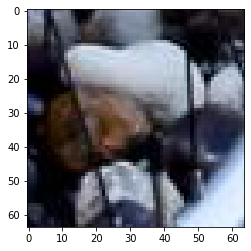

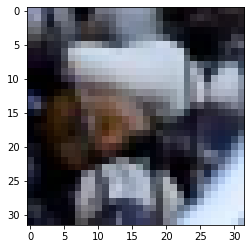

/content/Data_set_Train_x2/760/patch_759_18_8.jpg
/content/Data_set_Train_x2/760/patch_758_8_9.jpg
/content/Data_set_Train_x2/760/patch_752_3_1.jpg
/content/Data_set_Train_x2/760/patch_752_2_25.jpg
/content/Data_set_Train_x2/760/patch_754_16_27.jpg
/content/Data_set_Train_x2/760/patch_755_1_11.jpg
/content/Data_set_Train_x2/760/patch_754_8_21.jpg
/content/Data_set_Train_x2/760/patch_755_10_19.jpg
/content/Data_set_Train_x2/760/patch_759_5_13.jpg
/content/Data_set_Train_x2/760/patch_755_17_10.jpg
/content/Data_set_Train_x2/760/patch_750_19_4.jpg
/content/Data_set_Train_x2/760/patch_758_18_8.jpg
/content/Data_set_Train_x2/760/patch_755_6_18.jpg
/content/Data_set_Train_x2/760/patch_753_10_2.jpg
/content/Data_set_Train_x2/760/patch_759_13_28.jpg
/content/Data_set_Train_x2/760/patch_753_2_25.jpg
/content/Data_set_Train_x2/760/patch_753_1_6.jpg
/content/Data_set_Train_x2/760/patch_759_14_21.jpg
/content/Data_set_Train_x2/760/patch_750_17_23.jpg
/content/Data_set_Train_x2/760/patch_758_5_13.j

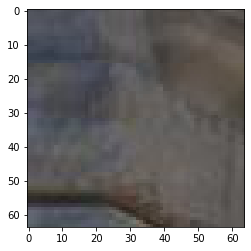

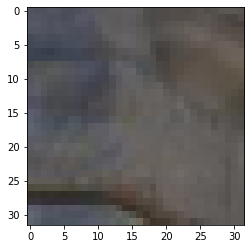

/content/Data_set_Train_x2/760/patch_755_11_4.jpg
/content/Data_set_Train_x2/760/patch_750_2_2.jpg
/content/Data_set_Train_x2/760/patch_753_15_28.jpg
/content/Data_set_Train_x2/760/patch_758_4_2.jpg
/content/Data_set_Train_x2/760/patch_751_1_21.jpg
/content/Data_set_Train_x2/760/patch_750_8_11.jpg
/content/Data_set_Train_x2/760/patch_751_6_28.jpg
/content/Data_set_Train_x2/760/patch_751_20_6.jpg
/content/Data_set_Train_x2/760/patch_759_14_3.jpg
/content/Data_set_Train_x2/760/patch_757_2_15.jpg
/content/Data_set_Train_x2/760/patch_753_12_21.jpg
/content/Data_set_Train_x2/760/patch_752_13_16.jpg
/content/Data_set_Train_x2/760/patch_756_2_15.jpg
/content/Data_set_Train_x2/760/patch_750_6_28.jpg
/content/Data_set_Train_x2/760/patch_754_20_20.jpg
/content/Data_set_Train_x2/760/patch_750_1_21.jpg
/content/Data_set_Train_x2/760/patch_759_6_5.jpg
/content/Data_set_Train_x2/760/patch_750_20_6.jpg
/content/Data_set_Train_x2/760/patch_751_8_11.jpg
/content/Data_set_Train_x2/760/patch_751_0_5.jpg


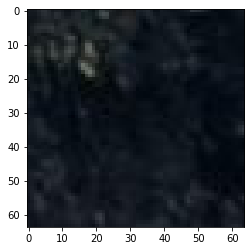

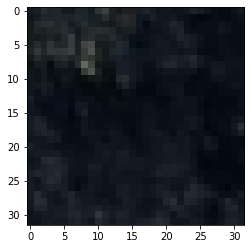

/content/Data_set_Train_x2/770/patch_769_18_29.jpg
/content/Data_set_Train_x2/770/patch_769_15_6.jpg
/content/Data_set_Train_x2/770/patch_769_7_26.jpg
/content/Data_set_Train_x2/770/patch_769_5_22.jpg
/content/Data_set_Train_x2/770/patch_769_14_25.jpg
/content/Data_set_Train_x2/770/patch_769_5_7.jpg
/content/Data_set_Train_x2/770/patch_769_12_21.jpg
/content/Data_set_Train_x2/770/patch_769_12_15.jpg
/content/Data_set_Train_x2/770/patch_769_18_17.jpg
/content/Data_set_Train_x2/770/patch_769_18_2.jpg
/content/Data_set_Train_x2/770/patch_769_8_22.jpg
/content/Data_set_Train_x2/770/patch_769_9_21.jpg
/content/Data_set_Train_x2/770/patch_769_12_5.jpg
/content/Data_set_Train_x2/770/patch_769_20_8.jpg
/content/Data_set_Train_x2/770/patch_769_18_3.jpg
/content/Data_set_Train_x2/770/patch_769_9_28.jpg
/content/Data_set_Train_x2/770/patch_769_11_21.jpg
/content/Data_set_Train_x2/770/patch_769_10_3.jpg
/content/Data_set_Train_x2/770/patch_769_20_15.jpg
/content/Data_set_Train_x2/770/patch_769_14_

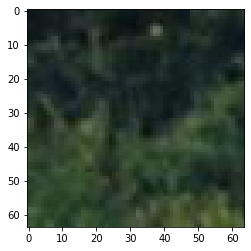

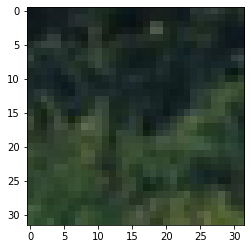

/content/Data_set_Train_x2/770/patch_769_23_2.jpg
/content/Data_set_Train_x2/770/patch_767_17_19.jpg
/content/Data_set_Train_x2/770/patch_767_10_12.jpg
/content/Data_set_Train_x2/770/patch_767_6_9.jpg
/content/Data_set_Train_x2/770/patch_767_17_9.jpg
/content/Data_set_Train_x2/770/patch_767_10_27.jpg
/content/Data_set_Train_x2/770/patch_767_3_1.jpg
/content/Data_set_Train_x2/770/patch_767_15_5.jpg
/content/Data_set_Train_x2/770/patch_767_3_6.jpg
/content/Data_set_Train_x2/770/patch_767_3_10.jpg
/content/Data_set_Train_x2/770/patch_767_6_12.jpg
/content/Data_set_Train_x2/770/patch_767_7_21.jpg
/content/Data_set_Train_x2/770/patch_767_12_23.jpg
/content/Data_set_Train_x2/770/patch_767_13_27.jpg
/content/Data_set_Train_x2/770/patch_767_11_22.jpg
/content/Data_set_Train_x2/770/patch_767_15_22.jpg
/content/Data_set_Train_x2/770/patch_767_11_17.jpg
/content/Data_set_Train_x2/770/patch_767_7_27.jpg
/content/Data_set_Train_x2/770/patch_767_11_23.jpg
/content/Data_set_Train_x2/770/patch_767_9_2

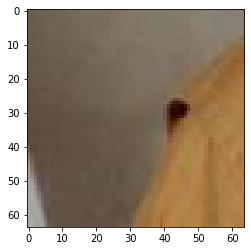

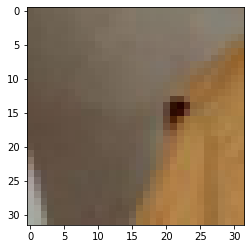

/content/Data_set_Train_x2/770/patch_768_8_8.jpg
/content/Data_set_Train_x2/770/patch_768_2_1.jpg
/content/Data_set_Train_x2/770/patch_768_0_8.jpg
/content/Data_set_Train_x2/770/patch_768_5_1.jpg
/content/Data_set_Train_x2/770/patch_768_0_11.jpg
/content/Data_set_Train_x2/770/patch_768_6_21.jpg
/content/Data_set_Train_x2/770/patch_768_12_0.jpg
/content/Data_set_Train_x2/770/patch_768_12_30.jpg
/content/Data_set_Train_x2/770/patch_768_11_3.jpg
/content/Data_set_Train_x2/770/patch_768_6_18.jpg
/content/Data_set_Train_x2/770/patch_768_6_19.jpg
/content/Data_set_Train_x2/770/patch_768_7_4.jpg
/content/Data_set_Train_x2/770/patch_768_4_28.jpg
/content/Data_set_Train_x2/770/patch_768_8_10.jpg
/content/Data_set_Train_x2/770/patch_768_3_1.jpg
/content/Data_set_Train_x2/770/patch_768_12_17.jpg
/content/Data_set_Train_x2/770/patch_768_6_23.jpg
/content/Data_set_Train_x2/770/patch_767_19_14.jpg
/content/Data_set_Train_x2/770/patch_768_6_25.jpg
/content/Data_set_Train_x2/770/patch_768_5_7.jpg
/con

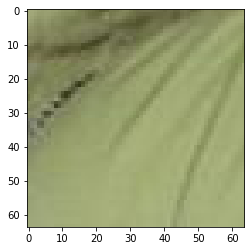

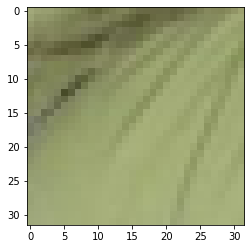

/content/Data_set_Train_x2/770/patch_768_14_22.jpg
/content/Data_set_Train_x2/770/patch_766_4_19.jpg
/content/Data_set_Train_x2/770/patch_766_3_1.jpg
/content/Data_set_Train_x2/770/patch_766_7_15.jpg
/content/Data_set_Train_x2/770/patch_765_19_27.jpg
/content/Data_set_Train_x2/770/patch_766_4_23.jpg
/content/Data_set_Train_x2/770/patch_765_22_25.jpg
/content/Data_set_Train_x2/770/patch_765_16_9.jpg
/content/Data_set_Train_x2/770/patch_766_1_20.jpg
/content/Data_set_Train_x2/770/patch_766_7_9.jpg
/content/Data_set_Train_x2/770/patch_766_3_18.jpg
/content/Data_set_Train_x2/770/patch_765_22_23.jpg
/content/Data_set_Train_x2/770/patch_766_2_8.jpg
/content/Data_set_Train_x2/770/patch_765_18_6.jpg
/content/Data_set_Train_x2/770/patch_765_21_23.jpg
/content/Data_set_Train_x2/770/patch_765_21_18.jpg
/content/Data_set_Train_x2/770/patch_765_21_26.jpg
/content/Data_set_Train_x2/770/patch_765_19_24.jpg
/content/Data_set_Train_x2/770/patch_766_6_17.jpg
/content/Data_set_Train_x2/770/patch_766_5_25

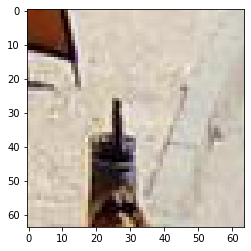

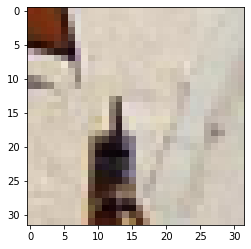

/content/Data_set_Train_x2/770/patch_766_21_22.jpg
/content/Data_set_Train_x2/770/patch_766_12_16.jpg
/content/Data_set_Train_x2/770/patch_766_22_22.jpg
/content/Data_set_Train_x2/770/patch_766_19_10.jpg
/content/Data_set_Train_x2/770/patch_766_9_17.jpg
/content/Data_set_Train_x2/770/patch_766_15_25.jpg
/content/Data_set_Train_x2/770/patch_767_0_6.jpg
/content/Data_set_Train_x2/770/patch_766_17_22.jpg
/content/Data_set_Train_x2/770/patch_766_21_2.jpg
/content/Data_set_Train_x2/770/patch_766_20_6.jpg
/content/Data_set_Train_x2/770/patch_767_1_25.jpg
/content/Data_set_Train_x2/770/patch_766_15_2.jpg
/content/Data_set_Train_x2/770/patch_766_10_8.jpg
/content/Data_set_Train_x2/770/patch_766_14_19.jpg
/content/Data_set_Train_x2/770/patch_766_16_1.jpg
/content/Data_set_Train_x2/770/patch_767_1_24.jpg
/content/Data_set_Train_x2/770/patch_766_22_17.jpg
/content/Data_set_Train_x2/770/patch_767_0_7.jpg
/content/Data_set_Train_x2/770/patch_766_16_12.jpg
/content/Data_set_Train_x2/770/patch_766_9_

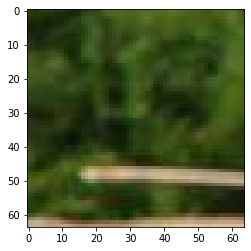

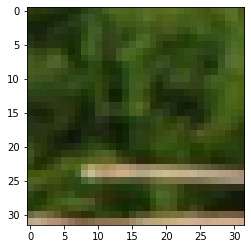

/content/Data_set_Train_x2/770/patch_767_8_28.jpg
/content/Data_set_Train_x2/770/patch_764_7_3.jpg
/content/Data_set_Train_x2/770/patch_764_7_20.jpg
/content/Data_set_Train_x2/770/patch_764_8_15.jpg
/content/Data_set_Train_x2/770/patch_764_18_20.jpg
/content/Data_set_Train_x2/770/patch_764_28_16.jpg
/content/Data_set_Train_x2/770/patch_764_8_12.jpg
/content/Data_set_Train_x2/770/patch_764_22_12.jpg
/content/Data_set_Train_x2/770/patch_764_29_20.jpg
/content/Data_set_Train_x2/770/patch_764_13_4.jpg
/content/Data_set_Train_x2/770/patch_764_12_0.jpg
/content/Data_set_Train_x2/770/patch_764_28_8.jpg
/content/Data_set_Train_x2/770/patch_764_6_12.jpg
/content/Data_set_Train_x2/770/patch_764_24_6.jpg
/content/Data_set_Train_x2/770/patch_764_27_14.jpg
/content/Data_set_Train_x2/770/patch_764_13_12.jpg
/content/Data_set_Train_x2/770/patch_764_22_8.jpg
/content/Data_set_Train_x2/770/patch_764_22_3.jpg
/content/Data_set_Train_x2/770/patch_764_23_12.jpg
/content/Data_set_Train_x2/770/patch_764_29_

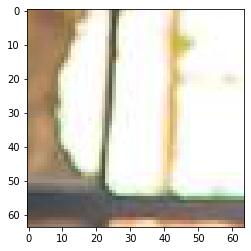

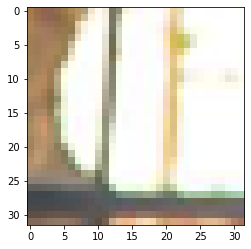

/content/Data_set_Train_x2/770/patch_765_3_18.jpg
/content/Data_set_Train_x2/770/patch_765_1_2.jpg
/content/Data_set_Train_x2/770/patch_765_5_15.jpg
/content/Data_set_Train_x2/770/patch_765_3_4.jpg
/content/Data_set_Train_x2/770/patch_765_8_0.jpg
/content/Data_set_Train_x2/770/patch_765_3_26.jpg
/content/Data_set_Train_x2/770/patch_765_10_7.jpg
/content/Data_set_Train_x2/770/patch_765_4_13.jpg
/content/Data_set_Train_x2/770/patch_765_4_21.jpg
/content/Data_set_Train_x2/770/patch_765_7_29.jpg
/content/Data_set_Train_x2/770/patch_765_14_14.jpg
/content/Data_set_Train_x2/770/patch_765_9_15.jpg
/content/Data_set_Train_x2/770/patch_765_11_1.jpg
/content/Data_set_Train_x2/770/patch_765_14_27.jpg
/content/Data_set_Train_x2/770/patch_765_11_17.jpg
/content/Data_set_Train_x2/770/patch_765_4_20.jpg
/content/Data_set_Train_x2/770/patch_765_11_8.jpg
/content/Data_set_Train_x2/770/patch_765_2_3.jpg
/content/Data_set_Train_x2/770/patch_765_1_26.jpg
/content/Data_set_Train_x2/770/patch_765_13_14.jpg


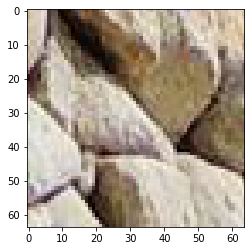

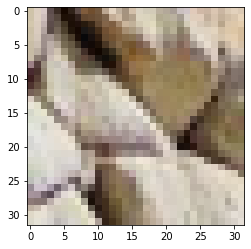

/content/Data_set_Train_x2/770/patch_766_1_12.jpg
/content/Data_set_Train_x2/770/patch_763_1_2.jpg
/content/Data_set_Train_x2/770/patch_763_1_17.jpg
/content/Data_set_Train_x2/770/patch_763_3_28.jpg
/content/Data_set_Train_x2/770/patch_762_11_13.jpg
/content/Data_set_Train_x2/770/patch_762_11_18.jpg
/content/Data_set_Train_x2/770/patch_763_2_7.jpg
/content/Data_set_Train_x2/770/patch_762_11_29.jpg
/content/Data_set_Train_x2/770/patch_762_17_7.jpg
/content/Data_set_Train_x2/770/patch_762_17_5.jpg
/content/Data_set_Train_x2/770/patch_763_2_10.jpg
/content/Data_set_Train_x2/770/patch_763_1_21.jpg
/content/Data_set_Train_x2/770/patch_763_4_12.jpg
/content/Data_set_Train_x2/770/patch_763_0_2.jpg
/content/Data_set_Train_x2/770/patch_762_11_4.jpg
/content/Data_set_Train_x2/770/patch_763_3_1.jpg
/content/Data_set_Train_x2/770/patch_762_12_24.jpg
/content/Data_set_Train_x2/770/patch_762_12_11.jpg
/content/Data_set_Train_x2/770/patch_762_14_28.jpg
/content/Data_set_Train_x2/770/patch_762_12_7.jp

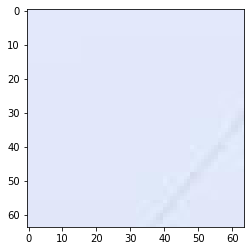

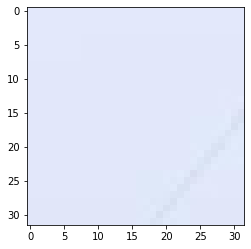

/content/Data_set_Train_x2/770/patch_764_5_8.jpg
/content/Data_set_Train_x2/770/patch_763_11_11.jpg
/content/Data_set_Train_x2/770/patch_763_12_5.jpg
/content/Data_set_Train_x2/770/patch_763_13_18.jpg
/content/Data_set_Train_x2/770/patch_763_14_29.jpg
/content/Data_set_Train_x2/770/patch_764_0_0.jpg
/content/Data_set_Train_x2/770/patch_763_11_18.jpg
/content/Data_set_Train_x2/770/patch_763_17_18.jpg
/content/Data_set_Train_x2/770/patch_764_2_6.jpg
/content/Data_set_Train_x2/770/patch_763_13_6.jpg
/content/Data_set_Train_x2/770/patch_764_2_14.jpg
/content/Data_set_Train_x2/770/patch_763_10_25.jpg
/content/Data_set_Train_x2/770/patch_763_14_19.jpg
/content/Data_set_Train_x2/770/patch_763_16_15.jpg
/content/Data_set_Train_x2/770/patch_763_17_1.jpg
/content/Data_set_Train_x2/770/patch_764_2_7.jpg
/content/Data_set_Train_x2/770/patch_763_16_18.jpg
/content/Data_set_Train_x2/770/patch_763_14_5.jpg
/content/Data_set_Train_x2/770/patch_763_20_30.jpg
/content/Data_set_Train_x2/770/patch_763_13_

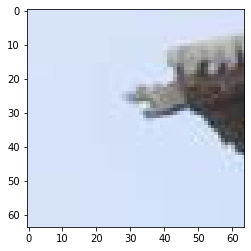

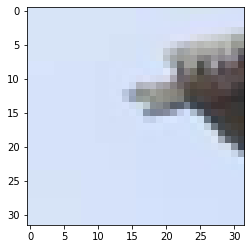

/content/Data_set_Train_x2/770/patch_764_19_1.jpg
/content/Data_set_Train_x2/770/patch_761_4_19.jpg
/content/Data_set_Train_x2/770/patch_761_9_15.jpg
/content/Data_set_Train_x2/770/patch_761_14_18.jpg
/content/Data_set_Train_x2/770/patch_761_0_2.jpg
/content/Data_set_Train_x2/770/patch_761_8_13.jpg
/content/Data_set_Train_x2/770/patch_761_15_16.jpg
/content/Data_set_Train_x2/770/patch_760_20_26.jpg
/content/Data_set_Train_x2/770/patch_761_9_25.jpg
/content/Data_set_Train_x2/770/patch_761_7_25.jpg
/content/Data_set_Train_x2/770/patch_761_3_11.jpg
/content/Data_set_Train_x2/770/patch_761_1_18.jpg
/content/Data_set_Train_x2/770/patch_761_11_30.jpg
/content/Data_set_Train_x2/770/patch_761_14_19.jpg
/content/Data_set_Train_x2/770/patch_761_9_8.jpg
/content/Data_set_Train_x2/770/patch_761_1_8.jpg
/content/Data_set_Train_x2/770/patch_761_10_6.jpg
/content/Data_set_Train_x2/770/patch_761_15_11.jpg
/content/Data_set_Train_x2/770/patch_761_13_18.jpg
/content/Data_set_Train_x2/770/patch_761_6_17.

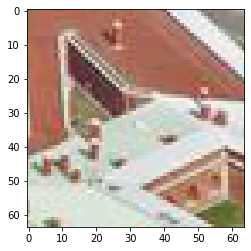

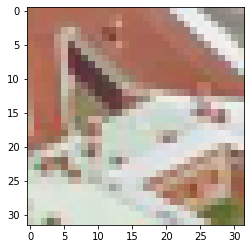

/content/Data_set_Train_x2/770/patch_762_6_18.jpg
/content/Data_set_Train_x2/770/patch_762_0_14.jpg
/content/Data_set_Train_x2/770/patch_762_5_24.jpg
/content/Data_set_Train_x2/770/patch_762_7_19.jpg
/content/Data_set_Train_x2/770/patch_762_7_16.jpg
/content/Data_set_Train_x2/770/patch_762_4_0.jpg
/content/Data_set_Train_x2/770/patch_762_1_12.jpg
/content/Data_set_Train_x2/770/patch_761_17_28.jpg
/content/Data_set_Train_x2/770/patch_762_2_2.jpg
/content/Data_set_Train_x2/770/patch_762_7_3.jpg
/content/Data_set_Train_x2/770/patch_762_4_29.jpg
/content/Data_set_Train_x2/770/patch_762_1_18.jpg
/content/Data_set_Train_x2/770/patch_762_1_17.jpg
/content/Data_set_Train_x2/770/patch_762_6_0.jpg
/content/Data_set_Train_x2/770/patch_762_7_14.jpg
/content/Data_set_Train_x2/770/patch_762_1_13.jpg
/content/Data_set_Train_x2/770/patch_761_17_22.jpg
/content/Data_set_Train_x2/770/patch_761_19_8.jpg
/content/Data_set_Train_x2/770/patch_761_20_18.jpg
/content/Data_set_Train_x2/770/patch_761_20_1.jpg
/

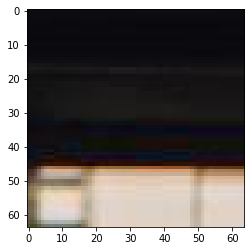

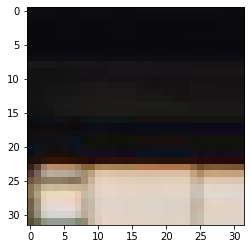

/content/Data_set_Train_x2/770/patch_763_1_16.jpg
/content/Data_set_Train_x2/770/patch_760_2_24.jpg
/content/Data_set_Train_x2/770/patch_760_3_4.jpg
/content/Data_set_Train_x2/770/patch_760_4_6.jpg
/content/Data_set_Train_x2/770/patch_760_4_10.jpg
/content/Data_set_Train_x2/770/patch_760_3_15.jpg
/content/Data_set_Train_x2/770/patch_760_2_6.jpg
/content/Data_set_Train_x2/770/patch_760_1_26.jpg
/content/Data_set_Train_x2/770/patch_760_3_25.jpg
/content/Data_set_Train_x2/770/patch_760_2_10.jpg
/content/Data_set_Train_x2/770/patch_760_4_11.jpg
/content/Data_set_Train_x2/770/patch_760_0_20.jpg
/content/Data_set_Train_x2/770/patch_760_3_24.jpg
/content/Data_set_Train_x2/770/patch_760_1_9.jpg
/content/Data_set_Train_x2/770/patch_760_3_0.jpg
/content/Data_set_Train_x2/770/patch_760_1_19.jpg
/content/Data_set_Train_x2/770/patch_760_3_10.jpg
/content/Data_set_Train_x2/770/patch_760_2_3.jpg
/content/Data_set_Train_x2/770/patch_760_0_27.jpg
/content/Data_set_Train_x2/770/patch_760_1_3.jpg
/conten

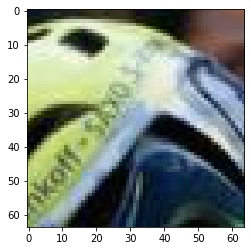

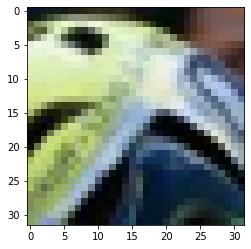

/content/Data_set_Train_x2/770/patch_760_6_11.jpg
/content/Data_set_Train_x2/770/patch_760_4_17.jpg
/content/Data_set_Train_x2/770/patch_760_13_8.jpg
/content/Data_set_Train_x2/770/patch_760_12_2.jpg
/content/Data_set_Train_x2/770/patch_760_7_24.jpg
/content/Data_set_Train_x2/770/patch_760_8_2.jpg
/content/Data_set_Train_x2/770/patch_760_20_9.jpg
/content/Data_set_Train_x2/770/patch_760_14_30.jpg
/content/Data_set_Train_x2/770/patch_760_13_5.jpg
/content/Data_set_Train_x2/770/patch_760_6_18.jpg
/content/Data_set_Train_x2/770/patch_760_9_13.jpg
/content/Data_set_Train_x2/770/patch_760_18_1.jpg
/content/Data_set_Train_x2/770/patch_760_12_29.jpg
/content/Data_set_Train_x2/770/patch_760_10_0.jpg
/content/Data_set_Train_x2/770/patch_760_6_24.jpg
/content/Data_set_Train_x2/770/patch_760_15_23.jpg
/content/Data_set_Train_x2/770/patch_760_10_29.jpg
/content/Data_set_Train_x2/770/patch_760_8_26.jpg
/content/Data_set_Train_x2/770/patch_760_11_1.jpg
/content/Data_set_Train_x2/770/patch_760_5_8.jp

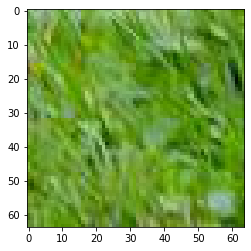

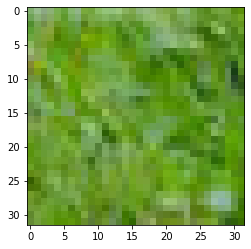

/content/Data_set_Train_x2/780/patch_779_0_25.jpg
/content/Data_set_Train_x2/780/patch_778_20_18.jpg
/content/Data_set_Train_x2/780/patch_779_6_3.jpg
/content/Data_set_Train_x2/780/patch_779_6_18.jpg
/content/Data_set_Train_x2/780/patch_779_2_5.jpg
/content/Data_set_Train_x2/780/patch_779_12_1.jpg
/content/Data_set_Train_x2/780/patch_779_3_28.jpg
/content/Data_set_Train_x2/780/patch_779_2_8.jpg
/content/Data_set_Train_x2/780/patch_779_0_16.jpg
/content/Data_set_Train_x2/780/patch_779_0_11.jpg
/content/Data_set_Train_x2/780/patch_779_5_24.jpg
/content/Data_set_Train_x2/780/patch_779_8_6.jpg
/content/Data_set_Train_x2/780/patch_779_9_10.jpg
/content/Data_set_Train_x2/780/patch_779_4_28.jpg
/content/Data_set_Train_x2/780/patch_779_0_2.jpg
/content/Data_set_Train_x2/780/patch_779_7_9.jpg
/content/Data_set_Train_x2/780/patch_779_11_3.jpg
/content/Data_set_Train_x2/780/patch_779_8_29.jpg
/content/Data_set_Train_x2/780/patch_779_10_20.jpg
/content/Data_set_Train_x2/780/patch_779_2_18.jpg
/con

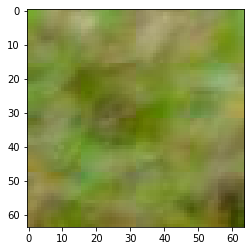

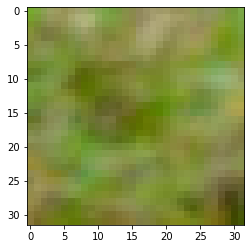

/content/Data_set_Train_x2/780/patch_779_19_27.jpg
/content/Data_set_Train_x2/780/patch_776_25_20.jpg
/content/Data_set_Train_x2/780/patch_776_29_13.jpg
/content/Data_set_Train_x2/780/patch_776_23_16.jpg
/content/Data_set_Train_x2/780/patch_777_2_28.jpg
/content/Data_set_Train_x2/780/patch_777_0_19.jpg
/content/Data_set_Train_x2/780/patch_776_28_16.jpg
/content/Data_set_Train_x2/780/patch_776_20_12.jpg
/content/Data_set_Train_x2/780/patch_777_4_13.jpg
/content/Data_set_Train_x2/780/patch_777_3_13.jpg
/content/Data_set_Train_x2/780/patch_776_19_1.jpg
/content/Data_set_Train_x2/780/patch_777_2_14.jpg
/content/Data_set_Train_x2/780/patch_776_29_19.jpg
/content/Data_set_Train_x2/780/patch_776_17_18.jpg
/content/Data_set_Train_x2/780/patch_776_27_4.jpg
/content/Data_set_Train_x2/780/patch_776_16_3.jpg
/content/Data_set_Train_x2/780/patch_776_27_13.jpg
/content/Data_set_Train_x2/780/patch_776_29_1.jpg
/content/Data_set_Train_x2/780/patch_776_20_3.jpg
/content/Data_set_Train_x2/780/patch_776_

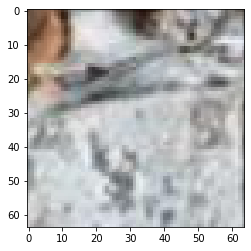

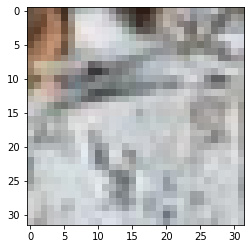

/content/Data_set_Train_x2/780/patch_777_13_20.jpg
/content/Data_set_Train_x2/780/patch_777_12_18.jpg
/content/Data_set_Train_x2/780/patch_778_1_4.jpg
/content/Data_set_Train_x2/780/patch_777_6_0.jpg
/content/Data_set_Train_x2/780/patch_777_5_17.jpg
/content/Data_set_Train_x2/780/patch_777_13_17.jpg
/content/Data_set_Train_x2/780/patch_777_13_2.jpg
/content/Data_set_Train_x2/780/patch_777_6_12.jpg
/content/Data_set_Train_x2/780/patch_777_17_30.jpg
/content/Data_set_Train_x2/780/patch_777_11_6.jpg
/content/Data_set_Train_x2/780/patch_777_8_10.jpg
/content/Data_set_Train_x2/780/patch_777_18_18.jpg
/content/Data_set_Train_x2/780/patch_777_17_18.jpg
/content/Data_set_Train_x2/780/patch_777_16_17.jpg
/content/Data_set_Train_x2/780/patch_777_16_2.jpg
/content/Data_set_Train_x2/780/patch_777_15_11.jpg
/content/Data_set_Train_x2/780/patch_777_14_25.jpg
/content/Data_set_Train_x2/780/patch_777_6_24.jpg
/content/Data_set_Train_x2/780/patch_777_18_1.jpg
/content/Data_set_Train_x2/780/patch_778_1_

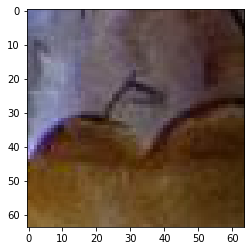

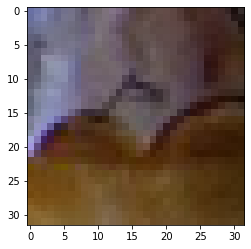

/content/Data_set_Train_x2/780/patch_778_9_23.jpg
/content/Data_set_Train_x2/780/patch_775_0_4.jpg
/content/Data_set_Train_x2/780/patch_775_12_1.jpg
/content/Data_set_Train_x2/780/patch_775_10_10.jpg
/content/Data_set_Train_x2/780/patch_775_13_28.jpg
/content/Data_set_Train_x2/780/patch_775_0_27.jpg
/content/Data_set_Train_x2/780/patch_775_3_6.jpg
/content/Data_set_Train_x2/780/patch_775_1_26.jpg
/content/Data_set_Train_x2/780/patch_775_13_27.jpg
/content/Data_set_Train_x2/780/patch_775_1_30.jpg
/content/Data_set_Train_x2/780/patch_775_2_9.jpg
/content/Data_set_Train_x2/780/patch_775_13_30.jpg
/content/Data_set_Train_x2/780/patch_775_5_2.jpg
/content/Data_set_Train_x2/780/patch_775_6_20.jpg
/content/Data_set_Train_x2/780/patch_775_3_21.jpg
/content/Data_set_Train_x2/780/patch_775_8_15.jpg
/content/Data_set_Train_x2/780/patch_775_13_15.jpg
/content/Data_set_Train_x2/780/patch_775_0_2.jpg
/content/Data_set_Train_x2/780/patch_775_5_10.jpg
/content/Data_set_Train_x2/780/patch_775_0_9.jpg
/

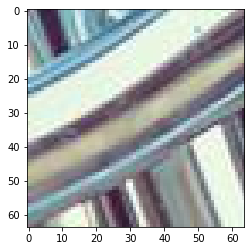

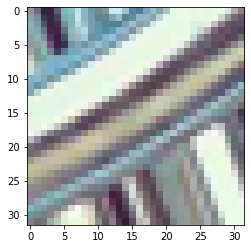

/content/Data_set_Train_x2/780/patch_776_11_14.jpg
/content/Data_set_Train_x2/780/patch_776_14_13.jpg
/content/Data_set_Train_x2/780/patch_776_4_3.jpg
/content/Data_set_Train_x2/780/patch_776_3_6.jpg
/content/Data_set_Train_x2/780/patch_775_15_7.jpg
/content/Data_set_Train_x2/780/patch_775_18_10.jpg
/content/Data_set_Train_x2/780/patch_776_5_11.jpg
/content/Data_set_Train_x2/780/patch_776_2_13.jpg
/content/Data_set_Train_x2/780/patch_776_11_3.jpg
/content/Data_set_Train_x2/780/patch_776_8_0.jpg
/content/Data_set_Train_x2/780/patch_775_18_1.jpg
/content/Data_set_Train_x2/780/patch_776_8_14.jpg
/content/Data_set_Train_x2/780/patch_776_10_15.jpg
/content/Data_set_Train_x2/780/patch_776_9_15.jpg
/content/Data_set_Train_x2/780/patch_775_19_18.jpg
/content/Data_set_Train_x2/780/patch_775_16_19.jpg
/content/Data_set_Train_x2/780/patch_775_16_4.jpg
/content/Data_set_Train_x2/780/patch_775_19_1.jpg
/content/Data_set_Train_x2/780/patch_776_12_8.jpg
/content/Data_set_Train_x2/780/patch_776_12_15.

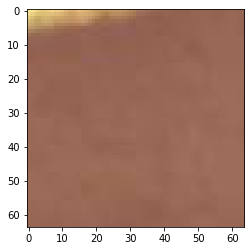

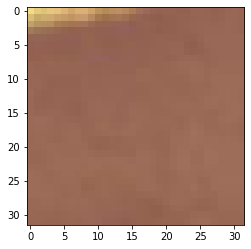

/content/Data_set_Train_x2/780/patch_776_18_1.jpg
/content/Data_set_Train_x2/780/patch_773_15_3.jpg
/content/Data_set_Train_x2/780/patch_774_1_19.jpg
/content/Data_set_Train_x2/780/patch_773_13_7.jpg
/content/Data_set_Train_x2/780/patch_773_18_0.jpg
/content/Data_set_Train_x2/780/patch_774_2_19.jpg
/content/Data_set_Train_x2/780/patch_774_2_20.jpg
/content/Data_set_Train_x2/780/patch_773_17_16.jpg
/content/Data_set_Train_x2/780/patch_773_9_11.jpg
/content/Data_set_Train_x2/780/patch_773_15_16.jpg
/content/Data_set_Train_x2/780/patch_773_10_9.jpg
/content/Data_set_Train_x2/780/patch_774_2_10.jpg
/content/Data_set_Train_x2/780/patch_773_8_15.jpg
/content/Data_set_Train_x2/780/patch_773_12_18.jpg
/content/Data_set_Train_x2/780/patch_773_14_17.jpg
/content/Data_set_Train_x2/780/patch_774_0_1.jpg
/content/Data_set_Train_x2/780/patch_773_13_24.jpg
/content/Data_set_Train_x2/780/patch_773_10_15.jpg
/content/Data_set_Train_x2/780/patch_773_10_8.jpg
/content/Data_set_Train_x2/780/patch_773_8_24

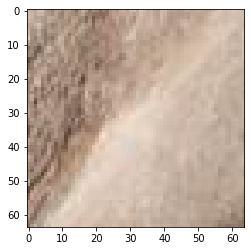

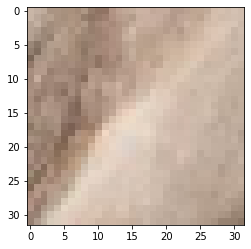

/content/Data_set_Train_x2/780/patch_774_8_19.jpg
/content/Data_set_Train_x2/780/patch_774_17_21.jpg
/content/Data_set_Train_x2/780/patch_774_7_30.jpg
/content/Data_set_Train_x2/780/patch_774_10_19.jpg
/content/Data_set_Train_x2/780/patch_774_5_21.jpg
/content/Data_set_Train_x2/780/patch_774_14_7.jpg
/content/Data_set_Train_x2/780/patch_774_15_29.jpg
/content/Data_set_Train_x2/780/patch_774_18_7.jpg
/content/Data_set_Train_x2/780/patch_774_14_11.jpg
/content/Data_set_Train_x2/780/patch_774_15_13.jpg
/content/Data_set_Train_x2/780/patch_774_12_23.jpg
/content/Data_set_Train_x2/780/patch_774_14_19.jpg
/content/Data_set_Train_x2/780/patch_774_5_7.jpg
/content/Data_set_Train_x2/780/patch_774_12_11.jpg
/content/Data_set_Train_x2/780/patch_774_4_26.jpg
/content/Data_set_Train_x2/780/patch_774_7_22.jpg
/content/Data_set_Train_x2/780/patch_774_5_0.jpg
/content/Data_set_Train_x2/780/patch_774_9_9.jpg
/content/Data_set_Train_x2/780/patch_774_5_15.jpg
/content/Data_set_Train_x2/780/patch_774_18_1

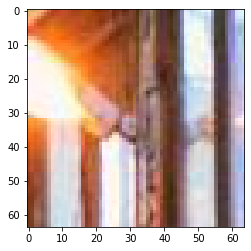

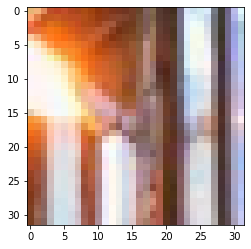

/content/Data_set_Train_x2/780/patch_775_6_15.jpg
/content/Data_set_Train_x2/780/patch_771_14_5.jpg
/content/Data_set_Train_x2/780/patch_771_11_17.jpg
/content/Data_set_Train_x2/780/patch_771_12_10.jpg
/content/Data_set_Train_x2/780/patch_771_19_12.jpg
/content/Data_set_Train_x2/780/patch_771_11_13.jpg
/content/Data_set_Train_x2/780/patch_771_19_0.jpg
/content/Data_set_Train_x2/780/patch_771_18_26.jpg
/content/Data_set_Train_x2/780/patch_771_9_6.jpg
/content/Data_set_Train_x2/780/patch_771_16_27.jpg
/content/Data_set_Train_x2/780/patch_771_15_14.jpg
/content/Data_set_Train_x2/780/patch_771_12_24.jpg
/content/Data_set_Train_x2/780/patch_772_3_8.jpg
/content/Data_set_Train_x2/780/patch_772_4_0.jpg
/content/Data_set_Train_x2/780/patch_772_3_2.jpg
/content/Data_set_Train_x2/780/patch_771_9_1.jpg
/content/Data_set_Train_x2/780/patch_772_3_19.jpg
/content/Data_set_Train_x2/780/patch_771_20_2.jpg
/content/Data_set_Train_x2/780/patch_772_3_0.jpg
/content/Data_set_Train_x2/780/patch_771_17_7.jp

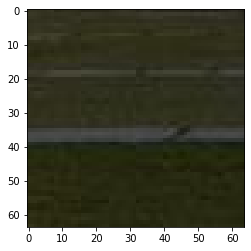

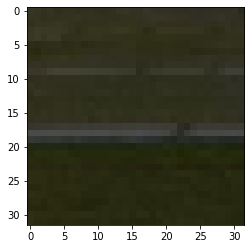

/content/Data_set_Train_x2/780/patch_772_11_13.jpg
/content/Data_set_Train_x2/780/patch_773_1_8.jpg
/content/Data_set_Train_x2/780/patch_772_11_8.jpg
/content/Data_set_Train_x2/780/patch_773_4_25.jpg
/content/Data_set_Train_x2/780/patch_772_9_20.jpg
/content/Data_set_Train_x2/780/patch_772_4_23.jpg
/content/Data_set_Train_x2/780/patch_773_7_0.jpg
/content/Data_set_Train_x2/780/patch_773_4_9.jpg
/content/Data_set_Train_x2/780/patch_773_2_6.jpg
/content/Data_set_Train_x2/780/patch_772_5_20.jpg
/content/Data_set_Train_x2/780/patch_773_6_29.jpg
/content/Data_set_Train_x2/780/patch_772_8_20.jpg
/content/Data_set_Train_x2/780/patch_773_0_14.jpg
/content/Data_set_Train_x2/780/patch_773_7_2.jpg
/content/Data_set_Train_x2/780/patch_773_5_24.jpg
/content/Data_set_Train_x2/780/patch_773_2_15.jpg
/content/Data_set_Train_x2/780/patch_772_9_21.jpg
/content/Data_set_Train_x2/780/patch_773_3_0.jpg
/content/Data_set_Train_x2/780/patch_773_6_0.jpg
/content/Data_set_Train_x2/780/patch_772_9_19.jpg
/conte

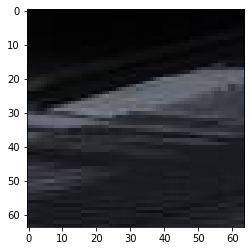

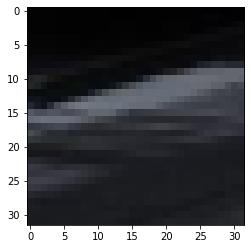

/content/Data_set_Train_x2/780/patch_773_13_11.jpg
/content/Data_set_Train_x2/780/patch_770_2_3.jpg
/content/Data_set_Train_x2/780/patch_770_10_5.jpg
/content/Data_set_Train_x2/780/patch_770_7_5.jpg
/content/Data_set_Train_x2/780/patch_770_3_21.jpg
/content/Data_set_Train_x2/780/patch_770_10_24.jpg
/content/Data_set_Train_x2/780/patch_770_11_5.jpg
/content/Data_set_Train_x2/780/patch_770_5_9.jpg
/content/Data_set_Train_x2/780/patch_770_11_28.jpg
/content/Data_set_Train_x2/780/patch_770_0_0.jpg
/content/Data_set_Train_x2/780/patch_770_12_26.jpg
/content/Data_set_Train_x2/780/patch_770_1_25.jpg
/content/Data_set_Train_x2/780/patch_770_6_16.jpg
/content/Data_set_Train_x2/780/patch_770_4_19.jpg
/content/Data_set_Train_x2/780/patch_770_0_19.jpg
/content/Data_set_Train_x2/780/patch_770_4_3.jpg
/content/Data_set_Train_x2/780/patch_770_6_8.jpg
/content/Data_set_Train_x2/780/patch_770_5_18.jpg
/content/Data_set_Train_x2/780/patch_770_7_1.jpg
/content/Data_set_Train_x2/780/patch_770_7_6.jpg
/con

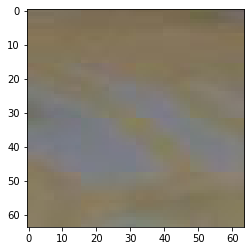

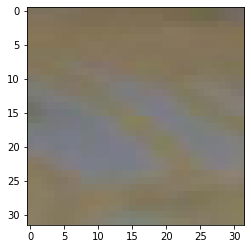

/content/Data_set_Train_x2/780/patch_771_0_14.jpg
/content/Data_set_Train_x2/780/patch_770_19_13.jpg
/content/Data_set_Train_x2/780/patch_771_6_10.jpg
/content/Data_set_Train_x2/780/patch_771_5_14.jpg
/content/Data_set_Train_x2/780/patch_770_19_30.jpg
/content/Data_set_Train_x2/780/patch_770_14_9.jpg
/content/Data_set_Train_x2/780/patch_771_5_21.jpg
/content/Data_set_Train_x2/780/patch_771_0_17.jpg
/content/Data_set_Train_x2/780/patch_771_4_25.jpg
/content/Data_set_Train_x2/780/patch_770_15_0.jpg
/content/Data_set_Train_x2/780/patch_771_0_24.jpg
/content/Data_set_Train_x2/780/patch_771_5_23.jpg
/content/Data_set_Train_x2/780/patch_770_15_4.jpg
/content/Data_set_Train_x2/780/patch_771_6_27.jpg
/content/Data_set_Train_x2/780/patch_770_19_2.jpg
/content/Data_set_Train_x2/780/patch_770_18_30.jpg
/content/Data_set_Train_x2/780/patch_770_14_28.jpg
/content/Data_set_Train_x2/780/patch_771_2_8.jpg
/content/Data_set_Train_x2/780/patch_771_1_22.jpg
/content/Data_set_Train_x2/780/patch_770_20_5.j

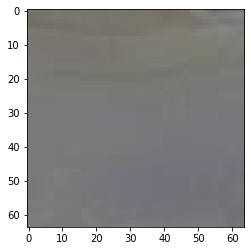

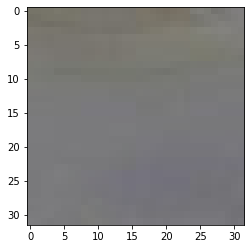

/content/Data_set_Train_x2/780/patch_771_20_9.jpg
/content/Data_set_Train_x2/780/patch_770_3_24.jpg
/content/Data_set_Train_x2/780/patch_770_5_13.jpg
/content/Data_set_Train_x2/780/patch_770_2_28.jpg
/content/Data_set_Train_x2/780/patch_770_6_9.jpg
/content/Data_set_Train_x2/780/patch_770_7_30.jpg
/content/Data_set_Train_x2/780/patch_770_1_13.jpg
/content/Data_set_Train_x2/780/patch_770_13_10.jpg
/content/Data_set_Train_x2/780/patch_770_10_1.jpg
/content/Data_set_Train_x2/780/patch_770_1_24.jpg
/content/Data_set_Train_x2/780/patch_770_5_6.jpg
/content/Data_set_Train_x2/780/patch_770_6_3.jpg
/content/Data_set_Train_x2/780/patch_770_7_27.jpg
/content/Data_set_Train_x2/780/patch_770_13_8.jpg
/content/Data_set_Train_x2/780/patch_770_7_26.jpg
/content/Data_set_Train_x2/780/patch_770_10_26.jpg
/content/Data_set_Train_x2/780/patch_770_7_28.jpg
/content/Data_set_Train_x2/780/patch_770_6_28.jpg
/content/Data_set_Train_x2/780/patch_770_13_16.jpg
/content/Data_set_Train_x2/780/patch_770_1_20.jpg


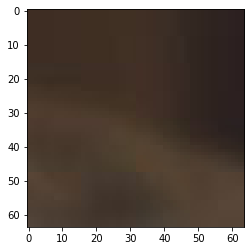

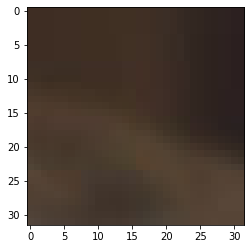

/content/Data_set_Train_x2/790/patch_789_8_22.jpg
/content/Data_set_Train_x2/790/patch_789_9_18.jpg
/content/Data_set_Train_x2/790/patch_789_12_23.jpg
/content/Data_set_Train_x2/790/patch_789_2_25.jpg
/content/Data_set_Train_x2/790/patch_789_9_24.jpg
/content/Data_set_Train_x2/790/patch_789_9_14.jpg
/content/Data_set_Train_x2/790/patch_789_1_2.jpg
/content/Data_set_Train_x2/790/patch_789_12_18.jpg
/content/Data_set_Train_x2/790/patch_789_4_12.jpg
/content/Data_set_Train_x2/790/patch_789_3_24.jpg
/content/Data_set_Train_x2/790/patch_789_3_25.jpg
/content/Data_set_Train_x2/790/patch_789_3_28.jpg
/content/Data_set_Train_x2/790/patch_789_7_21.jpg
/content/Data_set_Train_x2/790/patch_789_13_18.jpg
/content/Data_set_Train_x2/790/patch_789_10_29.jpg
/content/Data_set_Train_x2/790/patch_789_11_17.jpg
/content/Data_set_Train_x2/790/patch_789_2_17.jpg
/content/Data_set_Train_x2/790/patch_789_6_9.jpg
/content/Data_set_Train_x2/790/patch_789_4_15.jpg
/content/Data_set_Train_x2/790/patch_789_11_11.

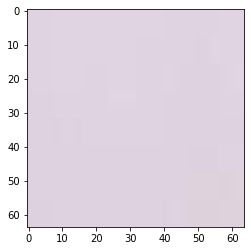

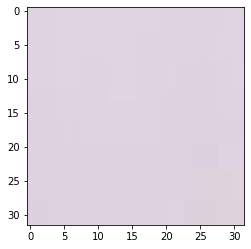

/content/Data_set_Train_x2/790/patch_789_18_13.jpg
/content/Data_set_Train_x2/790/patch_786_19_2.jpg
/content/Data_set_Train_x2/790/patch_787_6_3.jpg
/content/Data_set_Train_x2/790/patch_787_0_3.jpg
/content/Data_set_Train_x2/790/patch_787_5_29.jpg
/content/Data_set_Train_x2/790/patch_787_6_4.jpg
/content/Data_set_Train_x2/790/patch_786_17_11.jpg
/content/Data_set_Train_x2/790/patch_786_17_3.jpg
/content/Data_set_Train_x2/790/patch_786_19_11.jpg
/content/Data_set_Train_x2/790/patch_787_2_4.jpg
/content/Data_set_Train_x2/790/patch_787_2_15.jpg
/content/Data_set_Train_x2/790/patch_787_8_19.jpg
/content/Data_set_Train_x2/790/patch_787_7_2.jpg
/content/Data_set_Train_x2/790/patch_787_3_29.jpg
/content/Data_set_Train_x2/790/patch_786_14_1.jpg
/content/Data_set_Train_x2/790/patch_786_15_26.jpg
/content/Data_set_Train_x2/790/patch_787_2_5.jpg
/content/Data_set_Train_x2/790/patch_787_6_28.jpg
/content/Data_set_Train_x2/790/patch_786_16_24.jpg
/content/Data_set_Train_x2/790/patch_787_1_6.jpg
/c

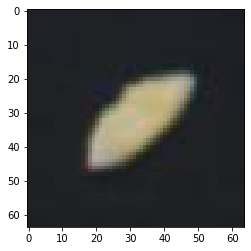

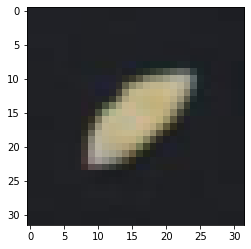

/content/Data_set_Train_x2/790/patch_787_14_5.jpg
/content/Data_set_Train_x2/790/patch_787_15_13.jpg
/content/Data_set_Train_x2/790/patch_788_1_25.jpg
/content/Data_set_Train_x2/790/patch_787_19_15.jpg
/content/Data_set_Train_x2/790/patch_787_20_7.jpg
/content/Data_set_Train_x2/790/patch_788_2_27.jpg
/content/Data_set_Train_x2/790/patch_787_17_24.jpg
/content/Data_set_Train_x2/790/patch_787_16_22.jpg
/content/Data_set_Train_x2/790/patch_788_2_0.jpg
/content/Data_set_Train_x2/790/patch_787_16_15.jpg
/content/Data_set_Train_x2/790/patch_787_15_23.jpg
/content/Data_set_Train_x2/790/patch_787_15_25.jpg
/content/Data_set_Train_x2/790/patch_787_11_20.jpg
/content/Data_set_Train_x2/790/patch_787_14_16.jpg
/content/Data_set_Train_x2/790/patch_788_1_5.jpg
/content/Data_set_Train_x2/790/patch_788_2_26.jpg
/content/Data_set_Train_x2/790/patch_788_3_30.jpg
/content/Data_set_Train_x2/790/patch_787_12_2.jpg
/content/Data_set_Train_x2/790/patch_787_18_28.jpg
/content/Data_set_Train_x2/790/patch_787_1

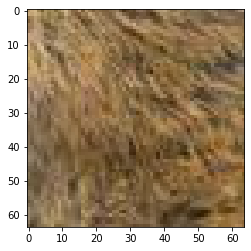

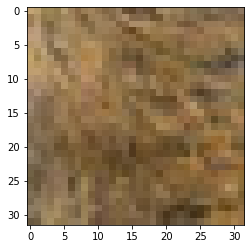

/content/Data_set_Train_x2/790/patch_788_6_19.jpg
/content/Data_set_Train_x2/790/patch_785_10_29.jpg
/content/Data_set_Train_x2/790/patch_785_12_4.jpg
/content/Data_set_Train_x2/790/patch_785_6_29.jpg
/content/Data_set_Train_x2/790/patch_785_17_0.jpg
/content/Data_set_Train_x2/790/patch_785_15_24.jpg
/content/Data_set_Train_x2/790/patch_785_11_11.jpg
/content/Data_set_Train_x2/790/patch_785_9_18.jpg
/content/Data_set_Train_x2/790/patch_785_20_30.jpg
/content/Data_set_Train_x2/790/patch_785_19_30.jpg
/content/Data_set_Train_x2/790/patch_785_17_7.jpg
/content/Data_set_Train_x2/790/patch_785_11_25.jpg
/content/Data_set_Train_x2/790/patch_785_6_2.jpg
/content/Data_set_Train_x2/790/patch_785_6_0.jpg
/content/Data_set_Train_x2/790/patch_785_7_26.jpg
/content/Data_set_Train_x2/790/patch_785_17_9.jpg
/content/Data_set_Train_x2/790/patch_785_9_27.jpg
/content/Data_set_Train_x2/790/patch_785_17_4.jpg
/content/Data_set_Train_x2/790/patch_785_7_19.jpg
/content/Data_set_Train_x2/790/patch_785_13_25

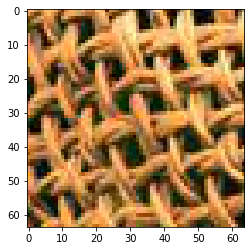

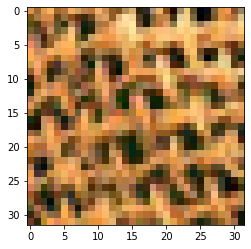

/content/Data_set_Train_x2/790/patch_786_11_12.jpg
/content/Data_set_Train_x2/790/patch_785_22_26.jpg
/content/Data_set_Train_x2/790/patch_786_0_8.jpg
/content/Data_set_Train_x2/790/patch_786_1_29.jpg
/content/Data_set_Train_x2/790/patch_786_1_19.jpg
/content/Data_set_Train_x2/790/patch_786_12_10.jpg
/content/Data_set_Train_x2/790/patch_786_0_22.jpg
/content/Data_set_Train_x2/790/patch_786_6_11.jpg
/content/Data_set_Train_x2/790/patch_786_10_27.jpg
/content/Data_set_Train_x2/790/patch_786_2_0.jpg
/content/Data_set_Train_x2/790/patch_786_7_25.jpg
/content/Data_set_Train_x2/790/patch_786_10_6.jpg
/content/Data_set_Train_x2/790/patch_786_5_4.jpg
/content/Data_set_Train_x2/790/patch_786_10_12.jpg
/content/Data_set_Train_x2/790/patch_786_1_25.jpg
/content/Data_set_Train_x2/790/patch_786_1_3.jpg
/content/Data_set_Train_x2/790/patch_786_9_22.jpg
/content/Data_set_Train_x2/790/patch_785_23_22.jpg
/content/Data_set_Train_x2/790/patch_785_21_25.jpg
/content/Data_set_Train_x2/790/patch_786_3_11.j

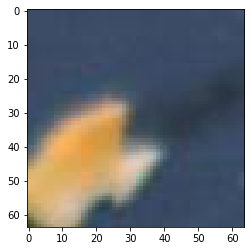

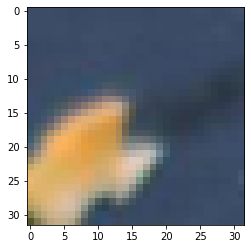

/content/Data_set_Train_x2/790/patch_787_5_16.jpg
/content/Data_set_Train_x2/790/patch_783_15_21.jpg
/content/Data_set_Train_x2/790/patch_784_3_17.jpg
/content/Data_set_Train_x2/790/patch_783_18_11.jpg
/content/Data_set_Train_x2/790/patch_783_14_25.jpg
/content/Data_set_Train_x2/790/patch_783_13_4.jpg
/content/Data_set_Train_x2/790/patch_784_1_14.jpg
/content/Data_set_Train_x2/790/patch_783_18_17.jpg
/content/Data_set_Train_x2/790/patch_784_2_5.jpg
/content/Data_set_Train_x2/790/patch_784_1_0.jpg
/content/Data_set_Train_x2/790/patch_783_17_17.jpg
/content/Data_set_Train_x2/790/patch_783_15_9.jpg
/content/Data_set_Train_x2/790/patch_784_0_10.jpg
/content/Data_set_Train_x2/790/patch_783_13_3.jpg
/content/Data_set_Train_x2/790/patch_783_18_30.jpg
/content/Data_set_Train_x2/790/patch_783_18_24.jpg
/content/Data_set_Train_x2/790/patch_783_14_23.jpg
/content/Data_set_Train_x2/790/patch_784_5_21.jpg
/content/Data_set_Train_x2/790/patch_784_3_30.jpg
/content/Data_set_Train_x2/790/patch_783_15_

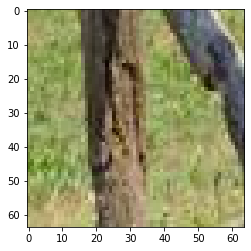

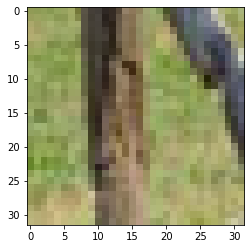

/content/Data_set_Train_x2/790/patch_784_16_7.jpg
/content/Data_set_Train_x2/790/patch_784_12_13.jpg
/content/Data_set_Train_x2/790/patch_784_7_17.jpg
/content/Data_set_Train_x2/790/patch_785_4_26.jpg
/content/Data_set_Train_x2/790/patch_784_12_10.jpg
/content/Data_set_Train_x2/790/patch_784_10_3.jpg
/content/Data_set_Train_x2/790/patch_784_15_9.jpg
/content/Data_set_Train_x2/790/patch_785_0_5.jpg
/content/Data_set_Train_x2/790/patch_785_4_2.jpg
/content/Data_set_Train_x2/790/patch_784_15_6.jpg
/content/Data_set_Train_x2/790/patch_784_6_9.jpg
/content/Data_set_Train_x2/790/patch_784_16_2.jpg
/content/Data_set_Train_x2/790/patch_785_4_16.jpg
/content/Data_set_Train_x2/790/patch_784_11_8.jpg
/content/Data_set_Train_x2/790/patch_784_12_12.jpg
/content/Data_set_Train_x2/790/patch_784_14_15.jpg
/content/Data_set_Train_x2/790/patch_784_5_27.jpg
/content/Data_set_Train_x2/790/patch_785_2_12.jpg
/content/Data_set_Train_x2/790/patch_784_10_26.jpg
/content/Data_set_Train_x2/790/patch_784_7_8.jpg

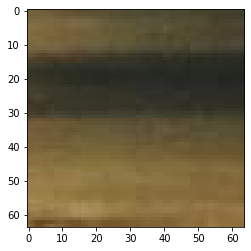

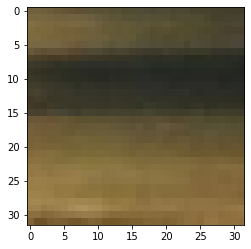

/content/Data_set_Train_x2/790/patch_785_21_11.jpg
/content/Data_set_Train_x2/790/patch_782_9_12.jpg
/content/Data_set_Train_x2/790/patch_782_0_5.jpg
/content/Data_set_Train_x2/790/patch_782_1_30.jpg
/content/Data_set_Train_x2/790/patch_782_6_16.jpg
/content/Data_set_Train_x2/790/patch_782_4_14.jpg
/content/Data_set_Train_x2/790/patch_782_1_25.jpg
/content/Data_set_Train_x2/790/patch_782_5_20.jpg
/content/Data_set_Train_x2/790/patch_782_1_1.jpg
/content/Data_set_Train_x2/790/patch_782_2_10.jpg
/content/Data_set_Train_x2/790/patch_782_4_16.jpg
/content/Data_set_Train_x2/790/patch_782_2_13.jpg
/content/Data_set_Train_x2/790/patch_782_2_6.jpg
/content/Data_set_Train_x2/790/patch_782_11_2.jpg
/content/Data_set_Train_x2/790/patch_782_3_15.jpg
/content/Data_set_Train_x2/790/patch_782_0_8.jpg
/content/Data_set_Train_x2/790/patch_782_5_1.jpg
/content/Data_set_Train_x2/790/patch_782_4_12.jpg
/content/Data_set_Train_x2/790/patch_782_12_22.jpg
/content/Data_set_Train_x2/790/patch_782_11_8.jpg
/co

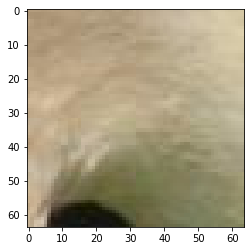

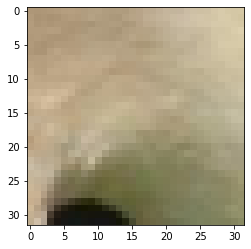

/content/Data_set_Train_x2/790/patch_783_6_12.jpg
/content/Data_set_Train_x2/790/patch_783_3_13.jpg
/content/Data_set_Train_x2/790/patch_782_19_2.jpg
/content/Data_set_Train_x2/790/patch_782_18_13.jpg
/content/Data_set_Train_x2/790/patch_782_20_11.jpg
/content/Data_set_Train_x2/790/patch_783_10_11.jpg
/content/Data_set_Train_x2/790/patch_783_10_4.jpg
/content/Data_set_Train_x2/790/patch_782_19_21.jpg
/content/Data_set_Train_x2/790/patch_783_2_18.jpg
/content/Data_set_Train_x2/790/patch_783_5_11.jpg
/content/Data_set_Train_x2/790/patch_782_17_13.jpg
/content/Data_set_Train_x2/790/patch_783_7_12.jpg
/content/Data_set_Train_x2/790/patch_783_6_19.jpg
/content/Data_set_Train_x2/790/patch_783_9_16.jpg
/content/Data_set_Train_x2/790/patch_783_2_9.jpg
/content/Data_set_Train_x2/790/patch_783_6_14.jpg
/content/Data_set_Train_x2/790/patch_783_3_5.jpg
/content/Data_set_Train_x2/790/patch_783_8_29.jpg
/content/Data_set_Train_x2/790/patch_783_8_11.jpg
/content/Data_set_Train_x2/790/patch_783_7_30.j

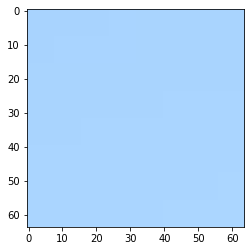

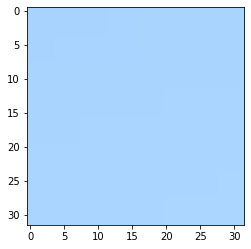

/content/Data_set_Train_x2/790/patch_784_2_28.jpg
/content/Data_set_Train_x2/790/patch_780_11_10.jpg
/content/Data_set_Train_x2/790/patch_780_10_20.jpg
/content/Data_set_Train_x2/790/patch_780_11_15.jpg
/content/Data_set_Train_x2/790/patch_780_14_10.jpg
/content/Data_set_Train_x2/790/patch_780_11_11.jpg
/content/Data_set_Train_x2/790/patch_781_3_19.jpg
/content/Data_set_Train_x2/790/patch_781_0_2.jpg
/content/Data_set_Train_x2/790/patch_780_11_28.jpg
/content/Data_set_Train_x2/790/patch_780_17_1.jpg
/content/Data_set_Train_x2/790/patch_780_13_1.jpg
/content/Data_set_Train_x2/790/patch_780_19_12.jpg
/content/Data_set_Train_x2/790/patch_780_12_4.jpg
/content/Data_set_Train_x2/790/patch_780_17_26.jpg
/content/Data_set_Train_x2/790/patch_780_14_12.jpg
/content/Data_set_Train_x2/790/patch_780_16_25.jpg
/content/Data_set_Train_x2/790/patch_780_15_29.jpg
/content/Data_set_Train_x2/790/patch_780_10_29.jpg
/content/Data_set_Train_x2/790/patch_780_13_28.jpg
/content/Data_set_Train_x2/790/patch_7

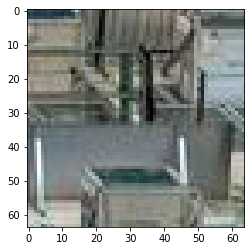

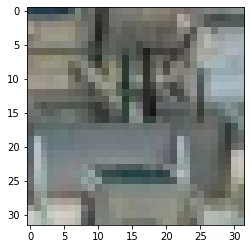

/content/Data_set_Train_x2/790/patch_781_16_21.jpg
/content/Data_set_Train_x2/790/patch_781_15_19.jpg
/content/Data_set_Train_x2/790/patch_781_19_3.jpg
/content/Data_set_Train_x2/790/patch_781_19_4.jpg
/content/Data_set_Train_x2/790/patch_781_14_17.jpg
/content/Data_set_Train_x2/790/patch_781_14_10.jpg
/content/Data_set_Train_x2/790/patch_781_13_24.jpg
/content/Data_set_Train_x2/790/patch_781_11_14.jpg
/content/Data_set_Train_x2/790/patch_781_18_10.jpg
/content/Data_set_Train_x2/790/patch_781_16_22.jpg
/content/Data_set_Train_x2/790/patch_781_11_29.jpg
/content/Data_set_Train_x2/790/patch_781_9_8.jpg
/content/Data_set_Train_x2/790/patch_781_17_12.jpg
/content/Data_set_Train_x2/790/patch_781_16_25.jpg
/content/Data_set_Train_x2/790/patch_781_8_8.jpg
/content/Data_set_Train_x2/790/patch_781_8_0.jpg
/content/Data_set_Train_x2/790/patch_781_16_9.jpg
/content/Data_set_Train_x2/790/patch_781_8_11.jpg
/content/Data_set_Train_x2/790/patch_781_7_26.jpg
/content/Data_set_Train_x2/790/patch_781_6

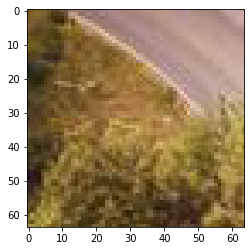

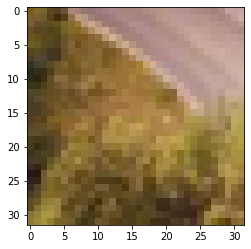

/content/Data_set_Train_x2/790/patch_782_2_25.jpg
/content/Data_set_Train_x2/790/patch_780_2_15.jpg
/content/Data_set_Train_x2/790/patch_780_8_11.jpg
/content/Data_set_Train_x2/790/patch_780_8_8.jpg
/content/Data_set_Train_x2/790/patch_780_1_28.jpg
/content/Data_set_Train_x2/790/patch_780_10_7.jpg
/content/Data_set_Train_x2/790/patch_780_7_10.jpg
/content/Data_set_Train_x2/790/patch_780_5_11.jpg
/content/Data_set_Train_x2/790/patch_780_9_15.jpg
/content/Data_set_Train_x2/790/patch_780_7_17.jpg
/content/Data_set_Train_x2/790/patch_780_6_8.jpg
/content/Data_set_Train_x2/790/patch_780_0_15.jpg
/content/Data_set_Train_x2/790/patch_780_2_18.jpg
/content/Data_set_Train_x2/790/patch_780_8_10.jpg
/content/Data_set_Train_x2/790/patch_780_1_14.jpg
/content/Data_set_Train_x2/790/patch_780_5_8.jpg
/content/Data_set_Train_x2/790/patch_780_6_16.jpg
/content/Data_set_Train_x2/790/patch_780_3_27.jpg
/content/Data_set_Train_x2/790/patch_780_3_2.jpg
/content/Data_set_Train_x2/790/patch_780_5_14.jpg
/con

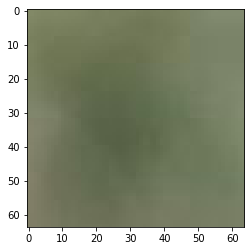

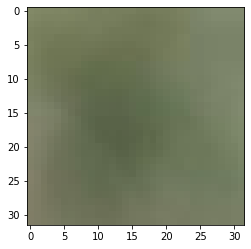

/content/Data_set_Train_x2/800/patch_799_7_26.jpg
/content/Data_set_Train_x2/800/patch_799_11_22.jpg
/content/Data_set_Train_x2/800/patch_799_7_15.jpg
/content/Data_set_Train_x2/800/patch_799_15_11.jpg
/content/Data_set_Train_x2/800/patch_799_15_29.jpg
/content/Data_set_Train_x2/800/patch_799_9_6.jpg
/content/Data_set_Train_x2/800/patch_799_5_5.jpg
/content/Data_set_Train_x2/800/patch_799_10_15.jpg
/content/Data_set_Train_x2/800/patch_799_0_16.jpg
/content/Data_set_Train_x2/800/patch_799_1_24.jpg
/content/Data_set_Train_x2/800/patch_799_4_11.jpg
/content/Data_set_Train_x2/800/patch_799_11_5.jpg
/content/Data_set_Train_x2/800/patch_799_3_9.jpg
/content/Data_set_Train_x2/800/patch_799_2_8.jpg
/content/Data_set_Train_x2/800/patch_799_12_17.jpg
/content/Data_set_Train_x2/800/patch_799_10_20.jpg
/content/Data_set_Train_x2/800/patch_799_9_16.jpg
/content/Data_set_Train_x2/800/patch_799_5_21.jpg
/content/Data_set_Train_x2/800/patch_799_1_17.jpg
/content/Data_set_Train_x2/800/patch_799_10_19.j

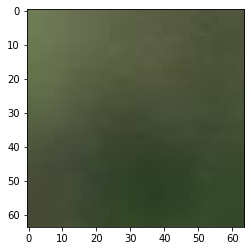

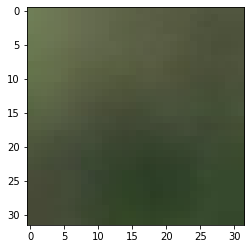

/content/Data_set_Train_x2/800/patch_799_22_28.jpg
/content/Data_set_Train_x2/800/patch_796_16_27.jpg
/content/Data_set_Train_x2/800/patch_797_2_14.jpg
/content/Data_set_Train_x2/800/patch_796_17_18.jpg
/content/Data_set_Train_x2/800/patch_797_3_9.jpg
/content/Data_set_Train_x2/800/patch_796_18_29.jpg
/content/Data_set_Train_x2/800/patch_796_9_24.jpg
/content/Data_set_Train_x2/800/patch_796_15_22.jpg
/content/Data_set_Train_x2/800/patch_796_16_4.jpg
/content/Data_set_Train_x2/800/patch_796_10_1.jpg
/content/Data_set_Train_x2/800/patch_796_13_7.jpg
/content/Data_set_Train_x2/800/patch_796_8_20.jpg
/content/Data_set_Train_x2/800/patch_796_12_18.jpg
/content/Data_set_Train_x2/800/patch_796_10_4.jpg
/content/Data_set_Train_x2/800/patch_796_19_6.jpg
/content/Data_set_Train_x2/800/patch_796_12_10.jpg
/content/Data_set_Train_x2/800/patch_796_15_16.jpg
/content/Data_set_Train_x2/800/patch_796_14_17.jpg
/content/Data_set_Train_x2/800/patch_796_17_14.jpg
/content/Data_set_Train_x2/800/patch_796_

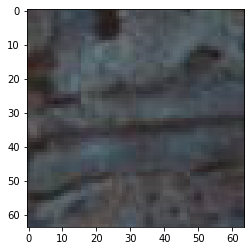

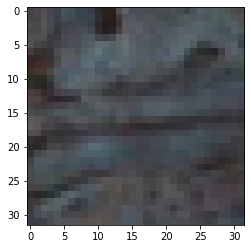

/content/Data_set_Train_x2/800/patch_798_1_0.jpg
/content/Data_set_Train_x2/800/patch_797_25_12.jpg
/content/Data_set_Train_x2/800/patch_797_14_1.jpg
/content/Data_set_Train_x2/800/patch_797_18_12.jpg
/content/Data_set_Train_x2/800/patch_797_9_9.jpg
/content/Data_set_Train_x2/800/patch_798_0_4.jpg
/content/Data_set_Train_x2/800/patch_797_16_18.jpg
/content/Data_set_Train_x2/800/patch_797_12_16.jpg
/content/Data_set_Train_x2/800/patch_797_13_10.jpg
/content/Data_set_Train_x2/800/patch_797_19_7.jpg
/content/Data_set_Train_x2/800/patch_797_19_17.jpg
/content/Data_set_Train_x2/800/patch_797_17_15.jpg
/content/Data_set_Train_x2/800/patch_797_25_7.jpg
/content/Data_set_Train_x2/800/patch_797_8_12.jpg
/content/Data_set_Train_x2/800/patch_797_6_8.jpg
/content/Data_set_Train_x2/800/patch_797_15_15.jpg
/content/Data_set_Train_x2/800/patch_797_26_5.jpg
/content/Data_set_Train_x2/800/patch_797_16_16.jpg
/content/Data_set_Train_x2/800/patch_798_0_14.jpg
/content/Data_set_Train_x2/800/patch_798_0_11

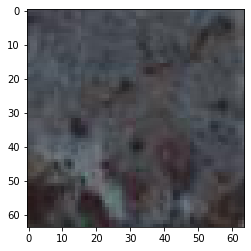

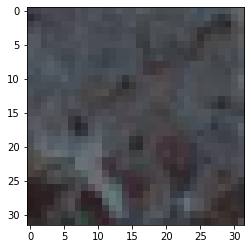

/content/Data_set_Train_x2/800/patch_798_2_1.jpg
/content/Data_set_Train_x2/800/patch_794_18_22.jpg
/content/Data_set_Train_x2/800/patch_794_18_30.jpg
/content/Data_set_Train_x2/800/patch_795_2_6.jpg
/content/Data_set_Train_x2/800/patch_795_5_30.jpg
/content/Data_set_Train_x2/800/patch_795_3_4.jpg
/content/Data_set_Train_x2/800/patch_794_17_17.jpg
/content/Data_set_Train_x2/800/patch_795_5_2.jpg
/content/Data_set_Train_x2/800/patch_795_7_0.jpg
/content/Data_set_Train_x2/800/patch_795_1_18.jpg
/content/Data_set_Train_x2/800/patch_795_7_11.jpg
/content/Data_set_Train_x2/800/patch_795_7_22.jpg
/content/Data_set_Train_x2/800/patch_795_2_19.jpg
/content/Data_set_Train_x2/800/patch_795_1_3.jpg
/content/Data_set_Train_x2/800/patch_795_11_10.jpg
/content/Data_set_Train_x2/800/patch_795_11_23.jpg
/content/Data_set_Train_x2/800/patch_795_0_8.jpg
/content/Data_set_Train_x2/800/patch_795_9_26.jpg
/content/Data_set_Train_x2/800/patch_795_1_29.jpg
/content/Data_set_Train_x2/800/patch_795_1_30.jpg
/c

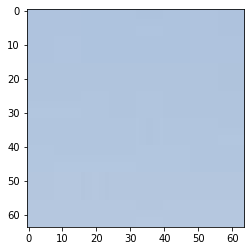

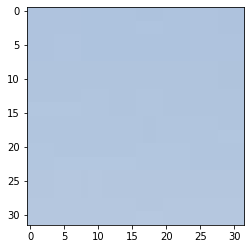

/content/Data_set_Train_x2/800/patch_796_2_11.jpg
/content/Data_set_Train_x2/800/patch_796_1_24.jpg
/content/Data_set_Train_x2/800/patch_795_20_18.jpg
/content/Data_set_Train_x2/800/patch_796_5_19.jpg
/content/Data_set_Train_x2/800/patch_796_2_0.jpg
/content/Data_set_Train_x2/800/patch_795_16_13.jpg
/content/Data_set_Train_x2/800/patch_795_17_18.jpg
/content/Data_set_Train_x2/800/patch_796_6_23.jpg
/content/Data_set_Train_x2/800/patch_795_16_18.jpg
/content/Data_set_Train_x2/800/patch_795_14_22.jpg
/content/Data_set_Train_x2/800/patch_795_14_2.jpg
/content/Data_set_Train_x2/800/patch_796_3_20.jpg
/content/Data_set_Train_x2/800/patch_796_5_6.jpg
/content/Data_set_Train_x2/800/patch_796_3_15.jpg
/content/Data_set_Train_x2/800/patch_796_3_7.jpg
/content/Data_set_Train_x2/800/patch_795_14_23.jpg
/content/Data_set_Train_x2/800/patch_795_16_19.jpg
/content/Data_set_Train_x2/800/patch_795_19_3.jpg
/content/Data_set_Train_x2/800/patch_796_0_30.jpg
/content/Data_set_Train_x2/800/patch_796_2_20.

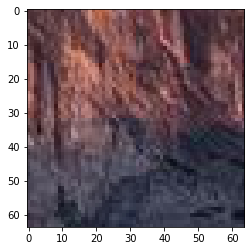

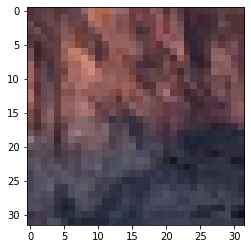

/content/Data_set_Train_x2/800/patch_796_14_22.jpg
/content/Data_set_Train_x2/800/patch_793_6_5.jpg
/content/Data_set_Train_x2/800/patch_793_16_18.jpg
/content/Data_set_Train_x2/800/patch_793_18_17.jpg
/content/Data_set_Train_x2/800/patch_793_20_30.jpg
/content/Data_set_Train_x2/800/patch_793_15_15.jpg
/content/Data_set_Train_x2/800/patch_793_6_13.jpg
/content/Data_set_Train_x2/800/patch_793_5_29.jpg
/content/Data_set_Train_x2/800/patch_793_10_20.jpg
/content/Data_set_Train_x2/800/patch_793_11_7.jpg
/content/Data_set_Train_x2/800/patch_793_5_12.jpg
/content/Data_set_Train_x2/800/patch_793_15_25.jpg
/content/Data_set_Train_x2/800/patch_793_6_17.jpg
/content/Data_set_Train_x2/800/patch_793_13_18.jpg
/content/Data_set_Train_x2/800/patch_793_19_1.jpg
/content/Data_set_Train_x2/800/patch_793_8_13.jpg
/content/Data_set_Train_x2/800/patch_793_18_3.jpg
/content/Data_set_Train_x2/800/patch_793_8_27.jpg
/content/Data_set_Train_x2/800/patch_793_15_16.jpg
/content/Data_set_Train_x2/800/patch_793_1

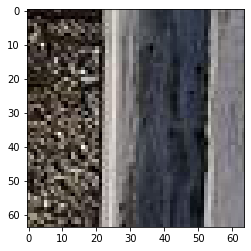

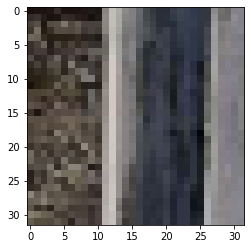

/content/Data_set_Train_x2/800/patch_794_13_16.jpg
/content/Data_set_Train_x2/800/patch_794_6_18.jpg
/content/Data_set_Train_x2/800/patch_794_10_10.jpg
/content/Data_set_Train_x2/800/patch_794_13_13.jpg
/content/Data_set_Train_x2/800/patch_794_6_4.jpg
/content/Data_set_Train_x2/800/patch_794_2_24.jpg
/content/Data_set_Train_x2/800/patch_794_5_7.jpg
/content/Data_set_Train_x2/800/patch_794_9_21.jpg
/content/Data_set_Train_x2/800/patch_794_12_3.jpg
/content/Data_set_Train_x2/800/patch_794_12_29.jpg
/content/Data_set_Train_x2/800/patch_794_15_20.jpg
/content/Data_set_Train_x2/800/patch_794_7_19.jpg
/content/Data_set_Train_x2/800/patch_794_1_2.jpg
/content/Data_set_Train_x2/800/patch_794_8_6.jpg
/content/Data_set_Train_x2/800/patch_794_5_11.jpg
/content/Data_set_Train_x2/800/patch_794_1_28.jpg
/content/Data_set_Train_x2/800/patch_794_5_26.jpg
/content/Data_set_Train_x2/800/patch_794_14_13.jpg
/content/Data_set_Train_x2/800/patch_794_5_20.jpg
/content/Data_set_Train_x2/800/patch_794_15_18.j

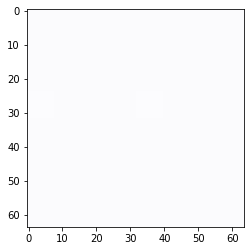

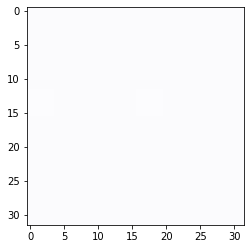

/content/Data_set_Train_x2/800/patch_795_1_27.jpg
/content/Data_set_Train_x2/800/patch_791_15_18.jpg
/content/Data_set_Train_x2/800/patch_792_5_22.jpg
/content/Data_set_Train_x2/800/patch_791_20_27.jpg
/content/Data_set_Train_x2/800/patch_792_2_17.jpg
/content/Data_set_Train_x2/800/patch_791_18_18.jpg
/content/Data_set_Train_x2/800/patch_791_12_13.jpg
/content/Data_set_Train_x2/800/patch_791_17_18.jpg
/content/Data_set_Train_x2/800/patch_792_4_22.jpg
/content/Data_set_Train_x2/800/patch_791_13_16.jpg
/content/Data_set_Train_x2/800/patch_792_3_20.jpg
/content/Data_set_Train_x2/800/patch_791_17_13.jpg
/content/Data_set_Train_x2/800/patch_791_14_10.jpg
/content/Data_set_Train_x2/800/patch_792_5_10.jpg
/content/Data_set_Train_x2/800/patch_791_18_5.jpg
/content/Data_set_Train_x2/800/patch_791_14_21.jpg
/content/Data_set_Train_x2/800/patch_791_16_2.jpg
/content/Data_set_Train_x2/800/patch_792_0_16.jpg
/content/Data_set_Train_x2/800/patch_792_0_17.jpg
/content/Data_set_Train_x2/800/patch_791_

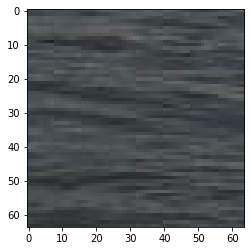

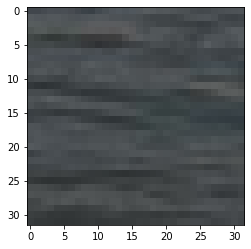

/content/Data_set_Train_x2/800/patch_792_16_29.jpg
/content/Data_set_Train_x2/800/patch_792_14_5.jpg
/content/Data_set_Train_x2/800/patch_792_8_15.jpg
/content/Data_set_Train_x2/800/patch_792_9_17.jpg
/content/Data_set_Train_x2/800/patch_792_8_5.jpg
/content/Data_set_Train_x2/800/patch_792_7_20.jpg
/content/Data_set_Train_x2/800/patch_792_15_17.jpg
/content/Data_set_Train_x2/800/patch_792_7_10.jpg
/content/Data_set_Train_x2/800/patch_793_1_5.jpg
/content/Data_set_Train_x2/800/patch_793_2_28.jpg
/content/Data_set_Train_x2/800/patch_792_17_8.jpg
/content/Data_set_Train_x2/800/patch_793_0_30.jpg
/content/Data_set_Train_x2/800/patch_792_14_24.jpg
/content/Data_set_Train_x2/800/patch_792_16_30.jpg
/content/Data_set_Train_x2/800/patch_792_17_28.jpg
/content/Data_set_Train_x2/800/patch_793_1_29.jpg
/content/Data_set_Train_x2/800/patch_792_7_25.jpg
/content/Data_set_Train_x2/800/patch_793_2_11.jpg
/content/Data_set_Train_x2/800/patch_793_3_25.jpg
/content/Data_set_Train_x2/800/patch_792_15_21.

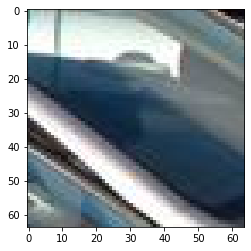

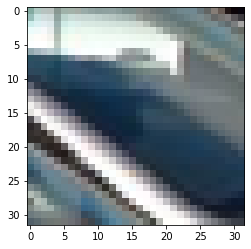

/content/Data_set_Train_x2/800/patch_793_14_29.jpg
/content/Data_set_Train_x2/800/patch_790_9_18.jpg
/content/Data_set_Train_x2/800/patch_790_9_13.jpg
/content/Data_set_Train_x2/800/patch_790_3_4.jpg
/content/Data_set_Train_x2/800/patch_790_11_12.jpg
/content/Data_set_Train_x2/800/patch_790_1_17.jpg
/content/Data_set_Train_x2/800/patch_790_7_5.jpg
/content/Data_set_Train_x2/800/patch_790_7_8.jpg
/content/Data_set_Train_x2/800/patch_790_9_0.jpg
/content/Data_set_Train_x2/800/patch_790_7_4.jpg
/content/Data_set_Train_x2/800/patch_790_6_18.jpg
/content/Data_set_Train_x2/800/patch_790_4_11.jpg
/content/Data_set_Train_x2/800/patch_790_5_13.jpg
/content/Data_set_Train_x2/800/patch_790_3_21.jpg
/content/Data_set_Train_x2/800/patch_790_1_5.jpg
/content/Data_set_Train_x2/800/patch_790_0_30.jpg
/content/Data_set_Train_x2/800/patch_790_11_25.jpg
/content/Data_set_Train_x2/800/patch_790_3_11.jpg
/content/Data_set_Train_x2/800/patch_790_11_13.jpg
/content/Data_set_Train_x2/800/patch_790_4_19.jpg
/c

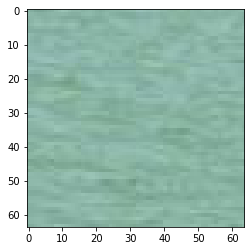

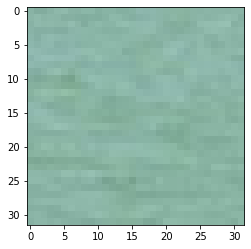

/content/Data_set_Train_x2/800/patch_790_17_20.jpg
/content/Data_set_Train_x2/800/patch_790_16_12.jpg
/content/Data_set_Train_x2/800/patch_791_4_26.jpg
/content/Data_set_Train_x2/800/patch_791_6_14.jpg
/content/Data_set_Train_x2/800/patch_791_4_14.jpg
/content/Data_set_Train_x2/800/patch_791_1_1.jpg
/content/Data_set_Train_x2/800/patch_791_8_29.jpg
/content/Data_set_Train_x2/800/patch_790_13_10.jpg
/content/Data_set_Train_x2/800/patch_791_10_18.jpg
/content/Data_set_Train_x2/800/patch_791_1_12.jpg
/content/Data_set_Train_x2/800/patch_791_4_0.jpg
/content/Data_set_Train_x2/800/patch_790_17_2.jpg
/content/Data_set_Train_x2/800/patch_791_2_10.jpg
/content/Data_set_Train_x2/800/patch_791_5_14.jpg
/content/Data_set_Train_x2/800/patch_791_7_23.jpg
/content/Data_set_Train_x2/800/patch_791_9_0.jpg
/content/Data_set_Train_x2/800/patch_791_2_16.jpg
/content/Data_set_Train_x2/800/patch_791_3_14.jpg
/content/Data_set_Train_x2/800/patch_791_6_11.jpg
/content/Data_set_Train_x2/800/patch_791_6_22.jpg

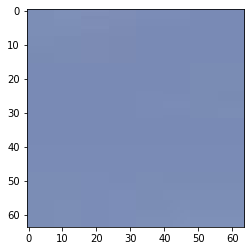

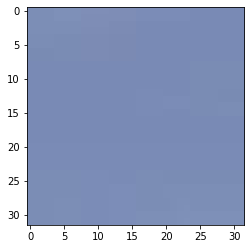

/content/Data_set_Train_x2/800/patch_792_2_18.jpg
/content/Data_set_Train_x2/800/patch_790_0_4.jpg
/content/Data_set_Train_x2/800/patch_790_9_26.jpg
/content/Data_set_Train_x2/800/patch_790_3_17.jpg
/content/Data_set_Train_x2/800/patch_790_12_24.jpg
/content/Data_set_Train_x2/800/patch_790_8_2.jpg
/content/Data_set_Train_x2/800/patch_790_7_16.jpg
/content/Data_set_Train_x2/800/patch_790_2_22.jpg
/content/Data_set_Train_x2/800/patch_790_12_13.jpg
/content/Data_set_Train_x2/800/patch_790_4_8.jpg
/content/Data_set_Train_x2/800/patch_790_2_6.jpg
/content/Data_set_Train_x2/800/patch_790_5_24.jpg
/content/Data_set_Train_x2/800/patch_790_10_24.jpg
/content/Data_set_Train_x2/800/patch_790_9_20.jpg
/content/Data_set_Train_x2/800/patch_790_10_25.jpg
/content/Data_set_Train_x2/800/patch_790_2_29.jpg
/content/Data_set_Train_x2/800/patch_790_8_9.jpg
/content/Data_set_Train_x2/800/patch_790_8_24.jpg
/content/Data_set_Train_x2/800/patch_790_9_3.jpg
/content/Data_set_Train_x2/800/patch_790_4_13.jpg
/c

In [ ]:
img_paths = []
for j in range(510,801,10):
  img_paths = []
  for dirname, _, filenames in os.walk(f'../Train_Y/{j}'):
      for filename in filenames:
          img_paths.append(os.path.join(dirname, filename))
  print(len(img_paths))
  counter = 1
  for image in img_paths:
    name = os.path.split(image)
    im = Image.open(image)
    if counter%500 == 0:
      plt.imshow(im)
      plt.show()
      plt.close()
    im_d = im.resize((im.size[0]//2, im.size[1]//2), Image.BICUBIC)
    if counter%500 == 0:
      plt.imshow(im_d)
      plt.show()
      plt.close()
    counter += 1
    print(f"/content/Data_set_Train_x2/{j}/{name[1]}")
    im_d.save(f"/content/Data_set_Train_x2/{j}/{name[1]}")

In [ ]:
!rm -rf /content/Data_set_Train_x2

In [ ]:
!zip -r /content/Data_set_Train_x2 /content/Data_set_Train_x2

Se truncaron las últimas líneas 5000 del resultado de transmisión.
  adding: content/Data_set_Train_x2/320/patch_311_16_8.jpg (deflated 17%)
  adding: content/Data_set_Train_x2/320/patch_315_17_28.jpg (deflated 21%)
  adding: content/Data_set_Train_x2/320/patch_315_2_30.jpg (deflated 28%)
  adding: content/Data_set_Train_x2/320/patch_313_15_27.jpg (deflated 24%)
  adding: content/Data_set_Train_x2/320/patch_314_5_23.jpg (deflated 22%)
  adding: content/Data_set_Train_x2/320/patch_318_13_6.jpg (deflated 21%)
  adding: content/Data_set_Train_x2/320/patch_312_28_22.jpg (deflated 18%)
  adding: content/Data_set_Train_x2/320/patch_312_4_8.jpg (deflated 20%)
  adding: content/Data_set_Train_x2/320/patch_310_14_2.jpg (deflated 21%)
  adding: content/Data_set_Train_x2/320/patch_310_17_4.jpg (deflated 23%)
  adding: content/Data_set_Train_x2/320/patch_310_12_1.jpg (deflated 19%)
  adding: content/Data_set_Train_x2/320/patch_313_11_12.jpg (deflated 18%)
  adding: content/Data_set_Train_x2/320/pa

In [ ]:
from google.colab import files
files.download(f"/content/Data_set_Train_x2.zip")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>